Phase diagram reconstruction for the NbCoSn system

In [501]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import ternary

from xrdc import xrdutils
from xrdc import source_separation as sep
from xrdc import featurization as feat
from xrdc import visualization as vis
from xrdc import peak_fitting as pf
from xrdc import workflows
from xrdc import plotting

from scipy.ndimage.filters import gaussian_filter as gf

# merge eventually into featurization.peakfit_featurize, needs to be more general to handle both 2 and 3-d arrays
def peakfit_featurize(patterns_pp, fitlists, size_thresh = 5, thicken_ax0 = 1, normf = feat.norm3d):
    #patterns_pp = gf(patterns, (1, 1.7))
    labeled, feature_masks, activations, norm_, activations_n1 = feat.get_ridge_features(
        patterns_pp,
        smooth_ax1 = 1,
        smooth_ax0 = thicken_ax0, threshold_percentile = 50, thicken = True, size_thresh = size_thresh, bgsub=False,
        log_scale_features = False, fwhm_finder=feat.fwhm_finder, do_flood_thicken = False, max_size_flood = 20,
        thicken_ax0 = 1,
        thicken_ax1 = 0, flood_threshold=.95, smooth_factor_ax1 = .125, fitlists = fitlists,
    peakwidth = 1, normf = normf)
    return labeled, feature_masks, activations, norm_, activations_n1

In [257]:
from glob import glob
from xrdc import xrdutils as xdu
from xrdc import geometry as geo

import numpy as np
import matplotlib.pyplot as plt

import functools
import ternary
from ternary.helpers import simplex_iterator, project_point, project_sequence, planar_to_coordinates
from ternary import plotting as tplot

def compose(*functions):
    def compose2(f, g):
        return lambda x: f(g(x))
    return functools.reduce(compose2, functions, lambda x: x)

from scipy.spatial import Voronoi, voronoi_plot_2d

In [511]:
def transpose_x_3d(arr):
    return np.swapaxes(
            np.swapaxes(arr, 0, 2), 
                0, 1)

def transpose_x_3d_inv(arr):
    return np.swapaxes(
            np.swapaxes(arr, 0, 2), 
                1, 2)

In [3]:
paths = glob("NbCoSn/*")

In [4]:
paths

['NbCoSn/Co_mp-54_computed.cif',
 'NbCoSn/CoSn3_mp-985707_computed.cif',
 'NbCoSn/CoSn_mp-20536_computed.cif',
 'NbCoSn/Nb3Sn_mp-1326_computed.cif',
 'NbCoSn/Nb6Co7_mp-7250_computed.cif',
 'NbCoSn/NbCo3_mp-977426_computed.cif',
 'NbCoSn/NbCoSn_mp-1094088_computed.cif',
 'NbCoSn/Nb_mp-75_computed.cif',
 'NbCoSn/NbSn2_mp-1046_computed.cif',
 'NbCoSn/Sn_mp-117_computed.cif']

In [133]:
import pymatgen as pm
from pymatgen.analysis.diffraction.xrd import XRDCalculator

def get_structure(p):
    #p path to CIF
    structure = pm.core.Structure.from_file(p) #read in structure
    return structure

def structure_pat(structure, sigma = .01):
    xrd = XRDCalculator("CuKa") #initiate XRD calculator (can specify various options here)
    pat = xrd.get_pattern(structure)
    q, i = xdu.to_q(pat.x), pat.y
    ii = xdu.mk_pattern(i, q, sigma)
    return ii

# pat from cif path
get_pat = compose(structure_pat, get_structure)

In [138]:
structures = [get_structure(p) for p in paths]
pats = [get_pat(p) for p in paths]
compositions = np.vstack([get_composition(s) for s in structures])

N = len(pats)
# it = simplex_iterator(N)
# cgrid = np.array(list(it)) / N

/home/ollie/anaconda3/lib/python3.8/site-packages/pymatgen-2022.1.9-py3.8-linux-x86_64.egg/pymatgen/io/cif.py:1164: UserWarning: Issues encountered while parsing CIF: Some fractional co-ordinates rounded to ideal values to avoid issues with finite precision.
  warnings.warn("Issues encountered while parsing CIF: %s" % "\n".join(self.warnings))


In [639]:
len(pats)

10

In [398]:
dn = 1

gridx = np.arange(0, N, dn)
gridy = np.arange(0, N, dn)

xx, yy = np.meshgrid(gridx, gridy)
xx = xx.ravel()
yy = yy.ravel()

xy = np.vstack((xx, yy)).T

grid_triples = np.array([planar_to_coordinates(xy[i], N) for i in range(len(xy))])

mask = (grid_triples > 0).all(axis = 1)

gridx = xx[mask]
gridy = yy[mask]
xy = xy[mask]


composition_grid_xyz = np.array([planar_to_coordinates(xy[i], N) for i in range(len(xy))]) / N

In [390]:
grid_triples.shape

(38, 3)

In [391]:
def generate_heatmap_data(arr3d, scale=5):
    from ternary.helpers import simplex_iterator
    d = dict()
    n, m = arr3d.shape[:2]
    for i in range(n):
        for j in range(m):
            ci, cj, ck = composition.iloc[to_2d[i, j]]
            try:
                vi, vj, vk = arr3d[i, j]
                d[(ci, cj, ck)] = color_point(vi, vj, vk, scale)
            except TypeError:
                d[(ci, cj, ck)] = arr3d[i, j] / scale
    return d

compositionlabs = ['Nb', 'Co', 'Sn']
def simplex_rgb(data, use_rgba=True):
    scale = 100
    figure, tax = ternary.figure(scale=scale)
    tax.heatmap(data, style="hexagonal", use_rgba=use_rgba, cmap = 'jet')
    tax.boundary()
    tax.set_title("RGBA Heatmap")

    tax.scatter([[100, 0 , 0]], marker='s', label = compositionlabs[0])
    tax.scatter([[0, 100 , 0]], marker='s', label = compositionlabs[1])
    tax.scatter([[0, 0 , scale]], marker='s', label = compositionlabs[2])
    tax.legend()

    plt.show()

In [392]:
from xrdc.datasets import d3d

In [393]:
data = generate_heatmap_data(d3d.m3d, N)

NameError: name 'composition' is not defined

AttributeError: 'numpy.ndarray' object has no attribute 'items'

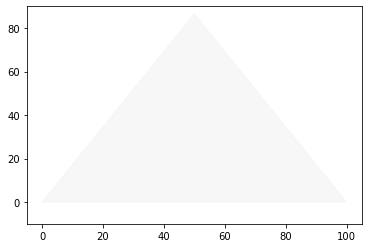

In [264]:
simplex_rgb(grid_triples
           )

In [394]:
tmp = list(map(list, grid_triples ))

In [396]:
len(project_sequence(tmp))

2

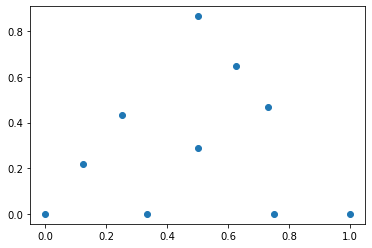

In [338]:
plt.scatter(*np.array(project_sequence(compositions)))

<AxesSubplot:>

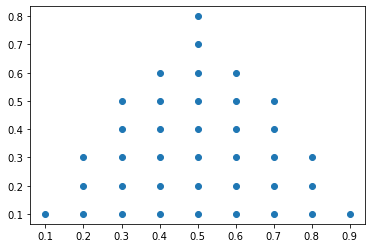

In [397]:
#tplot.scatter([tmp[0], tmp[1]])
tplot.scatter(tmp)

In [243]:
mask.sum()

63

In [244]:
mask.shape

(100,)

In [63]:
structures[0]

Structure Summary
Lattice
    abc : 2.50078359 2.50078359 4.033331
 angles : 90.0 90.0 119.99998915
 volume : 21.84473422772745
      A : 2.50078359 0.0 1.5312883094268636e-16
      B : -1.2503913848772388 2.165742355091683 1.5312883094268636e-16
      C : 0.0 0.0 4.033331
PeriodicSite: Co (0.0000, 1.4438, 1.0083) [0.3333, 0.6667, 0.2500]
PeriodicSite: Co (1.2504, 0.7219, 3.0250) [0.6667, 0.3333, 0.7500]

In [45]:
def get_composition(structure, elts = ['Nb', 'Co', 'Sn']):
    d = structure.composition.fractional_composition.as_dict()
    return np.array([d[elt] for elt in elts])

In [55]:
structure.composition.fractional_composition.as_dict()

defaultdict(float, {'Co': 1.0})

In [616]:
def i_closest_node(node, nodes):
    nodes = np.asarray(nodes)
    dist_2 = np.sum((nodes - node)**2, axis=1)
    i = np.argmin(dist_2)
    #print(i)
    return i

In [633]:
def i_weights(node, nodes):
    nodes = np.asarray(nodes)
    dist_2 = np.sum((nodes - node)**2, axis=1)
    
    isort = np.argsort(dist_2)
    norm = (1 / (dist_2 + 1e-9)).sum()
    weights = (1 / (dist_2 + 1e-9))[isort] / norm
    return weights, isort

def mix_patterns(node, nodes):
    """
    Mix patterns based on proximity to end members of node, a composition triplet
    """
    weights, isort = i_weights(node, nodes)
    res = np.zeros_like(pats[0])
    for w, i in zip(weights, isort):
        res += w * pats[i]
    return res
    
#     i = np.argmin(dist_2)
#     #print(i)
#     return i

In [627]:
target

array([0.9, 0.1, 0. ])

In [618]:
A, target = compositions, np.array([.9, .1, 0])
i_closest_node(target, A)

7

In [619]:
i_weights(target, A)

(array([0.71065134, 0.14961081, 0.03696524, 0.02920485, 0.01832625,
        0.01682015, 0.01165002, 0.01018855, 0.00877347, 0.00780936]),
 array([7, 3, 4, 6, 8, 5, 2, 1, 0, 9]))

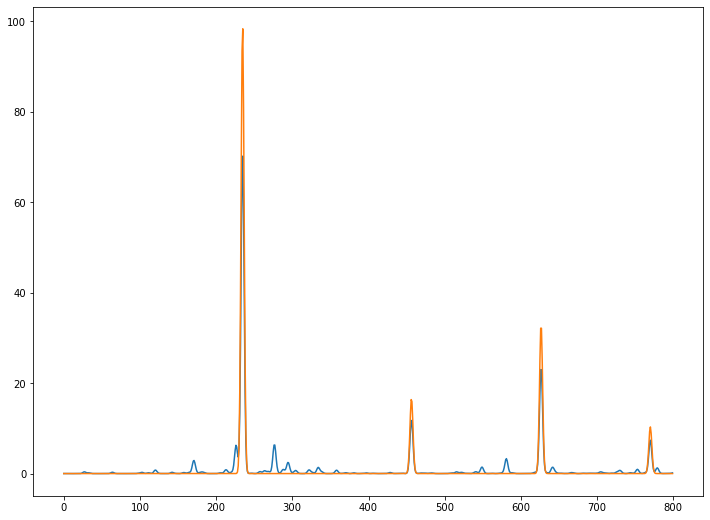

In [625]:
plt.plot(mix_patterns(target, A))
plt.plot(pats[7])

In [149]:
def get_coord_pat(triple):
    if len(triple.shape) == 2:
        return np.array([pats[i_closest_node(c, compositions)] for c in triple])
    elif len(triple.shape) == 1:
        return pats[i_closest_node(triple, compositions)]
    else:
        raise ValueError     

In [628]:
def get_coord_pat_mixed(triple):
    """
    Mix based on distance to end members
    """
    if len(triple.shape) == 2:
        return np.array([mix_patterns(c, compositions) for c in triple])
    elif len(triple.shape) == 1:
        return mix_patterns(c, compositions)
    else:
        raise ValueError

In [196]:
i_closest_node(cgrid[0], compositions)

ValueError: operands could not be broadcast together with shapes (10,3) (66,3) 

In [185]:
compositions

array([[0.        , 1.        , 0.        ],
       [0.        , 0.25      , 0.75      ],
       [0.        , 0.5       , 0.5       ],
       [0.75      , 0.        , 0.25      ],
       [0.46153846, 0.53846154, 0.        ],
       [0.25      , 0.75      , 0.        ],
       [0.33333333, 0.33333333, 0.33333333],
       [1.        , 0.        , 0.        ],
       [0.33333333, 0.        , 0.66666667],
       [0.        , 0.        , 1.        ]])

In [186]:
cgrid[0]

array([0. , 0. , 0.1])

In [150]:
tmp = get_coord_pat(compositions[0])

In [197]:
assert np.all(get_coord_pat(cgrid)[0] == get_coord_pat(cgrid[0]))

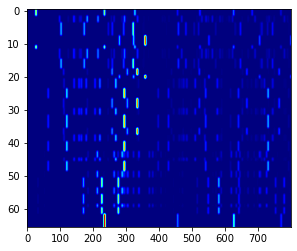

In [198]:
plt.imshow(np.log(1 + get_coord_pat(cgrid) / 50), aspect = 10, cmap = 'jet')

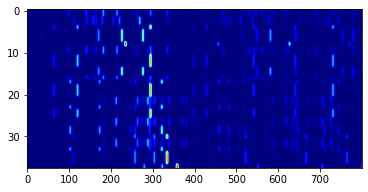

In [404]:
plt.imshow(np.log(1 + get_coord_pat(composition_grid_xyz) / 50), aspect = 10, cmap = 'jet')

In [409]:
np.vstack(np.indices(composition_grid_xyz.shape))

(76, 3)

In [424]:
# grid_sim_patterns = get_coord_pat(composition_grid_xyz)

In [432]:
simplex_grid_xy = np.array(project_sequence(compositions)).T

xu = np.unique(simplex_grid_xy[:, 0])
yu = np.unique(simplex_grid_xy[:, 1])
        
ni = len(np.unique(simplex_grid_xy[:, 0]))
nj = len(np.unique(simplex_grid_xy[:, 1]))

nrange = max(ni, nj)

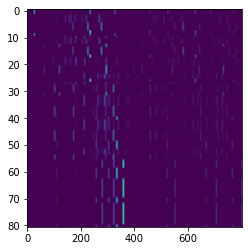

In [470]:
plt.imshow(grid_sim_patterns, aspect = 10)

In [634]:
ni = nj = 15
simplex_xx, simplex_yy = np.meshgrid(np.linspace(0, 1, ni), np.linspace(0, 1, nj))

simplex_xy = np.vstack((simplex_xx.ravel(), simplex_yy.ravel())).T

iii, jjj = np.indices((ni, nj))
iii = iii.ravel()
jjj = jjj.ravel()

grid_xyz = np.array([planar_to_coordinates(s, 1) for s in simplex_xy])
mask = (grid_xyz > 0).all(axis = 1).reshape(ni, nj)

grid_sim_patterns = get_coord_pat(grid_xyz)
#grid_sim_patterns = get_coord_pat_mixed(grid_xyz)

nrange = max(ni, nj)
m3d = np.zeros((nrange, nrange, grid_sim_patterns.shape[-1]))

to_3d = []
to_2d = np.zeros((nrange, nrange)).astype(int)

# todo refactor
for i in range(len(grid_sim_patterns)):
    ii, jj = iii[i], jjj[i]
    m3d[ii, jj, :] = grid_sim_patterns[i]
    to_3d.append((ii, jj))
    to_2d[ii, jj] = int(i)
    
noise_scale = .01
m3d = m3d * (1 + noise_scale * np.random.normal(size = m3d.shape))

In [601]:
background, fast_q, slow_T, fast_T = sep.separate_signal(m3d, background_after_filter = False,
                                 threshold = .5, smooth_q = 1.7, smooth_neighbor_background = 0,
                                 bg_fill_method = 'simple')

(0, 0, 0)


In [591]:
tmp = fsub_stop_2d

In [602]:
# fsub_stop_2d = pf.curvefit_2d((m3d - 0), stdratio_threshold = 3, noise_estimate = fast_T,
#                   background = background, bg_shift_pos = False, fit_sigma = True)
fsub_stop_2d = pf.curvefit_2d((m3d - 0), stdratio_threshold = 3,
                noise_estimate = (m3d * noise_scale * np.random.normal(size = m3d.shape)),
                  background = background, bg_shift_pos = False, fit_sigma = True)

numBlocks: 240, dataPts/Block: 3.3333333333333335
[  0. 219. 312. 440. 509. 611. 640. 755. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 219.0], [219.0, 312.0], [312.0, 440.0], [440.0, 509.0], [509.0, 611.0], [611.0, 640.0], [640.0, 755.0], [755.0, 799.0]]}
global background
[-2.81135093e-16 -2.79585604e-16 -2.76510472e-16 -2.71957471e-16
 -2.65998413e-16 -2.58729169e-16 -2.50269405e-16 -2.40752284e-16
 -2.29085581e-16 -8.84065058e-17  1.02676387e-14  6.36681045e-13
  3.06157101e-11  1.16865855e-09  3.40181678e-08  7.66618383e-07
  1.35524718e-05  1.84158996e-04  2.01355858e-03  1.65102118e-02
  1.09372661e-01  5.51299874e-01  2.18955976e+00  6.56001477e+00
  1.56598437e+01  2.96681943e+01  4.27614559e+01  4.88335853e+01
  4.28834775e+01  2.93241615e+01  1.53510644e+01  6.35287884e+00
  2.06850525e+00  5.11361640e-01  1.03397690e-01  1.55339042e-02
  1.86175386e-03  1.74422125e-04  1.23354583e-05  6.96008672e-07
  3.04511274e-08  1.05308726e-09  2.80968474e-11  5.70

Peak at 28, iteration 1: error = 0.049365381482037805
bounds ([-9.850000000000001, -12.208396321350257, 0, 0, 0, -9.850000000000001, -12.208396321350257, 0, 0, 0], [228.85, inf, inf, 217.0, 217.0, 228.85, inf, inf, 217.0, 217.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190

Peak at 683, iteration 1: error = 0.06594963258478173
bounds ([634.3, -2.0555111292936155, 0, 0, 0, 634.3, -2.0555111292936155, 0, 0, 0], [759.7, inf, inf, 114.0, 114.0, 759.7, inf, inf, 114.0, 114.0])
[640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656 657
 658 659 660 661 662 663 664 665 666 667 668 669 670 671 672 673 674 675
 676 677 678 679 680 681 682 683 684 685 686 687 688 689 690 691 692 693
 694 695 696 697 698 699 700 701 702 703 704 705 706 707 708 709 710 711
 712 713 714 715 716 717 718 719 720 721 722 723 724 725 726 727 728 729
 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747
 748 749 750 751 752 753 754]
Peak at 770, start iteration with error = 0.14694932766684965
109.53036522378387
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 770, iteration 0: error = 0.001175882085982172
0.685235964633

Peak at 28, iteration 0: error = 0.0493239143383147
73.90287885434519
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218]
Peak at 28, iteration 1: error = 0.049323914

Peak at 627, iteration 1: error = 0.2614716653954585
bounds ([609.6, -3.760947422433106, 0, 0, 0, 609.6, -3.760947422433106, 0, 0, 0], [640.4, inf, inf, 28.0, 28.0, 640.4, inf, inf, 28.0, 28.0])
[611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627 628
 629 630 631 632 633 634 635 636 637 638 639]
Peak at 683, start iteration with error = 0.06597686582301596
122.98499809611482
[640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656 657
 658 659 660 661 662 663 664 665 666 667 668 669 670 671 672 673 674 675
 676 677 678 679 680 681 682 683 684 685 686 687 688 689 690 691 692 693
 694 695 696 697 698 699 700 701 702 703 704 705 706 707 708 709 710 711
 712 713 714 715 716 717 718 719 720 721 722 723 724 725 726 727 728 729
 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747
 748 749 750 751 752 753 754]
Peak at 683, iteration 0: error = 0.06597689271327785
122.9849964009587
[640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 

Peak at 28, iteration 0: error = 0.04933695979123708
144.76435710626305
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218]
Peak at 28, iteration 1: error = 0.0493369

Peak at 683, iteration 0: error = 0.06588827753978369
104.20224893774211
[640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656 657
 658 659 660 661 662 663 664 665 666 667 668 669 670 671 672 673 674 675
 676 677 678 679 680 681 682 683 684 685 686 687 688 689 690 691 692 693
 694 695 696 697 698 699 700 701 702 703 704 705 706 707 708 709 710 711
 712 713 714 715 716 717 718 719 720 721 722 723 724 725 726 727 728 729
 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747
 748 749 750 751 752 753 754]
Peak at 683, iteration 1: error = 0.06588827935217163
bounds ([634.3, -2.06788425658689, 0, 0, 0, 634.3, -2.06788425658689, 0, 0, 0], [759.7, inf, inf, 114.0, 114.0, 759.7, inf, inf, 114.0, 114.0])
[640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656 657
 658 659 660 661 662 663 664 665 666 667 668 669 670 671 672 673 674 675
 676 677 678 679 680 681 682 683 684 685 686 687 688 689 690 691 692 693
 694 695 696 697 698 699 700 701 702 703 7

Peak at 113, iteration 0: error = 0.05103522587744038
92.47294576832535
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134]
Peak at 113, iteration 1: error = 0.0510352258088912
bounds ([-5.65, -1.0585281645320166, 0, 0, 0, -5.65, -1.0585281645320166, 0, 0, 0], [140.65, inf, inf, 133.0, 133.0, 140.65, inf, inf, 133.0, 133.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  

Peak at 445, iteration 1: error = 0.04538299443336401
bounds ([430.95, -0.4236276530016368, 0, 0, 0, 430.95, -0.4236276530016368, 0, 0, 0], [454.05, inf, inf, 21.0, 21.0, 454.05, inf, inf, 21.0, 21.0])
[432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453]
Peak at 462, start iteration with error = 0.3764514813883409
77.84853235437757
[454 455 456 457 458 459 460 461 462]
Peak at 462, iteration 0: error = 0.18267425075191693
24.862736626897494
[454 455 456 457 458 459 460 461 462]
Peak at 462, iteration 1: error = 0.1704042458299182
bounds ([453.6, -0.5360739587438177, 0, 0, 0, 453.6, -0.5360739587438177, 0, 0, 0], [462.4, inf, inf, 8.0, 8.0, 462.4, inf, inf, 8.0, 8.0])
[454 455 456 457 458 459 460 461 462]
Peak at 476, start iteration with error = 0.3387398383772328
81.41030285236755
[463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479]
Peak at 476, iteration 0: error = 0.3370167330762691
64.2729685310346
[463 464 465 466 467 468 469 

numBlocks: 239, dataPts/Block: 3.3472803347280333
[  0. 135. 148. 161. 170. 185. 211. 240. 249. 327. 423. 432. 454. 463.
 480. 490. 522. 569. 586. 646. 657. 670. 688. 705. 712. 736. 775. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 135.0], [135.0, 148.0], [148.0, 161.0], [161.0, 170.0], [170.0, 185.0], [185.0, 211.0], [211.0, 240.0], [240.0, 249.0], [249.0, 327.0], [327.0, 423.0], [423.0, 432.0], [432.0, 454.0], [454.0, 463.0], [463.0, 480.0], [480.0, 490.0], [490.0, 522.0], [522.0, 569.0], [569.0, 586.0], [586.0, 646.0], [646.0, 657.0], [657.0, 670.0], [670.0, 688.0], [688.0, 705.0], [705.0, 712.0], [712.0, 736.0], [736.0, 775.0], [775.0, 799.0]]}
global background
[-1.66565618e-16 -2.99758150e-16 -2.89172195e-16  3.68411327e-16
  3.42998307e-14  1.36021586e-12  4.20487980e-11  1.02444768e-09
  1.95580278e-08  2.84109799e-07  3.24924935e-06  2.98111070e-05
  2.04957728e-04  1.12417763e-03  4.64058807e-03  1.56580637e-02
  3.86932155e-02  7.75898348e-02  1.25663033

Peak at 113, iteration 1: error = 0.050962339956564816
bounds ([-5.65, -1.0740143572067393, 0, 0, 0, -5.65, -1.0740143572067393, 0, 0, 0], [140.65, inf, inf, 133.0, 133.0, 140.65, inf, inf, 133.0, 133.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134]
Peak at 143, start iteration with error = 0.5497736636659553
81.79358134146854
[135 136 137 138 139 140 141 142 143 144 145 146 147]
Peak at 143, iteration 0: error = 0.07748132374867235
11.302025397948125
[135 136 137 138 139 140 141 142 143 144 145

Peak at 485, start iteration with error = 0.44311252093302744
99.41413253592398
[480 481 482 483 484 485 486 487 488 489]
Peak at 485, iteration 0: error = 0.23982527198870898
34.09984907022294
[480 481 482 483 484 485 486 487 488 489]
Peak at 485, iteration 1: error = 0.05896013709894774
bounds ([479.55, -1.1047663100411322, 0, 0, 0, 479.55, -1.1047663100411322, 0, 0, 0], [489.45, inf, inf, 9.0, 9.0, 489.45, inf, inf, 9.0, 9.0])
[480 481 482 483 484 485 486 487 488 489]
Peak at 510, start iteration with error = 0.24133035561089922
47.7792984651842
[490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521]
Peak at 510, iteration 0: error = 0.24132402570538944
47.778926150723066
[490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521]
Peak at 510, iteration 1: error = 0.2331376148535656
bounds ([488.45, -1.6286991875239272, 0, 0, 0, 488.45, -1

Peak at 113, iteration 0: error = 0.05086182094980631
96.99701643579884
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134]
Peak at 113, iteration 1: error = 0.05086182095390831
bounds ([-5.65, -1.0460087317176503, 0, 0, 0, -5.65, -1.0460087317176503, 0, 0, 0], [140.65, inf, inf, 133.0, 133.0, 140.65, inf, inf, 133.0, 133.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44 

Peak at 475, start iteration with error = 0.35097127956684565
68.29256852650266
[466 467 468 469 470 471 472 473 474 475 476 477 478 479]
Peak at 475, iteration 0: error = 0.33309262628669484
49.40108370801489
[466 467 468 469 470 471 472 473 474 475 476 477 478 479]
Peak at 475, iteration 1: error = 0.10873239222322849
bounds ([465.35, -0.9982026460911382, 0, 0, 0, 465.35, -0.9982026460911382, 0, 0, 0], [479.65, inf, inf, 13.0, 13.0, 479.65, inf, inf, 13.0, 13.0])
[466 467 468 469 470 471 472 473 474 475 476 477 478 479]
Peak at 485, start iteration with error = 0.4406137598523613
114.70526136346436
[480 481 482 483 484 485 486 487 488 489]
Peak at 485, iteration 0: error = 0.24769946766365208
40.814457375648296
[480 481 482 483 484 485 486 487 488 489]
Peak at 485, iteration 1: error = 0.06009195190451415
bounds ([479.55, -1.09719657396149, 0, 0, 0, 479.55, -1.09719657396149, 0, 0, 0], [489.45, inf, inf, 9.0, 9.0, 489.45, inf, inf, 9.0, 9.0])
[480 481 482 483 484 485 486 487 488 489]

global background
[8.96230602e-03 3.24412196e-02 9.95963854e-02 2.56892126e-01
 5.87635937e-01 1.24313946e+00 2.21947574e+00 3.66272710e+00
 4.75039942e+00 5.33465557e+00 4.92059405e+00 3.87549047e+00
 2.51414219e+00 1.33217517e+00 5.81666141e-01 2.03066226e-01
 5.76530760e-02 1.29936447e-02 2.20710439e-03 3.01310038e-04
 3.18592062e-05 2.65073498e-06 1.72523269e-07 2.06881876e-08
 1.78055697e-07 1.98524218e-06 1.74888389e-05 1.21345659e-04
 6.46579291e-04 2.66576554e-03 8.71642332e-03 2.22350768e-02
 4.32416518e-02 6.61067898e-02 7.75346835e-02 7.35919690e-02
 5.32197759e-02 3.37025914e-02 2.82081392e-02]
[8.96230602e-03 3.24412196e-02 9.95963854e-02 2.56892126e-01
 5.87635937e-01 1.24313946e+00 2.21947574e+00 3.66272710e+00
 4.75039942e+00 5.33465557e+00 4.92059405e+00 3.87549047e+00
 2.51414219e+00 1.33217517e+00 5.81666141e-01 2.03066226e-01
 5.76530760e-02 1.29936447e-02 2.20710439e-03 3.01310038e-04
 3.18592062e-05 2.65073498e-06 1.72523269e-07 2.06881876e-08
 1.78055697e-07 1.98

Peak at 270, iteration 0: error = 0.1339365247658685
49.43682069480585
[249 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266
 267 268 269 270 271 272 273 274 275 276 277 278 279 280 281 282 283 284
 285 286 287 288 289 290 291 292 293 294 295 296 297 298 299 300 301 302
 303 304 305 306 307 308 309 310 311 312 313 314 315 316 317 318 319 320
 321 322 323 324 325 326]
Peak at 270, iteration 1: error = 0.133936515668341
bounds ([245.15, -6.020047061951439, 0, 0, 0, 245.15, -6.020047061951439, 0, 0, 0], [329.85, inf, inf, 77.0, 77.0, 329.85, inf, inf, 77.0, 77.0])
[249 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266
 267 268 269 270 271 272 273 274 275 276 277 278 279 280 281 282 283 284
 285 286 287 288 289 290 291 292 293 294 295 296 297 298 299 300 301 302
 303 304 305 306 307 308 309 310 311 312 313 314 315 316 317 318 319 320
 321 322 323 324 325 326]
Peak at 338, start iteration with error = 0.06792404112133894
113.41655095327802
[327 328 329 3

Peak at 669, start iteration with error = 0.1504914745045465
93.56517903666945
[657 658 659 660 661 662 663 664 665 666 667 668 669]
Peak at 669, iteration 0: error = 0.18140924180377388
99.93024361840868
[657 658 659 660 661 662 663 664 665 666 667 668 669]
Peak at 669, iteration 1: error = 0.13926126598705096
bounds ([656.4, -0.18234004858499206, 0, 0, 0, 656.4, -0.18234004858499206, 0, 0, 0], [669.6, inf, inf, 12.0, 12.0, 669.6, inf, inf, 12.0, 12.0])
[657 658 659 660 661 662 663 664 665 666 667 668 669]
Peak at 681, start iteration with error = 0.19915077248045618
60.23196962517254
[670 671 672 673 674 675 676 677 678 679 680 681 682 683 684 685 686 687]
Peak at 681, iteration 0: error = 0.1241478854133245
42.91722405468898
[670 671 672 673 674 675 676 677 678 679 680 681 682 683 684 685 686 687]
Peak at 681, iteration 1: error = 0.12580294215108345
bounds ([669.15, -0.1958292879607162, 0, 0, 0, 669.15, -0.1958292879607162, 0, 0, 0], [687.85, inf, inf, 17.0, 17.0, 687.85, inf, inf,

Peak at 113, iteration 0: error = 0.050988657733641286
79.71637940583855
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134]
Peak at 113, iteration 1: error = 0.05098865786519228
bounds ([-5.65, -1.0419886037970147, 0, 0, 0, -5.65, -1.0419886037970147, 0, 0, 0], [140.65, inf, inf, 133.0, 133.0, 140.65, inf, inf, 133.0, 133.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44

Peak at 485, start iteration with error = 0.4413287263088265
79.23317660589592
[480 481 482 483 484 485 486 487 488 489]
Peak at 485, iteration 0: error = 0.24527645463007097
29.94887104572015
[480 481 482 483 484 485 486 487 488 489]
Peak at 485, iteration 1: error = 0.08029188055408283
bounds ([479.55, -1.1006951432936196, 0, 0, 0, 479.55, -1.1006951432936196, 0, 0, 0], [489.45, inf, inf, 9.0, 9.0, 489.45, inf, inf, 9.0, 9.0])
[480 481 482 483 484 485 486 487 488 489]
Peak at 510, start iteration with error = 0.2418165972702335
121.90684112175036
[490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521]
Peak at 510, iteration 0: error = 0.24181665979630415
121.906840713858
[490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521]
Peak at 510, iteration 1: error = 0.2418165738708353
bounds ([488.45, -1.6244916575943948, 0, 0, 0, 488.45, -1.6

Peak at 172, iteration 0: error = 0.06535026542978623
245.6698840795156
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132
 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182]
Peak at 172, iteration 1: error = 0.06535026455110264
bounds ([36.05, -4.617556156522221, 0, 0, 0, 36.05, -4.617556156522221, 0, 0, 0], [188.95, inf, inf, 139.0, 139.0, 188.95, inf, inf, 139.0, 139.0])
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  8

Peak at 754, start iteration with error = 0.1268110640685159
71.27061444668568
[709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725 726
 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744
 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762
 763]
Peak at 754, iteration 0: error = 0.12681106747940624
71.27061417012216
[709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725 726
 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744
 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762
 763]
Peak at 754, iteration 1: error = 0.12681106622164462
bounds ([706.3, -1.5761178694160112, 0, 0, 0, 706.3, -1.5761178694160112, 0, 0, 0], [765.7, inf, inf, 54.0, 54.0, 765.7, inf, inf, 54.0, 54.0])
[709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725 726
 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744
 745 746 747 748 749 750 751 752 753 754 755 756 757 75

Peak at 172, iteration 1: error = 0.06546985258188598
bounds ([36.05, -4.5397699647677685, 0, 0, 0, 36.05, -4.5397699647677685, 0, 0, 0], [188.95, inf, inf, 139.0, 139.0, 188.95, inf, inf, 139.0, 139.0])
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132
 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182]
Peak at 227, start iteration with error = 0.18832352166784136
103.89264894094306
[183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200
 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218


Peak at 643, iteration 1: error = 0.1248154931967651
bounds ([626.1, -1.8282141320024754, 0, 0, 0, 626.1, -1.8282141320024754, 0, 0, 0], [689.9, inf, inf, 58.0, 58.0, 689.9, inf, inf, 58.0, 58.0])
[629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646
 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664
 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680 681 682
 683 684 685 686 687]
Peak at 700, start iteration with error = 0.05405868136378657
115.79693573400952
[688 689 690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705
 706 707 708]
Peak at 700, iteration 0: error = 0.05397272844849039
115.53634437907158
[688 689 690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705
 706 707 708]
Peak at 700, iteration 1: error = 0.053954295955363975
bounds ([687.0, -0.06691489386197097, 0, 0, 0, 687.0, -0.06691489386197097, 0, 0, 0], [709.0, inf, inf, 20.0, 20.0, 709.0, inf, inf, 20.0, 20.0])
[688 689 690 691 692 693 694 695 

Peak at 172, iteration 0: error = 0.06545184927543517
65.01404851868223
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132
 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182]
Peak at 172, iteration 1: error = 0.06545184963072356
bounds ([36.05, -4.584695119225386, 0, 0, 0, 36.05, -4.584695119225386, 0, 0, 0], [188.95, inf, inf, 139.0, 139.0, 188.95, inf, inf, 139.0, 139.0])
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  8

Peak at 643, iteration 0: error = 0.1250068065637034
93.49319812718672
[629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646
 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664
 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680 681 682
 683 684 685 686 687]
Peak at 643, iteration 1: error = 0.1250068068356142
bounds ([626.1, -1.862623137743681, 0, 0, 0, 626.1, -1.862623137743681, 0, 0, 0], [689.9, inf, inf, 58.0, 58.0, 689.9, inf, inf, 58.0, 58.0])
[629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646
 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664
 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680 681 682
 683 684 685 686 687]
Peak at 700, start iteration with error = 0.05435363061318044
105.4315445427833
[688 689 690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705
 706 707 708]
Peak at 700, iteration 0: error = 0.054121321291394624
105.08629782564333
[688 689 69

Peak at 172, iteration 1: error = 0.06548844903819748
bounds ([36.05, -4.595685702100009, 0, 0, 0, 36.05, -4.595685702100009, 0, 0, 0], [188.95, inf, inf, 139.0, 139.0, 188.95, inf, inf, 139.0, 139.0])
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132
 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182]
Peak at 227, start iteration with error = 0.18824813217293584
70.10810491995494
[183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200
 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218
 21

Peak at 780, iteration 0: error = 0.26892448516962625
104.65315546835387
[764 765 766 767 768 769 770 771 772 773 774 775 776 777 778 779 780 781
 782 783 784 785 786 787 788 789 790 791]
Peak at 780, iteration 1: error = 0.26892448081669523
bounds ([762.65, -2.0091316358507334, 0, 0, 0, 762.65, -2.0091316358507334, 0, 0, 0], [792.35, inf, inf, 27.0, 27.0, 792.35, inf, inf, 27.0, 27.0])
[764 765 766 767 768 769 770 771 772 773 774 775 776 777 778 779 780 781
 782 783 784 785 786 787 788 789 790 791]
Peak at 798, start iteration with error = 0.0009856422822144323
94.20917990339393
[792 793 794 795 796 797 798]
Peak at 798, iteration 0: error = 0.0008766452939134516
82.49075863275333
[792 793 794 795 796 797 798]
Peak at 798, iteration 1: error = 0.0007833800194770871
bounds ([791.7, -0.0015036378347578242, 0, 0, 0, 791.7, -0.0015036378347578242, 0, 0, 0], [798.3, inf, inf, 6.0, 6.0, 798.3, inf, inf, 6.0, 6.0])
[792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 42

Peak at 172, iteration 0: error = 0.0654136838184685
78.91781653396755
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132
 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182]
Peak at 172, iteration 1: error = 0.0654136838184685
bounds ([36.05, -4.541308750406057, 0, 0, 0, 36.05, -4.541308750406057, 0, 0, 0], [188.95, inf, inf, 139.0, 139.0, 188.95, inf, inf, 139.0, 139.0])
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81 

Peak at 582, iteration 1: error = 0.15467862869283938
bounds ([565.0, -5.3891824297755155, 0, 0, 0, 565.0, -5.3891824297755155, 0, 0, 0], [631.0, inf, inf, 60.0, 60.0, 631.0, inf, inf, 60.0, 60.0])
[568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585
 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603
 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621
 622 623 624 625 626 627 628]
Peak at 643, start iteration with error = 0.1248811811399445
73.84167358150462
[629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646
 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664
 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680 681 682
 683 684 685 686 687]
Peak at 643, iteration 0: error = 0.12488118292975822
73.84167241197156
[629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646
 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664
 665 666 667 66

Peak at 236, iteration 1: error = 0.04776251649006916
bounds ([-11.350000000000001, -24.880813728734125, 0, 0, 0, -11.350000000000001, -24.880813728734125, 0, 0, 0], [260.35, inf, inf, 247.0, 247.0, 260.35, inf, inf, 247.0, 247.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 1

Peak at 236, iteration 1: error = 0.047783784388797185
bounds ([-11.350000000000001, -24.717860259718353, 0, 0, 0, -11.350000000000001, -24.717860259718353, 0, 0, 0], [260.35, inf, inf, 247.0, 247.0, 260.35, inf, inf, 247.0, 247.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 

Peak at 28, iteration 1: error = 0.04931290360580443
bounds ([-9.850000000000001, -12.078707558258252, 0, 0, 0, -9.850000000000001, -12.078707558258252, 0, 0, 0], [228.85, inf, inf, 217.0, 217.0, 228.85, inf, inf, 217.0, 217.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 

Peak at 770, iteration 0: error = 0.0011891486979275835
1.8494378083972396
bounds ([752.85, -1.2270160142842792, 0, 0, 0], [800.15, inf, inf, 43.0, 43.0])
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 218.00
    ----Saving data for block between 219.00 - 311.00
    ----Saving data for block between 312.00 - 439.00
    ----Saving data for block between 440.00 - 508.00
    ----Saving data for block between 509.00 - 610.00
    ----Saving data for block between 611.00 - 639.00
    ----Saving data for block between 640.00 - 754.00
    ----Saving data for block between 755.00 - 798.00
done
numBlocks: 240, dataPts/Block: 3.3333333333333335
[  0. 219. 312. 440. 509. 611. 640. 755. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 219.0], [219.0, 312.0], [312.0, 440.0], [440.0, 509.0], [509.0, 611.0], [

Peak at 235, iteration 0: error = 0.11249542965101159
95.8157055660558
[219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236
 237 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254
 255 256 257 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272
 273 274 275 276 277 278 279 280 281 282 283 284 285 286 287 288 289 290
 291 292 293 294 295 296 297 298 299 300 301 302 303 304 305 306 307 308
 309 310 311]
Peak at 235, iteration 1: error = 0.11249543063740913
bounds ([214.4, -9.84711270692633, 0, 0, 0, 214.4, -9.84711270692633, 0, 0, 0], [315.6, inf, inf, 92.0, 92.0, 315.6, inf, inf, 92.0, 92.0])
[219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236
 237 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254
 255 256 257 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272
 273 274 275 276 277 278 279 280 281 282 283 284 285 286 287 288 289 290
 291 292 293 294 295 296 297 298 299 300 301 302 303 304 305 306

numBlocks: 226, dataPts/Block: 3.5398230088495577
[  0. 120. 135. 154. 168. 189. 250. 256. 269. 304. 351. 371. 427. 461.
 474. 534. 556. 571. 607. 614. 648. 665. 673. 721. 745. 772. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 120.0], [120.0, 135.0], [135.0, 154.0], [154.0, 168.0], [168.0, 189.0], [189.0, 250.0], [250.0, 256.0], [256.0, 269.0], [269.0, 304.0], [304.0, 351.0], [351.0, 371.0], [371.0, 427.0], [427.0, 461.0], [461.0, 474.0], [474.0, 534.0], [534.0, 556.0], [556.0, 571.0], [571.0, 607.0], [607.0, 614.0], [614.0, 648.0], [648.0, 665.0], [665.0, 673.0], [673.0, 721.0], [721.0, 745.0], [745.0, 772.0], [772.0, 799.0]]}
global background
[ 6.83233281e-03  1.45155082e-03  2.45594913e-04  3.17933006e-05
  3.26030714e-06  2.52312309e-07  1.55293637e-08  7.59253717e-10
  2.82887067e-11  8.00380269e-13  1.81893075e-14  1.28655740e-16
 -1.85600397e-16 -1.79848956e-16 -1.70376452e-16 -1.61642323e-16
 -1.53895359e-16 -1.47315398e-16 -1.42053356e-16 -1.38227000e-16


Peak at 99, iteration 1: error = 0.06812172278581378
bounds ([-4.9, -1.7598638394786004, 0, 0, 0, -4.9, -1.7598638394786004, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 126, start iteration with error = 0.24675166270185564
118.45782514155874
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 126, iteration 0: error = 0.01520857839843545
7.301910902704403
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 126, iteration 1: error = 0.0129

Peak at 431, iteration 1: error = 0.08543487079673248
bounds ([425.35, -0.19842113345500662, 0, 0, 0, 425.35, -0.19842113345500662, 0, 0, 0], [461.65, inf, inf, 33.0, 33.0, 461.65, inf, inf, 33.0, 33.0])
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460]
Peak at 470, start iteration with error = 0.4832108299650009
85.24243999250496
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 470, iteration 0: error = 0.07804987082443068
11.9664392734972
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 470, iteration 1: error = 0.030584218056178596
bounds ([460.4, -1.2330140636389681, 0, 0, 0, 460.4, -1.2330140636389681, 0, 0, 0], [473.6, inf, inf, 12.0, 12.0, 473.6, inf, inf, 12.0, 12.0])
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 531, start iteration with error = 0.1909112275610391
119.8831914868772
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 49

    ----Saving data for block between 1.00 - 119.00
    ----Saving data for block between 120.00 - 134.00
    ----Saving data for block between 135.00 - 153.00
    ----Saving data for block between 154.00 - 167.00
    ----Saving data for block between 168.00 - 188.00
    ----Saving data for block between 189.00 - 249.00
    ----Saving data for block between 250.00 - 255.00
    ----Saving data for block between 256.00 - 268.00
    ----Saving data for block between 269.00 - 303.00
    ----Saving data for block between 304.00 - 350.00
    ----Saving data for block between 351.00 - 370.00
    ----Saving data for block between 371.00 - 426.00
    ----Saving data for block between 427.00 - 460.00
    ----Saving data for block between 461.00 - 473.00
    ----Saving data for block between 474.00 - 533.00
    ----Saving data for block between 534.00 - 555.00
    ----Saving data for block between 556.00 - 570.00
    ----Saving data for block between 571.00 - 606.00
    ----Saving data for block 

Peak at 113, iteration 0: error = 0.05100249632513848
103.85788552995594
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134]
Peak at 113, iteration 1: error = 0.05100249604536422
bounds ([-5.65, -1.0660643746117056, 0, 0, 0, -5.65, -1.0660643746117056, 0, 0, 0], [140.65, inf, inf, 133.0, 133.0, 140.65, inf, inf, 133.0, 133.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44

Peak at 462, start iteration with error = 0.37701964797108023
99.53368694830746
[454 455 456 457 458 459 460 461 462]
Peak at 462, iteration 0: error = 0.05538274172124091
16.766360102601904
[454 455 456 457 458 459 460 461 462]
Peak at 462, iteration 1: error = 0.046759479719691806
bounds ([453.6, -0.5419979109984033, 0, 0, 0, 453.6, -0.5419979109984033, 0, 0, 0], [462.4, inf, inf, 8.0, 8.0, 462.4, inf, inf, 8.0, 8.0])
[454 455 456 457 458 459 460 461 462]
Peak at 476, start iteration with error = 0.33695025356186775
46.526880245719234
[463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479]
Peak at 476, iteration 0: error = 0.37294011951570205
40.86892564543233
[463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479]
Peak at 476, iteration 1: error = 0.1538395559402515
bounds ([462.2, -0.9902503999271365, 0, 0, 0, 462.2, -0.9902503999271365, 0, 0, 0], [479.8, inf, inf, 16.0, 16.0, 479.8, inf, inf, 16.0, 16.0])
[463 464 465 466 467 468 469 470 471 472 473 474

 2.49917071e-06 3.35965027e-05 3.42383055e-04]
[1.38177535e-02 4.29969479e-02 1.05621102e-01 1.99189307e-01
 2.93518960e-01 3.37971057e-01 3.04767454e-01 2.15127637e-01
 1.18333653e-01 5.03773133e-02 1.95580087e-02 2.47713855e-02
 9.60612935e-02 3.41353529e-01 9.50096011e-01 2.01358168e+00
 3.42134192e+00 4.61510752e+00 4.68243889e+00 3.66122385e+00
 2.33639348e+00 1.14005559e+00 4.32939505e-01 1.25467233e-01
 2.91560199e-02 5.06141141e-03 7.72943600e-04 2.61676970e-04
 4.71488133e-04 9.94874153e-04 1.60992892e-03 2.01025865e-03
 1.99957686e-03 1.53409919e-03 9.21776483e-04 4.37130292e-04
 1.60146673e-04 4.47479708e-05 9.88148358e-06 1.67408921e-06
 2.27381582e-07 2.38873437e-08 8.92241513e-09 1.52603673e-07
 2.49917071e-06 3.35965027e-05 3.42383055e-04]
global background
[2.70268756e-03 1.70594196e-02 8.15629012e-02 3.15375330e-01
 9.19887321e-01 2.23549584e+00 4.11876347e+00 6.07706400e+00
 7.27025659e+00 6.98966718e+00 5.39139345e+00 3.48594322e+00
 1.97325950e+00]
[2.70268756e-03 1

Peak at 158, start iteration with error = 0.49488273823948753
446.9692129334395
[148 149 150 151 152 153 154 155 156 157 158 159 160]
Peak at 158, iteration 0: error = 0.2093877443166202
221.80686757996298
[148 149 150 151 152 153 154 155 156 157 158 159 160]
Peak at 158, iteration 1: error = 0.20707816350819241
bounds ([147.4, -2.607192571057241, 0, 0, 0, 147.4, -2.607192571057241, 0, 0, 0], [160.6, inf, inf, 12.0, 12.0, 160.6, inf, inf, 12.0, 12.0])
[148 149 150 151 152 153 154 155 156 157 158 159 160]
Peak at 166, start iteration with error = 0.48818180341986955
116.08671366893275
[161 162 163 164 165 166 167 168 169]
Peak at 166, iteration 0: error = 0.34428084546766685
68.72361152429737
[161 162 163 164 165 166 167 168 169]
Peak at 166, iteration 1: error = 0.10194364125332854
bounds ([160.6, -2.4318156678468155, 0, 0, 0, 160.6, -2.4318156678468155, 0, 0, 0], [169.4, inf, inf, 8.0, 8.0, 169.4, inf, inf, 8.0, 8.0])
[161 162 163 164 165 166 167 168 169]
Peak at 180, start iteration 

Peak at 485, start iteration with error = 0.44216323240623734
68.4960851700658
[480 481 482 483 484 485 486 487 488 489]
Peak at 485, iteration 0: error = 0.3090783606952178
29.42026192168652
[480 481 482 483 484 485 486 487 488 489]
Peak at 485, iteration 1: error = 0.07704026834097753
bounds ([479.55, -1.0891297051624675, 0, 0, 0, 479.55, -1.0891297051624675, 0, 0, 0], [489.45, inf, inf, 9.0, 9.0, 489.45, inf, inf, 9.0, 9.0])
[480 481 482 483 484 485 486 487 488 489]
Peak at 510, start iteration with error = 0.24120426805547168
180.88538056286149
[490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521]
Peak at 510, iteration 0: error = 0.24120426993452898
180.88537264611236
[490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521]
Peak at 510, iteration 1: error = 0.24120415852491628
bounds ([488.45, -1.6281955971470443, 0, 0, 0, 488.45, -

Peak at 113, iteration 0: error = 0.05102024805015742
120.23446921992425
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134]
Peak at 113, iteration 1: error = 0.05102024808813188
bounds ([-5.65, -1.0519720335444789, 0, 0, 0, -5.65, -1.0519720335444789, 0, 0, 0], [140.65, inf, inf, 133.0, 133.0, 140.65, inf, inf, 133.0, 133.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44

Peak at 475, iteration 0: error = 0.39268644542871844
52.09997815794167
[463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479]
Peak at 475, iteration 1: error = 0.16715684901103187
bounds ([462.2, -1.0073055881569863, 0, 0, 0, 462.2, -1.0073055881569863, 0, 0, 0], [479.8, inf, inf, 16.0, 16.0, 479.8, inf, inf, 16.0, 16.0])
[463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479]
Peak at 485, start iteration with error = 0.4422797605637814
69.05860119449245
[480 481 482 483 484 485 486 487 488 489]
Peak at 485, iteration 0: error = 0.2253943237758643
24.01880776811883
[480 481 482 483 484 485 486 487 488 489]
Peak at 485, iteration 1: error = 0.10881404875630765
bounds ([479.55, -1.1021829712177182, 0, 0, 0, 479.55, -1.1021829712177182, 0, 0, 0], [489.45, inf, inf, 9.0, 9.0, 489.45, inf, inf, 9.0, 9.0])
[480 481 482 483 484 485 486 487 488 489]
Peak at 510, start iteration with error = 0.23461386499660938
68.49896505747483
[490 491 492 493 494 495 496 497 498

    ----Saving data for block between 185.00 - 210.00
    ----Saving data for block between 211.00 - 239.00
    ----Saving data for block between 240.00 - 248.00
    ----Saving data for block between 249.00 - 326.00
    ----Saving data for block between 327.00 - 422.00
    ----Saving data for block between 423.00 - 431.00
    ----Saving data for block between 432.00 - 453.00
    ----Saving data for block between 454.00 - 462.00
    ----Saving data for block between 463.00 - 479.00
    ----Saving data for block between 480.00 - 489.00
    ----Saving data for block between 490.00 - 522.00
    ----Saving data for block between 523.00 - 568.00
    ----Saving data for block between 569.00 - 585.00
    ----Saving data for block between 586.00 - 645.00
    ----Saving data for block between 646.00 - 656.00
    ----Saving data for block between 657.00 - 669.00
    ----Saving data for block between 670.00 - 687.00
    ----Saving data for block between 688.00 - 704.00
    ----Saving data for bloc

Peak at 113, iteration 1: error = 0.05093308307429133
bounds ([-5.65, -1.048837501872525, 0, 0, 0, -5.65, -1.048837501872525, 0, 0, 0], [140.65, inf, inf, 133.0, 133.0, 140.65, inf, inf, 133.0, 133.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134]
Peak at 143, start iteration with error = 0.5493011378442126
100.70109299011588
[135 136 137 138 139 140 141 142 143 144 145 146 147]
Peak at 143, iteration 0: error = 0.1151786901716705
19.68383323535502
[135 136 137 138 139 140 141 142 143 144 145 146

Peak at 462, iteration 1: error = 0.12934314389162566
bounds ([453.6, -0.5449646324284511, 0, 0, 0, 453.6, -0.5449646324284511, 0, 0, 0], [462.4, inf, inf, 8.0, 8.0, 462.4, inf, inf, 8.0, 8.0])
[454 455 456 457 458 459 460 461 462]
Peak at 476, start iteration with error = 0.33348557743714946
64.01967343769829
[463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479]
Peak at 476, iteration 0: error = 0.39497489720556295
56.58363733430171
[463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479]
Peak at 476, iteration 1: error = 0.1348171612402902
bounds ([462.2, -0.9945620116050079, 0, 0, 0, 462.2, -0.9945620116050079, 0, 0, 0], [479.8, inf, inf, 16.0, 16.0, 479.8, inf, inf, 16.0, 16.0])
[463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479]
Peak at 485, start iteration with error = 0.4381550587471061
60.92838487531645
[480 481 482 483 484 485 486 487 488 489]
Peak at 485, iteration 0: error = 0.2193701203314325
20.83599300314331
[480 481 482 483 

Peak at 784, iteration 0: error = 0.1630466122801009
131.56743431282746
[775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792
 793 794 795 796 797 798]
Peak at 784, iteration 1: error = 0.16293535812535953
bounds ([773.85, -0.17190328227652774, 0, 0, 0, 773.85, -0.17190328227652774, 0, 0, 0], [799.15, inf, inf, 23.0, 23.0, 799.15, inf, inf, 23.0, 23.0])
[775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792
 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 134.00
    ----Saving data for block between 135.00 - 147.00
    ----Saving data for block between 148.00 - 160.00
    ----Saving data for block between 161.00 - 169.00
    ----Saving data for block between 170.00 - 184.00
    ----Saving data for block between 185.00 - 210.00
    ----Saving data for block between 211.00 - 239.00
    ----Saving data for block between 240.00 - 248.00
    ----Saving data for block between 249.00 - 326.00
    ----Saving data for block between 327.

Peak at 113, iteration 1: error = 0.05103397456736423
bounds ([-5.65, -1.0519245332746623, 0, 0, 0, -5.65, -1.0519245332746623, 0, 0, 0], [140.65, inf, inf, 133.0, 133.0, 140.65, inf, inf, 133.0, 133.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134]
Peak at 143, start iteration with error = 0.5495808574971691
93.37286831193553
[135 136 137 138 139 140 141 142 143 144 145 146 147]
Peak at 143, iteration 0: error = 0.07676587079296868
13.231106385555186
[135 136 137 138 139 140 141 142 143 144 145 

Peak at 475, start iteration with error = 0.34183826943443263
64.33272552797773
[463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479]
Peak at 475, iteration 0: error = 0.42019738896838615
64.78522982632943
[463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479]
Peak at 475, iteration 1: error = 0.15839838250738578
bounds ([462.2, -0.9837048965025343, 0, 0, 0, 462.2, -0.9837048965025343, 0, 0, 0], [479.8, inf, inf, 16.0, 16.0, 479.8, inf, inf, 16.0, 16.0])
[463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479]
Peak at 485, start iteration with error = 0.44287014500551747
90.444273435851
[480 481 482 483 484 485 486 487 488 489]
Peak at 485, iteration 0: error = 0.3086858282076216
38.74585510583556
[480 481 482 483 484 485 486 487 488 489]
Peak at 485, iteration 1: error = 0.08547611035485278
bounds ([479.55, -1.1163014345134934, 0, 0, 0, 479.55, -1.1163014345134934, 0, 0, 0], [489.45, inf, inf, 9.0, 9.0, 489.45, inf, inf, 9.0, 9.0])
[480 481 

Peak at 784, iteration 1: error = 0.17551521600645917
bounds ([773.85, -0.17367201848091487, 0, 0, 0, 773.85, -0.17367201848091487, 0, 0, 0], [799.15, inf, inf, 23.0, 23.0, 799.15, inf, inf, 23.0, 23.0])
[775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792
 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 134.00
    ----Saving data for block between 135.00 - 147.00
    ----Saving data for block between 148.00 - 160.00
    ----Saving data for block between 161.00 - 169.00
    ----Saving data for block between 170.00 - 184.00
    ----Saving data for block between 185.00 - 210.00
    ----Saving data for block between 211.00 - 239.00
    ----Saving data for block between 240.00 - 248.00
    ----Saving data for block between 249.00 - 326.00
    ----Saving data for block between 327.00 - 422.00
    ----Saving data for block between 423.00 - 431.00
    ----Saving data for block between 432.00 - 453.00
    ----Saving data for block between 454.00 - 462.

Peak at 172, iteration 0: error = 0.06543914881467161
73.32318698145798
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132
 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182]
Peak at 172, iteration 1: error = 0.06543914901775622
bounds ([36.05, -4.623212124825712, 0, 0, 0, 36.05, -4.623212124825712, 0, 0, 0], [188.95, inf, inf, 139.0, 139.0, 188.95, inf, inf, 139.0, 139.0])
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  8

Peak at 700, iteration 0: error = 0.0007784309164934632
2.7687561058476273
bounds ([687.0, -0.06908099833744032, 0, 0, 0], [709.0, inf, inf, 20.0, 20.0])
[688 689 690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705
 706 707 708]
Peak at 754, start iteration with error = 0.12671414787737187
124.34745774799146
[709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725 726
 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744
 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762
 763]
Peak at 754, iteration 0: error = 0.12671417048997466
124.34745497116786
[709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725 726
 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744
 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762
 763]
Peak at 754, iteration 1: error = 0.12671417048997471
bounds ([706.3, -1.541847861615846, 0, 0, 0, 706.3, -1.541847861615846, 0, 0, 0], [765.7, inf, inf, 5

running a single process
Peak at 34, start iteration with error = 0.07587303054944329
130.82926485706912
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42]
Peak at 34, iteration 0: error = 0.0005389966862600799
1.1628066951154363
bounds ([-1.0500000000000003, -0.2678309818771718, 0, 0, 0], [44.05, inf, inf, 41.0, 41.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42]
Peak at 172, start iteration with error = 0.06540550424777189
101.26304509654693
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132
 133 134 135 136 137 138 

Peak at 550, iteration 0: error = 0.22749665489286458
104.32981027395174
[536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 556 557 558 559 560 561 562 563 564 565 566 567]
Peak at 550, iteration 1: error = 0.22749667236406362
bounds ([534.45, -2.2845388960540802, 0, 0, 0, 534.45, -2.2845388960540802, 0, 0, 0], [568.55, inf, inf, 31.0, 31.0, 568.55, inf, inf, 31.0, 31.0])
[536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553
 554 555 556 557 558 559 560 561 562 563 564 565 566 567]
Peak at 582, start iteration with error = 0.15486071607192858
115.5309321205255
[568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585
 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603
 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621
 622 623 624 625 626 627 628]
Peak at 582, iteration 0: error = 0.15486072007477136
115.53093163224969
[568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 

Peak at 172, iteration 0: error = 0.06542205443662664
89.10855258539367
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132
 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182]
Peak at 172, iteration 1: error = 0.06542205527308927
bounds ([36.05, -4.537446535191532, 0, 0, 0, 36.05, -4.537446535191532, 0, 0, 0], [188.95, inf, inf, 139.0, 139.0, 188.95, inf, inf, 139.0, 139.0])
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  8

Peak at 754, start iteration with error = 0.12674254789967396
111.72350200008425
[709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725 726
 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744
 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762
 763]
Peak at 754, iteration 0: error = 0.12674254881798866
111.72350185832043
[709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725 726
 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744
 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762
 763]
Peak at 754, iteration 1: error = 0.12674254819458622
bounds ([706.3, -1.580492853369617, 0, 0, 0, 706.3, -1.580492853369617, 0, 0, 0], [765.7, inf, inf, 54.0, 54.0, 765.7, inf, inf, 54.0, 54.0])
[709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725 726
 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744
 745 746 747 748 749 750 751 752 753 754 755 756 757 7

Peak at 34, iteration 0: error = 0.0005978412002426277
0.8786281123795505
bounds ([-1.0500000000000003, -0.25992599466661287, 0, 0, 0], [44.05, inf, inf, 41.0, 41.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42]
Peak at 172, start iteration with error = 0.06535780084822031
199.3844289912321
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132
 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182]
Peak at 172, iteration 0: error = 0.06535780540598364
1

Peak at 582, iteration 1: error = 0.15470230773836874
bounds ([565.0, -5.453592212557192, 0, 0, 0, 565.0, -5.453592212557192, 0, 0, 0], [631.0, inf, inf, 60.0, 60.0, 631.0, inf, inf, 60.0, 60.0])
[568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585
 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603
 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621
 622 623 624 625 626 627 628]
Peak at 643, start iteration with error = 0.12506235958390874
98.4294805057364
[629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646
 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664
 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680 681 682
 683 684 685 686 687]
Peak at 643, iteration 0: error = 0.12506236112445043
98.42947909352462
[629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646
 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664
 665 666 667 668 

Peak at 172, iteration 0: error = 0.06541093374104488
148.8931234218013
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132
 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182]
Peak at 172, iteration 1: error = 0.06541093447027133
bounds ([36.05, -4.642220736704989, 0, 0, 0, 36.05, -4.642220736704989, 0, 0, 0], [188.95, inf, inf, 139.0, 139.0, 188.95, inf, inf, 139.0, 139.0])
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  8

Peak at 754, start iteration with error = 0.1268033632597412
102.6745069599591
[709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725 726
 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744
 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762
 763]
Peak at 754, iteration 0: error = 0.12680334245152966
102.67450222399704
[709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725 726
 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744
 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762
 763]
Peak at 754, iteration 1: error = 0.12680334052880726
bounds ([706.3, -1.5514389398807664, 0, 0, 0, 706.3, -1.5514389398807664, 0, 0, 0], [765.7, inf, inf, 54.0, 54.0, 765.7, inf, inf, 54.0, 54.0])
[709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725 726
 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744
 745 746 747 748 749 750 751 752 753 754 755 756 757 7

Peak at 236, iteration 0: error = 0.047752622773663454
120.96437547499082
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 2

Peak at 236, iteration 0: error = 0.04775006408532358
93.14073768435885
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 229

numBlocks: 240, dataPts/Block: 3.3333333333333335
[  0. 219. 312. 440. 509. 611. 640. 755. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 219.0], [219.0, 312.0], [312.0, 440.0], [440.0, 509.0], [509.0, 611.0], [611.0, 640.0], [640.0, 755.0], [755.0, 799.0]]}
global background
[-2.75618877e-16 -2.74110521e-16 -2.71116797e-16 -2.66683792e-16
 -2.60880851e-16 -2.53800674e-16 -2.45559146e-16 -2.36285216e-16
 -2.24875547e-16 -8.41307037e-17  1.03102478e-14  6.53368070e-13
  3.08046716e-11  1.15396399e-09  3.35640889e-08  7.61679213e-07
  1.33355614e-05  1.83328440e-04  1.99108875e-03  1.64197561e-02
  1.08618363e-01  5.42124946e-01  2.13520652e+00  6.72083813e+00
  1.53671072e+01  2.95227465e+01  4.29389039e+01  4.80540629e+01
  4.17333762e+01  2.92375943e+01  1.54351386e+01  6.32588112e+00
  2.09049252e+00  5.26276015e-01  1.03756942e-01  1.54418106e-02
  1.85459677e-03  1.75213769e-04  1.25546120e-05  7.00407364e-07
  3.01322983e-08  1.01888842e-09  2.77372558e-11  5.75

Peak at 28, iteration 1: error = 0.04936260669634325
bounds ([-9.850000000000001, -12.013515718806449, 0, 0, 0, -9.850000000000001, -12.013515718806449, 0, 0, 0], [228.85, inf, inf, 217.0, 217.0, 228.85, inf, inf, 217.0, 217.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 

Peak at 683, iteration 0: error = 0.06603247230472178
74.45227996133727
[640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656 657
 658 659 660 661 662 663 664 665 666 667 668 669 670 671 672 673 674 675
 676 677 678 679 680 681 682 683 684 685 686 687 688 689 690 691 692 693
 694 695 696 697 698 699 700 701 702 703 704 705 706 707 708 709 710 711
 712 713 714 715 716 717 718 719 720 721 722 723 724 725 726 727 728 729
 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747
 748 749 750 751 752 753 754]
Peak at 683, iteration 1: error = 0.06603247307244446
bounds ([634.3, -2.1039529377232142, 0, 0, 0, 634.3, -2.1039529377232142, 0, 0, 0], [759.7, inf, inf, 114.0, 114.0, 759.7, inf, inf, 114.0, 114.0])
[640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656 657
 658 659 660 661 662 663 664 665 666 667 668 669 670 671 672 673 674 675
 676 677 678 679 680 681 682 683 684 685 686 687 688 689 690 691 692 693
 694 695 696 697 698 699 700 701 702 70

Peak at 99, iteration 0: error = 0.06810690265870901
71.90987203154533
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 99, iteration 1: error = 0.06810690199983402
bounds ([-4.9, -1.768631781594237, 0, 0, 0, -4.9, -1.768631781594237, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61 

Peak at 470, iteration 0: error = 0.09217533691581398
16.454420330610837
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 470, iteration 1: error = 0.08039650538733017
bounds ([460.4, -1.2300879684925772, 0, 0, 0, 460.4, -1.2300879684925772, 0, 0, 0], [473.6, inf, inf, 12.0, 12.0, 473.6, inf, inf, 12.0, 12.0])
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 531, start iteration with error = 0.19117233949427956
83.37194852047395
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533]
Peak at 531, iteration 0: error = 0.17836395625086673
81.13934405546696
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 

Peak at 99, iteration 0: error = 0.06804117338941314
141.74034131101018
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 99, iteration 1: error = 0.06804117228953506
bounds ([-4.9, -1.7394597527947055, 0, 0, 0, -4.9, -1.7394597527947055, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  

Peak at 431, iteration 0: error = 0.09864480359096027
114.35228199247526
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460]
Peak at 431, iteration 1: error = 0.09857374353970949
bounds ([425.35, -0.19894711367626886, 0, 0, 0, 425.35, -0.19894711367626886, 0, 0, 0], [461.65, inf, inf, 33.0, 33.0, 461.65, inf, inf, 33.0, 33.0])
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460]
Peak at 469, start iteration with error = 0.4813556317500444
126.72278279301648
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 469, iteration 0: error = 0.09056245263506359
22.08232731155755
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 469, iteration 1: error = 0.074400700456955
bounds ([460.4, -1.2248300887361296, 0, 0, 0, 460.4, -1.2248300887361296, 0, 0, 0], [473.6, inf, inf, 12.0, 12.0, 473.6, inf, inf, 12

Peak at 781, iteration 1: error = 0.13569302911086864
bounds ([770.7, -0.9181818508915477, 0, 0, 0, 770.7, -0.9181818508915477, 0, 0, 0], [799.3, inf, inf, 26.0, 26.0, 799.3, inf, inf, 26.0, 26.0])
[772 773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789
 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 119.00
    ----Saving data for block between 120.00 - 134.00
    ----Saving data for block between 135.00 - 153.00
    ----Saving data for block between 154.00 - 167.00
    ----Saving data for block between 168.00 - 188.00
    ----Saving data for block between 189.00 - 249.00
    ----Saving data for block between 250.00 - 255.00
    ----Saving data for block between 256.00 - 268.00
    ----Saving data for block between 269.00 - 303.00
    ----Saving data for block between 304.00 - 350.00
    ----Saving data for block between 351.00 - 370.00
    ----Saving data for block between 371.00 - 426.00
    ----Saving data for block between 427.00 

Peak at 99, iteration 1: error = 0.06790683965913719
bounds ([-4.9, -1.7195741924332713, 0, 0, 0, -4.9, -1.7195741924332713, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 126, start iteration with error = 0.2479144081899592
95.97592315539576
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 126, iteration 0: error = 0.016714061908856815
5.550734380535879
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 126, iteration 1: error = 0.01177

Peak at 431, iteration 1: error = 0.025647835545570034
bounds ([425.35, -0.19653354078249616, 0, 0, 0, 425.35, -0.19653354078249616, 0, 0, 0], [461.65, inf, inf, 33.0, 33.0, 461.65, inf, inf, 33.0, 33.0])
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460]
Peak at 470, start iteration with error = 0.48278926668444755
74.14493001077057
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 470, iteration 0: error = 0.08558672306441534
11.611798226103243
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 470, iteration 1: error = 0.043750452269692666
bounds ([460.4, -1.222113509992576, 0, 0, 0, 460.4, -1.222113509992576, 0, 0, 0], [473.6, inf, inf, 12.0, 12.0, 473.6, inf, inf, 12.0, 12.0])
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 531, start iteration with error = 0.19070809575686357
177.9954944775741
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489

Peak at 781, iteration 0: error = 0.15087279729249406
50.05874113308251
[772 773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789
 790 791 792 793 794 795 796 797 798]
Peak at 781, iteration 1: error = 0.08041095910110226
bounds ([770.7, -0.9017165071737432, 0, 0, 0, 770.7, -0.9017165071737432, 0, 0, 0], [799.3, inf, inf, 26.0, 26.0, 799.3, inf, inf, 26.0, 26.0])
[772 773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789
 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 119.00
    ----Saving data for block between 120.00 - 134.00
    ----Saving data for block between 135.00 - 153.00
    ----Saving data for block between 154.00 - 167.00
    ----Saving data for block between 168.00 - 188.00
    ----Saving data for block between 189.00 - 249.00
    ----Saving data for block between 250.00 - 255.00
    ----Saving data for block between 256.00 - 268.00
    ----Saving data for block between 269.00 - 303.00
    ----Saving data for 

Peak at 113, iteration 0: error = 0.050962268243188204
92.92315784507588
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134]
Peak at 113, iteration 1: error = 0.0509622682668918
bounds ([-5.65, -1.0571572695195495, 0, 0, 0, -5.65, -1.0571572695195495, 0, 0, 0], [140.65, inf, inf, 133.0, 133.0, 140.65, inf, inf, 133.0, 133.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44 

bounds ([430.95, -0.423800989846432, 0, 0, 0, 430.95, -0.423800989846432, 0, 0, 0], [454.05, inf, inf, 21.0, 21.0, 454.05, inf, inf, 21.0, 21.0])
[432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453]
Peak at 462, start iteration with error = 0.37674227433989377
73.62715705340024
[454 455 456 457 458 459 460 461 462]
Peak at 462, iteration 0: error = 0.34790005035904814
65.6315898164466
[454 455 456 457 458 459 460 461 462]
Peak at 462, iteration 1: error = 0.3003629240215825
bounds ([453.6, -0.5405001177452292, 0, 0, 0, 453.6, -0.5405001177452292, 0, 0, 0], [462.4, inf, inf, 8.0, 8.0, 462.4, inf, inf, 8.0, 8.0])
[454 455 456 457 458 459 460 461 462]
Peak at 476, start iteration with error = 0.33680473819336126
72.32978977685498
[463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479]
Peak at 476, iteration 0: error = 0.32191214610532026
55.03343714528483
[463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479]
Peak at 476, 

Peak at 745, iteration 0: error = 0.21351004717390623
100.87936783218623
[736 737 738 739 740 741 742 743 744 745 746 747 748 749 750 751 752 753
 754 755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771
 772 773 774]
Peak at 745, iteration 1: error = 0.21389521215308036
bounds ([734.1, -1.3205234604519016, 0, 0, 0, 734.1, -1.3205234604519016, 0, 0, 0], [775.9, inf, inf, 38.0, 38.0, 775.9, inf, inf, 38.0, 38.0])
[736 737 738 739 740 741 742 743 744 745 746 747 748 749 750 751 752 753
 754 755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771
 772 773 774]
Peak at 784, start iteration with error = 0.16233186436111846
86.56241500702923
[775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792
 793 794 795 796 797 798]
Peak at 784, iteration 0: error = 0.16233056471846397
86.56132028628848
[775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792
 793 794 795 796 797 798]
Peak at 784, iteration 1: error = 0.16232246612388265
bound

Peak at 113, iteration 1: error = 0.05102867951933955
bounds ([-5.65, -1.0423526050254557, 0, 0, 0, -5.65, -1.0423526050254557, 0, 0, 0], [140.65, inf, inf, 133.0, 133.0, 140.65, inf, inf, 133.0, 133.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134]
Peak at 143, start iteration with error = 0.549808643674747
121.92397480125312
[135 136 137 138 139 140 141 142 143 144 145 146 147]
Peak at 143, iteration 0: error = 0.08212077837603159
14.94477523775535
[135 136 137 138 139 140 141 142 143 144 145 1

Peak at 476, start iteration with error = 0.33419159000337545
62.76402300376172
[463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479]
Peak at 476, iteration 0: error = 0.31155823431576485
45.99369275154899
[463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479]
Peak at 476, iteration 1: error = 0.15073448080705668
bounds ([462.2, -1.0029477773629392, 0, 0, 0, 462.2, -1.0029477773629392, 0, 0, 0], [479.8, inf, inf, 16.0, 16.0, 479.8, inf, inf, 16.0, 16.0])
[463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479]
Peak at 485, start iteration with error = 0.4368531024931454
97.13251987754407
[480 481 482 483 484 485 486 487 488 489]
Peak at 485, iteration 0: error = 0.19959293806902853
31.787943186390425
[480 481 482 483 484 485 486 487 488 489]
Peak at 485, iteration 1: error = 0.06136193334337566
bounds ([479.55, -1.0902409802186985, 0, 0, 0, 479.55, -1.0902409802186985, 0, 0, 0], [489.45, inf, inf, 9.0, 9.0, 489.45, inf, inf, 9.0, 9.0])
[480 4

Peak at 784, iteration 0: error = 0.06418294604190704
27.9469559187359
[775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792
 793 794 795 796 797 798]
Peak at 784, iteration 1: error = 0.061543566732639034
bounds ([773.85, -0.17475145372056658, 0, 0, 0, 773.85, -0.17475145372056658, 0, 0, 0], [799.15, inf, inf, 23.0, 23.0, 799.15, inf, inf, 23.0, 23.0])
[775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792
 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 134.00
    ----Saving data for block between 135.00 - 147.00
    ----Saving data for block between 148.00 - 160.00
    ----Saving data for block between 161.00 - 169.00
    ----Saving data for block between 170.00 - 184.00
    ----Saving data for block between 185.00 - 210.00
    ----Saving data for block between 211.00 - 239.00
    ----Saving data for block between 240.00 - 248.00
    ----Saving data for block between 249.00 - 326.00
    ----Saving data for block between 327.

Peak at 65, iteration 1: error = 0.10299921991374363
bounds ([-2.8000000000000003, -2.4426715496555467, 0, 0, 0, -2.8000000000000003, -2.4426715496555467, 0, 0, 0], [80.8, inf, inf, 76.0, 76.0, 80.8, inf, inf, 76.0, 76.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 121, start iteration with error = 0.17188282604346786
75.67053908528386
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131
 132 133 134]
Peak at 121, iteration 0: error = 0.17188282380884506
75.67053880417272
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 1

Peak at 618, iteration 1: error = 0.05934858559296782
bounds ([551.45, -0.44682087956088873, 0, 0, 0, 551.45, -0.44682087956088873, 0, 0, 0], [629.55, inf, inf, 71.0, 71.0, 629.55, inf, inf, 71.0, 71.0])
[555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608
 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626]
Peak at 641, start iteration with error = 0.09143990596555879
91.87439122380694
[627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680
 681 682 683 684 685 686 687 688 689 690 691 692 693 694 695 696 697 698
 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713]
Peak at 641, iteration 0: error = 0.091439933710859
91.87438858248203

Peak at 121, iteration 0: error = 0.1717303829687305
122.31386593585157
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131
 132 133 134]
Peak at 121, iteration 1: error = 0.17173038305837968
bounds ([75.2, -6.653566442415544, 0, 0, 0, 75.2, -6.653566442415544, 0, 0, 0], [136.8, inf, inf, 56.0, 56.0, 136.8, inf, inf, 56.0, 56.0])
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131
 132 133 134]
Peak at 296, start iteration with error = 0.0645497851155324
88.2285740039972
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170
 171 172 173 174 175 176 177 178 179 180 181

Peak at 731, iteration 0: error = 0.14527574470337698
76.91571648433708
[714 715 716 717 718 719 720 721 722 723 724 725 726 727 728 729 730 731
 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747 748 749
 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766 767
 768 769 770 771 772 773 774 775 776 777 778]
Peak at 731, iteration 1: error = 0.14527574511800295
bounds ([710.8, -5.398549976456273, 0, 0, 0, 710.8, -5.398549976456273, 0, 0, 0], [781.2, inf, inf, 64.0, 64.0, 781.2, inf, inf, 64.0, 64.0])
[714 715 716 717 718 719 720 721 722 723 724 725 726 727 728 729 730 731
 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747 748 749
 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766 767
 768 769 770 771 772 773 774 775 776 777 778]
Peak at 794, start iteration with error = 0.1853730555036462
62.21351086174462
[779 780 781 782 783 784 785 786 787 788 789 790 791 792 793 794 795 796
 797 798]
Peak at 794, iteration 0: error = 0.0157

Peak at 65, iteration 0: error = 0.10307538240233952
93.07390377750069
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 65, iteration 1: error = 0.10307538244863602
bounds ([-2.8000000000000003, -2.4685665364083498, 0, 0, 0, -2.8000000000000003, -2.4685665364083498, 0, 0, 0], [80.8, inf, inf, 76.0, 76.0, 80.8, inf, inf, 76.0, 76.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 121, start iteration with error = 0.17190661647099043
54.43739114631325
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115

Peak at 731, iteration 0: error = 0.1452795913801026
127.99119287680634
[714 715 716 717 718 719 720 721 722 723 724 725 726 727 728 729 730 731
 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747 748 749
 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766 767
 768 769 770 771 772 773 774 775 776 777 778]
Peak at 731, iteration 1: error = 0.1452795973103392
bounds ([710.8, -5.397171134950853, 0, 0, 0, 710.8, -5.397171134950853, 0, 0, 0], [781.2, inf, inf, 64.0, 64.0, 781.2, inf, inf, 64.0, 64.0])
[714 715 716 717 718 719 720 721 722 723 724 725 726 727 728 729 730 731
 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747 748 749
 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766 767
 768 769 770 771 772 773 774 775 776 777 778]
Peak at 794, start iteration with error = 0.18531570488796315
77.0583269325376
[779 780 781 782 783 784 785 786 787 788 789 790 791 792 793 794 795 796
 797 798]
Peak at 794, iteration 0: error = 0.18285

Peak at 34, iteration 0: error = 0.0005925233205311975
0.9287945780757327
bounds ([-1.0500000000000003, -0.26390628700365293, 0, 0, 0], [44.05, inf, inf, 41.0, 41.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42]
Peak at 172, start iteration with error = 0.06538808572451647
73.92723508583384
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132
 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182]
Peak at 172, iteration 0: error = 0.06538813886472589
7

Peak at 643, iteration 1: error = 0.12489495514605606
bounds ([626.1, -1.8606996704982617, 0, 0, 0, 626.1, -1.8606996704982617, 0, 0, 0], [689.9, inf, inf, 58.0, 58.0, 689.9, inf, inf, 58.0, 58.0])
[629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646
 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664
 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680 681 682
 683 684 685 686 687]
Peak at 700, start iteration with error = 0.05457148770888219
92.7578065942645
[688 689 690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705
 706 707 708]
Peak at 700, iteration 0: error = 0.00041447532067420126
0.9225269732446573
bounds ([687.0, -0.06749661727425944, 0, 0, 0], [709.0, inf, inf, 20.0, 20.0])
[688 689 690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705
 706 707 708]
Peak at 754, start iteration with error = 0.12685062015996812
116.77220100970746
[709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725 726

Peak at 172, iteration 0: error = 0.06541534057759828
112.03060464293132
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132
 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182]
Peak at 172, iteration 1: error = 0.06541534058677097
bounds ([36.05, -4.567108894751711, 0, 0, 0, 36.05, -4.567108894751711, 0, 0, 0], [188.95, inf, inf, 139.0, 139.0, 188.95, inf, inf, 139.0, 139.0])
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  

Peak at 582, iteration 1: error = 0.15472974970543163
bounds ([565.0, -5.452963816022452, 0, 0, 0, 565.0, -5.452963816022452, 0, 0, 0], [631.0, inf, inf, 60.0, 60.0, 631.0, inf, inf, 60.0, 60.0])
[568 569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585
 586 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603
 604 605 606 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621
 622 623 624 625 626 627 628]
Peak at 643, start iteration with error = 0.12483448430703592
231.12965387987154
[629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646
 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664
 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680 681 682
 683 684 685 686 687]
Peak at 643, iteration 0: error = 0.1248344874844527
231.1296501893783
[629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646
 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664
 665 666 667 668

Peak at 172, iteration 0: error = 0.06544578463160934
125.3419829350059
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132
 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182]
Peak at 172, iteration 1: error = 0.06544578484885948
bounds ([36.05, -4.5438205129422995, 0, 0, 0, 36.05, -4.5438205129422995, 0, 0, 0], [188.95, inf, inf, 139.0, 139.0, 188.95, inf, inf, 139.0, 139.0])
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80 

Peak at 643, iteration 0: error = 0.12488159382829206
295.45198339742984
[629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646
 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664
 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680 681 682
 683 684 685 686 687]
Peak at 643, iteration 1: error = 0.12488159642714163
bounds ([626.1, -1.8429014829417003, 0, 0, 0, 626.1, -1.8429014829417003, 0, 0, 0], [689.9, inf, inf, 58.0, 58.0, 689.9, inf, inf, 58.0, 58.0])
[629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646
 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664
 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680 681 682
 683 684 685 686 687]
Peak at 700, start iteration with error = 0.05415666738014903
105.14574110106552
[688 689 690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705
 706 707 708]
Peak at 700, iteration 0: error = 0.05401469789963625
104.93235110414442
[688 6

Peak at 172, iteration 0: error = 0.06536902637416155
214.84137814838496
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132
 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182]
Peak at 172, iteration 1: error = 0.06536902631759417
bounds ([36.05, -4.586512545900563, 0, 0, 0, 36.05, -4.586512545900563, 0, 0, 0], [188.95, inf, inf, 139.0, 139.0, 188.95, inf, inf, 139.0, 139.0])
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  

Peak at 700, iteration 0: error = 0.0003793023234267575
1.2714986572173925
bounds ([687.0, -0.0675790084614965, 0, 0, 0], [709.0, inf, inf, 20.0, 20.0])
[688 689 690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705
 706 707 708]
Peak at 754, start iteration with error = 0.12680529787016373
84.9774425941442
[709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725 726
 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744
 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762
 763]
Peak at 754, iteration 0: error = 0.12680529856860528
84.97744010996897
[709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725 726
 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744
 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762
 763]
Peak at 754, iteration 1: error = 0.126805299418024
bounds ([706.3, -1.5589323998945686, 0, 0, 0, 706.3, -1.5589323998945686, 0, 0, 0], [765.7, inf, inf, 54.0,

Peak at 236, iteration 1: error = 0.04776826239152061
bounds ([-11.350000000000001, -24.05414064689491, 0, 0, 0, -11.350000000000001, -24.05414064689491, 0, 0, 0], [260.35, inf, inf, 247.0, 247.0, 260.35, inf, inf, 247.0, 247.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190

Peak at 236, iteration 0: error = 0.047782140864007415
113.94017933815032
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 2

 1.01137349]
global background
[3.78639576e-01 1.08258027e-01 2.51340103e-02 4.36989060e-03
 6.11501496e-04 6.67353333e-05 8.43575727e-06 2.24169304e-05
 1.28562293e-04 5.73632060e-04 2.06871715e-03 5.83120761e-03
 1.41092412e-02 3.26903053e-02 8.23127530e-02 2.31127221e-01
 5.84983738e-01 1.20495455e+00 2.02273635e+00 2.60173534e+00
 2.65420345e+00 2.27222545e+00 1.90606187e+00 2.56198200e+00
 5.07434990e+00 9.12670270e+00 1.35247693e+01 1.55089379e+01
 1.39006443e+01 9.77434640e+00 5.35588456e+00 2.39727032e+00
 9.94261507e-01 5.70897323e-01 4.92322341e-01]
[3.78639576e-01 1.08258027e-01 2.51340103e-02 4.36989060e-03
 6.11501496e-04 6.67353333e-05 8.43575727e-06 2.24169304e-05
 1.28562293e-04 5.73632060e-04 2.06871715e-03 5.83120761e-03
 1.41092412e-02 3.26903053e-02 8.23127530e-02 2.31127221e-01
 5.84983738e-01 1.20495455e+00 2.02273635e+00 2.60173534e+00
 2.65420345e+00 2.27222545e+00 1.90606187e+00 2.56198200e+00
 5.07434990e+00 9.12670270e+00 1.35247693e+01 1.55089379e+01
 1.3900

Peak at 143, iteration 0: error = 0.13257663391032265
13.211609477486862
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 143, iteration 1: error = 0.13118858815626178
bounds ([134.1, -2.638423465118282, 0, 0, 0, 134.1, -2.638423465118282, 0, 0, 0], [153.9, inf, inf, 18.0, 18.0, 153.9, inf, inf, 18.0, 18.0])
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 164, start iteration with error = 0.599001784769542
116.53328866930225
[154 155 156 157 158 159 160 161 162 163 164 165 166 167]
Peak at 164, iteration 0: error = 0.11903932682190448
24.085037326278076
[154 155 156 157 158 159 160 161 162 163 164 165 166 167]
Peak at 164, iteration 1: error = 0.049669708823279
bounds ([153.35, -1.1110153531365574, 0, 0, 0, 153.35, -1.1110153531365574, 0, 0, 0], [167.65, inf, inf, 13.0, 13.0, 167.65, inf, inf, 13.0, 13.0])
[154 155 156 157 158 159 160 161 162 163 164 165 166 167]
Peak at 183, start iteration with error = 0.475

Peak at 543, iteration 0: error = 0.4341982719685537
95.0928152603054
[534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551
 552 553 554 555]
Peak at 543, iteration 1: error = 0.4139728356736359
bounds ([532.95, -1.30506779154214, 0, 0, 0, 532.95, -1.30506779154214, 0, 0, 0], [556.05, inf, inf, 21.0, 21.0, 556.05, inf, inf, 21.0, 21.0])
[534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551
 552 553 554 555]
Peak at 562, start iteration with error = 0.42908001097667336
140.25003185792386
[556 557 558 559 560 561 562 563 564 565 566 567 568 569 570]
Peak at 562, iteration 0: error = 0.061152001077038935
15.136569056770838
[556 557 558 559 560 561 562 563 564 565 566 567 568 569 570]
Peak at 562, iteration 1: error = 0.051719591347004955
bounds ([555.3, -1.2588563380298041, 0, 0, 0, 555.3, -1.2588563380298041, 0, 0, 0], [570.7, inf, inf, 14.0, 14.0, 570.7, inf, inf, 14.0, 14.0])
[556 557 558 559 560 561 562 563 564 565 566 567 568 569 570]
Peak at 585

Peak at 99, iteration 1: error = 0.06798764088030713
bounds ([-4.9, -1.762305699784271, 0, 0, 0, -4.9, -1.762305699784271, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 126, start iteration with error = 0.2471217303193181
105.22084405156961
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 126, iteration 0: error = 0.01894618171205976
6.695795912559033
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 126, iteration 1: error = 0.0151327

Peak at 531, iteration 0: error = 0.17861621300772315
89.17838695137547
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533]
Peak at 531, iteration 1: error = 0.1691841694193956
bounds ([471.05, -1.1881721212473915, 0, 0, 0, 471.05, -1.1881721212473915, 0, 0, 0], [535.95, inf, inf, 59.0, 59.0, 535.95, inf, inf, 59.0, 59.0])
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533]
Peak at 543, start iteration with error = 0.4925115659227396
143.5915324247847
[534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550 551
 552 553 554 555]
Peak at 543, iteration 0: error = 0.3024191342650007
60.79141456453

 1.37730053e-02 1.84316199e-02 3.04257938e-02]
[1.29054743e-01 2.48175148e-01 5.05102573e-01 8.69161710e-01
 1.12451267e+00 1.14824001e+00 9.21845273e-01 5.71946798e-01
 2.76435518e-01 1.02707149e-01 3.05274809e-02 7.38547017e-03
 1.86318828e-03 8.58553859e-04 6.87984884e-04 5.24970537e-04
 3.38689618e-04 1.91858539e-04 1.29281619e-04 2.59631930e-04
 8.57780923e-04 2.41032686e-03 5.50593176e-03 9.70329135e-03
 1.37730053e-02 1.84316199e-02 3.04257938e-02]
global background
[6.50452608e-02 1.36108473e-01 2.51161775e-01 4.11075745e-01
 6.31663314e-01 1.01858269e+00 1.69041650e+00 2.67540413e+00
 3.49447726e+00 3.60177450e+00 3.08068502e+00 2.08412800e+00
 1.19329343e+00 5.77133456e-01 3.44303975e-01 4.08496172e-01
 6.86920265e-01 1.02185654e+00 1.19610339e+00 1.12528632e+00
 8.28707898e-01 4.86245249e-01 2.19640161e-01 7.73071987e-02
 2.13332649e-02 5.11390183e-03 3.08891302e-03]
[6.50452608e-02 1.36108473e-01 2.51161775e-01 4.11075745e-01
 6.31663314e-01 1.01858269e+00 1.69041650e+00 2.

Peak at 431, iteration 1: error = 0.02515519435907984
bounds ([425.35, -0.2003720228182267, 0, 0, 0, 425.35, -0.2003720228182267, 0, 0, 0], [461.65, inf, inf, 33.0, 33.0, 461.65, inf, inf, 33.0, 33.0])
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460]
Peak at 469, start iteration with error = 0.48256404107786416
137.47777432311202
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 469, iteration 0: error = 0.08193323612717561
20.15878625750916
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 469, iteration 1: error = 0.06936868750492316
bounds ([460.4, -1.2303258564507138, 0, 0, 0, 460.4, -1.2303258564507138, 0, 0, 0], [473.6, inf, inf, 12.0, 12.0, 473.6, inf, inf, 12.0, 12.0])
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 531, start iteration with error = 0.190659756518211
172.3317777319582
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490

    ----Saving data for block between 1.00 - 119.00
    ----Saving data for block between 120.00 - 134.00
    ----Saving data for block between 135.00 - 153.00
    ----Saving data for block between 154.00 - 167.00
    ----Saving data for block between 168.00 - 188.00
    ----Saving data for block between 189.00 - 249.00
    ----Saving data for block between 250.00 - 255.00
    ----Saving data for block between 256.00 - 268.00
    ----Saving data for block between 269.00 - 303.00
    ----Saving data for block between 304.00 - 350.00
    ----Saving data for block between 351.00 - 370.00
    ----Saving data for block between 371.00 - 426.00
    ----Saving data for block between 427.00 - 460.00
    ----Saving data for block between 461.00 - 473.00
    ----Saving data for block between 474.00 - 533.00
    ----Saving data for block between 534.00 - 555.00
    ----Saving data for block between 556.00 - 570.00
    ----Saving data for block between 571.00 - 606.00
    ----Saving data for block 

Peak at 99, iteration 0: error = 0.06808224157398984
113.53020462262582
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 99, iteration 1: error = 0.0680822415311896
bounds ([-4.9, -1.7184140256563143, 0, 0, 0, -4.9, -1.7184140256563143, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  6

Peak at 431, iteration 1: error = 0.09614896443573376
bounds ([425.35, -0.20023360825517833, 0, 0, 0, 425.35, -0.20023360825517833, 0, 0, 0], [461.65, inf, inf, 33.0, 33.0, 461.65, inf, inf, 33.0, 33.0])
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460]
Peak at 470, start iteration with error = 0.4816869118526722
93.64238753829395
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 470, iteration 0: error = 0.0843876830514961
12.7534621810263
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 470, iteration 1: error = 0.04634811443420572
bounds ([460.4, -1.2204490850047947, 0, 0, 0, 460.4, -1.2204490850047947, 0, 0, 0], [473.6, inf, inf, 12.0, 12.0, 473.6, inf, inf, 12.0, 12.0])
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 531, start iteration with error = 0.19078605275254729
137.44158966362122
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 49

Peak at 781, iteration 0: error = 0.14588674872873253
33.10223697978529
[772 773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789
 790 791 792 793 794 795 796 797 798]
Peak at 781, iteration 1: error = 0.05893679772831769
bounds ([770.7, -0.8829555000003492, 0, 0, 0, 770.7, -0.8829555000003492, 0, 0, 0], [799.3, inf, inf, 26.0, 26.0, 799.3, inf, inf, 26.0, 26.0])
[772 773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789
 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 119.00
    ----Saving data for block between 120.00 - 134.00
    ----Saving data for block between 135.00 - 153.00
    ----Saving data for block between 154.00 - 167.00
    ----Saving data for block between 168.00 - 188.00
    ----Saving data for block between 189.00 - 249.00
    ----Saving data for block between 250.00 - 256.00
    ----Saving data for block between 257.00 - 268.00
    ----Saving data for block between 269.00 - 303.00
    ----Saving data for 

Peak at 99, iteration 1: error = 0.06822108935391738
bounds ([-4.9, -1.75167548694293, 0, 0, 0, -4.9, -1.75167548694293, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 126, start iteration with error = 0.24844639455489134
163.1611563996376
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 126, iteration 0: error = 0.033426971236776175
22.22936124858966
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 126, iteration 1: error = 0.03177194

Peak at 431, iteration 1: error = 0.09862318408996298
bounds ([425.35, -0.19977294003816706, 0, 0, 0, 425.35, -0.19977294003816706, 0, 0, 0], [461.65, inf, inf, 33.0, 33.0, 461.65, inf, inf, 33.0, 33.0])
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460]
Peak at 470, start iteration with error = 0.482579726969747
84.75760493414619
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 470, iteration 0: error = 0.08154260249323354
10.739629285737902
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 470, iteration 1: error = 0.039711829535307566
bounds ([460.4, -1.235553247182933, 0, 0, 0, 460.4, -1.235553247182933, 0, 0, 0], [473.6, inf, inf, 12.0, 12.0, 473.6, inf, inf, 12.0, 12.0])
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 531, start iteration with error = 0.191117812261033
86.21868559349252
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 

Peak at 781, start iteration with error = 0.38395470966356665
116.10514359622454
[772 773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789
 790 791 792 793 794 795 796 797 798]
Peak at 781, iteration 0: error = 0.16428391856344574
34.503625976303795
[772 773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789
 790 791 792 793 794 795 796 797 798]
Peak at 781, iteration 1: error = 0.10444319665036936
bounds ([770.7, -0.9029705958821028, 0, 0, 0, 770.7, -0.9029705958821028, 0, 0, 0], [799.3, inf, inf, 26.0, 26.0, 799.3, inf, inf, 26.0, 26.0])
[772 773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789
 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 119.00
    ----Saving data for block between 120.00 - 134.00
    ----Saving data for block between 135.00 - 153.00
    ----Saving data for block between 154.00 - 167.00
    ----Saving data for block between 168.00 - 188.00
    ----Saving data for block between 189.00 - 

Peak at 65, iteration 0: error = 0.10303329446668762
196.06290564142296
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 65, iteration 1: error = 0.10303329455875855
bounds ([-2.8000000000000003, -2.438359468952854, 0, 0, 0, -2.8000000000000003, -2.438359468952854, 0, 0, 0], [80.8, inf, inf, 76.0, 76.0, 80.8, inf, inf, 76.0, 76.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 121, start iteration with error = 0.17165764041754825
137.10695223019968
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115

Peak at 731, iteration 0: error = 0.14535332181337382
183.13228182750407
[714 715 716 717 718 719 720 721 722 723 724 725 726 727 728 729 730 731
 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747 748 749
 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766 767
 768 769 770 771 772 773 774 775 776 777 778]
Peak at 731, iteration 1: error = 0.14535332187937447
bounds ([710.8, -5.388637964936765, 0, 0, 0, 710.8, -5.388637964936765, 0, 0, 0], [781.2, inf, inf, 64.0, 64.0, 781.2, inf, inf, 64.0, 64.0])
[714 715 716 717 718 719 720 721 722 723 724 725 726 727 728 729 730 731
 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747 748 749
 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766 767
 768 769 770 771 772 773 774 775 776 777 778]
Peak at 794, start iteration with error = 0.18562423509468964
144.90266215597865
[779 780 781 782 783 784 785 786 787 788 789 790 791 792 793 794 795 796
 797 798]
Peak at 794, iteration 0: error = 0.0

Peak at 65, iteration 0: error = 0.10317309742692127
73.1988752391698
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 65, iteration 1: error = 0.10317309748642542
bounds ([-2.8000000000000003, -2.477699767165105, 0, 0, 0, -2.8000000000000003, -2.477699767165105, 0, 0, 0], [80.8, inf, inf, 76.0, 76.0, 80.8, inf, inf, 76.0, 76.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 121, start iteration with error = 0.17186695529134022
116.71099388354814
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 1

Peak at 641, iteration 0: error = 0.09147675069230951
82.16867114810228
[627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680
 681 682 683 684 685 686 687 688 689 690 691 692 693 694 695 696 697 698
 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713]
Peak at 641, iteration 1: error = 0.0914767515668285
bounds ([622.7, -2.4616071662735544, 0, 0, 0, 622.7, -2.4616071662735544, 0, 0, 0], [717.3, inf, inf, 86.0, 86.0, 717.3, inf, inf, 86.0, 86.0])
[627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680
 681 682 683 684 685 686 687 688 689 690 691 692 693 694 695 696 697 698
 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713]
Peak at 731, start iter

Peak at 65, iteration 1: error = 0.10312448520643892
bounds ([-2.8000000000000003, -2.4481155000703008, 0, 0, 0, -2.8000000000000003, -2.4481155000703008, 0, 0, 0], [80.8, inf, inf, 76.0, 76.0, 80.8, inf, inf, 76.0, 76.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 121, start iteration with error = 0.17179522623716645
114.4162840762994
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131
 132 133 134]
Peak at 121, iteration 0: error = 0.1717952245967819
114.41628346154721
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 1

Peak at 641, iteration 0: error = 0.09153205723759503
148.8802333121339
[627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680
 681 682 683 684 685 686 687 688 689 690 691 692 693 694 695 696 697 698
 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713]
Peak at 641, iteration 1: error = 0.09153205788091506
bounds ([622.7, -2.4275974111122185, 0, 0, 0, 622.7, -2.4275974111122185, 0, 0, 0], [717.3, inf, inf, 86.0, 86.0, 717.3, inf, inf, 86.0, 86.0])
[627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680
 681 682 683 684 685 686 687 688 689 690 691 692 693 694 695 696 697 698
 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713]
Peak at 731, start ite

Peak at 65, iteration 1: error = 0.10313725228529963
bounds ([-2.8000000000000003, -2.4813036876928805, 0, 0, 0, -2.8000000000000003, -2.4813036876928805, 0, 0, 0], [80.8, inf, inf, 76.0, 76.0, 80.8, inf, inf, 76.0, 76.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 121, start iteration with error = 0.17168754711619927
136.1305231868352
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131
 132 133 134]
Peak at 121, iteration 0: error = 0.17168754613707576
136.1305231008614
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 1

Peak at 641, iteration 0: error = 0.09150625672642729
114.23290818140367
[627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680
 681 682 683 684 685 686 687 688 689 690 691 692 693 694 695 696 697 698
 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713]
Peak at 641, iteration 1: error = 0.09150625781912189
bounds ([622.7, -2.444317573868167, 0, 0, 0, 622.7, -2.444317573868167, 0, 0, 0], [717.3, inf, inf, 86.0, 86.0, 717.3, inf, inf, 86.0, 86.0])
[627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680
 681 682 683 684 685 686 687 688 689 690 691 692 693 694 695 696 697 698
 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713]
Peak at 731, start iter

Peak at 65, iteration 1: error = 0.10311154735044799
bounds ([-2.8000000000000003, -2.4247224263640748, 0, 0, 0, -2.8000000000000003, -2.4247224263640748, 0, 0, 0], [80.8, inf, inf, 76.0, 76.0, 80.8, inf, inf, 76.0, 76.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 121, start iteration with error = 0.17172268043592953
80.01578929955019
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131
 132 133 134]
Peak at 121, iteration 0: error = 0.0013818004562583177
0.8862764844812819
bounds ([75.2, -6.513116117131361, 0, 0, 0], [136.8, inf, inf, 56.0, 56.0])
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96

Peak at 731, iteration 0: error = 0.14525967236282133
72.77438820205397
[714 715 716 717 718 719 720 721 722 723 724 725 726 727 728 729 730 731
 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747 748 749
 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766 767
 768 769 770 771 772 773 774 775 776 777 778]
Peak at 731, iteration 1: error = 0.1452596736452638
bounds ([710.8, -5.4418980241697374, 0, 0, 0, 710.8, -5.4418980241697374, 0, 0, 0], [781.2, inf, inf, 64.0, 64.0, 781.2, inf, inf, 64.0, 64.0])
[714 715 716 717 718 719 720 721 722 723 724 725 726 727 728 729 730 731
 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747 748 749
 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766 767
 768 769 770 771 772 773 774 775 776 777 778]
Peak at 794, start iteration with error = 0.1844581409516189
78.79913027118879
[779 780 781 782 783 784 785 786 787 788 789 790 791 792 793 794 795 796
 797 798]
Peak at 794, iteration 0: error = 0.010

global background
[ 3.55836676e-05  3.56146849e-06  2.91379961e-07  1.81863159e-08
  9.12087478e-10  3.39650662e-11  9.99709967e-13  2.32216236e-14
  4.06216462e-16  5.75276956e-18  6.26093221e-20  5.23088315e-22
  3.43010743e-24 -1.35395365e-26 -3.13783072e-26 -3.14500417e-26
 -3.14502645e-26 -3.14502650e-26 -3.14502650e-26 -3.14502650e-26
 -3.14502650e-26 -3.14502650e-26 -3.14502650e-26 -3.14502650e-26
 -3.14502650e-26 -3.14502650e-26 -3.14502650e-26 -3.14502650e-26
 -3.14502650e-26 -3.14502650e-26 -3.14502650e-26 -3.14502650e-26
 -3.14502650e-26 -3.14502650e-26 -3.14502650e-26 -3.14502650e-26
 -3.14502650e-26 -3.14502650e-26 -3.14502594e-26 -3.14479280e-26
 -3.07096793e-26  1.46592133e-25  3.43718421e-23  5.18508349e-21
  5.95364371e-19  5.40382816e-17  3.80700380e-15  2.10842451e-13
  8.88584065e-12  2.95297139e-10  7.62487782e-09  1.51999412e-07
  2.46043143e-06  2.94611519e-05  2.82207248e-04  2.07887248e-03
  1.21557765e-02  5.43144568e-02  1.90405310e-01  5.21178396e-01
  1.097

Peak at 172, iteration 0: error = 0.06547721945336095
159.53140296061278
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132
 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182]
Peak at 172, iteration 1: error = 0.06547722054418376
bounds ([36.05, -4.579021694774701, 0, 0, 0, 36.05, -4.579021694774701, 0, 0, 0], [188.95, inf, inf, 139.0, 139.0, 188.95, inf, inf, 139.0, 139.0])
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  

Peak at 643, iteration 0: error = 0.12478528135021455
91.79791570972294
[629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646
 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664
 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680 681 682
 683 684 685 686 687]
Peak at 643, iteration 1: error = 0.12478528303525613
bounds ([626.1, -1.8594555621244768, 0, 0, 0, 626.1, -1.8594555621244768, 0, 0, 0], [689.9, inf, inf, 58.0, 58.0, 689.9, inf, inf, 58.0, 58.0])
[629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646
 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664
 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680 681 682
 683 684 685 686 687]
Peak at 700, start iteration with error = 0.05433298904884182
80.1085830127765
[688 689 690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705
 706 707 708]
Peak at 700, iteration 0: error = 0.05388044181101261
79.59365650733336
[688 689 6

Peak at 172, iteration 0: error = 0.06537218170409123
77.03029531781746
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132
 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182]
Peak at 172, iteration 1: error = 0.06537218196829372
bounds ([36.05, -4.605861098741479, 0, 0, 0, 36.05, -4.605861098741479, 0, 0, 0], [188.95, inf, inf, 139.0, 139.0, 188.95, inf, inf, 139.0, 139.0])
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  8

Peak at 643, iteration 0: error = 0.0012027804124238703
1.4409490628824595
bounds ([626.1, -1.8272949527384243, 0, 0, 0], [689.9, inf, inf, 58.0, 58.0])
[629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646
 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664
 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680 681 682
 683 684 685 686 687]
Peak at 700, start iteration with error = 0.05386668813362597
145.42113453987878
[688 689 690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705
 706 707 708]
Peak at 700, iteration 0: error = 0.05378933893678269
145.16415197924547
[688 689 690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705
 706 707 708]
Peak at 700, iteration 1: error = 0.05372429389495118
bounds ([687.0, -0.06657481961484632, 0, 0, 0, 687.0, -0.06657481961484632, 0, 0, 0], [709.0, inf, inf, 20.0, 20.0, 709.0, inf, inf, 20.0, 20.0])
[688 689 690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705
 706 

Peak at 172, iteration 0: error = 0.06542889683233209
141.00363791309925
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132
 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182]
Peak at 172, iteration 1: error = 0.0654288970802502
bounds ([36.05, -4.665565577086908, 0, 0, 0, 36.05, -4.665565577086908, 0, 0, 0], [188.95, inf, inf, 139.0, 139.0, 188.95, inf, inf, 139.0, 139.0])
[ 43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  8

Peak at 643, iteration 1: error = 0.12486222847913751
bounds ([626.1, -1.8672288007554598, 0, 0, 0, 626.1, -1.8672288007554598, 0, 0, 0], [689.9, inf, inf, 58.0, 58.0, 689.9, inf, inf, 58.0, 58.0])
[629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644 645 646
 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664
 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680 681 682
 683 684 685 686 687]
Peak at 700, start iteration with error = 0.054009856272176526
91.02653445918017
[688 689 690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705
 706 707 708]
Peak at 700, iteration 0: error = 0.0008859737191503911
1.584850520534889
bounds ([687.0, -0.06670809263656552, 0, 0, 0], [709.0, inf, inf, 20.0, 20.0])
[688 689 690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705
 706 707 708]
Peak at 754, start iteration with error = 0.12693191288541245
76.34520231478659
[709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725 726


Peak at 236, iteration 1: error = 0.04774270794104983
bounds ([-11.350000000000001, -24.82911300125159, 0, 0, 0, -11.350000000000001, -24.82911300125159, 0, 0, 0], [260.35, inf, inf, 247.0, 247.0, 260.35, inf, inf, 247.0, 247.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190

Peak at 236, iteration 1: error = 0.04774014004827848
bounds ([-11.350000000000001, -24.746955913850787, 0, 0, 0, -11.350000000000001, -24.746955913850787, 0, 0, 0], [260.35, inf, inf, 247.0, 247.0, 260.35, inf, inf, 247.0, 247.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 1

Peak at 126, iteration 0: error = 0.11609229010663678
51.56599043793997
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 126, iteration 1: error = 0.10934949673112751
bounds ([119.3, -0.3530015456116431, 0, 0, 0, 119.3, -0.3530015456116431, 0, 0, 0], [134.7, inf, inf, 14.0, 14.0, 134.7, inf, inf, 14.0, 14.0])
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 143, start iteration with error = 0.5254598191752972
81.66998295242968
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 143, iteration 0: error = 0.13999240628369983
13.687335845954465
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 143, iteration 1: error = 0.13861534779024165
bounds ([134.1, -2.6375697633038664, 0, 0, 0, 134.1, -2.6375697633038664, 0, 0, 0], [153.9, inf, inf, 18.0, 18.0, 153.9, inf, inf, 18.0, 18.0])
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 164, start 

Peak at 531, start iteration with error = 0.1907540064396778
82.66968119491509
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533]
Peak at 531, iteration 0: error = 0.17802067770749674
80.4818402918662
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533]
Peak at 531, iteration 1: error = 0.1778564080268862
bounds ([471.05, -1.2055464826846145, 0, 0, 0, 471.05, -1.2055464826846145, 0, 0, 0], [535.95, inf, inf, 59.0, 59.0, 535.95, inf, inf, 59.0, 59.0])
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 

Peak at 99, iteration 1: error = 0.06799795106939209
bounds ([-4.9, -1.7290366585577912, 0, 0, 0, -4.9, -1.7290366585577912, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 126, start iteration with error = 0.24796746714062057
103.3563846968615
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 126, iteration 0: error = 0.01901457648162392
6.8319136897204285
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 126, iteration 1: error = 0.0105

Peak at 431, iteration 0: error = 0.11242221833794286
117.1067641728525
[419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460]
Peak at 431, iteration 1: error = 0.10548705402218332
bounds ([416.95, -0.20072646228062746, 0, 0, 0, 416.95, -0.20072646228062746, 0, 0, 0], [462.05, inf, inf, 41.0, 41.0, 462.05, inf, inf, 41.0, 41.0])
[419 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436
 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454
 455 456 457 458 459 460]
Peak at 470, start iteration with error = 0.4823062399066128
98.668975208887
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 470, iteration 0: error = 0.10964064413762571
21.35421971085374
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 470, iteration 1: error = 0.0838576058753488
bounds ([460.4, -1.2248055167116754, 0, 0, 0, 460.4, -1.22480551671167

    ----Saving data for block between 1.00 - 119.00
    ----Saving data for block between 120.00 - 134.00
    ----Saving data for block between 135.00 - 153.00
    ----Saving data for block between 154.00 - 167.00
    ----Saving data for block between 168.00 - 188.00
    ----Saving data for block between 189.00 - 249.00
    ----Saving data for block between 250.00 - 255.00
    ----Saving data for block between 256.00 - 268.00
    ----Saving data for block between 269.00 - 303.00
    ----Saving data for block between 304.00 - 350.00
    ----Saving data for block between 351.00 - 370.00
    ----Saving data for block between 371.00 - 418.00
    ----Saving data for block between 419.00 - 460.00
    ----Saving data for block between 461.00 - 473.00
    ----Saving data for block between 474.00 - 533.00
    ----Saving data for block between 534.00 - 555.00
    ----Saving data for block between 556.00 - 570.00
    ----Saving data for block between 571.00 - 606.00
    ----Saving data for block 

Peak at 143, start iteration with error = 0.5262685144920207
140.90383373298053
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 143, iteration 0: error = 0.1564745228611158
20.107921196303664
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 143, iteration 1: error = 0.15636916852370544
bounds ([134.1, -2.64789930747651, 0, 0, 0, 134.1, -2.64789930747651, 0, 0, 0], [153.9, inf, inf, 18.0, 18.0, 153.9, inf, inf, 18.0, 18.0])
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 164, start iteration with error = 0.5991572985656786
148.56499389952643
[154 155 156 157 158 159 160 161 162 163 164 165 166 167]
Peak at 164, iteration 0: error = 0.12993765689501344
26.726511820065035
[154 155 156 157 158 159 160 161 162 163 164 165 166 167]
Peak at 164, iteration 1: error = 0.09721833833724437
bounds ([153.35, -1.1066334893290553, 0, 0, 0, 153.35, -1.1066334893290553, 0, 0, 0], [167.65,

Peak at 531, start iteration with error = 0.19109269707098597
93.72216870189621
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533]
Peak at 531, iteration 0: error = 0.17856595685280943
91.28225137605182
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533]
Peak at 531, iteration 1: error = 0.1690542869747258
bounds ([471.05, -1.1969126442385203, 0, 0, 0, 471.05, -1.1969126442385203, 0, 0, 0], [535.95, inf, inf, 59.0, 59.0, 535.95, inf, inf, 59.0, 59.0])
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 51

Peak at 99, iteration 0: error = 0.06800966785068231
82.50842163551305
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 99, iteration 1: error = 0.06800966763766339
bounds ([-4.9, -1.7208398419881277, 0, 0, 0, -4.9, -1.7208398419881277, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  6

Peak at 431, iteration 0: error = 0.025145002328198746
30.245969105602732
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460]
Peak at 431, iteration 1: error = 0.02514489358836067
bounds ([425.35, -0.19918767449177585, 0, 0, 0, 425.35, -0.19918767449177585, 0, 0, 0], [461.65, inf, inf, 33.0, 33.0, 461.65, inf, inf, 33.0, 33.0])
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460]
Peak at 470, start iteration with error = 0.4824750586608277
65.90377890094952
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 470, iteration 0: error = 0.07950274545506994
9.445110071895225
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 470, iteration 1: error = 0.05109896124370686
bounds ([460.4, -1.2186975845198684, 0, 0, 0, 460.4, -1.2186975845198684, 0, 0, 0], [473.6, inf, inf, 12.0, 12.0, 473.6, inf, inf, 

Peak at 781, start iteration with error = 0.38397100810097207
155.86311595150488
[772 773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789
 790 791 792 793 794 795 796 797 798]
Peak at 781, iteration 0: error = 0.5731544561146283
137.56908243218518
[772 773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789
 790 791 792 793 794 795 796 797 798]
Peak at 781, iteration 1: error = 0.5693159911556122
bounds ([770.7, -0.8975535215714493, 0, 0, 0, 770.7, -0.8975535215714493, 0, 0, 0], [799.3, inf, inf, 26.0, 26.0, 799.3, inf, inf, 26.0, 26.0])
[772 773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789
 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 119.00
    ----Saving data for block between 120.00 - 134.00
    ----Saving data for block between 135.00 - 153.00
    ----Saving data for block between 154.00 - 167.00
    ----Saving data for block between 168.00 - 188.00
    ----Saving data for block between 189.00 - 24

Peak at 104, iteration 1: error = 0.0867792055183053
bounds ([-2.4000000000000004, -5.3893294686098425, 0, 0, 0, -2.4000000000000004, -5.3893294686098425, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 174, start iteration with error = 0.07457573069394316
83.71825528756723
[112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129
 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147
 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165
 166 167 168 169 170 171 172

Peak at 573, iteration 0: error = 0.06135648178980755
40.19675008764471
[563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580
 581 582 583 584 585]
Peak at 573, iteration 1: error = 0.059740735921585846
bounds ([561.9, -0.5471442533401144, 0, 0, 0, 561.9, -0.5471442533401144, 0, 0, 0], [586.1, inf, inf, 22.0, 22.0, 586.1, inf, inf, 22.0, 22.0])
[563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580
 581 582 583 584 585]
Peak at 590, start iteration with error = 0.012633204958432056
116.63504565000154
[586 587 588 589 590 591]
Peak at 590, iteration 0: error = 0.014268782758967665
123.16206034368093
[586 587 588 589 590 591]
Peak at 590, iteration 1: error = 0.01080749194331102
bounds ([585.75, -0.006468660995963356, 0, 0, 0, 585.75, -0.006468660995963356, 0, 0, 0], [591.25, inf, inf, 5.0, 5.0, 591.25, inf, inf, 5.0, 5.0])
[586 587 588 589 590 591]
Peak at 631, start iteration with error = 0.11044443758383689
75.50908632900435
[592 593 594 595 596 59

Peak at 65, iteration 0: error = 0.10305802631262055
111.75537792528183
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 65, iteration 1: error = 0.10305802644284927
bounds ([-2.8000000000000003, -2.458056810788229, 0, 0, 0, -2.8000000000000003, -2.458056810788229, 0, 0, 0], [80.8, inf, inf, 76.0, 76.0, 80.8, inf, inf, 76.0, 76.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 121, start iteration with error = 0.1717438900261491
259.0791507574033
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 1

Peak at 641, iteration 1: error = 0.09130980088669281
bounds ([622.7, -2.430767406261728, 0, 0, 0, 622.7, -2.430767406261728, 0, 0, 0], [717.3, inf, inf, 86.0, 86.0, 717.3, inf, inf, 86.0, 86.0])
[627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680
 681 682 683 684 685 686 687 688 689 690 691 692 693 694 695 696 697 698
 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713]
Peak at 731, start iteration with error = 0.1451699928269367
173.10744886824557
[714 715 716 717 718 719 720 721 722 723 724 725 726 727 728 729 730 731
 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747 748 749
 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766 767
 768 769 770 771 772 773 774 775 776 777 778]
Peak at 731, iteration 0: error = 0.14517000440264533
173.10744701527653
[714 715 716 717 718 719 720 721

Peak at 65, iteration 1: error = 0.10307834675760552
bounds ([-2.8000000000000003, -2.414794949559387, 0, 0, 0, -2.8000000000000003, -2.414794949559387, 0, 0, 0], [80.8, inf, inf, 76.0, 76.0, 80.8, inf, inf, 76.0, 76.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 121, start iteration with error = 0.17164060653102647
238.9788794622873
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131
 132 133 134]
Peak at 121, iteration 0: error = 0.1716406053324387
238.97887921904135
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116

Peak at 618, iteration 1: error = 0.05945010641223389
bounds ([551.45, -0.44911485035764775, 0, 0, 0, 551.45, -0.44911485035764775, 0, 0, 0], [629.55, inf, inf, 71.0, 71.0, 629.55, inf, inf, 71.0, 71.0])
[555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608
 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626]
Peak at 641, start iteration with error = 0.09151060129867067
143.2194673802084
[627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680
 681 682 683 684 685 686 687 688 689 690 691 692 693 694 695 696 697 698
 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713]
Peak at 641, iteration 0: error = 0.09151061204815997
143.21946620906

Peak at 65, iteration 1: error = 0.10287458592922942
bounds ([-2.8000000000000003, -2.438443973246937, 0, 0, 0, -2.8000000000000003, -2.438443973246937, 0, 0, 0], [80.8, inf, inf, 76.0, 76.0, 80.8, inf, inf, 76.0, 76.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 121, start iteration with error = 0.17171995179210797
83.41296760052353
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131
 132 133 134]
Peak at 121, iteration 0: error = 0.1613389124283797
79.71066430811614
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 

Peak at 641, iteration 0: error = 0.09139081675486738
133.25908119806832
[627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680
 681 682 683 684 685 686 687 688 689 690 691 692 693 694 695 696 697 698
 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713]
Peak at 641, iteration 1: error = 0.09139084016812504
bounds ([622.7, -2.4332857671613968, 0, 0, 0, 622.7, -2.4332857671613968, 0, 0, 0], [717.3, inf, inf, 86.0, 86.0, 717.3, inf, inf, 86.0, 86.0])
[627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680
 681 682 683 684 685 686 687 688 689 690 691 692 693 694 695 696 697 698
 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713]
Peak at 731, start it

Peak at 65, iteration 1: error = 0.10298911685900931
bounds ([-2.8000000000000003, -2.4954009760400395, 0, 0, 0, -2.8000000000000003, -2.4954009760400395, 0, 0, 0], [80.8, inf, inf, 76.0, 76.0, 80.8, inf, inf, 76.0, 76.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 121, start iteration with error = 0.17183775045968702
144.53289348433339
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131
 132 133 134]
Peak at 121, iteration 0: error = 0.0017200120924342364
1.6074515207678142
bounds ([75.2, -6.665957728271237, 0, 0, 0], [136.8, inf, inf, 56.0, 56.0])
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  9

Peak at 641, start iteration with error = 0.09141579456880154
106.02132331524676
[627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680
 681 682 683 684 685 686 687 688 689 690 691 692 693 694 695 696 697 698
 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713]
Peak at 641, iteration 0: error = 0.09141581080152059
106.02132166706322
[627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680
 681 682 683 684 685 686 687 688 689 690 691 692 693 694 695 696 697 698
 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713]
Peak at 641, iteration 1: error = 0.09141581104953042
bounds ([622.7, -2.4541889454110657, 0, 0, 0, 622.7, -2.4541889454110657, 0, 0, 0], 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 65, iteration 0: error = 0.14521405767360882
120.62914831388572
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 65, iteration 1: error = 0.12844342164989875
bounds ([-2.8000000000000003, -2.4372770876154304, 0, 0, 0, -2.8000000000000003, -2.4372770876154304, 0, 0, 0], [80.8, inf, inf, 76.0, 76.0, 80.8, inf, inf, 76.0, 76.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 121, start iteration with error = 0.171787973209772
65.63113706798255
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94 

Peak at 618, iteration 1: error = 0.05944930254074273
bounds ([551.45, -0.4411259681909421, 0, 0, 0, 551.45, -0.4411259681909421, 0, 0, 0], [629.55, inf, inf, 71.0, 71.0, 629.55, inf, inf, 71.0, 71.0])
[555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608
 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626]
Peak at 641, start iteration with error = 0.09155928936873681
90.20840813606327
[627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680
 681 682 683 684 685 686 687 688 689 690 691 692 693 694 695 696 697 698
 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713]
Peak at 641, iteration 0: error = 0.0008371748353375412
0.8882138129441

Peak at 54, iteration 0: error = 0.014565994813487977
71.549572920284
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 54, iteration 1: error = 0.01456599486713885
bounds ([-5.25, -0.09073341288581806, 0, 0, 0, -5.25, -0.09073341288581806, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  5

Peak at 407, start iteration with error = 0.24964021775362977
114.29255670893382
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 407, iteration 0: error = 0.03316436009358073
13.985650152786873
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 407, iteration 1: error = 0.008033512043968256
bounds ([399.25, -0.4021511886973362, 0, 0, 0, 399.25, -0.4021511886973362, 0, 0, 0], [415.75, inf, inf, 15.0, 15.0, 415.75, inf, inf, 15.0, 15.0])
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 421, start iteration with error = 0.03472954029686626
54.73641363765194
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 0: error = 0.005376975570728342
6.306007973627492
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 44

Peak at 760, start iteration with error = 0.046071287694330616
151.2035750079513
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 782]
Peak at 760, iteration 0: error = 0.007668467121580155
19.17159336637479
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 782]
Peak at 760, iteration 1: error = 0.0057573043953740135
bounds ([753.65, -0.06903339796943544, 0, 0, 0, 753.65, -0.06903339796943544, 0, 0, 0], [783.35, inf, inf, 27.0, 27.0, 783.35, inf, inf, 27.0, 27.0])
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 782]
Peak at 797, start iteration with error = 0.09269818869563862
96.0929886262585
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 797, iteration 0: error = 0.10485973090074995
99.81085424842294
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 797,

Peak at 54, iteration 0: error = 0.014562853158533166
115.75245637810599
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 54, iteration 1: error = 0.014562853157369616
bounds ([-5.25, -0.0901117247713777, 0, 0, 0, -5.25, -0.0901117247713777, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52 

Peak at 382, iteration 1: error = 0.1296608663175788
bounds ([374.85, -1.0946309725820653, 0, 0, 0, 374.85, -1.0946309725820653, 0, 0, 0], [400.15, inf, inf, 23.0, 23.0, 400.15, inf, inf, 23.0, 23.0])
[376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399]
Peak at 407, start iteration with error = 0.2496849481460018
131.2238180942438
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 407, iteration 0: error = 0.06099968261136639
34.20652015063767
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 407, iteration 1: error = 0.05668654384675181
bounds ([399.25, -0.3976493236833583, 0, 0, 0, 399.25, -0.3976493236833583, 0, 0, 0], [415.75, inf, inf, 15.0, 15.0, 415.75, inf, inf, 15.0, 15.0])
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 421, start iteration with error = 0.034570393933686445
109.90620983646551
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 43

Peak at 727, iteration 1: error = 0.18611659525104965
bounds ([710.95, -1.9381184773879416, 0, 0, 0, 710.95, -1.9381184773879416, 0, 0, 0], [756.05, inf, inf, 41.0, 41.0, 756.05, inf, inf, 41.0, 41.0])
[713 714 715 716 717 718 719 720 721 722 723 724 725 726 727 728 729 730
 731 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747 748
 749 750 751 752 753 754]
Peak at 760, start iteration with error = 0.04590757305045284
73.76803497519721
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 782]
Peak at 760, iteration 0: error = 0.04423138537838722
71.85515236863448
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 782]
Peak at 760, iteration 1: error = 0.043921003738637186
bounds ([753.65, -0.06894064202987421, 0, 0, 0, 753.65, -0.06894064202987421, 0, 0, 0], [783.35, inf, inf, 27.0, 27.0, 783.35, inf, inf, 27.0, 27.0])
[755 756 757 758 759 760 761 762 763 76

Peak at 186, iteration 1: error = 0.12556459336103862
bounds ([149.1, -0.6216462353676531, 0, 0, 0, 149.1, -0.6216462353676531, 0, 0, 0], [190.9, inf, inf, 38.0, 38.0, 190.9, inf, inf, 38.0, 38.0])
[151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186
 187 188 189]
Peak at 214, start iteration with error = 0.2441781090668215
96.55336648087662
[190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207
 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225
 226 227 228]
Peak at 214, iteration 0: error = 0.24417800482217805
96.55336513216925
[190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207
 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225
 226 227 228]
Peak at 214, iteration 1: error = 0.24417800698529304
bounds ([188.1, -4.817751655573402, 0, 0, 0, 188.1, -4.817751655573402, 0, 0, 0], [229.9, inf, inf, 38.0, 38.0, 229.9

Peak at 589, start iteration with error = 0.23160619017796227
143.35249921244196
[581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598
 599 600 601 602 603 604 605 606 607 608 609 610 611]
Peak at 589, iteration 0: error = 0.1316665591047154
39.105441054380265
[581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598
 599 600 601 602 603 604 605 606 607 608 609 610 611]
Peak at 589, iteration 1: error = 0.124247232053769
bounds ([579.5, -0.8369055321423521, 0, 0, 0, 579.5, -0.8369055321423521, 0, 0, 0], [612.5, inf, inf, 30.0, 30.0, 612.5, inf, inf, 30.0, 30.0])
[581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598
 599 600 601 602 603 604 605 606 607 608 609 610 611]
Peak at 620, start iteration with error = 0.5319861120297578
217.9686870837437
[612 613 614 615 616 617 618 619 620 621 622 623]
Peak at 620, iteration 0: error = 0.049798348505020434
17.000318357895484
[612 613 614 615 616 617 618 619 620 621 622 623]
Peak at 620, iter

Peak at 54, iteration 0: error = 0.014642736316595654
73.73236308434213
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 54, iteration 1: error = 0.014642736368660073
bounds ([-5.25, -0.09301777483881496, 0, 0, 0, -5.25, -0.09301777483881496, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52

Peak at 421, start iteration with error = 0.03469947231552409
173.9623750630165
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 0: error = 0.03444032059324734
173.24892949391597
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 1: error = 0.006135594193652735
bounds ([413.9, -0.07845921001791714, 0, 0, 0, 413.9, -0.07845921001791714, 0, 0, 0], [460.1, inf, inf, 42.0, 42.0, 460.1, inf, inf, 42.0, 42.0])
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 472, start iteration with error = 0.04951610458215651
117.48975712147066
[459 460 461 462 463 464 465 466 467 

    ----Saving data for block between 1.00 - 126.00
    ----Saving data for block between 127.00 - 150.00
    ----Saving data for block between 151.00 - 189.00
    ----Saving data for block between 190.00 - 228.00
    ----Saving data for block between 229.00 - 235.00
    ----Saving data for block between 236.00 - 268.00
    ----Saving data for block between 269.00 - 280.00
    ----Saving data for block between 281.00 - 297.00
    ----Saving data for block between 298.00 - 315.00
    ----Saving data for block between 316.00 - 327.00
    ----Saving data for block between 328.00 - 344.00
    ----Saving data for block between 345.00 - 375.00
    ----Saving data for block between 376.00 - 399.00
    ----Saving data for block between 400.00 - 415.00
    ----Saving data for block between 416.00 - 458.00
    ----Saving data for block between 459.00 - 558.00
    ----Saving data for block between 559.00 - 580.00
    ----Saving data for block between 581.00 - 611.00
    ----Saving data for block 

Peak at 236, iteration 1: error = 0.04774928661964642
bounds ([-11.350000000000001, -24.84180910326943, 0, 0, 0, -11.350000000000001, -24.84180910326943, 0, 0, 0], [260.35, inf, inf, 247.0, 247.0, 260.35, inf, inf, 247.0, 247.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190

Peak at 99, iteration 0: error = 0.06806476362423905
80.49876928083359
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 99, iteration 1: error = 0.06806476344559308
bounds ([-4.9, -1.7474513896208586, 0, 0, 0, -4.9, -1.7474513896208586, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  6

Peak at 431, iteration 0: error = 0.08580553191107824
186.52421925517493
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460]
Peak at 431, iteration 1: error = 0.07125691669301848
bounds ([425.35, -0.2001950964170977, 0, 0, 0, 425.35, -0.2001950964170977, 0, 0, 0], [461.65, inf, inf, 33.0, 33.0, 461.65, inf, inf, 33.0, 33.0])
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460]
Peak at 470, start iteration with error = 0.48217475416721545
98.52983852496483
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 470, iteration 0: error = 0.08561994414050196
15.88324473969171
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 470, iteration 1: error = 0.022019691582408855
bounds ([460.4, -1.2307554247903505, 0, 0, 0, 460.4, -1.2307554247903505, 0, 0, 0], [473.6, inf, inf, 12.0, 12.0, 473.6, inf, inf, 1

  1.02368219e-04  8.06889066e-04  4.91360934e-03]
global background
[2.34838555e-02 8.74350603e-02 2.50296514e-01 5.51899386e-01
 9.85020021e-01 1.33165339e+00 1.42032680e+00 1.18645104e+00
 7.53241223e-01 3.75091344e-01 1.45510591e-01 4.40512480e-02
 1.06581900e-02 1.98161681e-03 9.84985533e-04]
[2.34838555e-02 8.74350603e-02 2.50296514e-01 5.51899386e-01
 9.85020021e-01 1.33165339e+00 1.42032680e+00 1.18645104e+00
 7.53241223e-01 3.75091344e-01 1.45510591e-01 4.40512480e-02
 1.06581900e-02 1.98161681e-03 9.84985533e-04]
global background
[5.62553871e-03 3.44528458e-02 1.67494689e-01 6.19571580e-01
 1.77566654e+00 4.07864854e+00 7.13788738e+00 9.93580286e+00
 1.07699483e+01 8.99145219e+00 6.07933536e+00 3.61685745e+00
 2.22168273e+00 1.58937509e+00 1.20344432e+00 7.82458604e-01
 3.98439971e-01 1.65437613e-01 6.10540365e-02]
[5.62553871e-03 3.44528458e-02 1.67494689e-01 6.19571580e-01
 1.77566654e+00 4.07864854e+00 7.13788738e+00 9.93580286e+00
 1.07699483e+01 8.99145219e+00 6.07933536

Peak at 99, iteration 1: error = 0.06796180383109474
bounds ([-4.9, -1.7499400115909276, 0, 0, 0, -4.9, -1.7499400115909276, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 126, start iteration with error = 0.24866836479131674
75.22338846829044
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 126, iteration 0: error = 0.014817696322658079
3.4065561675041973
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 126, iteration 1: error = 0.013

Peak at 469, start iteration with error = 0.4822912393233581
155.05111380920903
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 469, iteration 0: error = 0.09560939202626308
29.296967855045974
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 469, iteration 1: error = 0.07162339022841359
bounds ([460.4, -1.234252043170674, 0, 0, 0, 460.4, -1.234252043170674, 0, 0, 0], [473.6, inf, inf, 12.0, 12.0, 473.6, inf, inf, 12.0, 12.0])
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 531, start iteration with error = 0.19082553395045448
166.67949371731646
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533]
Peak at 531, iteration 0: error = 0.1782863335468098
162.28800629547578
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 4

numBlocks: 324, dataPts/Block: 2.4691358024691357
[  0.   3. 112. 237. 251. 283. 311. 331. 359. 449. 467. 498. 513. 563.
 586. 592. 637. 679. 695. 719. 735. 752. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 3.0], [3.0, 112.0], [112.0, 237.0], [237.0, 251.0], [251.0, 283.0], [283.0, 311.0], [311.0, 331.0], [331.0, 359.0], [359.0, 449.0], [449.0, 467.0], [467.0, 498.0], [498.0, 513.0], [513.0, 563.0], [563.0, 586.0], [586.0, 592.0], [592.0, 637.0], [637.0, 679.0], [679.0, 695.0], [695.0, 719.0], [719.0, 735.0], [735.0, 752.0], [752.0, 799.0]]}
global background
[0.17260908 0.05701752]
[0.17260908 0.05701752]
global background
[ 1.46060755e-02  2.92268216e-03  4.44529934e-04  5.54482295e-05
  5.20844548e-06  3.85262697e-07  2.23401937e-08  9.75852357e-10
  3.44572808e-11  9.34575205e-13  1.94107320e-14  2.34486852e-16
 -7.93618718e-17 -8.43422505e-17 -8.57993454e-17 -8.78055556e-17
 -9.04914503e-17 -9.39368809e-17 -9.82045653e-17 -1.03336403e-16
 -1.09350463e-16 -1.16

Peak at 104, iteration 0: error = 0.08681202269131112
187.56029317587732
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 1: error = 0.08681202295194551
bounds ([-2.4000000000000004, -5.473648419067507, 0, 0, 0, -2.4000000000000004, -5.473648419067507, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65

Peak at 507, iteration 0: error = 0.24213418041913762
60.775771005042714
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 507, iteration 1: error = 0.02406057233976122
bounds ([497.3, -0.6978814425987557, 0, 0, 0, 497.3, -0.6978814425987557, 0, 0, 0], [512.7, inf, inf, 14.0, 14.0, 512.7, inf, inf, 14.0, 14.0])
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 520, start iteration with error = 0.12234857046854586
205.0126914163658
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 520, iteration 0: error = 0.12234857029901425
205.01269107264744
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 520, iteration 1: error = 0.12234857

Peak at 104, iteration 0: error = 0.08680854504422379
137.653894484954
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 1: error = 0.08680854512541787
bounds ([-2.4000000000000004, -5.4048910656039135, 0, 0, 0, -2.4000000000000004, -5.4048910656039135, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65

Peak at 482, iteration 0: error = 0.2326207012619503
81.06813978377687
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 482, iteration 1: error = 0.23262067577130985
bounds ([465.5, -1.7249655146378238, 0, 0, 0, 465.5, -1.7249655146378238, 0, 0, 0], [498.5, inf, inf, 30.0, 30.0, 498.5, inf, inf, 30.0, 30.0])
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 507, start iteration with error = 0.342577585796035
204.2099867539096
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 507, iteration 0: error = 0.002651889318468061
1.2155764698192546
bounds ([497.3, -0.6934710914396114, 0, 0, 0], [512.7, inf, inf, 14.0, 14.0])
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 521, start iteration with error = 0.12203638639423614
140.9859717499994
[513 514 515 516 517 518 519 520 521 522 52

Peak at 104, iteration 0: error = 0.0868456503768618
121.5354649428642
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 1: error = 0.0868456513294955
bounds ([-2.4000000000000004, -5.565418915423317, 0, 0, 0, -2.4000000000000004, -5.565418915423317, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  6

Peak at 521, iteration 0: error = 0.12227524904412526
95.26739906982256
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 521, iteration 1: error = 0.12227525847320393
bounds ([510.55, -0.9847326958070993, 0, 0, 0, 510.55, -0.9847326958070993, 0, 0, 0], [564.45, inf, inf, 49.0, 49.0, 564.45, inf, inf, 49.0, 49.0])
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 572, start iteration with error = 0.20659072901191106
127.185362551968
[563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580
 581 582 583 584 585]
Peak at 572, iteration 0: error = 0.20651393317342098
127.16387271863354
[563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 58

Peak at 1, iteration 1: error = 0.015315161300907949
bounds ([0.95, -0.043156287920270285, 0, 0, 0, 0.95, -0.043156287920270285, 0, 0, 0], [2.05, inf, inf, 1.0, 1.0, 2.05, inf, inf, 1.0, 1.0])
[1 2]
Peak at 104, start iteration with error = 0.08678473863087595
104.42664509985065
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 0: error = 0.08678474339012476
104.42664499755242
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52 

Peak at 459, iteration 0: error = 0.4155857142004828
109.97103964570563
[449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466]
Peak at 459, iteration 1: error = 0.367012900870116
bounds ([448.15, -2.5384481847913563, 0, 0, 0, 448.15, -2.5384481847913563, 0, 0, 0], [466.85, inf, inf, 17.0, 17.0, 466.85, inf, inf, 17.0, 17.0])
[449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466]
Peak at 482, start iteration with error = 0.23257572974156412
152.1792616089416
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 482, iteration 0: error = 0.2325756674373776
152.17925884969839
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 482, iteration 1: error = 0.23257564234943132
bounds ([465.5, -1.742995398474489, 0, 0, 0, 465.5, -1.742995398474489, 0, 0, 0], [498.5, inf, inf, 30.0, 30.0, 498.5, i

numBlocks: 284, dataPts/Block: 2.816901408450704
[  0.  78. 135. 383. 414. 442. 555. 627. 714. 779. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 78.0], [78.0, 135.0], [135.0, 383.0], [383.0, 414.0], [414.0, 442.0], [442.0, 555.0], [555.0, 627.0], [627.0, 714.0], [714.0, 779.0], [779.0, 799.0]]}
global background
[-1.52395628e-15 -1.59691282e-15 -1.74324209e-15 -1.96367889e-15
 -2.25908692e-15 -2.63018807e-15 -3.07722706e-15 -3.59959260e-15
 -4.19542072e-15 -4.86120923e-15 -5.59147416e-15 -6.37847942e-15
 -7.21206905e-15 -8.07962734e-15 -8.96618549e-15 -9.85458064e-15
 -1.07231560e-14 -1.15593529e-14 -1.23383168e-14 -1.30402642e-14
 -1.36465534e-14 -1.41405083e-14 -1.45081861e-14 -1.47390380e-14
 -1.48264190e-14 -1.47679139e-14 -1.45654554e-14 -1.42252269e-14
 -1.37573572e-14 -1.31754239e-14 -1.24958160e-14 -1.17369641e-14
 -1.09185243e-14 -1.00605485e-14 -9.18267931e-15 -8.30344592e-15
 -7.43965817e-15 -6.60594339e-15 -5.81443343e-15 -5.07460351e-15
 -4.39325404e-1

Peak at 121, start iteration with error = 0.17178652563185717
129.72957981083448
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131
 132 133 134]
Peak at 121, iteration 0: error = 0.17178652541104097
129.72957977844072
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131
 132 133 134]
Peak at 121, iteration 1: error = 0.17178652483868168
bounds ([75.2, -6.524050909530183, 0, 0, 0, 75.2, -6.524050909530183, 0, 0, 0], [136.8, inf, inf, 56.0, 56.0, 136.8, inf, inf, 56.0, 56.0])
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119 120 121 122 123

Peak at 618, iteration 1: error = 0.0595298655212177
bounds ([551.45, -0.44622077385315495, 0, 0, 0, 551.45, -0.44622077385315495, 0, 0, 0], [629.55, inf, inf, 71.0, 71.0, 629.55, inf, inf, 71.0, 71.0])
[555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608
 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626]
Peak at 641, start iteration with error = 0.09134664958513773
97.95129782114587
[627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680
 681 682 683 684 685 686 687 688 689 690 691 692 693 694 695 696 697 698
 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713]
Peak at 641, iteration 0: error = 0.09134665964182083
97.9512968554525

Peak at 65, iteration 1: error = 0.1030110663336151
bounds ([-2.8000000000000003, -2.459074647350222, 0, 0, 0, -2.8000000000000003, -2.459074647350222, 0, 0, 0], [80.8, inf, inf, 76.0, 76.0, 80.8, inf, inf, 76.0, 76.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 121, start iteration with error = 0.1717126566638375
119.45024359484277
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131
 132 133 134]
Peak at 121, iteration 0: error = 0.1717126557383113
119.45024349750119
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 

Peak at 618, iteration 0: error = 0.059485842168708586
128.13033603811076
[555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608
 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626]
Peak at 618, iteration 1: error = 0.0594858428086609
bounds ([551.45, -0.44728851624188565, 0, 0, 0, 551.45, -0.44728851624188565, 0, 0, 0], [629.55, inf, inf, 71.0, 71.0, 629.55, inf, inf, 71.0, 71.0])
[555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608
 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626]
Peak at 641, start iteration with error = 0.0913160430713149
80.36319960291988
[627 628 629 630 631 632 633 634 635 636 637 638 639 640 6

Peak at 65, iteration 1: error = 0.10301141299552516
bounds ([-2.8000000000000003, -2.4572826860457933, 0, 0, 0, -2.8000000000000003, -2.4572826860457933, 0, 0, 0], [80.8, inf, inf, 76.0, 76.0, 80.8, inf, inf, 76.0, 76.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 121, start iteration with error = 0.17177635311212444
176.43797268125277
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131
 132 133 134]
Peak at 121, iteration 0: error = 0.17177635104101213
176.43797202118725
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115

Peak at 618, iteration 1: error = 0.05943656364317212
bounds ([551.45, -0.45283689402526983, 0, 0, 0, 551.45, -0.45283689402526983, 0, 0, 0], [629.55, inf, inf, 71.0, 71.0, 629.55, inf, inf, 71.0, 71.0])
[555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608
 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626]
Peak at 641, start iteration with error = 0.0914445216639725
143.15867126345546
[627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680
 681 682 683 684 685 686 687 688 689 690 691 692 693 694 695 696 697 698
 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713]
Peak at 641, iteration 0: error = 0.09144458074151827
143.15866197330

Peak at 54, iteration 0: error = 0.014596555449882817
145.5021636249888
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 54, iteration 1: error = 0.014596555471050583
bounds ([-5.25, -0.0931035491760307, 0, 0, 0, -5.25, -0.0931035491760307, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  

Peak at 407, iteration 1: error = 0.005052269643339797
bounds ([399.25, -0.3992350236161457, 0, 0, 0, 399.25, -0.3992350236161457, 0, 0, 0], [415.75, inf, inf, 15.0, 15.0, 415.75, inf, inf, 15.0, 15.0])
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 421, start iteration with error = 0.034651630074083326
104.60888472743068
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 0: error = 0.034429911722004734
103.6444635750406
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 1: error = 0.00432853655540307
bounds ([413.9, -0.0787108476144179, 0, 0, 0, 413.9, -0.0787108476144179, 0, 0, 0], [460.1, inf, inf, 42.0, 42.0, 460.1, inf, inf, 42.0, 42.0])
[416 417 418 419 420 421 4

Peak at 797, start iteration with error = 0.09286146141351666
62.5496452658812
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 797, iteration 0: error = 0.09052312217236337
61.63483607721329
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 797, iteration 1: error = 0.07826194135350872
bounds ([782.25, -0.0884572290666099, 0, 0, 0, 782.25, -0.0884572290666099, 0, 0, 0], [798.75, inf, inf, 15.0, 15.0, 798.75, inf, inf, 15.0, 15.0])
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 126.00
    ----Saving data for block between 127.00 - 150.00
    ----Saving data for block between 151.00 - 189.00
    ----Saving data for block between 190.00 - 228.00
    ----Saving data for block between 229.00 - 235.00
    ----Saving data for block between 236.00 - 268.00
    ----Saving data for block between 269.00 - 280.00
    ----Saving data for block between 281.00 - 297.00
    ----Saving data

Peak at 54, iteration 0: error = 0.014570644022886658
156.87253690723475
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 54, iteration 1: error = 0.014570644026882284
bounds ([-5.25, -0.09107168151231221, 0, 0, 0, -5.25, -0.09107168151231221, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  5

Peak at 407, iteration 0: error = 0.02989539752230064
10.072802478072392
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 407, iteration 1: error = 0.014440787023013792
bounds ([399.25, -0.40148743833066813, 0, 0, 0, 399.25, -0.40148743833066813, 0, 0, 0], [415.75, inf, inf, 15.0, 15.0, 415.75, inf, inf, 15.0, 15.0])
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 421, start iteration with error = 0.03467595164051465
59.150977570670584
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 0: error = 0.03448281015266018
58.972737845311244
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 1: error = 0.005859591642373411
bounds ([413.9, -0.0784780508

Peak at 760, iteration 1: error = 0.0047686895383522885
bounds ([753.65, -0.06820831195848572, 0, 0, 0, 753.65, -0.06820831195848572, 0, 0, 0], [783.35, inf, inf, 27.0, 27.0, 783.35, inf, inf, 27.0, 27.0])
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 782]
Peak at 797, start iteration with error = 0.092253317569119
87.73442748909726
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 797, iteration 0: error = 0.07823859460659602
76.0836471742311
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 797, iteration 1: error = 0.06566717005165448
bounds ([782.25, -0.08792338229172134, 0, 0, 0, 782.25, -0.08792338229172134, 0, 0, 0], [798.75, inf, inf, 15.0, 15.0, 798.75, inf, inf, 15.0, 15.0])
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 126.00
    ----Saving data for block between 127.00 - 150.00
    ----Saving data fo

Peak at 148, iteration 0: error = 0.06198429782872944
104.95925148695684
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150]
Peak at 148, iteration 1: error = 0.06201218338381067
bounds ([125.85, -0.0475273260520609, 0, 0, 0, 125.85, -0.0475273260520609, 0, 0, 0], [151.15, inf, inf, 23.0, 23.0, 151.15, inf, inf, 23.0, 23.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150]
Peak at 185, start iteration with error = 0.12526610244676278
113.90911139915151
[151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186
 187 188 189]
Peak at 185, iteration 0: error = 0.12526577548674142
113.90879850544718
[151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186
 187 188 189]
Peak at 185, iteration 1: error = 0.12526577928200897

Peak at 573, start iteration with error = 0.16090754451395672
94.97593910853347
[559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580]
Peak at 573, iteration 0: error = 0.09855212447658229
51.00459704891061
[559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580]
Peak at 573, iteration 1: error = 0.042321580697858865
bounds ([557.95, -0.17153688145107743, 0, 0, 0, 557.95, -0.17153688145107743, 0, 0, 0], [581.05, inf, inf, 21.0, 21.0, 581.05, inf, inf, 21.0, 21.0])
[559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580]
Peak at 589, start iteration with error = 0.23121083909568968
80.44680161283229
[581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598
 599 600 601 602 603 604 605 606 607 608 609 610 611]
Peak at 589, iteration 0: error = 0.07007275234504663
24.225610935115892
[581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598
 599 600 601 602 

global background
[3.75840564e-01 3.59811247e-01 8.11866268e-01 1.75296789e+00
 3.06241291e+00 4.13251901e+00 4.34033009e+00 3.54616631e+00
 2.27760728e+00 1.09872864e+00 4.46294277e-01 1.89573571e-01
 1.81921019e-01 3.09316041e-01 4.70031401e-01 5.92587444e-01
 5.57298988e-01 4.20365850e-01 2.42069654e-01 1.11064967e-01
 3.96598824e-02 1.07511426e-02 2.38985523e-03 1.58199817e-03]
[3.75840564e-01 3.59811247e-01 8.11866268e-01 1.75296789e+00
 3.06241291e+00 4.13251901e+00 4.34033009e+00 3.54616631e+00
 2.27760728e+00 1.09872864e+00 4.46294277e-01 1.89573571e-01
 1.81921019e-01 3.09316041e-01 4.70031401e-01 5.92587444e-01
 5.57298988e-01 4.20365850e-01 2.42069654e-01 1.11064967e-01
 3.96598824e-02 1.07511426e-02 2.38985523e-03 1.58199817e-03]
global background
[0.00694106 0.03189892 0.11426859 0.31901679 0.68736115 1.18337329
 1.56111846 1.59648189 1.28774615 0.80205231 0.38462467 0.14952306
 0.04325845 0.01028628 0.00321047 0.00678577]
[0.00694106 0.03189892 0.11426859 0.31901679 0.687

Peak at 186, start iteration with error = 0.12534129482164305
100.11177828682656
[151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186
 187 188 189]
Peak at 186, iteration 0: error = 0.12534125564217904
100.11176263770741
[151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186
 187 188 189]
Peak at 186, iteration 1: error = 0.12534125587228928
bounds ([149.1, -0.6155731781678919, 0, 0, 0, 149.1, -0.6155731781678919, 0, 0, 0], [190.9, inf, inf, 38.0, 38.0, 190.9, inf, inf, 38.0, 38.0])
[151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186
 187 188 189]
Peak at 214, start iteration with error = 0.24480279956514378
149.118638330565
[190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207
 208 209 210 211

Peak at 573, start iteration with error = 0.1606106984125376
68.81127290499853
[559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580]
Peak at 573, iteration 0: error = 0.11331808212343772
44.640444069706206
[559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580]
Peak at 573, iteration 1: error = 0.10863265793061169
bounds ([557.95, -0.1707558093309685, 0, 0, 0, 557.95, -0.1707558093309685, 0, 0, 0], [581.05, inf, inf, 21.0, 21.0, 581.05, inf, inf, 21.0, 21.0])
[559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580]
Peak at 589, start iteration with error = 0.23073279142678754
118.99016261527234
[581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598
 599 600 601 602 603 604 605 606 607 608 609 610 611]
Peak at 589, iteration 0: error = 0.05836202213104634
19.33653910405624
[581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598
 599 600 601 602 603

numBlocks: 235, dataPts/Block: 3.404255319148936
[  0. 127. 151. 190. 229. 236. 269. 281. 298. 316. 328. 345. 376. 400.
 416. 459. 559. 581. 612. 624. 638. 655. 683. 698. 713. 755. 783. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 127.0], [127.0, 151.0], [151.0, 190.0], [190.0, 229.0], [229.0, 236.0], [236.0, 269.0], [269.0, 281.0], [281.0, 298.0], [298.0, 316.0], [316.0, 328.0], [328.0, 345.0], [345.0, 376.0], [376.0, 400.0], [400.0, 416.0], [416.0, 459.0], [459.0, 559.0], [559.0, 581.0], [581.0, 612.0], [612.0, 624.0], [624.0, 638.0], [638.0, 655.0], [655.0, 683.0], [683.0, 698.0], [698.0, 713.0], [713.0, 755.0], [755.0, 783.0], [783.0, 799.0]]}
global background
[ 1.36078788e-01  1.10880993e-01  7.01304659e-02  3.33530179e-02
  1.30865286e-02  3.76763747e-03  8.92718475e-04  2.51750286e-04
  2.42438466e-04  4.06770651e-04  5.71473622e-04  6.37574014e-04
  5.74690093e-04  3.91988613e-04  2.04033969e-04  8.27152589e-05
  2.69506267e-05  6.62568014e-06  1.29035968e

Peak at 214, iteration 0: error = 0.24463087739941833
72.28572958601232
[190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207
 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225
 226 227 228]
Peak at 214, iteration 1: error = 0.24463087953156099
bounds ([188.1, -4.766177805887229, 0, 0, 0, 188.1, -4.766177805887229, 0, 0, 0], [229.9, inf, inf, 38.0, 38.0, 229.9, inf, inf, 38.0, 38.0])
[190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207
 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225
 226 227 228]
Peak at 234, start iteration with error = 0.2158130680836707
91.26688329184893
[229 230 231 232 233 234 235]
Peak at 234, iteration 0: error = 0.04841133166302652
17.437059421484193
[229 230 231 232 233 234 235]
Peak at 234, iteration 1: error = 0.01206858744232545
bounds ([228.7, -0.15090884191815004, 0, 0, 0, 228.7, -0.15090884191815004, 0, 0, 0], [235.3, inf, inf, 6.0, 6.0, 235.3, inf, inf, 6.0, 6.0])
[229

Peak at 589, iteration 0: error = 0.05394392551843455
11.097876749607703
[581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598
 599 600 601 602 603 604 605 606 607 608 609 610 611]
Peak at 589, iteration 1: error = 0.05366890526415981
bounds ([579.5, -0.8530855308500261, 0, 0, 0, 579.5, -0.8530855308500261, 0, 0, 0], [612.5, inf, inf, 30.0, 30.0, 612.5, inf, inf, 30.0, 30.0])
[581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598
 599 600 601 602 603 604 605 606 607 608 609 610 611]
Peak at 620, start iteration with error = 0.5310772326758579
158.57535201923335
[612 613 614 615 616 617 618 619 620 621 622 623]
Peak at 620, iteration 0: error = 0.05241703087333963
14.346154779226932
[612 613 614 615 616 617 618 619 620 621 622 623]
Peak at 620, iteration 1: error = 0.035887657104851166
bounds ([611.45, -1.520671711479774, 0, 0, 0, 611.45, -1.520671711479774, 0, 0, 0], [623.55, inf, inf, 11.0, 11.0, 623.55, inf, inf, 11.0, 11.0])
[612 613 614 615 616 

Peak at 54, iteration 1: error = 0.014537123445701489
bounds ([-5.25, -0.09113209245118709, 0, 0, 0, -5.25, -0.09113209245118709, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 148, start iteration with error = 0.06194021438033002
82.05770449696493
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150]
Peak at 148, iteration 0: error = 0.06207972272997623
81.8111544612747
[127 128 129 130 131 132 133 134

Peak at 407, iteration 0: error = 0.15050976518276865
46.568427395085344
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 407, iteration 1: error = 0.038042573378373704
bounds ([399.25, -0.3954861761980975, 0, 0, 0, 399.25, -0.3954861761980975, 0, 0, 0], [415.75, inf, inf, 15.0, 15.0, 415.75, inf, inf, 15.0, 15.0])
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 421, start iteration with error = 0.03469907547838663
110.17072960181261
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 0: error = 0.004682898464420302
11.658789383744947
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 1: error = 0.0046828986193959464
bounds ([413.9, -0.0791211569

Peak at 760, iteration 1: error = 0.006719064514482999
bounds ([753.65, -0.06937978837001717, 0, 0, 0, 753.65, -0.06937978837001717, 0, 0, 0], [783.35, inf, inf, 27.0, 27.0, 783.35, inf, inf, 27.0, 27.0])
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 782]
Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 798, start iteration with error = 0.09302701158993676
82.510479245407
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 0: error = 0.47497005685696125
730.4149292943403
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 1: error = 0.4378485792835262
bounds ([782.25, -0.08797462078477149, 0, 0, 0, 782.25, -0.08797462078477149, 0, 0, 0], [798.75, inf, inf, 15.0, 15.0, 798.75, inf, inf, 15.0, 15.0])
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 

Peak at 99, iteration 0: error = 0.06800056249388556
133.90494584810241
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 99, iteration 1: error = 0.06800056245762215
bounds ([-4.9, -1.7555407586055, 0, 0, 0, -4.9, -1.7555407586055, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62

Peak at 431, iteration 0: error = 0.07948193212728114
59.30268591575211
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460]
Peak at 431, iteration 1: error = 0.04073622820717844
bounds ([425.35, -0.19774356437878216, 0, 0, 0, 425.35, -0.19774356437878216, 0, 0, 0], [461.65, inf, inf, 33.0, 33.0, 461.65, inf, inf, 33.0, 33.0])
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460]
Peak at 470, start iteration with error = 0.4826153276746974
138.2742940019587
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 470, iteration 0: error = 0.08395873200026475
26.215943835236313
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 470, iteration 1: error = 0.06652364443619097
bounds ([460.4, -1.2281217793793786, 0, 0, 0, 460.4, -1.2281217793793786, 0, 0, 0], [473.6, inf, inf, 12.0, 12.0, 473.6, inf, inf, 1

numBlocks: 324, dataPts/Block: 2.4691358024691357
[  0.   3. 112. 237. 251. 283. 311. 331. 359. 449. 467. 498. 513. 563.
 586. 592. 637. 679. 695. 719. 735. 752. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 3.0], [3.0, 112.0], [112.0, 237.0], [237.0, 251.0], [251.0, 283.0], [283.0, 311.0], [311.0, 331.0], [331.0, 359.0], [359.0, 449.0], [449.0, 467.0], [467.0, 498.0], [498.0, 513.0], [513.0, 563.0], [563.0, 586.0], [586.0, 592.0], [592.0, 637.0], [637.0, 679.0], [679.0, 695.0], [695.0, 719.0], [719.0, 735.0], [735.0, 752.0], [752.0, 799.0]]}
global background
[0.17384033 0.05765407]
[0.17384033 0.05765407]
global background
[ 1.47359437e-02  2.92827569e-03  4.53219029e-04  5.54610300e-05
  5.24525516e-06  3.81529311e-07  2.17672789e-08  9.77728968e-10
  3.37855224e-11  9.05607029e-13  1.92515045e-14  2.23204698e-16
 -8.66320469e-17 -8.98657020e-17 -8.96700958e-17 -9.00330312e-17
 -9.11061707e-17 -9.29904620e-17 -9.57694962e-17 -9.95053596e-17
 -1.04235138e-16 -1.09

Peak at 174, start iteration with error = 0.0745402711082576
89.16000178327359
[112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129
 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147
 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165
 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183
 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201
 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219
 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236]
Peak at 174, iteration 0: error = 0.07454027867196561
89.16000168969522
[112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129
 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147
 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165
 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183
 184 185 186 187 188 189 190 191 192 193 194 195 

Peak at 520, iteration 0: error = 0.12206587314106644
91.55172525862213
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 520, iteration 1: error = 0.1220658728161992
bounds ([510.55, -0.993801967732372, 0, 0, 0, 510.55, -0.993801967732372, 0, 0, 0], [564.45, inf, inf, 49.0, 49.0, 564.45, inf, inf, 49.0, 49.0])
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 573, start iteration with error = 0.20655395239499463
133.41982923145665
[563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580
 581 582 583 584 585]
Peak at 573, iteration 0: error = 0.031204915176242364
15.230517440464137
[563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 58

Peak at 104, start iteration with error = 0.08680332854805801
85.91021492287653
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 0: error = 0.08680333344973633
85.91021484024587
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 10

Peak at 507, iteration 0: error = 0.0033358316205254887
2.314929267133612
bounds ([497.3, -0.695724679529752, 0, 0, 0], [512.7, inf, inf, 14.0, 14.0])
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 521, start iteration with error = 0.12208515972885726
113.47276794609427
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 521, iteration 0: error = 0.12208517740980579
113.47276495042614
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 521, iteration 1: error = 0.12208517740952429
bounds ([510.55, -1.0186674715062474, 0, 0, 0, 510.55, -1.0186674715062474, 0, 0, 0], [564.45, inf, inf, 49.0, 49.0, 564.45, inf, inf, 49.0, 49.0])
[513 514 515 516 517 51

Peak at 104, iteration 0: error = 0.08686498436517694
100.2593042977153
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 1: error = 0.08686498460156153
bounds ([-2.4000000000000004, -5.392074340925528, 0, 0, 0, -2.4000000000000004, -5.392074340925528, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65 

Peak at 482, start iteration with error = 0.2325368625214048
111.02336204911157
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 482, iteration 0: error = 0.2325363747477414
111.02334443191296
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 482, iteration 1: error = 0.23253635478497153
bounds ([465.5, -1.7389558713442907, 0, 0, 0, 465.5, -1.7389558713442907, 0, 0, 0], [498.5, inf, inf, 30.0, 30.0, 498.5, inf, inf, 30.0, 30.0])
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 507, start iteration with error = 0.3421206182249893
143.03194601139415
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 507, iteration 0: error = 0.002440079332545398
1.078669784843501
bounds ([497.3, -0.6877200040764561, 0, 0, 0], [512.7,

Peak at 104, iteration 0: error = 0.08679857740746286
83.85073432395747
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 1: error = 0.0867985786451433
bounds ([-2.4000000000000004, -5.464077791976022, 0, 0, 0, -2.4000000000000004, -5.464077791976022, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  

Peak at 521, iteration 1: error = 0.12232045010155142
bounds ([510.55, -1.0010255188818002, 0, 0, 0, 510.55, -1.0010255188818002, 0, 0, 0], [564.45, inf, inf, 49.0, 49.0, 564.45, inf, inf, 49.0, 49.0])
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 573, start iteration with error = 0.20685693090787785
120.04946808551428
[563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580
 581 582 583 584 585]
Peak at 573, iteration 0: error = 0.029810190114157507
13.282335825568877
[563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580
 581 582 583 584 585]
Peak at 573, iteration 1: error = 0.02569402847870506
bounds ([561.9, -0.5568552302743884, 0, 0, 0, 561.9, -0.5568552302743884, 0, 0, 0], [586.1, inf, inf, 22.0, 22.0, 586.1, inf, inf, 22.0, 22.0])
[563 564 565 566 567 568 569 570 571 572 573 574 57

Peak at 174, iteration 0: error = 0.074460183223495
106.90125988057989
[112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129
 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147
 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165
 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183
 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201
 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219
 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236]
Peak at 174, iteration 1: error = 0.07446018343331721
bounds ([105.8, -5.089516017103146, 0, 0, 0, 105.8, -5.089516017103146, 0, 0, 0], [242.2, inf, inf, 124.0, 124.0, 242.2, inf, inf, 124.0, 124.0])
[112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129
 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147
 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165
 1

Peak at 573, iteration 1: error = 0.032865665806054135
bounds ([561.9, -0.5516710554291206, 0, 0, 0, 561.9, -0.5516710554291206, 0, 0, 0], [586.1, inf, inf, 22.0, 22.0, 586.1, inf, inf, 22.0, 22.0])
[563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580
 581 582 583 584 585]
Peak at 590, start iteration with error = 0.01253037920972908
152.34432077568925
[586 587 588 589 590 591]
Peak at 590, iteration 0: error = 0.0030461482666013662
35.28547001604536
[586 587 588 589 590 591]
Peak at 590, iteration 1: error = 0.0012212077547917798
bounds ([585.75, -0.006254671164004419, 0, 0, 0, 585.75, -0.006254671164004419, 0, 0, 0], [591.25, inf, inf, 5.0, 5.0, 591.25, inf, inf, 5.0, 5.0])
[586 587 588 589 590 591]
Peak at 631, start iteration with error = 0.11038933278959882
97.09187319309835
[592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627
 628 629 630 631 632 633 634 635 636]
Peak 

Peak at 65, iteration 0: error = 0.103055959253113
101.06841399275308
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 65, iteration 1: error = 0.10305595925406971
bounds ([-2.8000000000000003, -2.4448872210147563, 0, 0, 0, -2.8000000000000003, -2.4448872210147563, 0, 0, 0], [80.8, inf, inf, 76.0, 76.0, 80.8, inf, inf, 76.0, 76.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 121, start iteration with error = 0.17171666306298045
206.7058829636889
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 

Peak at 641, iteration 0: error = 0.09142341289326114
115.21878591805964
[627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680
 681 682 683 684 685 686 687 688 689 690 691 692 693 694 695 696 697 698
 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713]
Peak at 641, iteration 1: error = 0.09142341300440367
bounds ([622.7, -2.4178599789750175, 0, 0, 0, 622.7, -2.4178599789750175, 0, 0, 0], [717.3, inf, inf, 86.0, 86.0, 717.3, inf, inf, 86.0, 86.0])
[627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680
 681 682 683 684 685 686 687 688 689 690 691 692 693 694 695 696 697 698
 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713]
Peak at 731, start it

Peak at 121, iteration 0: error = 0.1717837812269373
139.09871471036237
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131
 132 133 134]
Peak at 121, iteration 1: error = 0.17178378848221562
bounds ([75.2, -6.666200376870696, 0, 0, 0, 75.2, -6.666200376870696, 0, 0, 0], [136.8, inf, inf, 56.0, 56.0, 136.8, inf, inf, 56.0, 56.0])
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131
 132 133 134]
Peak at 296, start iteration with error = 0.06447985407446732
64.82952356985936
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170
 171 172 173 174 175 176 177 178 179 180 1

Peak at 794, start iteration with error = 0.185552514010445
175.47360385570562
[779 780 781 782 783 784 785 786 787 788 789 790 791 792 793 794 795 796
 797 798]
Peak at 794, iteration 0: error = 0.010362054179100171
8.454494504622295
[779 780 781 782 783 784 785 786 787 788 789 790 791 792 793 794 795 796
 797 798]
Peak at 794, iteration 1: error = 0.010351680964306869
bounds ([778.05, -0.35142860192933373, 0, 0, 0, 778.05, -0.35142860192933373, 0, 0, 0], [798.95, inf, inf, 19.0, 19.0, 798.95, inf, inf, 19.0, 19.0])
[779 780 781 782 783 784 785 786 787 788 789 790 791 792 793 794 795 796
 797 798]
    ----Saving data for block between 1.00 - 77.00
    ----Saving data for block between 78.00 - 134.00
    ----Saving data for block between 135.00 - 308.00
    ----Saving data for block between 309.00 - 413.00
    ----Saving data for block between 414.00 - 441.00
    ----Saving data for block between 442.00 - 554.00
    ----Saving data for block between 555.00 - 626.00
    ----Saving data 

Peak at 65, iteration 0: error = 0.10297435744481276
74.65494214017717
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 65, iteration 1: error = 0.10297435754188283
bounds ([-2.8000000000000003, -2.4651711827798963, 0, 0, 0, -2.8000000000000003, -2.4651711827798963, 0, 0, 0], [80.8, inf, inf, 76.0, 76.0, 80.8, inf, inf, 76.0, 76.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77]
Peak at 121, start iteration with error = 0.17179668925793218
131.14526344960635
[ 78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 11

Peak at 618, iteration 1: error = 0.059556204176220776
bounds ([551.45, -0.45650233930009776, 0, 0, 0, 551.45, -0.45650233930009776, 0, 0, 0], [629.55, inf, inf, 71.0, 71.0, 629.55, inf, inf, 71.0, 71.0])
[555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608
 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626]
Peak at 641, start iteration with error = 0.09141372451649524
100.81580651393176
[627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642 643 644
 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660 661 662
 663 664 665 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680
 681 682 683 684 685 686 687 688 689 690 691 692 693 694 695 696 697 698
 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713]
Peak at 641, iteration 0: error = 0.0914137349088447
100.8158056978

Peak at 54, iteration 1: error = 0.014549410528310151
bounds ([-5.25, -0.09285723902322308, 0, 0, 0, -5.25, -0.09285723902322308, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 148, start iteration with error = 0.06183232946727155
92.73129854423497
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150]
Peak at 148, iteration 0: error = 0.06247151735542619
88.10940882736271
[127 128 129 130 131 132 133 13

Peak at 407, iteration 1: error = 0.03280748109321702
bounds ([399.25, -0.40170058209036036, 0, 0, 0, 399.25, -0.40170058209036036, 0, 0, 0], [415.75, inf, inf, 15.0, 15.0, 415.75, inf, inf, 15.0, 15.0])
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 421, start iteration with error = 0.034785124074563224
65.30682952891108
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 0: error = 0.032932995949035496
62.70941267631052
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 1: error = 0.019299627023268397
bounds ([413.9, -0.07870023167380573, 0, 0, 0, 413.9, -0.07870023167380573, 0, 0, 0], [460.1, inf, inf, 42.0, 42.0, 460.1, inf, inf, 42.0, 42.0])
[416 417 418 419 420 42

Peak at 54, iteration 0: error = 0.014594686753265269
83.22245434393825
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 54, iteration 1: error = 0.01459468677156216
bounds ([-5.25, -0.09218321345086386, 0, 0, 0, -5.25, -0.09218321345086386, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52 

Peak at 382, iteration 0: error = 0.09687548703509419
16.951889312300505
[376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399]
Peak at 382, iteration 1: error = 0.04565000693037278
bounds ([374.85, -1.050085143547891, 0, 0, 0, 374.85, -1.050085143547891, 0, 0, 0], [400.15, inf, inf, 23.0, 23.0, 400.15, inf, inf, 23.0, 23.0])
[376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399]
Peak at 407, start iteration with error = 0.24983740949515243
75.10917116791217
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 407, iteration 0: error = 0.0684429218477761
22.96660137073936
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 407, iteration 1: error = 0.059777779260916014
bounds ([399.25, -0.3993002867577584, 0, 0, 0, 399.25, -0.3993002867577584, 0, 0, 0], [415.75, inf, inf, 15.0, 15.0, 415.75, inf, inf, 15.0, 15.0])
[400 401 402 403 404 405 406 407 408 409 41

Peak at 727, iteration 0: error = 0.03491916894049726
9.682529461804151
[713 714 715 716 717 718 719 720 721 722 723 724 725 726 727 728 729 730
 731 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747 748
 749 750 751 752 753 754]
Peak at 727, iteration 1: error = 0.0381846165464221
bounds ([710.95, -1.8873581781686646, 0, 0, 0, 710.95, -1.8873581781686646, 0, 0, 0], [756.05, inf, inf, 41.0, 41.0, 756.05, inf, inf, 41.0, 41.0])
[713 714 715 716 717 718 719 720 721 722 723 724 725 726 727 728 729 730
 731 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747 748
 749 750 751 752 753 754]
Peak at 760, start iteration with error = 0.04574564481683048
149.17946318978926
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 782]
Peak at 760, iteration 0: error = 0.025715189837470547
90.30600403805083
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 782]

Peak at 54, iteration 0: error = 0.014602117032967344
142.98639534853214
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 54, iteration 1: error = 0.014602117099133444
bounds ([-5.25, -0.09223503646175281, 0, 0, 0, -5.25, -0.09223503646175281, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  5

Peak at 421, start iteration with error = 0.03467319059431992
172.17487398477945
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 0: error = 0.004408940381044995
18.08986579566939
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 1: error = 0.004408939670994496
bounds ([413.9, -0.07856490545075225, 0, 0, 0, 413.9, -0.07856490545075225, 0, 0, 0], [460.1, inf, inf, 42.0, 42.0, 460.1, inf, inf, 42.0, 42.0])
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 472, start iteration with error = 0.049445129295264706
105.9745606024638
[459 460 461 462 463 464 465 466 467

Peak at 760, iteration 0: error = 0.005630168460817633
9.05088224341819
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 782]
Peak at 760, iteration 1: error = 0.005620999478478478
bounds ([753.65, -0.06920569862822258, 0, 0, 0, 753.65, -0.06920569862822258, 0, 0, 0], [783.35, inf, inf, 27.0, 27.0, 783.35, inf, inf, 27.0, 27.0])
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 782]
Peak at 798, start iteration with error = 0.09298187731453247
147.10664764325057
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 0: error = 0.102011270173599
143.83259191172766
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 1: error = 0.07367243311690204
bounds ([782.25, -0.08950472546758328, 0, 0, 0, 782.25, -0.08950472546758328, 0, 0, 0], [798.75, inf, inf, 15.0, 15.0, 798.75, inf, inf, 15.0, 15.0])
[783 

Peak at 53, iteration 0: error = 0.014571013042219735
92.65506928248129
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 53, iteration 1: error = 0.014571013078952207
bounds ([-5.25, -0.091314240498709, 0, 0, 0, -5.25, -0.091314240498709, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53

Peak at 421, iteration 0: error = 0.03325399686311183
71.21126182744145
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 1: error = 0.00726943674081479
bounds ([413.9, -0.07977937672707852, 0, 0, 0, 413.9, -0.07977937672707852, 0, 0, 0], [460.1, inf, inf, 42.0, 42.0, 460.1, inf, inf, 42.0, 42.0])
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 472, start iteration with error = 0.049479792369849805
111.92380230490879
[459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 5

[  0. 127. 151. 190. 229. 236. 269. 281. 298. 316. 328. 345. 376. 400.
 416. 459. 559. 581. 612. 624. 638. 655. 683. 698. 713. 755. 783. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 127.0], [127.0, 151.0], [151.0, 190.0], [190.0, 229.0], [229.0, 236.0], [236.0, 269.0], [269.0, 281.0], [281.0, 298.0], [298.0, 316.0], [316.0, 328.0], [328.0, 345.0], [345.0, 376.0], [376.0, 400.0], [400.0, 416.0], [416.0, 459.0], [459.0, 559.0], [559.0, 581.0], [581.0, 612.0], [612.0, 624.0], [624.0, 638.0], [638.0, 655.0], [655.0, 683.0], [683.0, 698.0], [698.0, 713.0], [713.0, 755.0], [755.0, 783.0], [783.0, 799.0]]}
global background
[ 1.34665764e-01  1.10188082e-01  6.88207902e-02  3.37957570e-02
  1.29246225e-02  3.74466823e-03  8.84448800e-04  2.52944225e-04
  2.39941898e-04  4.06374552e-04  5.74293559e-04  6.44561618e-04
  5.61060055e-04  3.79777243e-04  2.01289413e-04  8.35744605e-05
  2.66628731e-05  6.61468192e-06  1.29401726e-06  1.91362421e-07
  2.25942163e-08  2.05306393e

Peak at 186, start iteration with error = 0.12547804741308408
84.32925529228828
[151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186
 187 188 189]
Peak at 186, iteration 0: error = 0.12547804432517257
84.32925441758215
[151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186
 187 188 189]
Peak at 186, iteration 1: error = 0.12547804432686657
bounds ([149.1, -0.6221602380135605, 0, 0, 0, 149.1, -0.6221602380135605, 0, 0, 0], [190.9, inf, inf, 38.0, 38.0, 190.9, inf, inf, 38.0, 38.0])
[151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186
 187 188 189]
Peak at 214, start iteration with error = 0.24470327175252754
69.62358133750512
[190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207
 208 209 210 211 

Peak at 589, iteration 0: error = 0.07771222926933612
23.226548320029828
[581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598
 599 600 601 602 603 604 605 606 607 608 609 610 611]
Peak at 589, iteration 1: error = 0.07770762868509994
bounds ([579.5, -0.8562072518489062, 0, 0, 0, 579.5, -0.8562072518489062, 0, 0, 0], [612.5, inf, inf, 30.0, 30.0, 612.5, inf, inf, 30.0, 30.0])
[581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597 598
 599 600 601 602 603 604 605 606 607 608 609 610 611]
Peak at 620, start iteration with error = 0.5313534888537511
147.01042415316485
[612 613 614 615 616 617 618 619 620 621 622 623]
Peak at 620, iteration 0: error = 0.05103580834836449
10.893456796876558
[612 613 614 615 616 617 618 619 620 621 622 623]
Peak at 620, iteration 1: error = 0.028135117047764308
bounds ([611.45, -1.5377699286907986, 0, 0, 0, 611.45, -1.5377699286907986, 0, 0, 0], [623.55, inf, inf, 11.0, 11.0, 623.55, inf, inf, 11.0, 11.0])
[612 613 614 615 61

Peak at 54, iteration 0: error = 0.0031413377175184597
22.11110653371595
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 54, iteration 1: error = 0.0034663754877421746
bounds ([-5.25, -0.0933435611189985, 0, 0, 0, -5.25, -0.0933435611189985, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  3

Peak at 407, iteration 0: error = 0.027045160553526078
10.667714883767124
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 407, iteration 1: error = 0.007681620245868249
bounds ([399.25, -0.40319382583358715, 0, 0, 0, 399.25, -0.40319382583358715, 0, 0, 0], [415.75, inf, inf, 15.0, 15.0, 415.75, inf, inf, 15.0, 15.0])
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 421, start iteration with error = 0.03465651880836537
84.38082347805197
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 0: error = 0.005804170612267493
10.114749479785914
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 1: error = 0.005804170609001043
bounds ([413.9, -0.078281368

numBlocks: 324, dataPts/Block: 2.4691358024691357
[  0.   3. 112. 237. 251. 283. 311. 331. 359. 449. 467. 498. 513. 563.
 586. 592. 637. 679. 695. 719. 735. 752. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 3.0], [3.0, 112.0], [112.0, 237.0], [237.0, 251.0], [251.0, 283.0], [283.0, 311.0], [311.0, 331.0], [331.0, 359.0], [359.0, 449.0], [449.0, 467.0], [467.0, 498.0], [498.0, 513.0], [513.0, 563.0], [563.0, 586.0], [586.0, 592.0], [592.0, 637.0], [637.0, 679.0], [679.0, 695.0], [695.0, 719.0], [719.0, 735.0], [735.0, 752.0], [752.0, 799.0]]}
global background
[0.17168688 0.05693953]
[0.17168688 0.05693953]
global background
[ 1.44371881e-02  2.87852803e-03  4.53143990e-04  5.61121465e-05
  5.38465581e-06  3.82634238e-07  2.18476426e-08  9.65992246e-10
  3.40315743e-11  9.06985006e-13  1.90906734e-14  2.33642500e-16
 -7.98463012e-17 -8.19811106e-17 -8.04975822e-17 -7.94664800e-17
 -7.90526872e-17 -7.93749508e-17 -8.05392764e-17 -8.26344187e-17
 -8.57277595e-17 -8.98

Peak at 104, iteration 1: error = 0.08678735241729882
bounds ([-2.4000000000000004, -5.373596098492056, 0, 0, 0, -2.4000000000000004, -5.373596098492056, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 174, start iteration with error = 0.07449980476456942
203.03735463490884
[112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129
 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147
 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165
 166 167 168 169 170 171 172

Peak at 521, iteration 0: error = 0.1220535806155355
219.50107046666517
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 521, iteration 1: error = 0.12205357959447266
bounds ([510.55, -0.9953950086209239, 0, 0, 0, 510.55, -0.9953950086209239, 0, 0, 0], [564.45, inf, inf, 49.0, 49.0, 564.45, inf, inf, 49.0, 49.0])
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 573, start iteration with error = 0.20621997401590975
93.09398470667068
[563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580
 581 582 583 584 585]
Peak at 573, iteration 0: error = 0.04176850529666677
19.449521111666556
[563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 5

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 104, start iteration with error = 0.0867071550400226
170.08893447344602
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 0: error = 0.08670729926695901
170.08893184495057
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80 

Peak at 507, start iteration with error = 0.34257178487565565
144.57515574436076
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 507, iteration 0: error = 0.0018432773241000699
0.9467797139874675
bounds ([497.3, -0.6841296638167107, 0, 0, 0], [512.7, inf, inf, 14.0, 14.0])
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 521, start iteration with error = 0.12215176300999386
53.98247195291062
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 521, iteration 0: error = 0.1221409143430285
53.979854652618755
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 521, iteration 1: error = 0.12214092802197744
bounds ([510.55, -0.99766445

Peak at 1, iteration 1: error = 0.00032344071349468416
bounds ([0.95, -0.043358245427522285, 0, 0, 0, 0.95, -0.043358245427522285, 0, 0, 0], [2.05, inf, inf, 1.0, 1.0, 2.05, inf, inf, 1.0, 1.0])
[1 2]
Peak at 104, start iteration with error = 0.08674113354901193
205.7108693020464
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 0: error = 0.08674113903532724
205.7108690876937
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52 

Peak at 459, iteration 1: error = 0.037929454691516325
bounds ([448.15, -2.58577238915354, 0, 0, 0, 448.15, -2.58577238915354, 0, 0, 0], [466.85, inf, inf, 17.0, 17.0, 466.85, inf, inf, 17.0, 17.0])
[449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466]
Peak at 482, start iteration with error = 0.23251364159612298
91.35499851570351
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 482, iteration 0: error = 0.005039570692191656
1.445953732996218
bounds ([465.5, -1.7275397617580641, 0, 0, 0], [498.5, inf, inf, 30.0, 30.0])
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 507, start iteration with error = 0.3419560500967384
84.0260310494051
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 507, iteration 0: error = 0.0020440360887305354
0.5612169705152582
bounds ([497.3, -0.68454740

Peak at 104, start iteration with error = 0.08685008316169983
72.50494326988547
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 0: error = 0.08685009340235926
72.50494311063524
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 10

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 459, iteration 0: error = 0.42096941615083394
68.21855776491746
[449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466]
Peak at 459, iteration 1: error = 0.22277284893354368
bounds ([448.15, -2.52130345373172, 0, 0, 0, 448.15, -2.52130345373172, 0, 0, 0], [466.85, inf, inf, 17.0, 17.0, 466.85, inf, inf, 17.0, 17.0])
[449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466]
Peak at 482, start iteration with error = 0.2327859397009065
71.45434590791965
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 482, iteration 0: error = 0.23278588160671443
71.45434466595947
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 482, iteration 1: error = 0.23278585577612698
bounds ([465.5, -1.716572193631457, 0

Peak at 104, start iteration with error = 0.0868099620645768
100.94491420788871
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 0: error = 0.08680996668791251
100.94491411556345
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 1

Peak at 459, iteration 0: error = 0.05741784007700295
9.997857823295742
[449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466]
Peak at 459, iteration 1: error = 0.021046490338154963
bounds ([448.15, -2.549899926398291, 0, 0, 0, 448.15, -2.549899926398291, 0, 0, 0], [466.85, inf, inf, 17.0, 17.0, 466.85, inf, inf, 17.0, 17.0])
[449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466]
Peak at 482, start iteration with error = 0.23270440029357034
167.2993454375522
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 482, iteration 0: error = 0.23262259563703017
167.2589726808473
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 482, iteration 1: error = 0.23262256960344915
bounds ([465.5, -1.7510872735463432, 0, 0, 0, 465.5, -1.7510872735463432, 0, 0, 0], [498.5, inf, inf, 30.0, 30.0, 498.5

Peak at 104, start iteration with error = 0.08679478612922648
94.91740792489048
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 0: error = 0.08679479083600679
94.91740783298499
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 10

Peak at 520, iteration 0: error = 0.12222687992304651
95.46596212444635
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 520, iteration 1: error = 0.12222688006043071
bounds ([510.55, -1.0016444397196462, 0, 0, 0, 510.55, -1.0016444397196462, 0, 0, 0], [564.45, inf, inf, 49.0, 49.0, 564.45, inf, inf, 49.0, 49.0])
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 572, start iteration with error = 0.20676555787182702
80.47540982090514
[563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580
 581 582 583 584 585]
Peak at 572, iteration 0: error = 0.03670725902364763
13.808733631820978
[563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 5

Peak at 104, iteration 1: error = 0.08682382522665992
bounds ([-2.4000000000000004, -5.493274979299656, 0, 0, 0, -2.4000000000000004, -5.493274979299656, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 174, start iteration with error = 0.07444909850690196
168.3576007183248
[112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129
 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147
 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165
 166 167 168 169 170 171 172 

Peak at 507, iteration 0: error = 0.0026333515580198277
0.5329052829153418
bounds ([497.3, -0.6795130631999444, 0, 0, 0], [512.7, inf, inf, 14.0, 14.0])
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 521, start iteration with error = 0.12212363865026685
92.90957416709264
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 521, iteration 0: error = 0.12212363761286112
92.90957147366237
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 521, iteration 1: error = 0.1221236376125035
bounds ([510.55, -1.002979101603145, 0, 0, 0, 510.55, -1.002979101603145, 0, 0, 0], [564.45, inf, inf, 49.0, 49.0, 564.45, inf, inf, 49.0, 49.0])
[513 514 515 516 517 518 5

 1.93704367e-03 3.44406044e-04]
[2.83251267e-06 2.82274135e-05 2.13534195e-04 1.27273318e-03
 5.87287714e-03 2.15176425e-02 5.96101195e-02 1.29222239e-01
 2.20003810e-01 2.89226482e-01 3.00772039e-01 2.45518839e-01
 1.53286147e-01 7.49203552e-02 2.79887707e-02 8.33731326e-03
 1.93704367e-03 3.44406044e-04]
global background
[5.55022011e-05 7.82382029e-05 5.65736862e-04 3.36558893e-03
 1.60211093e-02 5.84285344e-02 1.71295466e-01 3.76355974e-01
 6.50417183e-01 8.77116370e-01 9.47177563e-01 7.62368105e-01
 4.79218261e-01 2.38180456e-01]
[5.55022011e-05 7.82382029e-05 5.65736862e-04 3.36558893e-03
 1.60211093e-02 5.84285344e-02 1.71295466e-01 3.76355974e-01
 6.50417183e-01 8.77116370e-01 9.47177563e-01 7.62368105e-01
 4.79218261e-01 2.38180456e-01]
global background
[ 9.19741663e-02  2.91351227e-02  1.59667500e-02  5.71677291e-02
  2.54521495e-01  8.98360568e-01  2.49445854e+00  5.40047426e+00
  9.00239496e+00  1.18511250e+01  1.20150071e+01  9.48839136e+00
  5.88903209e+00  2.81051749e+0

Peak at 474, iteration 1: error = 0.020242808644981358
bounds ([444.3, -0.22665773570345404, 0, 0, 0, 444.3, -0.22665773570345404, 0, 0, 0], [481.7, inf, inf, 34.0, 34.0, 481.7, inf, inf, 34.0, 34.0])
[446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480]
Peak at 498, start iteration with error = 0.0501896565819872
137.67663995454538
[481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 498, iteration 0: error = 0.0010776492889794354
2.8433314879746026
bounds ([479.55, -0.09554512729153775, 0, 0, 0], [511.45, inf, inf, 29.0, 29.0])
[481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 523, start iteration with error = 0.41960683506778124
80.83831998272052
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 523, it

Peak at 112, iteration 0: error = 0.03970886697233181
97.29453313737486
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.03970886714171256
bounds ([-7.550000000000001, -1.4394598646988517, 0, 0, 0, -7.550000000000001, -1.4394598646988517, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0])

Peak at 590, iteration 0: error = 0.0001815100828485531
0.9434035287666617
bounds ([539.3, -0.17117167426531082, 0, 0, 0], [642.7, inf, inf, 94.0, 94.0])
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615
 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633
 634 635 636 637 638]
Peak at 654, start iteration with error = 0.2436349832091516
107.0341352344953
[639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656
 657]
Peak at 654, iteration 0: error = 0.23034829247473668
97.6065936738487
[639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656
 657]
Peak at 654, iteration 1: error = 0.21490035296422935
bounds ([638.1, -0.29142449709258905, 0, 0, 0, 638.1, -0.29142449709258905, 0, 0, 0], [657.9, inf

[0.0281151  0.09297954 0.26966566 0.70339905 1.62110779 3.10822964
 5.04139891 6.44106391 6.82723853 6.08206482 5.07984479 3.87359711
 2.61098213 1.58515129 0.79793128]
global background
[3.14360219e-01 9.86181242e-02 2.44621029e-02 4.78780739e-03
 7.59484833e-04 5.50523926e-04 3.75344878e-03 2.34265397e-02
 1.12666854e-01 4.29859068e-01 1.23102564e+00 2.86021078e+00
 5.12441076e+00 7.01766454e+00 7.68954184e+00 6.50696287e+00
 4.16846029e+00 2.12383844e+00 8.60340567e-01 2.67101397e-01
 7.00337975e-02 1.83808920e-02 6.05431242e-03 2.72250501e-03
 1.25788902e-03 5.52850867e-04 2.38654224e-04 1.00984545e-04
 3.62958470e-05 1.08138640e-05 2.66760297e-06 4.87907381e-07
 7.34552088e-08 8.46834746e-09 1.31244724e-09 1.14870945e-08
 1.86496037e-07 2.38533505e-06 2.32108963e-05 1.81103215e-04
 1.07868332e-03 5.15921164e-03]
[3.14360219e-01 9.86181242e-02 2.44621029e-02 4.78780739e-03
 7.59484833e-04 5.50523926e-04 3.75344878e-03 2.34265397e-02
 1.12666854e-01 4.29859068e-01 1.23102564e+00 2.8

Peak at 289, start iteration with error = 0.7199950930220524
143.38383820193243
[281 282 283 284 285 286 287 288 289 290 291 292 293 294 295 296 297]
Peak at 289, iteration 0: error = 0.265369381755286
48.35433515046917
[281 282 283 284 285 286 287 288 289 290 291 292 293 294 295 296 297]
Peak at 289, iteration 1: error = 0.12248389648712721
bounds ([280.2, -5.841558317343351, 0, 0, 0, 280.2, -5.841558317343351, 0, 0, 0], [297.8, inf, inf, 16.0, 16.0, 297.8, inf, inf, 16.0, 16.0])
[281 282 283 284 285 286 287 288 289 290 291 292 293 294 295 296 297]
Peak at 306, start iteration with error = 0.5988772009045266
77.8046949805134
[298 299 300 301 302 303 304 305 306 307 308 309 310 311 312 313 314 315]
Peak at 306, iteration 0: error = 0.1936488002742743
21.80799117893863
[298 299 300 301 302 303 304 305 306 307 308 309 310 311 312 313 314 315]
Peak at 306, iteration 1: error = 0.17580671845463616
bounds ([297.15, -2.6711434414323105, 0, 0, 0, 297.15, -2.6711434414323105, 0, 0, 0], [315.85

Peak at 620, iteration 1: error = 0.03608338870424145
bounds ([611.45, -1.5648978712204498, 0, 0, 0, 611.45, -1.5648978712204498, 0, 0, 0], [623.55, inf, inf, 11.0, 11.0, 623.55, inf, inf, 11.0, 11.0])
[612 613 614 615 616 617 618 619 620 621 622 623]
Peak at 635, start iteration with error = 0.4161308573860371
101.66325843286535
[624 625 626 627 628 629 630 631 632 633 634 635 636 637]
Peak at 635, iteration 0: error = 0.05883107892482202
9.224868761000941
[624 625 626 627 628 629 630 631 632 633 634 635 636 637]
Peak at 635, iteration 1: error = 0.056571830486956985
bounds ([623.35, -1.2047634761600852, 0, 0, 0, 623.35, -1.2047634761600852, 0, 0, 0], [637.65, inf, inf, 13.0, 13.0, 637.65, inf, inf, 13.0, 13.0])
[624 625 626 627 628 629 630 631 632 633 634 635 636 637]
Peak at 646, start iteration with error = 0.43310118438175843
200.2797834152832
[638 639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654]
Peak at 646, iteration 0: error = 0.11034013462825969
37.090941187805

Peak at 54, iteration 0: error = 0.014591236868098758
96.35352122404713
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 54, iteration 1: error = 0.014591236923423215
bounds ([-5.25, -0.09197888131847584, 0, 0, 0, -5.25, -0.09197888131847584, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52

Peak at 382, iteration 1: error = 0.09344805892398766
bounds ([374.85, -1.0748670041119357, 0, 0, 0, 374.85, -1.0748670041119357, 0, 0, 0], [400.15, inf, inf, 23.0, 23.0, 400.15, inf, inf, 23.0, 23.0])
[376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399]
Peak at 407, start iteration with error = 0.24949043273624466
73.77165042869152
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 407, iteration 0: error = 0.037576646821992916
9.798859429001121
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 407, iteration 1: error = 0.034596001516545974
bounds ([399.25, -0.40708889713393454, 0, 0, 0, 399.25, -0.40708889713393454, 0, 0, 0], [415.75, inf, inf, 15.0, 15.0, 415.75, inf, inf, 15.0, 15.0])
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 421, start iteration with error = 0.03462536414097545
100.10856250976643
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 4

Peak at 727, iteration 0: error = 0.18602351210380072
108.32674840504205
[713 714 715 716 717 718 719 720 721 722 723 724 725 726 727 728 729 730
 731 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747 748
 749 750 751 752 753 754]
Peak at 727, iteration 1: error = 0.18602351093078104
bounds ([710.95, -1.9279154522019128, 0, 0, 0, 710.95, -1.9279154522019128, 0, 0, 0], [756.05, inf, inf, 41.0, 41.0, 756.05, inf, inf, 41.0, 41.0])
[713 714 715 716 717 718 719 720 721 722 723 724 725 726 727 728 729 730
 731 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747 748
 749 750 751 752 753 754]
Peak at 760, start iteration with error = 0.04604309515659096
102.79315933513801
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 782]
Peak at 760, iteration 0: error = 0.043631137771725004
98.90458445033192
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 78

Peak at 54, iteration 0: error = 0.014538871315726837
106.65140934217209
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 54, iteration 1: error = 0.014538871393916164
bounds ([-5.25, -0.091749291283552, 0, 0, 0, -5.25, -0.091749291283552, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  5

Peak at 382, iteration 1: error = 0.09656981084707957
bounds ([374.85, -1.0676018193389034, 0, 0, 0, 374.85, -1.0676018193389034, 0, 0, 0], [400.15, inf, inf, 23.0, 23.0, 400.15, inf, inf, 23.0, 23.0])
[376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399]
Peak at 407, start iteration with error = 0.2500514839254127
91.09712606168365
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 407, iteration 0: error = 0.028016425502786893
9.594687982035522
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 407, iteration 1: error = 0.007904026726146882
bounds ([399.25, -0.39716887497987546, 0, 0, 0, 399.25, -0.39716887497987546, 0, 0, 0], [415.75, inf, inf, 15.0, 15.0, 415.75, inf, inf, 15.0, 15.0])
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 421, start iteration with error = 0.034735979946549415
115.27475333084631
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 4

Peak at 760, iteration 0: error = 0.010905285379644634
13.455546149298096
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 782]
Peak at 760, iteration 1: error = 0.006223673220521771
bounds ([753.65, -0.06846314988707622, 0, 0, 0, 753.65, -0.06846314988707622, 0, 0, 0], [783.35, inf, inf, 27.0, 27.0, 783.35, inf, inf, 27.0, 27.0])
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 782]
Peak at 797, start iteration with error = 0.09284261283838985
118.81033528487718
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 797, iteration 0: error = 0.0796268910470899
106.06054972029544
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 797, iteration 1: error = 0.06643619458061342
bounds ([782.25, -0.08961181990812758, 0, 0, 0, 782.25, -0.08961181990812758, 0, 0, 0], [798.75, inf, inf, 15.0, 15.0, 798.75, inf, inf, 15.0, 15.0])
[7

Peak at 54, iteration 0: error = 0.014610024704425417
90.84204110819914
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 54, iteration 1: error = 0.014610044179147604
bounds ([-5.25, -0.09255709196108507, 0, 0, 0, -5.25, -0.09255709196108507, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52

Peak at 421, start iteration with error = 0.034711437816687014
76.92481397888476
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 0: error = 0.005023867050064467
8.436094440461549
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 1: error = 0.005023860684790946
bounds ([413.9, -0.07902447376540979, 0, 0, 0, 413.9, -0.07902447376540979, 0, 0, 0], [460.1, inf, inf, 42.0, 42.0, 460.1, inf, inf, 42.0, 42.0])
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 472, start iteration with error = 0.04971664312661042
74.6748724503348
[459 460 461 462 463 464 465 466 467 4

global background
[0.00620445 0.0346565  0.14662376 0.50838978 1.32216517 2.77675539
 4.33823491 5.4445593  5.33242512 4.01227564 2.37275961 1.06699307]
[0.00620445 0.0346565  0.14662376 0.50838978 1.32216517 2.77675539
 4.33823491 5.4445593  5.33242512 4.01227564 2.37275961 1.06699307]
global background
[3.83087466e-01 1.06860714e-01 2.27190248e-02 4.39379975e-03
 4.75075059e-03 2.66605025e-02 1.29704075e-01 4.82573321e-01
 1.42367788e+00 3.29884916e+00 5.83794836e+00 8.13416590e+00
 8.64503033e+00 7.28715684e+00 4.80767113e+00 2.44511864e+00
 9.76565641e-01]
[3.83087466e-01 1.06860714e-01 2.27190248e-02 4.39379975e-03
 4.75075059e-03 2.66605025e-02 1.29704075e-01 4.82573321e-01
 1.42367788e+00 3.29884916e+00 5.83794836e+00 8.13416590e+00
 8.64503033e+00 7.28715684e+00 4.80767113e+00 2.44511864e+00
 9.76565641e-01]
global background
[2.99207510e-01 7.18405289e-02 1.36963446e-02 2.01585180e-03
 2.28960446e-04 2.01227824e-05 1.40053832e-06 7.47109000e-08
 3.13443259e-09 1.03859965e-10 2

Peak at 54, iteration 0: error = 0.014570963959397993
94.490979902782
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 54, iteration 1: error = 0.014570964003155495
bounds ([-5.25, -0.09185133841352594, 0, 0, 0, -5.25, -0.09185133841352594, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  

Peak at 407, start iteration with error = 0.2507479370127681
98.67514756664644
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 407, iteration 0: error = 0.03756405898308668
12.558929066166984
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 407, iteration 1: error = 0.02746385751562738
bounds ([399.25, -0.40577343983805464, 0, 0, 0, 399.25, -0.40577343983805464, 0, 0, 0], [415.75, inf, inf, 15.0, 15.0, 415.75, inf, inf, 15.0, 15.0])
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 421, start iteration with error = 0.034677609502651814
212.63393491834384
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 0: error = 0.004924459459532732
23.11994824410489
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 4

Peak at 797, iteration 1: error = 0.07836532827724536
bounds ([782.25, -0.08818920595575022, 0, 0, 0, 782.25, -0.08818920595575022, 0, 0, 0], [798.75, inf, inf, 15.0, 15.0, 798.75, inf, inf, 15.0, 15.0])
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 126.00
    ----Saving data for block between 127.00 - 150.00
    ----Saving data for block between 151.00 - 189.00
    ----Saving data for block between 190.00 - 228.00
    ----Saving data for block between 229.00 - 235.00
    ----Saving data for block between 236.00 - 268.00
    ----Saving data for block between 269.00 - 280.00
    ----Saving data for block between 281.00 - 297.00
    ----Saving data for block between 298.00 - 315.00
    ----Saving data for block between 316.00 - 327.00
    ----Saving data for block between 328.00 - 344.00
    ----Saving data for block between 345.00 - 375.00
    ----Saving data for block between 376.00 - 399.00
    ----Saving data for block 

Peak at 54, iteration 0: error = 0.014635975769562963
59.552893881533166
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 54, iteration 1: error = 0.014635975769562791
bounds ([-5.25, -0.09332965547724796, 0, 0, 0, -5.25, -0.09332965547724796, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  5

Peak at 421, start iteration with error = 0.03466531429028663
169.40510479793585
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 0: error = 0.0342792282751629
168.3286690251216
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 1: error = 0.0342395318702027
bounds ([413.9, -0.07852084995305238, 0, 0, 0, 413.9, -0.07852084995305238, 0, 0, 0], [460.1, inf, inf, 42.0, 42.0, 460.1, inf, inf, 42.0, 42.0])
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 472, start iteration with error = 0.04955008998166633
83.68305356023872
[459 460 461 462 463 464 465 466 467 468 

Peak at 760, iteration 1: error = 0.012534004480019439
bounds ([753.65, -0.06963831288516784, 0, 0, 0, 753.65, -0.06963831288516784, 0, 0, 0], [783.35, inf, inf, 27.0, 27.0, 783.35, inf, inf, 27.0, 27.0])
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 782]
Peak at 797, start iteration with error = 0.09228734206868988
116.07834541618794
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 797, iteration 0: error = 0.12643303190816052
113.42168974123858
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 797, iteration 1: error = 0.13686120559712783
bounds ([782.25, -0.08824166046827603, 0, 0, 0, 782.25, -0.08824166046827603, 0, 0, 0], [798.75, inf, inf, 15.0, 15.0, 798.75, inf, inf, 15.0, 15.0])
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 126.00
    ----Saving data for block between 127.00 - 150.00
    ----Saving dat

Peak at 104, iteration 1: error = 0.08675178432819941
bounds ([-2.4000000000000004, -5.455528273972926, 0, 0, 0, -2.4000000000000004, -5.455528273972926, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 174, start iteration with error = 0.07453727266296496
127.8500308960539
[112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129
 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147
 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165
 166 167 168 169 170 171 172 

Peak at 520, start iteration with error = 0.12224282540154027
203.9781124394107
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 520, iteration 0: error = 0.12224282463485457
203.97810492486732
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 520, iteration 1: error = 0.12224282472550003
bounds ([510.55, -1.003775067687018, 0, 0, 0, 510.55, -1.003775067687018, 0, 0, 0], [564.45, inf, inf, 49.0, 49.0, 564.45, inf, inf, 49.0, 49.0])
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 572, start iteration with e

Peak at 104, iteration 0: error = 0.08682128917742754
105.72717753084764
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 1: error = 0.08682128933226034
bounds ([-2.4000000000000004, -5.568805490006599, 0, 0, 0, -2.4000000000000004, -5.568805490006599, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65

Peak at 482, iteration 0: error = 0.23158703127853392
76.53636890037235
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 482, iteration 1: error = 0.2315870128364
bounds ([465.5, -1.7394397127031804, 0, 0, 0, 465.5, -1.7394397127031804, 0, 0, 0], [498.5, inf, inf, 30.0, 30.0, 498.5, inf, inf, 30.0, 30.0])
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 507, start iteration with error = 0.34171773348444145
93.47318461884396
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 507, iteration 0: error = 0.0021398776378829284
0.720836838868143
bounds ([497.3, -0.6889237644664747, 0, 0, 0], [512.7, inf, inf, 14.0, 14.0])
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 520, start iteration with error = 0.12200385022415683
83.40784691073648
[513 514 515 516 517 518 519 520 521 522 523

numBlocks: 324, dataPts/Block: 2.4691358024691357
[  0.   3. 112. 237. 251. 283. 311. 331. 359. 449. 467. 498. 513. 563.
 586. 592. 637. 679. 695. 719. 735. 752. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 3.0], [3.0, 112.0], [112.0, 237.0], [237.0, 251.0], [251.0, 283.0], [283.0, 311.0], [311.0, 331.0], [331.0, 359.0], [359.0, 449.0], [449.0, 467.0], [467.0, 498.0], [498.0, 513.0], [513.0, 563.0], [563.0, 586.0], [586.0, 592.0], [592.0, 637.0], [637.0, 679.0], [679.0, 695.0], [695.0, 719.0], [719.0, 735.0], [735.0, 752.0], [752.0, 799.0]]}
global background
[0.17074059 0.05725141]
[0.17074059 0.05725141]
global background
[ 1.47555449e-02  2.89845003e-03  4.55151898e-04  5.47113143e-05
  5.24556684e-06  3.90109830e-07  2.18029505e-08  9.87280623e-10
  3.41024302e-11  9.12466358e-13  1.89965264e-14  2.43017225e-16
 -6.82763214e-17 -7.41057368e-17 -7.64836311e-17 -7.93877971e-17
 -8.29384370e-17 -8.72052302e-17 -9.22423764e-17 -9.80851180e-17
 -1.04746832e-16 -1.12

Peak at 104, iteration 0: error = 0.08687815019783805
115.24335603480556
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 1: error = 0.08687814983390253
bounds ([-2.4000000000000004, -5.4765962134423996, 0, 0, 0, -2.4000000000000004, -5.4765962134423996, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  

Peak at 482, iteration 0: error = 0.0014103906844559401
0.4910140886160806
bounds ([465.5, -1.7309841822270333, 0, 0, 0], [498.5, inf, inf, 30.0, 30.0])
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 507, start iteration with error = 0.34187580795515954
91.71411620801764
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 507, iteration 0: error = 0.2984741849128936
84.07922060629807
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 507, iteration 1: error = 0.290427936156634
bounds ([497.3, -0.6954768903763674, 0, 0, 0, 497.3, -0.6954768903763674, 0, 0, 0], [512.7, inf, inf, 14.0, 14.0, 512.7, inf, inf, 14.0, 14.0])
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 521, start iteration with error = 0.12236365350212357
88.11061660554859
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 5

Peak at 104, start iteration with error = 0.08676470209484181
100.24832624139559
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 0: error = 0.08676470744028772
100.24832614265473
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 

Peak at 459, iteration 1: error = 0.03035156576163512
bounds ([448.15, -2.533178274384583, 0, 0, 0, 448.15, -2.533178274384583, 0, 0, 0], [466.85, inf, inf, 17.0, 17.0, 466.85, inf, inf, 17.0, 17.0])
[449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466]
Peak at 482, start iteration with error = 0.23275789947603084
100.63102822636809
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 482, iteration 0: error = 0.23271604153608366
100.62398715760891
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 482, iteration 1: error = 0.23271601914128606
bounds ([465.5, -1.7387036978023178, 0, 0, 0, 465.5, -1.7387036978023178, 0, 0, 0], [498.5, inf, inf, 30.0, 30.0, 498.5, inf, inf, 30.0, 30.0])
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 49

Peak at 104, iteration 0: error = 0.08687631071836674
103.21324979008187
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 1: error = 0.08687631096568124
bounds ([-2.4000000000000004, -5.462889146342903, 0, 0, 0, -2.4000000000000004, -5.462889146342903, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65

Peak at 482, start iteration with error = 0.23287884419698882
113.4402896940623
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 482, iteration 0: error = 0.23287570271653243
113.44000463758593
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 482, iteration 1: error = 0.23287568241165532
bounds ([465.5, -1.7612380824189984, 0, 0, 0, 465.5, -1.7612380824189984, 0, 0, 0], [498.5, inf, inf, 30.0, 30.0, 498.5, inf, inf, 30.0, 30.0])
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 507, start iteration with error = 0.34248901311495944
84.5969989564952
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 507, iteration 0: error = 0.0009892102161721693
0.27447290393849544
bounds ([497.3, -0.6935815002033943, 0, 0, 0], [512

numBlocks: 324, dataPts/Block: 2.4691358024691357
[  0.   3. 112. 237. 251. 283. 311. 331. 359. 449. 467. 498. 513. 563.
 586. 592. 637. 679. 695. 719. 735. 752. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 3.0], [3.0, 112.0], [112.0, 237.0], [237.0, 251.0], [251.0, 283.0], [283.0, 311.0], [311.0, 331.0], [331.0, 359.0], [359.0, 449.0], [449.0, 467.0], [467.0, 498.0], [498.0, 513.0], [513.0, 563.0], [563.0, 586.0], [586.0, 592.0], [592.0, 637.0], [637.0, 679.0], [679.0, 695.0], [695.0, 719.0], [719.0, 735.0], [735.0, 752.0], [752.0, 799.0]]}
global background
[0.17182507 0.05746818]
[0.17182507 0.05746818]
global background
[ 1.47534013e-02  2.95645757e-03  4.58757617e-04  5.50290453e-05
  5.36567697e-06  3.80571835e-07  2.15272648e-08  9.70152724e-10
  3.37211101e-11  9.09846111e-13  1.92798267e-14  2.48140777e-16
 -7.22903431e-17 -8.12089090e-17 -8.67008936e-17 -9.27655008e-17
 -9.94666580e-17 -1.06814648e-16 -1.14802559e-16 -1.23404979e-16
 -1.32577365e-16 -1.42

Peak at 104, iteration 1: error = 0.08682699146682372
bounds ([-2.4000000000000004, -5.502386277008967, 0, 0, 0, -2.4000000000000004, -5.502386277008967, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 174, start iteration with error = 0.07455224962557813
124.51132042838806
[112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129
 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147
 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165
 166 167 168 169 170 171 172

Peak at 507, iteration 0: error = 0.0037932052332314975
0.9675056731400455
bounds ([497.3, -0.6784286509726153, 0, 0, 0], [512.7, inf, inf, 14.0, 14.0])
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 520, start iteration with error = 0.12239524239697093
107.48979266791743
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 520, iteration 0: error = 0.12239524268898508
107.48979201808739
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 520, iteration 1: error = 0.1223952416312732
bounds ([510.55, -0.9989997086122905, 0, 0, 0, 510.55, -0.9989997086122905, 0, 0, 0], [564.45, inf, inf, 49.0, 49.0, 564.45, inf, inf, 49.0, 49.0])
[513 514 515 516 517 5

Peak at 112, iteration 0: error = 0.03965000599991983
101.70889143117722
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.039650006210956816
bounds ([-7.550000000000001, -1.4442238803316307, 0, 0, 0, -7.550000000000001, -1.4442238803316307, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0

Peak at 590, iteration 1: error = 0.024972127490142892
bounds ([539.3, -0.17054066871053836, 0, 0, 0, 539.3, -0.17054066871053836, 0, 0, 0], [642.7, inf, inf, 94.0, 94.0, 642.7, inf, inf, 94.0, 94.0])
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615
 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633
 634 635 636 637 638]
Peak at 654, start iteration with error = 0.24441642405987526
144.47202452004834
[639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656
 657]
Peak at 654, iteration 0: error = 0.09015848975536801
54.931107235672364
[639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656
 657]
Peak at 654, iteration 1: error = 0.0606478808837111
bounds ([638.1, -0.28823043696397543, 0, 0, 0, 

Peak at 112, iteration 0: error = 0.03968960439684468
79.7839401269563
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.039689604596584195
bounds ([-7.550000000000001, -1.435839033868072, 0, 0, 0, -7.550000000000001, -1.435839033868072, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0])
[

Peak at 523, iteration 0: error = 0.36858890154615676
142.26293416254188
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 523, iteration 1: error = 0.1144292389926142
bounds ([510.1, -2.5072449877236678, 0, 0, 0, 510.1, -2.5072449877236678, 0, 0, 0], [529.9, inf, inf, 18.0, 18.0, 529.9, inf, inf, 18.0, 18.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 537, start iteration with error = 0.08490248742716615
105.25684179981185
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 0: error = 0.03823253574816924
55.49417966257015
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 1: error = 0.03969833536489464
bounds ([529.35, -0.07123554890866052, 0, 0, 0, 529.35, -0.07123554890866052, 0, 0, 0], [543.65, inf, inf, 13.0, 13.0, 543.65, inf, inf, 13.0, 13.0])
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 590, start iteration with error =

Peak at 112, iteration 0: error = 0.03970496719969432
67.72046112424846
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.039704967370913925
bounds ([-7.550000000000001, -1.4218099347946154, 0, 0, 0, -7.550000000000001, -1.4218099347946154, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0]

Peak at 523, iteration 0: error = 0.408819948697006
80.36477045786371
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 523, iteration 1: error = 0.40141445447186047
bounds ([510.1, -2.510585371840962, 0, 0, 0, 510.1, -2.510585371840962, 0, 0, 0], [529.9, inf, inf, 18.0, 18.0, 529.9, inf, inf, 18.0, 18.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 537, start iteration with error = 0.08511490227114038
90.45380869561414
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 0: error = 0.018457654479064316
16.518625642799666
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 1: error = 0.01044764012308631
bounds ([529.35, -0.07247891252072451, 0, 0, 0, 529.35, -0.07247891252072451, 0, 0, 0], [543.65, inf, inf, 13.0, 13.0, 543.65, inf, inf, 13.0, 13.0])
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 590, start iteration with error = 0.

Peak at 112, iteration 0: error = 0.03966324538180474
84.89992095391054
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.03966324552696148
bounds ([-7.550000000000001, -1.4129614093934588, 0, 0, 0, -7.550000000000001, -1.4129614093934588, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0])

Peak at 590, start iteration with error = 0.024950421893170285
64.81497817824616
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615
 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633
 634 635 636 637 638]
Peak at 590, iteration 0: error = 0.00025463852206240574
0.7627796500195775
bounds ([539.3, -0.17173806020441168, 0, 0, 0], [642.7, inf, inf, 94.0, 94.0])
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615
 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633
 634 635 636

Peak at 53, iteration 0: error = 0.01458174367816112
106.45653221752053
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 53, iteration 1: error = 0.014581743980970462
bounds ([-5.25, -0.09055861478606593, 0, 0, 0, -5.25, -0.09055861478606593, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52

Peak at 421, iteration 0: error = 0.034685958987377766
133.00800113100007
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 1: error = 0.03465590398584002
bounds ([413.9, -0.07887114169838062, 0, 0, 0, 413.9, -0.07887114169838062, 0, 0, 0], [460.1, inf, inf, 42.0, 42.0, 460.1, inf, inf, 42.0, 42.0])
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 472, start iteration with error = 0.04949873711001831
86.1032743890884
[459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 53

    ----Saving data for block between 1.00 - 126.00
    ----Saving data for block between 127.00 - 150.00
    ----Saving data for block between 151.00 - 189.00
    ----Saving data for block between 190.00 - 228.00
    ----Saving data for block between 229.00 - 235.00
    ----Saving data for block between 236.00 - 268.00
    ----Saving data for block between 269.00 - 280.00
    ----Saving data for block between 281.00 - 297.00
    ----Saving data for block between 298.00 - 315.00
    ----Saving data for block between 316.00 - 327.00
    ----Saving data for block between 328.00 - 344.00
    ----Saving data for block between 345.00 - 375.00
    ----Saving data for block between 376.00 - 399.00
    ----Saving data for block between 400.00 - 415.00
    ----Saving data for block between 416.00 - 458.00
    ----Saving data for block between 459.00 - 558.00
    ----Saving data for block between 559.00 - 580.00
    ----Saving data for block between 581.00 - 611.00
    ----Saving data for block 

Peak at 54, iteration 1: error = 0.004194509460424389
bounds ([-5.25, -0.09307316279021008, 0, 0, 0, -5.25, -0.09307316279021008, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 149, start iteration with error = 0.06184191890297516
169.26617331832898
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150]
Peak at 149, iteration 0: error = 0.06096488902882256
165.93329576702473
[127 128 129 130 131 132 133 

Peak at 421, start iteration with error = 0.03460612122241795
60.928748611201804
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 0: error = 0.0341964750830581
60.17090156798016
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 1: error = 0.004452659304537749
bounds ([413.9, -0.0783428426168, 0, 0, 0, 413.9, -0.0783428426168, 0, 0, 0], [460.1, inf, inf, 42.0, 42.0, 460.1, inf, inf, 42.0, 42.0])
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 472, start iteration with error = 0.04961944873880087
100.63715681582191
[459 460 461 462 463 464 465 466 467 468 469 4

Peak at 760, iteration 0: error = 0.004104669988134884
5.9113528063829035
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 782]
Peak at 760, iteration 1: error = 0.004097509678606559
bounds ([753.65, -0.06907569994053599, 0, 0, 0, 753.65, -0.06907569994053599, 0, 0, 0], [783.35, inf, inf, 27.0, 27.0, 783.35, inf, inf, 27.0, 27.0])
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 782]
Peak at 797, start iteration with error = 0.09276399873671133
88.43736969285216
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 797, iteration 0: error = 0.13089501704934997
87.93052904811306
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 797, iteration 1: error = 0.14139775193319087
bounds ([782.25, -0.08911616162930265, 0, 0, 0, 782.25, -0.08911616162930265, 0, 0, 0], [798.75, inf, inf, 15.0, 15.0, 798.75, inf, inf, 15.0, 15.0])
[78

Peak at 54, iteration 1: error = 0.014584446079277849
bounds ([-5.25, -0.09171366784608763, 0, 0, 0, -5.25, -0.09171366784608763, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 148, start iteration with error = 0.061873108272175514
125.05638324610192
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150]
Peak at 148, iteration 0: error = 0.06208023681402534
124.97400739936737
[127 128 129 130 131 132 133

Peak at 407, start iteration with error = 0.24973693855730442
88.45667480241995
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 407, iteration 0: error = 0.046126571389409954
16.28435725561975
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 407, iteration 1: error = 0.03919097770808273
bounds ([399.25, -0.4018661638610063, 0, 0, 0, 399.25, -0.4018661638610063, 0, 0, 0], [415.75, inf, inf, 15.0, 15.0, 415.75, inf, inf, 15.0, 15.0])
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 421, start iteration with error = 0.03475697734554747
134.80719038864066
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 0: error = 0.03369091506950751
131.9374845915298
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 

Peak at 797, start iteration with error = 0.09273633143880307
96.04399858438185
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 797, iteration 0: error = 0.06692463414517436
53.73918585207196
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 797, iteration 1: error = 0.06399203792729187
bounds ([782.25, -0.0887442469538146, 0, 0, 0, 782.25, -0.0887442469538146, 0, 0, 0], [798.75, inf, inf, 15.0, 15.0, 798.75, inf, inf, 15.0, 15.0])
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 126.00
    ----Saving data for block between 127.00 - 150.00
    ----Saving data for block between 151.00 - 189.00
    ----Saving data for block between 190.00 - 228.00
    ----Saving data for block between 229.00 - 235.00
    ----Saving data for block between 236.00 - 268.00
    ----Saving data for block between 269.00 - 280.00
    ----Saving data for block between 281.00 - 297.00
    ----Saving dat

Peak at 149, start iteration with error = 0.061623235212513845
202.83142941696855
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150]
Peak at 149, iteration 0: error = 0.061847749456868696
203.15610622120255
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150]
Peak at 149, iteration 1: error = 0.06171984499813885
bounds ([125.85, -0.047470250894437, 0, 0, 0, 125.85, -0.047470250894437, 0, 0, 0], [151.15, inf, inf, 23.0, 23.0, 151.15, inf, inf, 23.0, 23.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150]
Peak at 186, start iteration with error = 0.12556159544702533
84.44588581630738
[151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186
 187 188 189]
Peak at 186, iteration 0: error = 0.12551943912194752
84.40409188805312
[151 152 153 154 155 156 157 158 15

Peak at 472, iteration 1: error = 0.029551775403050092
bounds ([454.05, -0.20263276578312114, 0, 0, 0, 454.05, -0.20263276578312114, 0, 0, 0], [562.95, inf, inf, 99.0, 99.0, 562.95, inf, inf, 99.0, 99.0])
[459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558]
Peak at 573, start iteration with error = 0.16090539513920196
76.01681017974143
[559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580]
Peak at 573, iteration 0: error = 0.11673115775877951
59.840381623109565
[559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580]
Peak at 573, iteration 1: error = 0.11236152368449194

Peak at 54, iteration 1: error = 0.014578182077041524
bounds ([-5.25, -0.09278796477884754, 0, 0, 0, -5.25, -0.09278796477884754, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 148, start iteration with error = 0.0618551303896393
108.81052160258085
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150]
Peak at 148, iteration 0: error = 0.06222149442875585
108.75406914353891
[127 128 129 130 131 132 133 1

Peak at 420, iteration 0: error = 0.029071203663223834
227.11071949379405
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 420, iteration 1: error = 0.02861570271503866
bounds ([413.9, -0.07835115959089448, 0, 0, 0, 413.9, -0.07835115959089448, 0, 0, 0], [460.1, inf, inf, 42.0, 42.0, 460.1, inf, inf, 42.0, 42.0])
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 472, start iteration with error = 0.049438502616788185
107.18454279671482
[459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530


Peak at 1, iteration 0: error = 0.04946301336488647
102.88989911651548
[1 2]
Peak at 1, iteration 1: error = 6.173607809752608e-05
bounds ([0.95, -0.043734140680977494, 0, 0, 0, 0.95, -0.043734140680977494, 0, 0, 0], [2.05, inf, inf, 1.0, 1.0, 2.05, inf, inf, 1.0, 1.0])
[1 2]
Peak at 104, start iteration with error = 0.08684541312208781
90.37708550127327
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 0: error = 0.08684541817089622
90.37708541631928
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  

Peak at 507, start iteration with error = 0.34099015791815646
108.08086300638611
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 507, iteration 0: error = 0.0047270303853990244
2.232530493072775
bounds ([497.3, -0.6690412236445902, 0, 0, 0], [512.7, inf, inf, 14.0, 14.0])
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 520, start iteration with error = 0.12207459388669836
145.6367105328918
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 520, iteration 0: error = 0.12207459498639939
145.6367067991759
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 520, iteration 1: error = 0.12207459521227065
bounds ([510.55, -1.014875249

Peak at 104, start iteration with error = 0.08683869481312392
105.48355228048736
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 0: error = 0.08683870344008103
105.48355208903132
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 459, iteration 0: error = 0.4202902001498965
96.86091594115294
[449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466]
Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 459, iteration 1: error = 0.449243156457754
bounds ([448.15, -2.5119697328397206, 0, 0, 0, 448.15, -2.5119697328397206, 0, 0, 0], [466.85, inf, inf, 17.0, 17.0, 466.85, inf, inf, 17.0, 17.0])
[449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466]
Peak at 482, start iteration with error = 0.23276496402319294
81.98130217817088
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 482, iteration 0: error = 0.2327608296226448
81.9809094057102
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak 

    ----Saving data for block between 498.00 - 512.00
    ----Saving data for block between 513.00 - 562.00
    ----Saving data for block between 563.00 - 585.00
    ----Saving data for block between 586.00 - 591.00
    ----Saving data for block between 592.00 - 636.00
    ----Saving data for block between 637.00 - 678.00
    ----Saving data for block between 679.00 - 694.00
    ----Saving data for block between 695.00 - 718.00
    ----Saving data for block between 719.00 - 734.00
    ----Saving data for block between 735.00 - 751.00
    ----Saving data for block between 752.00 - 798.00
done
numBlocks: 324, dataPts/Block: 2.4691358024691357
[  0.   3. 112. 237. 251. 283. 311. 331. 359. 449. 467. 498. 513. 563.
 586. 592. 637. 679. 695. 719. 735. 752. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 3.0], [3.0, 112.0], [112.0, 237.0], [237.0, 251.0], [251.0, 283.0], [283.0, 311.0], [311.0, 331.0], [331.0, 359.0], [359.0, 449.0], [449.0, 467.0], [467.0, 498.0], [498.0, 5

Peak at 104, iteration 0: error = 0.08679204985237546
150.5093601943359
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 1: error = 0.08679204985128233
bounds ([-2.4000000000000004, -5.5627501387148754, 0, 0, 0, -2.4000000000000004, -5.5627501387148754, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  6

Peak at 520, iteration 0: error = 0.004604972759274722
3.229278373171846
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 520, iteration 1: error = 0.0046049728312309735
bounds ([510.55, -0.9979956860611989, 0, 0, 0, 510.55, -0.9979956860611989, 0, 0, 0], [564.45, inf, inf, 49.0, 49.0, 564.45, inf, inf, 49.0, 49.0])
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 573, start iteration with error = 0.20618674772632228
141.30790799357348
[563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580
 581 582 583 584 585]
Peak at 573, iteration 0: error = 0.2061398918866228
141.30047001149464
[563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 57

Peak at 104, iteration 0: error = 0.08679780552486788
197.4674183140238
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 1: error = 0.08679780613260027
bounds ([-2.4000000000000004, -5.446501793358197, 0, 0, 0, -2.4000000000000004, -5.446501793358197, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65 

Peak at 507, iteration 0: error = 0.0010984957624774238
0.3079468861628391
bounds ([497.3, -0.694604608349032, 0, 0, 0], [512.7, inf, inf, 14.0, 14.0])
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 520, start iteration with error = 0.12191436080984332
116.60842525568634
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 520, iteration 0: error = 0.12191436113682531
116.60842217825959
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 520, iteration 1: error = 0.12191436080410116
bounds ([510.55, -0.9898490821724777, 0, 0, 0, 510.55, -0.9898490821724777, 0, 0, 0], [564.45, inf, inf, 49.0, 49.0, 564.45, inf, inf, 49.0, 49.0])
[513 514 515 516 517 5

Peak at 1, iteration 0: error = 0.04869963318199122
33.72835721560908
[1 2]
Peak at 1, iteration 1: error = 3.325643000814041e-05
bounds ([0.95, -0.04334630480269734, 0, 0, 0, 0.95, -0.04334630480269734, 0, 0, 0], [2.05, inf, inf, 1.0, 1.0, 2.05, inf, inf, 1.0, 1.0])
[1 2]
Peak at 104, start iteration with error = 0.08681931622647361
94.7555728647462
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 0: error = 0.08681942526607854
94.75557076871996
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  

Peak at 482, iteration 1: error = 0.23249492899746196
bounds ([465.5, -1.7144935310257148, 0, 0, 0, 465.5, -1.7144935310257148, 0, 0, 0], [498.5, inf, inf, 30.0, 30.0, 498.5, inf, inf, 30.0, 30.0])
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 507, start iteration with error = 0.34244580323012747
106.13054980298067
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 507, iteration 0: error = 0.0027756616504182167
1.656296472538912
bounds ([497.3, -0.6896211553071189, 0, 0, 0], [512.7, inf, inf, 14.0, 14.0])
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 521, start iteration with error = 0.1219816156240713
66.33927452253562
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 521, iteration 0: error = 0

Peak at 104, iteration 0: error = 0.08681369962752775
73.39442437623441
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 1: error = 0.08681369976252017
bounds ([-2.4000000000000004, -5.4413954656402, 0, 0, 0, -2.4000000000000004, -5.4413954656402, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66 

Peak at 631, iteration 0: error = 0.11026415149650105
132.05589742252386
[592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627
 628 629 630 631 632 633 634 635 636]
Peak at 631, iteration 1: error = 0.1102641649296692
bounds ([589.8, -0.5198070951678211, 0, 0, 0, 589.8, -0.5198070951678211, 0, 0, 0], [638.2, inf, inf, 44.0, 44.0, 638.2, inf, inf, 44.0, 44.0])
[592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627
 628 629 630 631 632 633 634 635 636]
Peak at 647, start iteration with error = 0.19043086802215528
117.96118262950047
[637 638 639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654
 655 656 657 658 659 660 661 662 663 664 665 666 667 668 669 670 671 672
 673 674 675 676 677 678]
Peak at 647, iteration 0: error = 0.19043086066076184
117.96118174172301
[637 638 639 640 641 642 643 644 645

Peak at 112, iteration 0: error = 0.03968148708593563
117.27941894007044
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.03968148720895535
bounds ([-7.550000000000001, -1.4248517994211298, 0, 0, 0, -7.550000000000001, -1.4248517994211298, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0]

Peak at 537, start iteration with error = 0.08429102809901759
191.00724799140988
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 0: error = 0.015024931862490496
31.876968411880572
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 1: error = 0.00744454512497067
bounds ([529.35, -0.07181968635484465, 0, 0, 0, 529.35, -0.07181968635484465, 0, 0, 0], [543.65, inf, inf, 13.0, 13.0, 543.65, inf, inf, 13.0, 13.0])
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 590, start iteration with error = 0.024833996623237178
154.76115729235948
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615
 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633
 634 635 636 637 638

Peak at 112, iteration 0: error = 0.03962926601349694
91.80757944530393
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.039629266276088516
bounds ([-7.550000000000001, -1.4397194149112236, 0, 0, 0, -7.550000000000001, -1.4397194149112236, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0]

Peak at 537, iteration 0: error = 0.014123676482354871
14.344267202268357
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 1: error = 0.012496897154274782
bounds ([529.35, -0.07086497107741174, 0, 0, 0, 529.35, -0.07086497107741174, 0, 0, 0], [543.65, inf, inf, 13.0, 13.0, 543.65, inf, inf, 13.0, 13.0])
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 590, start iteration with error = 0.024829894582047193
207.4043987518452
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615
 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633
 634 635 636 637 638]
Peak at 590, iteration 0: error = 0.024829984874564313
207.40430588050427
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 55

Peak at 112, iteration 0: error = 0.03969179073154237
104.93033343441735
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.03969179073465924
bounds ([-7.550000000000001, -1.4254466091346727, 0, 0, 0, -7.550000000000001, -1.4254466091346727, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0]

Peak at 523, start iteration with error = 0.418900362566167
83.08706720358721
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 523, iteration 0: error = 0.009824362293011927
1.6040147253779835
bounds ([510.1, -2.5353725259803355, 0, 0, 0], [529.9, inf, inf, 18.0, 18.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 537, start iteration with error = 0.08483157864227629
65.24599333209144
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 0: error = 0.016203105299167502
11.14568335186023
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 1: error = 0.006518653075370439
bounds ([529.35, -0.07277689121691114, 0, 0, 0, 529.35, -0.07277689121691114, 0, 0, 0], [543.65, inf, inf, 13.0, 13.0, 543.65, inf, inf, 13.0, 13.0])
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 590, start iteration with error = 0.025058049264931593
90.31416964238991

Peak at 112, iteration 0: error = 0.03970863206399715
58.640288386450756
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.03970863216195488
bounds ([-7.550000000000001, -1.4426036010601764, 0, 0, 0, -7.550000000000001, -1.4426036010601764, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0]

Peak at 590, iteration 0: error = 0.00014407041201014103
0.9785775921136414
bounds ([539.3, -0.17185842830957376, 0, 0, 0], [642.7, inf, inf, 94.0, 94.0])
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615
 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633
 634 635 636 637 638]
Peak at 654, start iteration with error = 0.24362228009317746
118.03115103283935
[639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656
 657]
Peak at 654, iteration 0: error = 0.07081663094701764
32.54022310008049
[639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656
 657]
Peak at 654, iteration 1: error = 0.07081349233312914
bounds ([638.1, -0.28695975886305236, 0, 0, 0, 638.1, -0.28695975886305236, 0, 0, 0], [657.9,

Peak at 184, start iteration with error = 0.05783286745463771
174.36617142117996
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208
 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226
 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244
 245]
Peak at 184, iteration 0: error = 0.057832870217830054
174.36616795261736
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208
 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226
 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244
 245]
Peak at 184, iteration 1: error = 0.057832870600184355
bounds ([169.4, -0.4444700460006901, 0, 0, 0, 169.4, -0.4444700460006901, 0, 0, 0], [248.6, inf, inf, 72.0, 72.0, 248.6, inf, inf, 72.0, 72.0])
[173 174 175 176 177 178 179 180 181 182 183 184 1

Peak at 667, start iteration with error = 0.20467120075367237
79.52053895035999
[658 659 660 661 662 663 664 665 666 667 668 669 670 671 672 673 674 675
 676 677 678 679 680 681 682 683 684 685 686 687 688 689 690 691 692 693
 694 695 696 697 698]
Peak at 667, iteration 0: error = 0.2046705711370866
79.52046726391262
[658 659 660 661 662 663 664 665 666 667 668 669 670 671 672 673 674 675
 676 677 678 679 680 681 682 683 684 685 686 687 688 689 690 691 692 693
 694 695 696 697 698]
Peak at 667, iteration 1: error = 0.20467057065761682
bounds ([656.0, -2.748302972310934, 0, 0, 0, 656.0, -2.748302972310934, 0, 0, 0], [700.0, inf, inf, 40.0, 40.0, 700.0, inf, inf, 40.0, 40.0])
[658 659 660 661 662 663 664 665 666 667 668 669 670 671 672 673 674 675
 676 677 678 679 680 681 682 683 684 685 686 687 688 689 690 691 692 693
 694 695 696 697 698]
Peak at 706, start iteration with error = 0.005906518975091869
154.94672324824154
[699 700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 71

Peak at 112, iteration 0: error = 0.03971463582367486
99.014684011674
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.039714635893929914
bounds ([-7.550000000000001, -1.450633268628845, 0, 0, 0, -7.550000000000001, -1.450633268628845, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0])
[ 

Peak at 523, iteration 1: error = 0.4105767413075096
bounds ([510.1, -2.4885205052133714, 0, 0, 0, 510.1, -2.4885205052133714, 0, 0, 0], [529.9, inf, inf, 18.0, 18.0, 529.9, inf, inf, 18.0, 18.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 537, start iteration with error = 0.08467814374273804
104.94145433373701
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 0: error = 0.014427710019115728
15.888549454126393
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 1: error = 0.00758338417099535
bounds ([529.35, -0.07159634900888806, 0, 0, 0, 529.35, -0.07159634900888806, 0, 0, 0], [543.65, inf, inf, 13.0, 13.0, 543.65, inf, inf, 13.0, 13.0])
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 590, start iteration with error = 0.02492229532262887
91.91262356330567
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 5

Peak at 54, iteration 0: error = 0.014640339196958643
92.38194104235944
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 54, iteration 1: error = 0.014640339918979376
bounds ([-5.25, -0.09165623314363945, 0, 0, 0, -5.25, -0.09165623314363945, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52

Peak at 421, start iteration with error = 0.03471263083285261
95.80519523387298
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 0: error = 0.004805295493008738
10.313258492373166
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 1: error = 0.004805296192065037
bounds ([413.9, -0.0800045185797738, 0, 0, 0, 413.9, -0.0800045185797738, 0, 0, 0], [460.1, inf, inf, 42.0, 42.0, 460.1, inf, inf, 42.0, 42.0])
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 472, start iteration with error = 0.04944139344043662
120.26887637126028
[459 460 461 462 463 464 465 466 467 4

Peak at 760, iteration 1: error = 0.010829833695564764
bounds ([753.65, -0.06996520609915642, 0, 0, 0, 753.65, -0.06996520609915642, 0, 0, 0], [783.35, inf, inf, 27.0, 27.0, 783.35, inf, inf, 27.0, 27.0])
[755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772
 773 774 775 776 777 778 779 780 781 782]
Peak at 797, start iteration with error = 0.0927439792804955
65.66119815375552
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 797, iteration 0: error = 0.06451788661884719
42.57413026591595
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 797, iteration 1: error = 0.06521723451134062
bounds ([782.25, -0.08914563025720608, 0, 0, 0, 782.25, -0.08914563025720608, 0, 0, 0], [798.75, inf, inf, 15.0, 15.0, 798.75, inf, inf, 15.0, 15.0])
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 126.00
    ----Saving data for block between 127.00 - 150.00
    ----Saving data f

Peak at 54, iteration 0: error = 0.01455269346216589
124.79409385776792
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 54, iteration 1: error = 0.014552693463305722
bounds ([-5.25, -0.09194189420813376, 0, 0, 0, -5.25, -0.09194189420813376, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52

Peak at 421, start iteration with error = 0.03479392626922298
126.11633227295225
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 0: error = 0.03446963085511885
125.44562917337397
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 1: error = 0.007262249127049896
bounds ([413.9, -0.07975201534236145, 0, 0, 0, 413.9, -0.07975201534236145, 0, 0, 0], [460.1, inf, inf, 42.0, 42.0, 460.1, inf, inf, 42.0, 42.0])
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 472, start iteration with error = 0.049618689519248624
156.29586636235206
[459 460 461 462 463 464 465 466 46

    ----Saving data for block between 1.00 - 126.00
    ----Saving data for block between 127.00 - 150.00
    ----Saving data for block between 151.00 - 189.00
    ----Saving data for block between 190.00 - 228.00
    ----Saving data for block between 229.00 - 235.00
    ----Saving data for block between 236.00 - 268.00
    ----Saving data for block between 269.00 - 280.00
    ----Saving data for block between 281.00 - 297.00
    ----Saving data for block between 298.00 - 315.00
    ----Saving data for block between 316.00 - 327.00
    ----Saving data for block between 328.00 - 344.00
    ----Saving data for block between 345.00 - 375.00
    ----Saving data for block between 376.00 - 399.00
    ----Saving data for block between 400.00 - 415.00
    ----Saving data for block between 416.00 - 458.00
    ----Saving data for block between 459.00 - 558.00
    ----Saving data for block between 559.00 - 580.00
    ----Saving data for block between 581.00 - 611.00
    ----Saving data for block 

Peak at 54, iteration 0: error = 0.014568163116012193
90.32600712516502
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 54, iteration 1: error = 0.01456816318978952
bounds ([-5.25, -0.09114077284819481, 0, 0, 0, -5.25, -0.09114077284819481, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52 

Peak at 407, iteration 0: error = 0.03235726420297513
16.907581736720616
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 407, iteration 1: error = 0.031257151837115804
bounds ([399.25, -0.4064313993048016, 0, 0, 0, 399.25, -0.4064313993048016, 0, 0, 0], [415.75, inf, inf, 15.0, 15.0, 415.75, inf, inf, 15.0, 15.0])
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 421, start iteration with error = 0.034700319683873035
163.23756554286777
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 0: error = 0.00509325895708232
17.799730935428812
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431 432 433
 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450 451
 452 453 454 455 456 457 458]
Peak at 421, iteration 1: error = 0.0050932538977933465
bounds ([413.9, -0.0784876840

    ----Saving data for block between 281.00 - 297.00
    ----Saving data for block between 298.00 - 315.00
    ----Saving data for block between 316.00 - 327.00
    ----Saving data for block between 328.00 - 344.00
    ----Saving data for block between 345.00 - 375.00
    ----Saving data for block between 376.00 - 399.00
    ----Saving data for block between 400.00 - 415.00
    ----Saving data for block between 416.00 - 458.00
    ----Saving data for block between 459.00 - 558.00
    ----Saving data for block between 559.00 - 580.00
    ----Saving data for block between 581.00 - 611.00
    ----Saving data for block between 612.00 - 623.00
    ----Saving data for block between 624.00 - 637.00
    ----Saving data for block between 638.00 - 654.00
    ----Saving data for block between 655.00 - 682.00
    ----Saving data for block between 683.00 - 697.00
    ----Saving data for block between 698.00 - 712.00
    ----Saving data for block between 713.00 - 754.00
    ----Saving data for bloc

Peak at 104, iteration 0: error = 0.08679970787317062
98.62977556189753
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 1: error = 0.08679970781737441
bounds ([-2.4000000000000004, -5.445617429465935, 0, 0, 0, -2.4000000000000004, -5.445617429465935, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65 

Peak at 572, iteration 1: error = 0.027038649437466106
bounds ([561.9, -0.5553909606835146, 0, 0, 0, 561.9, -0.5553909606835146, 0, 0, 0], [586.1, inf, inf, 22.0, 22.0, 586.1, inf, inf, 22.0, 22.0])
[563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579 580
 581 582 583 584 585]
Peak at 590, start iteration with error = 0.012378645903549486
85.85330750460697
[586 587 588 589 590 591]
Peak at 590, iteration 0: error = 0.009504791045861752
72.12601689015698
[586 587 588 589 590 591]
Peak at 590, iteration 1: error = 0.01044071323330411
bounds ([585.75, -0.006272525162120605, 0, 0, 0, 585.75, -0.006272525162120605, 0, 0, 0], [591.25, inf, inf, 5.0, 5.0, 591.25, inf, inf, 5.0, 5.0])
[586 587 588 589 590 591]
Peak at 631, start iteration with error = 0.1102357240559245
85.55364089095846
[592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627
 628 629 630 631 632 633 634 635 636]
Peak at 6

Peak at 104, iteration 0: error = 0.08684768776226397
114.65538124786315
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 1: error = 0.08684768802031845
bounds ([-2.4000000000000004, -5.472473973520037, 0, 0, 0, -2.4000000000000004, -5.472473973520037, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 482, iteration 1: error = 0.011536843024884278
bounds ([465.5, -1.7250368494612653, 0, 0, 0, 465.5, -1.7250368494612653, 0, 0, 0], [498.5, inf, inf, 30.0, 30.0, 498.5, inf, inf, 30.0, 30.0])
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 507, start iteration with error = 0.34218001285615124
74.64135632865012
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 507, iteration 0: error = 0.0015826306733164781
0.44047853435326234
bounds ([497.3, -0.6848145455123023, 0, 0, 0], [512.7, inf, inf, 14.0, 14.0])
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 521, start iteration with error = 0.12217490032315993
82.07894746680901
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549

Peak at 104, start iteration with error = 0.08674410383837745
97.99869978383057
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 0: error = 0.08674410861657712
97.99869968688157
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 10

Peak at 482, iteration 0: error = 0.23127073682551785
144.5868726444338
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 482, iteration 1: error = 0.23127081695175822
bounds ([465.5, -1.7291539062401102, 0, 0, 0, 465.5, -1.7291539062401102, 0, 0, 0], [498.5, inf, inf, 30.0, 30.0, 498.5, inf, inf, 30.0, 30.0])
[467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484
 485 486 487 488 489 490 491 492 493 494 495 496 497]
Peak at 507, start iteration with error = 0.3421737987423035
93.82969739226449
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 507, iteration 0: error = 0.0031973827489643453
1.0025434010627279
bounds ([497.3, -0.6807872957131281, 0, 0, 0], [512.7, inf, inf, 14.0, 14.0])
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 521, start iteration with error = 0.12213708490559924
58.84642477079538
[513 514 515 516 517 518 519 520 521 522

Peak at 104, iteration 0: error = 0.08676866492697562
104.95140447676896
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 1: error = 0.08676866517837321
bounds ([-2.4000000000000004, -5.418755927256819, 0, 0, 0, -2.4000000000000004, -5.418755927256819, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65

Peak at 507, iteration 0: error = 0.0025293663457021495
0.6528706023288197
bounds ([497.3, -0.6902512535156387, 0, 0, 0], [512.7, inf, inf, 14.0, 14.0])
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 520, start iteration with error = 0.12232885685904767
93.6506385235707
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 520, iteration 0: error = 0.12232913255212813
93.65060905320252
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 520, iteration 1: error = 0.12232913255211914
bounds ([510.55, -1.0134573552454955, 0, 0, 0, 510.55, -1.0134573552454955, 0, 0, 0], [564.45, inf, inf, 49.0, 49.0, 564.45, inf, inf, 49.0, 49.0])
[513 514 515 516 517 518

Peak at 281, iteration 0: error = 0.030934020319782898
122.71530214445396
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 2

Peak at 798, iteration 0: error = 0.1654027630781636
105.83397601286197
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 1: error = 0.20103511901383836
bounds ([784.35, -1.460614272974881, 0, 0, 0, 784.35, -1.460614272974881, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-3.09309226e-17 -3.12094080e-17

Peak at 281, iteration 0: error = 0.03092807046768309
93.06601246696773
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 229

Peak at 706, iteration 0: error = 0.08839540565966211
105.17905362180869
[690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707
 708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743
 744 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761
 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776 777 778 779
 780 781 782 783 784]
Peak at 706, iteration 1: error = 0.0883954059910987
bounds ([685.3, -3.061366703403641, 0, 0, 0, 685.3, -3.061366703403641, 0, 0, 0], [788.7, inf, inf, 94.0, 94.0, 788.7, inf, inf, 94.0, 94.0])
[690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707
 708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743
 744 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761
 762 763 764 765 766 767 768 769 770 771 772 773 774 

Peak at 281, iteration 1: error = 0.030946156173270498
bounds ([-14.15, -5.339357655523846, 0, 0, 0, -14.15, -5.339357655523846, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 

Peak at 798, iteration 1: error = 0.2050897772803466
bounds ([784.35, -1.446038668147855, 0, 0, 0, 784.35, -1.446038668147855, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 324, dataPts/Block: 2.4691358024691357
[  0. 173. 246. 268. 314. 359. 370. 446. 481. 511. 530. 544. 639. 658.
 699. 723. 741. 755. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 173.0], [173.0, 246.0], [246.0, 268.0], [268.0, 314.0], [314.0, 359.0], [359.0, 370.0], [370.0, 446.0], [446.0, 481.0], [481.0, 511.0], [511.0, 530.0], [530.0, 544.0], [544.0, 639.0], [639.0, 658.0], [658.0, 

Peak at 112, iteration 0: error = 0.03965870656709651
127.20644962296467
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.03965870672327612
bounds ([-7.550000000000001, -1.4298909885286948, 0, 0, 0, -7.550000000000001, -1.4298909885286948, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0]

Peak at 523, iteration 1: error = 0.4039885329503571
bounds ([510.1, -2.553867474826485, 0, 0, 0, 510.1, -2.553867474826485, 0, 0, 0], [529.9, inf, inf, 18.0, 18.0, 529.9, inf, inf, 18.0, 18.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 537, start iteration with error = 0.08509366634853484
116.3991042914327
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 0: error = 0.01413331858082612
17.780661881109722
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 1: error = 0.004779457832459241
bounds ([529.35, -0.07220336491375416, 0, 0, 0, 529.35, -0.07220336491375416, 0, 0, 0], [543.65, inf, inf, 13.0, 13.0, 543.65, inf, inf, 13.0, 13.0])
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 590, start iteration with error = 0.025013782324192352
116.33072519553578
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 57

Peak at 112, iteration 0: error = 0.03968213692617675
68.24575855377952
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.039682137084453624
bounds ([-7.550000000000001, -1.4191372647642941, 0, 0, 0, -7.550000000000001, -1.4191372647642941, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0]

Peak at 523, iteration 0: error = 0.4026355638185466
56.08150631944128
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 523, iteration 1: error = 0.3983697980926044
bounds ([510.1, -2.510732934233337, 0, 0, 0, 510.1, -2.510732934233337, 0, 0, 0], [529.9, inf, inf, 18.0, 18.0, 529.9, inf, inf, 18.0, 18.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 537, start iteration with error = 0.08483686726604307
139.24917986308694
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 0: error = 0.01567951413537864
23.20506620145928
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 1: error = 0.011039687947686587
bounds ([529.35, -0.07215092874567097, 0, 0, 0, 529.35, -0.07215092874567097, 0, 0, 0], [543.65, inf, inf, 13.0, 13.0, 543.65, inf, inf, 13.0, 13.0])
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 590, start iteration with error = 0.

Peak at 184, iteration 0: error = 0.05764283808693906
138.82112048707114
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208
 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226
 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244
 245]
Peak at 184, iteration 1: error = 0.05764283830661142
bounds ([169.4, -0.4295717189291606, 0, 0, 0, 169.4, -0.4295717189291606, 0, 0, 0], [248.6, inf, inf, 72.0, 72.0, 248.6, inf, inf, 72.0, 72.0])
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208
 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226
 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244
 245]
Peak at 258, start iteration with error = 0.4154969376251673
97.74696460171644
[246 247 248 249 250 251 252 253 254 255 256 257 258 2

Peak at 733, iteration 0: error = 0.007758673824770234
8.979454755959349
[723 724 725 726 727 728 729 730 731 732 733 734 735 736 737 738 739 740]
Peak at 733, iteration 1: error = 0.007758623917370849
bounds ([722.15, -0.07659727011238951, 0, 0, 0, 722.15, -0.07659727011238951, 0, 0, 0], [740.85, inf, inf, 17.0, 17.0, 740.85, inf, inf, 17.0, 17.0])
[723 724 725 726 727 728 729 730 731 732 733 734 735 736 737 738 739 740]
Peak at 751, start iteration with error = 0.19889511002137344
96.97387801985461
[741 742 743 744 745 746 747 748 749 750 751 752 753 754]
Peak at 751, iteration 0: error = 0.014170954101705425
5.8286364774510995
[741 742 743 744 745 746 747 748 749 750 751 752 753 754]
Peak at 751, iteration 1: error = 0.014151564949882216
bounds ([740.35, -0.22542655720112886, 0, 0, 0, 740.35, -0.22542655720112886, 0, 0, 0], [754.65, inf, inf, 13.0, 13.0, 754.65, inf, inf, 13.0, 13.0])
[741 742 743 744 745 746 747 748 749 750 751 752 753 754]
Peak at 765, start iteration with error =

Peak at 112, iteration 0: error = 0.03964991694514982
180.7216074768859
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.03964991712040108
bounds ([-7.550000000000001, -1.426982238014014, 0, 0, 0, -7.550000000000001, -1.426982238014014, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0])
[

Peak at 523, iteration 0: error = 0.4113436196658731
130.88789284133242
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 523, iteration 1: error = 0.40687883358836263
bounds ([510.1, -2.526836283938904, 0, 0, 0, 510.1, -2.526836283938904, 0, 0, 0], [529.9, inf, inf, 18.0, 18.0, 529.9, inf, inf, 18.0, 18.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 537, start iteration with error = 0.08452965290654715
78.30090460077626
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 0: error = 0.011942234952964093
10.601119736478779
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 1: error = 0.004482337407514364
bounds ([529.35, -0.0713096246827498, 0, 0, 0, 529.35, -0.0713096246827498, 0, 0, 0], [543.65, inf, inf, 13.0, 13.0, 543.65, inf, inf, 13.0, 13.0])
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 590, start iteration with error = 0

Peak at 112, iteration 0: error = 0.039676895911263305
108.5271570234422
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.03967689610596202
bounds ([-7.550000000000001, -1.4233638115581453, 0, 0, 0, -7.550000000000001, -1.4233638115581453, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0]

Peak at 537, iteration 0: error = 0.013657286154722044
20.188369387982018
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 1: error = 0.013550636889612557
bounds ([529.35, -0.07236331206623535, 0, 0, 0, 529.35, -0.07236331206623535, 0, 0, 0], [543.65, inf, inf, 13.0, 13.0, 543.65, inf, inf, 13.0, 13.0])
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 590, start iteration with error = 0.02488308817356764
85.00092398170243
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615
 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633
 634 635 636 637 638]
Peak at 590, iteration 0: error = 0.024883091666991104
85.00092211790302
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 

Peak at 112, iteration 0: error = 0.03970150233204795
78.65605874032256
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.039701502516347326
bounds ([-7.550000000000001, -1.4112930976600293, 0, 0, 0, -7.550000000000001, -1.4112930976600293, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0]

Peak at 523, iteration 0: error = 0.37089757140007024
112.39470955030652
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 523, iteration 1: error = 0.36753433039239247
bounds ([510.1, -2.447830244394102, 0, 0, 0, 510.1, -2.447830244394102, 0, 0, 0], [529.9, inf, inf, 18.0, 18.0, 529.9, inf, inf, 18.0, 18.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 537, start iteration with error = 0.08474897590244393
74.5022989659046
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 0: error = 0.012793264133947893
9.626264116766487
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 1: error = 0.0051066764398620375
bounds ([529.35, -0.07276965012343772, 0, 0, 0, 529.35, -0.07276965012343772, 0, 0, 0], [543.65, inf, inf, 13.0, 13.0, 543.65, inf, inf, 13.0, 13.0])
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 590, start iteration with error =

Peak at 112, iteration 0: error = 0.03976035616234586
133.93368939170102
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.039760356214030984
bounds ([-7.550000000000001, -1.4397103009699768, 0, 0, 0, -7.550000000000001, -1.4397103009699768, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0

Peak at 523, iteration 0: error = 0.4077063955983399
113.80860592419917
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 523, iteration 1: error = 0.4047807730781569
bounds ([510.1, -2.486641969786186, 0, 0, 0, 510.1, -2.486641969786186, 0, 0, 0], [529.9, inf, inf, 18.0, 18.0, 529.9, inf, inf, 18.0, 18.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 537, start iteration with error = 0.08459104832352414
80.84423343323658
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 0: error = 0.06370547748510122
72.73194235554311
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 1: error = 0.06294821226600987
bounds ([529.35, -0.07094170054474905, 0, 0, 0, 529.35, -0.07094170054474905, 0, 0, 0], [543.65, inf, inf, 13.0, 13.0, 543.65, inf, inf, 13.0, 13.0])
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 590, start iteration with error = 0.0

Peak at 53, iteration 0: error = 0.01468950991421216
124.56163819824873
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126]
Peak at 53, iteration 1: error = 0.014689509981205908
bounds ([-5.25, -0.09248797712408902, 0, 0, 0, -5.25, -0.09248797712408902, 0, 0, 0], [132.25, inf, inf, 125.0, 125.0, 132.25, inf, inf, 125.0, 125.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52

Peak at 382, iteration 1: error = 0.10420371194396615
bounds ([374.85, -1.0452442327049258, 0, 0, 0, 374.85, -1.0452442327049258, 0, 0, 0], [400.15, inf, inf, 23.0, 23.0, 400.15, inf, inf, 23.0, 23.0])
[376 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393
 394 395 396 397 398 399]
Peak at 407, start iteration with error = 0.24971684505266273
61.103588899202215
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 407, iteration 0: error = 0.05294073974706781
13.698097917197384
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 407, iteration 1: error = 0.053431907513272814
bounds ([399.25, -0.39830596721917594, 0, 0, 0, 399.25, -0.39830596721917594, 0, 0, 0], [415.75, inf, inf, 15.0, 15.0, 415.75, inf, inf, 15.0, 15.0])
[400 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415]
Peak at 421, start iteration with error = 0.03482200368667343
83.03505058690584
[416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 4

Peak at 797, start iteration with error = 0.09262399824872856
57.68597372952123
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 797, iteration 0: error = 0.06654873900412994
37.073829071188875
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 797, iteration 1: error = 0.06860447556513369
bounds ([782.25, -0.08915874112602805, 0, 0, 0, 782.25, -0.08915874112602805, 0, 0, 0], [798.75, inf, inf, 15.0, 15.0, 798.75, inf, inf, 15.0, 15.0])
[783 784 785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 126.00
    ----Saving data for block between 127.00 - 150.00
    ----Saving data for block between 151.00 - 189.00
    ----Saving data for block between 190.00 - 228.00
    ----Saving data for block between 229.00 - 235.00
    ----Saving data for block between 236.00 - 268.00
    ----Saving data for block between 269.00 - 280.00
    ----Saving data for block between 281.00 - 297.00
    ----Saving 

Peak at 104, start iteration with error = 0.08680927630830276
76.86605721701359
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 0: error = 0.08680941844373516
76.86605503027783
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 10

Peak at 631, start iteration with error = 0.11030488587265998
120.31641782895144
[592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627
 628 629 630 631 632 633 634 635 636]
Peak at 631, iteration 0: error = 0.11030487886004023
120.3164072789888
[592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627
 628 629 630 631 632 633 634 635 636]
Peak at 631, iteration 1: error = 0.11030487886004813
bounds ([589.8, -0.5168580538857989, 0, 0, 0, 589.8, -0.5168580538857989, 0, 0, 0], [638.2, inf, inf, 44.0, 44.0, 638.2, inf, inf, 44.0, 44.0])
[592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626 627
 628 629 630 631 632 633 634 635 636]
Peak at 647, start iteration with error = 0.1905089030373398
113.31440394870877
[637 638 639 640 

Peak at 104, iteration 0: error = 0.08670009517834601
85.86469067238622
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 104, iteration 1: error = 0.08670009537240525
bounds ([-2.4000000000000004, -5.3802198105419725, 0, 0, 0, -2.4000000000000004, -5.3802198105419725, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  6

Peak at 507, iteration 0: error = 0.005893098378710334
2.0560770954372405
bounds ([497.3, -0.6820997093522688, 0, 0, 0], [512.7, inf, inf, 14.0, 14.0])
[498 499 500 501 502 503 504 505 506 507 508 509 510 511 512]
Peak at 521, start iteration with error = 0.12204423884063141
183.92022841824246
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 521, iteration 0: error = 0.12204423843337567
183.92022693448934
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 521, iteration 1: error = 0.12204423821563194
bounds ([510.55, -0.9927027938968046, 0, 0, 0, 510.55, -0.9927027938968046, 0, 0, 0], [564.45, inf, inf, 49.0, 49.0, 564.45, inf, inf, 49.0, 49.0])
[513 514 515 516 517 5

Peak at 281, iteration 0: error = 0.030965094578370846
58.020240312113124
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 2

Peak at 706, iteration 0: error = 0.08847365315804355
164.4577641657983
[690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707
 708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743
 744 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761
 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776 777 778 779
 780 781 782 783 784]
Peak at 706, iteration 1: error = 0.08847365437372048
bounds ([685.3, -3.080882663895557, 0, 0, 0, 685.3, -3.080882663895557, 0, 0, 0], [788.7, inf, inf, 94.0, 94.0, 788.7, inf, inf, 94.0, 94.0])
[690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707
 708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743
 744 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761
 762 763 764 765 766 767 768 769 770 771 772 773 774 

Peak at 281, iteration 1: error = 0.030925326514737738
bounds ([-14.15, -5.295370306929923, 0, 0, 0, -14.15, -5.295370306929923, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 

Peak at 281, iteration 0: error = 0.03096726582974059
211.18930447830343
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 22

Peak at 706, iteration 1: error = 0.08844913119142721
bounds ([685.3, -3.0375021431981835, 0, 0, 0, 685.3, -3.0375021431981835, 0, 0, 0], [788.7, inf, inf, 94.0, 94.0, 788.7, inf, inf, 94.0, 94.0])
[690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707
 708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743
 744 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761
 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776 777 778 779
 780 781 782 783 784]
Peak at 798, start iteration with error = 0.16662836212860724
111.3565968585903
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 0: error = 0.1654944027012069
100.37075021854822
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 1: error = 0.20086044985584833
bounds ([784.35, -1.4529253592209859, 0, 0, 0, 784.35, -1.4529253592209859, 0, 0, 0], [798.65

Peak at 281, iteration 1: error = 0.03096723261995951
bounds ([-14.15, -5.220594839598202, 0, 0, 0, -14.15, -5.220594839598202, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 1

Peak at 798, iteration 1: error = 0.2011130847523897
bounds ([784.35, -1.459795781657177, 0, 0, 0, 784.35, -1.459795781657177, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-2.96498226e-18 -3.19083891e-18 -3.65095258e-18 -4.36196577e-18
 -5.34843677e-18 -6.64232751e-18 -8.28228202e-18 -1.03126706e-17
 -1.27823779e-17 -1.57433214e-17 

Peak at 281, iteration 0: error = 0.00031295280128739133
1.4651835714852122
bounds ([-14.15, -5.374753413956001, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208

Peak at 281, iteration 0: error = 0.03095547238031469
84.31060104902285
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 229

    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-4.27330580e-14 -4.46622948e-14 -4.85220241e-14 -5.43124422e-14
 -6.20282230e-14 -7.16522391e-14 -8.31479457e-14 -9.64510330e-14
 -1.11461050e-13 -1.28033760e-13 -1.45975000e-13 -1.65036775e-13
 -1.84916211e-13 -2.05257848e-13 -2.25659529e-13 -2.45681807e-13
 -2.64858120e-13 -2.82650754e-13 -2.98762014e-13 -3.12651465e-13
 -3.23933291e-13 -3.32285136e-13 -3.37463406e-13 -3.39315081e-13
 -3.37785232e-13 -3.32919741e-

Peak at 324, iteration 1: error = 0.26418501612311424
bounds ([303.25, -5.581590444636308, 0, 0, 0, 303.25, -5.581590444636308, 0, 0, 0], [341.75, inf, inf, 35.0, 35.0, 341.75, inf, inf, 35.0, 35.0])
[305 306 307 308 309 310 311 312 313 314 315 316 317 318 319 320 321 322
 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340]
Peak at 359, start iteration with error = 0.05959603645945456
152.99336144670647
[341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412
 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430
 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448
 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466
 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 

Peak at 112, iteration 0: error = 0.03972018947470111
97.40174996080242
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.03972018959089244
bounds ([-7.550000000000001, -1.4463785291476616, 0, 0, 0, -7.550000000000001, -1.4463785291476616, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0])

Peak at 523, iteration 1: error = 0.39850331188538035
bounds ([510.1, -2.5052137813601085, 0, 0, 0, 510.1, -2.5052137813601085, 0, 0, 0], [529.9, inf, inf, 18.0, 18.0, 529.9, inf, inf, 18.0, 18.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 537, start iteration with error = 0.08477042420019343
87.83661231309833
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 0: error = 0.013769101175654374
12.927541263877783
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 1: error = 0.0072721251225544665
bounds ([529.35, -0.0710983970055077, 0, 0, 0, 529.35, -0.0710983970055077, 0, 0, 0], [543.65, inf, inf, 13.0, 13.0, 543.65, inf, inf, 13.0, 13.0])
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 590, start iteration with error = 0.024920460510960214
130.98112129832603
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570

Peak at 112, iteration 0: error = 0.03967047776720473
57.4370285245797
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.03967047792649789
bounds ([-7.550000000000001, -1.4399521336422751, 0, 0, 0, -7.550000000000001, -1.4399521336422751, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0])


Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 523, iteration 1: error = 0.3856729970825346
bounds ([510.1, -2.553025979031914, 0, 0, 0, 510.1, -2.553025979031914, 0, 0, 0], [529.9, inf, inf, 18.0, 18.0, 529.9, inf, inf, 18.0, 18.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 537, start iteration with error = 0.08461870103466494
94.68894293053972
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 0: error = 0.011342770232686272
10.28695494400378
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 1: error = 0.007406363359251005
bounds ([529.35, -0.0729280792534559, 0, 0, 0, 529.35, -0.0729280792534559, 0, 0, 0], [543.65, inf, inf, 13.0, 13.0, 543.65, inf, inf, 13.0, 13.0])
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 590, start iteration with error = 0.02491581107704988
100.07621704014726
[544 545 546 547 548 549 550 

global background
[ 1.98213204e-04  1.63253458e-05  1.01235588e-06  5.05479218e-08
  1.90662680e-09  5.64362331e-11  1.30654603e-12  2.33485104e-14
  1.67925911e-17 -3.15169201e-16 -3.18866739e-16 -3.18897945e-16
 -3.18898153e-16 -3.18898154e-16 -3.18898154e-16 -3.18898153e-16
 -3.18897911e-16 -3.18861626e-16 -3.14679387e-16  6.25947046e-17
  2.66723925e-14  1.48341228e-12  6.44725187e-11  2.12404630e-09
  5.67848734e-08  1.15405314e-06  1.80570871e-05  2.22805094e-04
  2.11329311e-03  1.57871766e-02  9.26751765e-02  4.27625829e-01
  1.49748427e+00  4.12985718e+00  8.79669208e+00  1.47568270e+01
  1.88233323e+01  1.86314537e+01  1.49290366e+01  9.12544199e+00
  4.27676897e+00  1.62084851e+00  4.65768054e-01  1.05783548e-01
  1.86850692e-02  2.59658048e-03]
[ 1.98213204e-04  1.63253458e-05  1.01235588e-06  5.05479218e-08
  1.90662680e-09  5.64362331e-11  1.30654603e-12  2.33485104e-14
  1.67925911e-17 -3.15169201e-16 -3.18866739e-16 -3.18897945e-16
 -3.18898153e-16 -3.18898154e-16 -3.18

Peak at 112, iteration 0: error = 0.03966219085600346
65.68303168226129
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.03966219104455406
bounds ([-7.550000000000001, -1.4267227159251974, 0, 0, 0, -7.550000000000001, -1.4267227159251974, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0])

Peak at 590, iteration 0: error = 0.00024209998129403473
1.3304310797116499
bounds ([539.3, -0.17384569669468475, 0, 0, 0], [642.7, inf, inf, 94.0, 94.0])
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615
 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633
 634 635 636 637 638]
Peak at 654, start iteration with error = 0.24389381078230063
87.96216028773318
[639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656
 657]
Peak at 654, iteration 0: error = 0.187660247076467
69.07780303900307
[639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656
 657]
Peak at 654, iteration 1: error = 0.13420761429139835
bounds ([638.1, -0.2913942589314412, 0, 0, 0, 638.1, -0.2913942589314412, 0, 0, 0], [657.9, inf,

Peak at 112, iteration 0: error = 0.0396443362895445
136.7130584947946
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.03964433644551004
bounds ([-7.550000000000001, -1.429355164397045, 0, 0, 0, -7.550000000000001, -1.429355164397045, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0])
[ 

Peak at 523, iteration 0: error = 0.40836080926846835
77.02966883640575
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 523, iteration 1: error = 0.40540261197688005
bounds ([510.1, -2.4961422545567706, 0, 0, 0, 510.1, -2.4961422545567706, 0, 0, 0], [529.9, inf, inf, 18.0, 18.0, 529.9, inf, inf, 18.0, 18.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 537, start iteration with error = 0.08521166317890316
92.89190493771285
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 0: error = 0.014427478447815794
13.050005187340247
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 1: error = 0.011682370366983006
bounds ([529.35, -0.07168397408656323, 0, 0, 0, 529.35, -0.07168397408656323, 0, 0, 0], [543.65, inf, inf, 13.0, 13.0, 543.65, inf, inf, 13.0, 13.0])
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 590, start iteration with error

Peak at 112, iteration 0: error = 0.03969908314253101
105.36620580312074
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.03969908329807763
bounds ([-7.550000000000001, -1.4352834873988538, 0, 0, 0, -7.550000000000001, -1.4352834873988538, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0]

Peak at 523, iteration 1: error = 0.4097095441490913
bounds ([510.1, -2.5701495260200526, 0, 0, 0, 510.1, -2.5701495260200526, 0, 0, 0], [529.9, inf, inf, 18.0, 18.0, 529.9, inf, inf, 18.0, 18.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 537, start iteration with error = 0.08478272267423434
162.03499610118928
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 0: error = 0.03415628223789186
69.42921567198114
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 1: error = 0.03641762704446055
bounds ([529.35, -0.07127754123545484, 0, 0, 0, 529.35, -0.07127754123545484, 0, 0, 0], [543.65, inf, inf, 13.0, 13.0, 543.65, inf, inf, 13.0, 13.0])
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 590, start iteration with error = 0.024898699669924206
157.76005485932527
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 5

Peak at 184, iteration 0: error = 0.057696054922789036
98.40051916717597
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208
 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226
 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244
 245]
Peak at 184, iteration 1: error = 0.057696055541633935
bounds ([169.4, -0.44113838359865915, 0, 0, 0, 169.4, -0.44113838359865915, 0, 0, 0], [248.6, inf, inf, 72.0, 72.0, 248.6, inf, inf, 72.0, 72.0])
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208
 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226
 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244
 245]
Peak at 258, start iteration with error = 0.4150941899400911
138.10383310903353
[246 247 248 249 250 251 252 253 254 255 256 257 2

Peak at 654, iteration 0: error = 0.0693635245666866
31.089074004621054
[639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656
 657]
Peak at 654, iteration 1: error = 0.06936265045186044
bounds ([638.1, -0.2886479453104429, 0, 0, 0, 638.1, -0.2886479453104429, 0, 0, 0], [657.9, inf, inf, 18.0, 18.0, 657.9, inf, inf, 18.0, 18.0])
[639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656
 657]
Peak at 667, start iteration with error = 0.20487236192998845
81.30260250793619
[658 659 660 661 662 663 664 665 666 667 668 669 670 671 672 673 674 675
 676 677 678 679 680 681 682 683 684 685 686 687 688 689 690 691 692 693
 694 695 696 697 698]
Peak at 667, iteration 0: error = 0.2048723533418735
81.30260184960474
[658 659 660 661 662 663 664 665 666 667 668 669 670 671 672 673 674 675
 676 677 678 679 680 681 682 683 684 685 686 687 688 689 690 691 692 693
 694 695 696 697 698]
Peak at 667, iteration 1: error = 0.20487235095167738
bounds ([656.0, -2.702726059192

Peak at 104, iteration 1: error = 0.08682771970665497
bounds ([-2.4000000000000004, -5.460304943491838, 0, 0, 0, -2.4000000000000004, -5.460304943491838, 0, 0, 0], [116.4, inf, inf, 108.0, 108.0, 116.4, inf, inf, 108.0, 108.0])
[  3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20
  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38
  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56
  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111]
Peak at 174, start iteration with error = 0.07450278620905049
80.30139893716716
[112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129
 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147
 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165
 166 167 168 169 170 171 172 

Peak at 521, start iteration with error = 0.12203278763330441
72.40262521357506
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 521, iteration 0: error = 0.12203278851326528
72.40262309610644
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 521, iteration 1: error = 0.12203278880340393
bounds ([510.55, -0.9969355916635396, 0, 0, 0, 510.55, -0.9969355916635396, 0, 0, 0], [564.45, inf, inf, 49.0, 49.0, 564.45, inf, inf, 49.0, 49.0])
[513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558 559 560 561 562]
Peak at 572, start iteration with 

Peak at 281, iteration 0: error = 0.030963836811078716
163.27555095131308
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 2

Peak at 706, iteration 0: error = 0.08839098889324827
95.452374953932
[690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707
 708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743
 744 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761
 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776 777 778 779
 780 781 782 783 784]
Peak at 706, iteration 1: error = 0.08839099264041678
bounds ([685.3, -3.0411707985183045, 0, 0, 0, 685.3, -3.0411707985183045, 0, 0, 0], [788.7, inf, inf, 94.0, 94.0, 788.7, inf, inf, 94.0, 94.0])
[690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707
 708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743
 744 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761
 762 763 764 765 766 767 768 769 770 771 772 773 774 

Peak at 281, iteration 1: error = 0.030916082899728598
bounds ([-14.15, -5.224383718143318, 0, 0, 0, -14.15, -5.224383718143318, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 

    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-2.90866905e-17 -2.92273724e-17 -2.95060670e-17 -2.99180060e-17
 -3.04574131e-17 -3.11190216e-17 -3.18998831e-17 -3.28013063e-17
 -3.38307461e-17 -3.50034592e-17 -3.63437547e-17 -3.78884825e-17
 -3.96777389e-17 -4.17647411e-17 -4.42102199e-17 -4.70802710e-17
 -5.04435705e-17 -5.43680951e-17 -5.89175244e-17 -6.41475336e-17
 -7.01021980e-17 -7.68107319e-17 -8.42847686e-17 -9.25163613e-17
 -1.01476842e-16 -1.11116625e-

Peak at 281, iteration 1: error = 0.030933437418261173
bounds ([-14.15, -5.329037687697559, 0, 0, 0, -14.15, -5.329037687697559, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 

Peak at 798, iteration 0: error = 0.1651326697838398
97.45083134992248
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 1: error = 0.20033036030738566
bounds ([784.35, -1.4429752685771928, 0, 0, 0, 784.35, -1.4429752685771928, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-1.49452879e-17 -1.51271915e-1

Peak at 281, iteration 0: error = 0.03093823642933454
76.22633752590716
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 229

Peak at 798, iteration 0: error = 0.1689578219897072
114.13411403294614
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 1: error = 0.2077343602479471
bounds ([784.35, -1.4642451960735579, 0, 0, 0, 784.35, -1.4642451960735579, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-2.20219032e-18 -2.38229172e-1

Peak at 281, iteration 0: error = 0.03095381875818595
97.73733446431895
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 229

Peak at 706, iteration 0: error = 0.08838437352460211
102.42298257593494
[690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707
 708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743
 744 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761
 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776 777 778 779
 780 781 782 783 784]
Peak at 706, iteration 1: error = 0.08838437422439856
bounds ([685.3, -3.029191510968111, 0, 0, 0, 685.3, -3.029191510968111, 0, 0, 0], [788.7, inf, inf, 94.0, 94.0, 788.7, inf, inf, 94.0, 94.0])
[690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707
 708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743
 744 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761
 762 763 764 765 766 767 768 769 770 771 772 773 774

Peak at 281, iteration 0: error = 0.03091091303595159
115.62249603070696
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 22

Peak at 798, start iteration with error = 0.16656391692052946
54.073402192606906
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 0: error = 0.16538581953300616
48.73620211964968
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 1: error = 0.20062185448793804
bounds ([784.35, -1.444902117842977, 0, 0, 0, 784.35, -1.444902117842977, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 

Peak at 281, iteration 0: error = 0.03095301622018044
63.248641933437774
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 22

    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-4.27330580e-14 -4.46622948e-14 -4.85220241e-14 -5.43124422e-14
 -6.20282230e-14 -7.16522391e-14 -8.31479457e-14 -9.64510330e-14
 -1.11461050e-13 -1.28033760e-13 -1.45975000e-13 -1.65036775e-13
 -1.84916211e-13 -2.05257848e-13 -2.25659529e-13 -2.45681807e-13
 -2.64858120e-13 -2.82650754e-13 -2.98762014e-13 -3.12651465e-13
 -3.23933291e-13 -3.32285136e-13 -3.37463406e-13 -3.39315081e-13
 -3.37785232e-13 -3.32919741e-

Peak at 281, iteration 1: error = 0.030941122296893487
bounds ([-14.15, -5.311330183756316, 0, 0, 0, -14.15, -5.311330183756316, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 

Peak at 798, iteration 0: error = 0.16437302931446132
82.70017740196508
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 1: error = 0.19917144181577956
bounds ([784.35, -1.4374127813441029, 0, 0, 0, 784.35, -1.4374127813441029, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-1.59339164e-13 -1.65693277e-

Peak at 281, iteration 0: error = 0.030922534921892068
184.95840597818238
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 2

Peak at 706, iteration 0: error = 0.08844808426720611
300.82227164310575
[690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707
 708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743
 744 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761
 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776 777 778 779
 780 781 782 783 784]
Peak at 706, iteration 1: error = 0.08844808441364516
bounds ([685.3, -3.005523451527496, 0, 0, 0, 685.3, -3.005523451527496, 0, 0, 0], [788.7, inf, inf, 94.0, 94.0, 788.7, inf, inf, 94.0, 94.0])
[690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707
 708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743
 744 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761
 762 763 764 765 766 767 768 769 770 771 772 773 774

Peak at 281, iteration 1: error = 0.030924169633918634
bounds ([-14.15, -5.437163193668688, 0, 0, 0, -14.15, -5.437163193668688, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 

    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 324, dataPts/Block: 2.4691358024691357
[  0. 173. 246. 268. 314. 359. 370. 446. 481. 511. 530. 544. 639. 658.
 699. 723. 741. 755. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 173.0], [173.0, 246.0], [246.0, 268.0], [268.0, 314.0], [314.0, 359.0], [359.0, 370.0], [370.0, 446.0], [446.0, 481.0], [481.0, 511.0], [511.0, 530.0], [530.0, 544.0], [544.0, 639.0], [639.0, 658.0], [658.0, 699.0], [699.0, 723.0], [723.0, 741.0], [741.0, 755.0], [755.0, 799.0]]}
global background
[-4.57662908e-13 -4.72201955e-13 -5.01091151e-13 -5.43945201e-13
 -6.00168588e-13 -6.68937587e-13 -7.49181196e-13 -8.39564591e-13
 -9.38478955e-13 -1.04404140e-12 -1.15410813e-12 -1.26630323e-12
 -1.37806410e-12 -1.48670335e-12 -1.58948549e-12 -1.68371512e-12
 -1.76682970e-12 -1.83643691e-12 -1.89063047e-12 -1.92781281e-12
 -1.94686717e-12 -1.94720461e-12 -1.92878769e-12 -1.892

Peak at 112, iteration 0: error = 0.039592799212807096
90.80219792591842
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.039592799331321364
bounds ([-7.550000000000001, -1.4135235663682992, 0, 0, 0, -7.550000000000001, -1.4135235663682992, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0

Peak at 537, start iteration with error = 0.08479261755978616
88.68812006943357
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 0: error = 0.013870100190204081
12.512676066095628
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 1: error = 0.006938537270354385
bounds ([529.35, -0.07124271917957231, 0, 0, 0, 529.35, -0.07124271917957231, 0, 0, 0], [543.65, inf, inf, 13.0, 13.0, 543.65, inf, inf, 13.0, 13.0])
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 590, start iteration with error = 0.025059958362327384
106.71880085458031
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615
 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633
 634 635 636 637 638

Peak at 112, iteration 0: error = 0.03970322549495351
130.27295834396486
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.039708166175755406
bounds ([-7.550000000000001, -1.430204057231867, 0, 0, 0, -7.550000000000001, -1.430204057231867, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0])

Peak at 590, start iteration with error = 0.025024008871806783
166.43876395593054
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615
 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633
 634 635 636 637 638]
Peak at 590, iteration 0: error = 0.02502411922067376
166.43867605587076
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615
 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633
 634 635 636 637 638]
Peak at 590, iteration 1: error = 0.025024119220673765
bounds ([539.3, 

Peak at 112, iteration 0: error = 0.039738743858409614
195.50640937712262
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.03973874402687048
bounds ([-7.550000000000001, -1.4155531390552891, 0, 0, 0, -7.550000000000001, -1.4155531390552891, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0

Peak at 523, iteration 0: error = 0.41495280698963277
132.46952305732984
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 523, iteration 1: error = 0.41328913145789437
bounds ([510.1, -2.503608296434944, 0, 0, 0, 510.1, -2.503608296434944, 0, 0, 0], [529.9, inf, inf, 18.0, 18.0, 529.9, inf, inf, 18.0, 18.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529]
Peak at 537, start iteration with error = 0.08456183711810475
81.36018407683581
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 0: error = 0.02024875888319865
19.592247748617883
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 537, iteration 1: error = 0.018245664612635968
bounds ([529.35, -0.07297487535689473, 0, 0, 0, 529.35, -0.07297487535689473, 0, 0, 0], [543.65, inf, inf, 13.0, 13.0, 543.65, inf, inf, 13.0, 13.0])
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 590, start iteration with error =

Peak at 112, iteration 0: error = 0.03964567795258753
191.61600973562173
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.03964567814201624
bounds ([-7.550000000000001, -1.4280747702169445, 0, 0, 0, -7.550000000000001, -1.4280747702169445, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0]

Peak at 654, iteration 0: error = 0.19163465262123855
152.1939311764413
[639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656
 657]
Peak at 654, iteration 1: error = 0.16890869823405144
bounds ([638.1, -0.2880458919247947, 0, 0, 0, 638.1, -0.2880458919247947, 0, 0, 0], [657.9, inf, inf, 18.0, 18.0, 657.9, inf, inf, 18.0, 18.0])
[639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656
 657]
Peak at 667, start iteration with error = 0.2047756145132824
136.5243206013314
[658 659 660 661 662 663 664 665 666 667 668 669 670 671 672 673 674 675
 676 677 678 679 680 681 682 683 684 685 686 687 688 689 690 691 692 693
 694 695 696 697 698]
Peak at 667, iteration 0: error = 0.20477561401108926
136.52432048733527
[658 659 660 661 662 663 664 665 666 667 668 669 670 671 672 673 674 675
 676 677 678 679 680 681 682 683 684 685 686 687 688 689 690 691 692 693
 694 695 696 697 698]
Peak at 667, iteration 1: error = 0.2047756138639685
bounds ([656.0, -2.726117108628

Peak at 281, iteration 1: error = 0.030931591473950942
bounds ([-14.15, -5.23119136277096, 0, 0, 0, -14.15, -5.23119136277096, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 19

Peak at 798, iteration 1: error = 0.19935926167525247
bounds ([784.35, -1.439774056655571, 0, 0, 0, 784.35, -1.439774056655571, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-1.35484949e-17 -1.36172337e-17 -1.37528034e-17 -1.39517410e-17
 -1.42097113e-17 -1.45224759e-17 -1.48870841e-17 -1.53059995e-17
 -1.57791631e-17 -1.63159174e-17

Peak at 281, iteration 1: error = 0.030910864702164736
bounds ([-14.15, -5.3566746226466435, 0, 0, 0, -14.15, -5.3566746226466435, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 19

Peak at 798, iteration 1: error = 0.20606468241750017
bounds ([784.35, -1.441118629562182, 0, 0, 0, 784.35, -1.441118629562182, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-1.37693330e-17 -1.38597872e-17 -1.40399985e-17 -1.43089209e-17
 -1.46658304e-17 -1.51112671e-17 -1.56481752e-17 -1.62831520e-17
 -1.70277011e-17 -1.79021728e-17

Peak at 281, iteration 1: error = 0.03097708636379091
bounds ([-14.15, -5.3772018271952895, 0, 0, 0, -14.15, -5.3772018271952895, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196

    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-8.35348875e-19 -9.19341296e-19 -1.09232796e-18 -1.36435878e-18
 -1.75061348e-18 -2.27149768e-18 -2.95272291e-18 -3.82533210e-18
 -4.92562659e-18 -6.29494738e-18 -7.97926386e-18 -1.00313187e-17
 -1.25003890e-17 -1.54416595e-17 -1.89105738e-17 -2.29610792e-17
 -2.76436237e-17 -3.30029681e-17 -3.90759010e-17 -4.58889630e-17
 -5.34563033e-17 -6.17777961e-17 -7.08375473e-17 -8.06029095e-17
 -9.10241040e-17 -1.02034519e-

Peak at 281, iteration 1: error = 0.03094967739284786
bounds ([-14.15, -5.295573338608823, 0, 0, 0, -14.15, -5.295573338608823, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 1

Peak at 798, iteration 1: error = 0.19924513471859467
bounds ([784.35, -1.4353639072821576, 0, 0, 0, 784.35, -1.4353639072821576, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-1.17880537e-18 -1.28950672e-18 -1.51684898e-18 -1.87272509e-18
 -2.37499692e-18 -3.04748920e-18 -3.91992898e-18 -5.02778959e-18
 -6.41199415e-18 -8.11843237e-

Peak at 281, iteration 1: error = 0.030937531480082204
bounds ([-14.15, -5.294051292355905, 0, 0, 0, -14.15, -5.294051292355905, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 

Peak at 798, iteration 1: error = 0.20662023900003706
bounds ([784.35, -1.451865953607186, 0, 0, 0, 784.35, -1.451865953607186, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-1.61949979e-18 -1.76149591e-18 -2.05229865e-18 -2.50549756e-18
 -3.14138595e-18 -3.98681819e-18 -5.07496646e-18 -6.44493766e-18
 -8.14120840e-18 -1.02128379e-17

Peak at 281, iteration 1: error = 0.030909296740682907
bounds ([-14.15, -5.253931597076394, 0, 0, 0, -14.15, -5.253931597076394, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 

numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-2.96498226e-18 -3.19083891e-18 -3.65095258e-18 -4.36196577e-18
 -5.34843677e-18 -6.64232751e-18 -8.28228202e-18 -1.03126706e-17
 -1.27823779e-17 -1.57433214e-17 -1.92486997e-17 -2.33509890e-17
 -2.80997253e-17 -3.35391341e-17 -3.97056924e-17 -4.66285614e-17
 -5.43178655e-17 -6.27734769e-17 -7.19792453e-17 -8.19019971e-17
 -9.24911513e-17 -1.03679023e-16 -1.15381848e-16 -1.27501525e-16
 -1.39928012e-16 -1.52542302e-16 -1.65219821e-16 -1.77834111e-16
 -1.90260599e-16 -2.02380275e-16 -2.14083100e-16 -2.25270972e-16
 -2.35860126e-16 -2.45782878e-16 -2.54988646e-16 -2.63444258e-16
 -2.71133562e-16 -2.78056431e-16 -2.84227242e-16 -2.89672964e-16
 -2.94430977e-16 -2.98546765e-16 -3.02071588e-16 -3.05060264e-16
 -3.07569128e-16 -3.09654256e-16

Peak at 281, iteration 1: error = 0.030949191153404228
bounds ([-14.15, -5.3232013948894386, 0, 0, 0, -14.15, -5.3232013948894386, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 19

Peak at 798, iteration 1: error = 0.19572632593412795
bounds ([784.35, -1.4532775595548426, 0, 0, 0, 784.35, -1.4532775595548426, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-4.02830704e-17 -4.25531160e-17 -4.71239584e-17 -5.40539624e-17
 -6.34229492e-17 -7.53232623e-17 -8.98484281e-17 -1.07079918e-16
 -1.27072661e-16 -1.49840077e-

Peak at 281, iteration 1: error = 0.030910163151391553
bounds ([-14.15, -5.347142091879281, 0, 0, 0, -14.15, -5.347142091879281, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 

numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-4.27330580e-14 -4.46622948e-14 -4.85220241e-14 -5.43124422e-14
 -6.20282230e-14 -7.16522391e-14 -8.31479457e-14 -9.64510330e-14
 -1.11461050e-13 -1.28033760e-13 -1.45975000e-13 -1.65036775e-13
 -1.84916211e-13 -2.05257848e-13 -2.25659529e-13 -2.45681807e-13
 -2.64858120e-13 -2.82650754e-13 -2.98762014e-13 -3.12651465e-13
 -3.23933291e-13 -3.32285136e-13 -3.37463406e-13 -3.39315081e-13
 -3.37785232e-13 -3.32919741e-13 -3.24863025e-13 -3.13850922e-13
 -3.00199239e-13 -2.84288720e-13 -2.66547450e-13 -2.47431812e-13
 -2.27407183e-13 -2.06929494e-13 -1.86428637e-13 -1.66294530e-13
 -1.46866373e-13 -1.28425400e-13 -1.11191151e-13 -9.53210538e-14
 -8.09129423e-14 -6.80099615e-14 -5.66072583e-14 -4.66598212e-14
 -3.80908563e-14 -3.08001587e-14

Peak at 281, iteration 1: error = 0.030935332783902727
bounds ([-14.15, -5.254349050170362, 0, 0, 0, -14.15, -5.254349050170362, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 

    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-1.60592814e-13 -1.66997020e-13 -1.79774593e-13 -1.98857633e-13
 -2.24129314e-13 -2.55407495e-13 -2.92425413e-13 -3.34811422e-13
 -3.82069991e-13 -4.33566251e-13 -4.88516297e-13 -5.45985159e-13
 -6.04893920e-13 -6.64036837e-13 -7.22108596e-13 -7.77740937e-13
 -8.29544656e-13 -8.76100015e-13 -9.16232597e-13 -9.48805749e-13
 -9.72947455e-13 -9.87847805e-13 -9.93068897e-13 -9.88456445e-13
 -9.74147359e-13 -9.50563009e-

Peak at 281, iteration 1: error = 0.030951136728314576
bounds ([-14.15, -5.302528517946866, 0, 0, 0, -14.15, -5.302528517946866, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 

Peak at 798, iteration 0: error = 0.16841693912318623
392.1349901135879
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 1: error = 0.20658304830939758
bounds ([784.35, -1.4580683399000276, 0, 0, 0, 784.35, -1.4580683399000276, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-3.39075181e-13 -3.50764442e-

Peak at 281, iteration 0: error = 0.030955170236588482
145.10888675211842
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 2

Peak at 705, iteration 0: error = 0.08835573147226358
83.89345730738658
[690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707
 708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743
 744 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761
 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776 777 778 779
 780 781 782 783 784]
Peak at 705, iteration 1: error = 0.08835573170464701
bounds ([685.3, -3.065455219067999, 0, 0, 0, 685.3, -3.065455219067999, 0, 0, 0], [788.7, inf, inf, 94.0, 94.0, 788.7, inf, inf, 94.0, 94.0])
[690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707
 708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743
 744 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761
 762 763 764 765 766 767 768 769 770 771 772 773 774 

Peak at 281, iteration 1: error = 0.030931282402694826
bounds ([-14.15, -5.294444256351448, 0, 0, 0, -14.15, -5.294444256351448, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 

Peak at 798, iteration 0: error = 0.16444749253999677
39.324318434188456
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 1: error = 0.19907000406233427
bounds ([784.35, -1.4233117292509454, 0, 0, 0, 784.35, -1.4233117292509454, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-7.73857597e-13 -7.94329356e

Peak at 281, iteration 1: error = 0.030943465896110814
bounds ([-14.15, -5.275428081361356, 0, 0, 0, -14.15, -5.275428081361356, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 

numBlocks: 324, dataPts/Block: 2.4691358024691357
[  0. 173. 246. 268. 314. 359. 370. 446. 481. 511. 530. 544. 639. 658.
 699. 723. 741. 755. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 173.0], [173.0, 246.0], [246.0, 268.0], [268.0, 314.0], [314.0, 359.0], [359.0, 370.0], [370.0, 446.0], [446.0, 481.0], [481.0, 511.0], [511.0, 530.0], [530.0, 544.0], [544.0, 639.0], [639.0, 658.0], [658.0, 699.0], [699.0, 723.0], [723.0, 741.0], [741.0, 755.0], [755.0, 799.0]]}
global background
[-1.20358926e-12 -1.22933875e-12 -1.28023376e-12 -1.35507229e-12
 -1.45206726e-12 -1.56886809e-12 -1.70259330e-12 -1.84987653e-12
 -2.00692824e-12 -2.16961442e-12 -2.33355292e-12 -2.49422628e-12
 -2.64710847e-12 -2.78780167e-12 -2.91217733e-12 -3.01651519e-12
 -3.09763034e-12 -3.15292560e-12 -3.18070637e-12 -3.17997863e-12
 -3.15058237e-12 -3.09318441e-12 -3.00923649e-12 -2.90090081e-12
 -2.77094721e-12 -2.62262792e-12 -2.45953700e-12 -2.28553617e-12
 -2.10436091e-12 -1.91976094e-12 -1.73

Peak at 184, iteration 1: error = 0.057651287465956824
bounds ([169.4, -0.43580134191629016, 0, 0, 0, 169.4, -0.43580134191629016, 0, 0, 0], [248.6, inf, inf, 72.0, 72.0, 248.6, inf, inf, 72.0, 72.0])
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207 208
 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226
 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244
 245]
Peak at 258, start iteration with error = 0.4153025130193207
127.50363226181204
[246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263
 264 265 266 267]
Peak at 258, iteration 0: error = 0.40231969445080895
124.638637483972
[246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263
 264 265 266 267]
Peak at 258, iteration 1: error = 0.40231966464288393
bounds ([244.95, -4.530658999776233, 0, 0, 0, 244.95, -4.530658999776233, 0, 0, 0], [268.05, inf, inf, 21.0, 21.0,

Peak at 654, iteration 0: error = 0.06260119076596916
22.436772135132927
[639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656
 657]
Peak at 654, iteration 1: error = 0.06259966870134892
bounds ([638.1, -0.28924216783818923, 0, 0, 0, 638.1, -0.28924216783818923, 0, 0, 0], [657.9, inf, inf, 18.0, 18.0, 657.9, inf, inf, 18.0, 18.0])
[639 640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656
 657]
Peak at 667, start iteration with error = 0.2048717450947979
103.00849111832821
[658 659 660 661 662 663 664 665 666 667 668 669 670 671 672 673 674 675
 676 677 678 679 680 681 682 683 684 685 686 687 688 689 690 691 692 693
 694 695 696 697 698]
Peak at 667, iteration 0: error = 0.20487174428783705
103.00849074944769
[658 659 660 661 662 663 664 665 666 667 668 669 670 671 672 673 674 675
 676 677 678 679 680 681 682 683 684 685 686 687 688 689 690 691 692 693
 694 695 696 697 698]
Peak at 667, iteration 1: error = 0.204871744287837
bounds ([656.0, -2.750574923

Peak at 112, iteration 0: error = 0.03967004744664026
93.84635805958943
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.03967004757676336
bounds ([-7.550000000000001, -1.4394561715184078, 0, 0, 0, -7.550000000000001, -1.4394561715184078, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.0])

Peak at 537, iteration 1: error = 0.007041390764161054
bounds ([529.35, -0.07150183099014021, 0, 0, 0, 529.35, -0.07150183099014021, 0, 0, 0], [543.65, inf, inf, 13.0, 13.0, 543.65, inf, inf, 13.0, 13.0])
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 590, start iteration with error = 0.024923600768970107
102.65146376671245
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615
 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633
 634 635 636 637 638]
Peak at 590, iteration 0: error = 0.024923789173476513
102.65136970211918
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591

Peak at 281, iteration 0: error = 0.030911494907968084
140.78525530798203
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 2

Peak at 798, iteration 1: error = 0.19873197124862887
bounds ([784.35, -1.440612835569523, 0, 0, 0, 784.35, -1.440612835569523, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-1.31190787e-19 -1.50590454e-19 -1.91177218e-19 -2.56606393e-19
 -3.52559480e-19 -4.86974775e-19 -6.73132991e-19 -9.20679119e-19
 -1.24658119e-18 -1.67137204e-18

Peak at 281, iteration 1: error = 0.03092460881947283
bounds ([-14.15, -5.319577850985682, 0, 0, 0, -14.15, -5.319577850985682, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 1

Peak at 798, iteration 0: error = 0.16842472922585805
133.64800049254075
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 1: error = 0.20680561982059262
bounds ([784.35, -1.4564320565854083, 0, 0, 0, 784.35, -1.4564320565854083, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-2.89426441e-19 -3.25449745e

Peak at 281, iteration 0: error = 0.030926033214424636
77.73014694993257
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 22

Peak at 798, iteration 1: error = 0.19165580308423916
bounds ([784.35, -1.4466571573640257, 0, 0, 0, 784.35, -1.4466571573640257, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-6.04165370e-19 -6.69238742e-19 -8.03657795e-19 -1.01603641e-18
 -1.31945912e-18 -1.73165147e-18 -2.27516420e-18 -2.97753630e-18
 -3.87139519e-18 -4.99444788e-

Peak at 281, iteration 1: error = 0.030944825455877716
bounds ([-14.15, -5.221309798921005, 0, 0, 0, -14.15, -5.221309798921005, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 

Peak at 798, iteration 1: error = 0.19990172881083396
bounds ([784.35, -1.4325160759757456, 0, 0, 0, 784.35, -1.4325160759757456, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-1.17880537e-18 -1.28950671e-18 -1.51684898e-18 -1.87272509e-18
 -2.37499692e-18 -3.04748920e-18 -3.91992898e-18 -5.02778958e-18
 -6.41199415e-18 -8.11843237e-

Peak at 281, iteration 1: error = 0.030929385754911956
bounds ([-14.15, -5.234434841790953, 0, 0, 0, -14.15, -5.234434841790953, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 

Peak at 281, iteration 0: error = 0.03093826996456546
66.45094949684673
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 229

Peak at 798, iteration 1: error = 0.1991549757559749
bounds ([784.35, -1.4640629739750075, 0, 0, 0, 784.35, -1.4640629739750075, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-2.20219032e-18 -2.38229172e-18 -2.75014449e-18 -3.32095951e-18
 -4.11731884e-18 -5.16886321e-18 -6.51182687e-18 -8.18838528e-18
 -1.02457814e-17 -1.27352011e-1

Peak at 281, iteration 0: error = 0.030959168143928423
171.60726506466222
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 2

Peak at 705, iteration 0: error = 0.08850986832825587
69.16254356830339
[690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707
 708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743
 744 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761
 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776 777 778 779
 780 781 782 783 784]
Peak at 705, iteration 1: error = 0.0885098696857667
bounds ([685.3, -3.0501529531665406, 0, 0, 0, 685.3, -3.0501529531665406, 0, 0, 0], [788.7, inf, inf, 94.0, 94.0, 788.7, inf, inf, 94.0, 94.0])
[690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707
 708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743
 744 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761
 762 763 764 765 766 767 768 769 770 771 772 773 774

Peak at 281, iteration 1: error = 0.030946249333490404
bounds ([-14.15, -5.3795197213571635, 0, 0, 0, -14.15, -5.3795197213571635, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 19

Peak at 798, start iteration with error = 0.16631062673246852
61.01361073263655
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 0: error = 0.16610205069252917
54.853781599049114
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 1: error = 0.1984914667884365
bounds ([784.35, -1.4278060183668746, 0, 0, 0, 784.35, -1.4278060183668746, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0,

Peak at 281, iteration 0: error = 0.030938084593588565
146.08157710870415
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 2

Peak at 798, iteration 0: error = 0.16567428287838593
47.8346966741641
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 1: error = 0.2013426875353718
bounds ([784.35, -1.4637532677144762, 0, 0, 0, 784.35, -1.4637532677144762, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-1.60592814e-13 -1.66997020e-13

Peak at 281, iteration 0: error = 0.03094176297783555
136.55198860308238
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 22

Peak at 705, iteration 0: error = 0.08836518368606915
118.20637391930197
[690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707
 708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743
 744 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761
 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776 777 778 779
 780 781 782 783 784]
Peak at 705, iteration 1: error = 0.08836518368157158
bounds ([685.3, -3.0317442198099234, 0, 0, 0, 685.3, -3.0317442198099234, 0, 0, 0], [788.7, inf, inf, 94.0, 94.0, 788.7, inf, inf, 94.0, 94.0])
[690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707
 708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743
 744 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761
 762 763 764 765 766 767 768 769 770 771 772 773 7

Peak at 281, iteration 1: error = 0.030922732218654193
bounds ([-14.15, -5.310953550645837, 0, 0, 0, -14.15, -5.310953550645837, 0, 0, 0], [319.15, inf, inf, 303.0, 303.0, 319.15, inf, inf, 303.0, 303.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 

Peak at 281, iteration 0: error = 0.03095714653378919
118.38203091318552
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 22

Peak at 798, iteration 0: error = 0.1673644081615712
88.86449272449762
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 1: error = 0.20514802798830287
bounds ([784.35, -1.4357621127954134, 0, 0, 0, 784.35, -1.4357621127954134, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 185, dataPts/Block: 4.324324324324325
[  0. 305. 341. 536. 690. 785. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 305.0], [305.0, 341.0], [341.0, 536.0], [536.0, 690.0], [690.0, 785.0], [785.0, 799.0]]}
global background
[-7.73857597e-13 -7.94329356e-1

Peak at 281, iteration 0: error = 0.030915699350059677
113.11904014574276
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 2

Peak at 706, iteration 1: error = 0.08834552693601257
bounds ([685.3, -3.0379252121404035, 0, 0, 0, 685.3, -3.0379252121404035, 0, 0, 0], [788.7, inf, inf, 94.0, 94.0, 788.7, inf, inf, 94.0, 94.0])
[690 691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707
 708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728 729 730 731 732 733 734 735 736 737 738 739 740 741 742 743
 744 745 746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761
 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776 777 778 779
 780 781 782 783 784]
Peak at 798, start iteration with error = 0.16634199020050883
219.01549853837332
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 0: error = 0.15907887567672843
198.52779131549266
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 1: error = 0.18816140882232565
bounds ([784.35, -1.4147064966351355, 0, 0, 0, 784.35, -1.4147064966351355, 0, 0, 0], [798.

Peak at 281, iteration 0: error = 0.030941453260557517
68.48675144731246
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198
 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 22

Peak at 798, iteration 0: error = 0.164791310493019
67.36916923716532
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
Peak at 798, iteration 1: error = 0.20010708218125814
bounds ([784.35, -1.4593521715746036, 0, 0, 0, 784.35, -1.4593521715746036, 0, 0, 0], [798.65, inf, inf, 13.0, 13.0, 798.65, inf, inf, 13.0, 13.0])
[785 786 787 788 789 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 304.00
    ----Saving data for block between 305.00 - 340.00
    ----Saving data for block between 341.00 - 535.00
    ----Saving data for block between 536.00 - 689.00
    ----Saving data for block between 690.00 - 784.00
    ----Saving data for block between 785.00 - 798.00
done
numBlocks: 324, dataPts/Block: 2.4691358024691357
[  0. 173. 246. 268. 314. 359. 370. 446. 481. 511. 530. 544. 639. 658.
 699. 723. 741. 755. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 173.0], [173.0, 246.0], [246.0, 268.0], [268.0, 314.0], [314.0, 359.0], [359.

Peak at 112, iteration 0: error = 0.039659525474668486
122.28941543021178
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 112, iteration 1: error = 0.039659525634482294
bounds ([-7.550000000000001, -1.4364676465090425, 0, 0, 0, -7.550000000000001, -1.4364676465090425, 0, 0, 0], [180.55, inf, inf, 171.0, 171.0, 180.55, inf, inf, 171.0, 171.

Peak at 537, iteration 1: error = 0.011365955035737887
bounds ([529.35, -0.07127967775978741, 0, 0, 0, 529.35, -0.07127967775978741, 0, 0, 0], [543.65, inf, inf, 13.0, 13.0, 543.65, inf, inf, 13.0, 13.0])
[530 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 590, start iteration with error = 0.02492117495249723
89.64752353990218
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599 600 601 602 603 604 605 606 607 608 609 610 611 612 613 614 615
 616 617 618 619 620 621 622 623 624 625 626 627 628 629 630 631 632 633
 634 635 636 637 638]
Peak at 590, iteration 0: error = 0.024921195542406977
89.64749730252977
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 59

In [603]:
fitlists = fsub_stop_2d[1]

In [608]:
labeled, feature_masks, activations, _norm, activations_n1 = peakfit_featurize(fast_q, fitlists,
                                                                thicken_ax0 = 1, size_thresh = 9)


using fitlists
3
3
3
23
-1.2680311794431668e-15


In [589]:
ii = 2
sep.iplot_rows(fast_q[ii], background[ii], fast_T[ii])

interactive(children=(IntSlider(value=19, description='i', max=39), Output(layout=Layout(height='550px'))), _d…

<IPython.core.display.Javascript object>


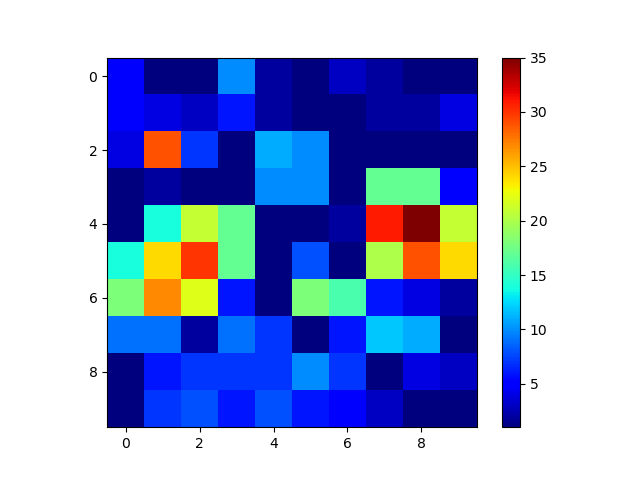

In [506]:
plt.imshow(feat.count_peaks(fitlists), cmap = 'jet')
plt.colorbar()

In [520]:
mask = ((grid_xyz > 0).all(axis = 1).reshape(ni, nj))

In [530]:
%pdb

Automatic pdb calling has been turned ON


In [532]:
nclust = 5

In [534]:
activations_n1.shape

(13, 10, 800)

In [533]:
clust, sorter, clust_cms = feat.do_clust(grid_sim_patterns.reshape(ni, nj, -1)[mask], activations_n1[:, mask], nclust, ctype = 'agglom', linkage='ward',
                                        affinity='euclidean')

IndexError: boolean index did not match indexed array along dimension 2; dimension is 800 but corresponding boolean dimension is 10

> <ipython-input-533-791709772a1f>(1)<module>()
----> 1 clust, sorter, clust_cms = feat.do_clust(grid_sim_patterns.reshape(ni, nj, -1)[mask], activations_n1[:, mask], nclust, ctype = 'agglom', linkage='ward',
      2                                         affinity='euclidean')

ipdb> c


In [531]:
nclust = 2
def cmp_clust(nclust, patterns, activations_n1, mask):
    clust, sorter, clust_cms = feat.do_clust(patterns[mask], activations_n1[:, mask], nclust, ctype = 'agglom', linkage='ward',
                                            affinity='euclidean')

    plt.subplot(1, 2, 1)
    d3d.plot_clusters_grid(d3d.get_coords(d3d.dgrid), clust, nclust)


    plt.subplot(1, 2, 2)
    d3d.plot_clusters_grid(d3d.get_coords(dgrid), y, 11)

    from sklearn.metrics import adjusted_mutual_info_score as ami
    from sklearn.metrics import adjusted_rand_score as rand

    ami(y, clust), rand(y, clust)
    return clust

    
clust = cmp_clust(nclust, grid_sim_patterns.reshape(ni, nj, -1), transpose_x_3d_inv(grid_sim_patterns.reshape(ni, nj, -1)), mask)

<IPython.core.display.Javascript object>

IndexError: index 30 is out of bounds for axis 0 with size 30

> /home/ollie/anaconda3/lib/python3.8/site-packages/xrdc-1.0-py3.8.egg/xrdc/datasets/d3d.py(69)plot_clusters_grid()
     67     cg = cluster_grid = np.zeros(shape = (dim,dim,3))
     68     for k, (x, y) in enumerate(coordi):
---> 69         cluster = clust[k]
     70         cluster_grid[x, y] = matplotlib.colors.hsv_to_rgb([hues[cluster],1,1])
     71 #     if debug:

ipdb> l
     64     dim = coords.max()
     65     coordi = coords - 1
     66     hues = [float(float(x)/float(nclust)) for x in range(1,nclust+1)]
     67     cg = cluster_grid = np.zeros(shape = (dim,dim,3))
     68     for k, (x, y) in enumerate(coordi):
---> 69         cluster = clust[k]
     70         cluster_grid[x, y] = matplotlib.colors.hsv_to_rgb([hues[cluster],1,1])
     71 #     if debug:
     72 #         print(coords)
     73 
     74 #     fig = plt.figure()

ipdb> coords
array([[ 6,  1],
       [ 7,  1],
       [ 8,  1],
       [ 9,  1],
       [10,  1],
       [ 4,  2],
       [ 5,  2],
       [ 6,  2]

In [199]:
[get_coord_pat(c) for c in cgrid];

In [157]:
len(compositions)

10

In [50]:
q, i = xdu.to_q(pat.x), pat.y
res = xdu.mk_pattern(i, q, .01)

In [494]:
%matplotlib notebook

In [495]:
plt.plot(res)

<IPython.core.display.Javascript object>

In [332]:
samples

array([[0.  , 0.  , 0.1 ],
       [0.  , 0.01, 0.09],
       [0.  , 0.02, 0.08],
       [0.  , 0.03, 0.07],
       [0.  , 0.04, 0.06],
       [0.  , 0.05, 0.05],
       [0.  , 0.06, 0.04],
       [0.  , 0.07, 0.03],
       [0.  , 0.08, 0.02],
       [0.  , 0.09, 0.01],
       [0.  , 0.1 , 0.  ],
       [0.01, 0.  , 0.09],
       [0.01, 0.01, 0.08],
       [0.01, 0.02, 0.07],
       [0.01, 0.03, 0.06],
       [0.01, 0.04, 0.05],
       [0.01, 0.05, 0.04],
       [0.01, 0.06, 0.03],
       [0.01, 0.07, 0.02],
       [0.01, 0.08, 0.01],
       [0.01, 0.09, 0.  ],
       [0.02, 0.  , 0.08],
       [0.02, 0.01, 0.07],
       [0.02, 0.02, 0.06],
       [0.02, 0.03, 0.05],
       [0.02, 0.04, 0.04],
       [0.02, 0.05, 0.03],
       [0.02, 0.06, 0.02],
       [0.02, 0.07, 0.01],
       [0.02, 0.08, 0.  ],
       [0.03, 0.  , 0.07],
       [0.03, 0.01, 0.06],
       [0.03, 0.02, 0.05],
       [0.03, 0.03, 0.04],
       [0.03, 0.04, 0.03],
       [0.03, 0.05, 0.02],
       [0.03, 0.06, 0.01],
 

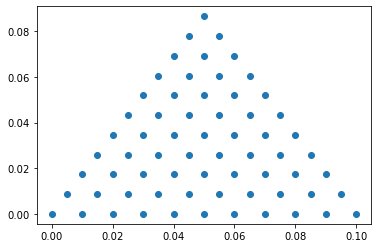

In [193]:
plt.scatter(*np.array(project_sequence(samples)))

In [52]:
pattern.y.shape

(7,)

In [536]:
grid_sim_patterns.shape

(100, 800)

In [542]:
%matplotlib inline

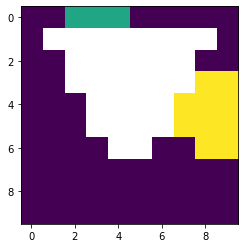

In [543]:
qi = 400
tmp = grid_sim_patterns.reshape(ni, nj, -1).copy()
tmp[mask] = np.nan
plt.imshow(tmp[:, :, qi])

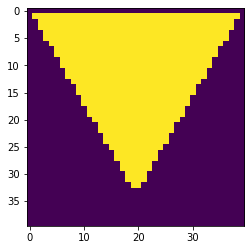

In [570]:
plt.imshow(mask)

In [583]:
from importlib import reload
reload(vis.k3d)

<module 'k3d' from '/home/ollie/anaconda3/lib/python3.8/site-packages/k3d/__init__.py'>

In [584]:
plot, volume1 = vis.heatmap3d(mask[:, :, None] * grid_sim_patterns.reshape(ni, nj, -1), interpolation = False);

Output()

array(['NbCoSn/Nb6Co7_mp-7250_computed.cif',
       'NbCoSn/Nb3Sn_mp-1326_computed.cif',
       'NbCoSn/Nb_mp-75_computed.cif'], dtype='<U37')

In [660]:
np.random.seed(44)
rpaths = np.random.choice(paths, size = 3)

structures = [get_structure(p) for p in rpaths]
pats = [get_pat(p) for p in rpaths]
compositions = np.vstack([get_composition(s) for s in structures])


N = len(pats)

In [661]:
ni = nj = 15
simplex_xx, simplex_yy = np.meshgrid(np.linspace(0, 1, ni), np.linspace(0, 1, nj))

simplex_xy = np.vstack((simplex_xx.ravel(), simplex_yy.ravel())).T

iii, jjj = np.indices((ni, nj))
iii = iii.ravel()
jjj = jjj.ravel()

grid_xyz = np.array([planar_to_coordinates(s, 1) for s in simplex_xy])
mask = (grid_xyz > 0).all(axis = 1).reshape(ni, nj)

#grid_sim_patterns = get_coord_pat(grid_xyz)
grid_sim_patterns = get_coord_pat_mixed(grid_xyz)

nrange = max(ni, nj)
m3d = np.zeros((nrange, nrange, grid_sim_patterns.shape[-1]))

to_3d = []
to_2d = np.zeros((nrange, nrange)).astype(int)

for i in range(len(grid_sim_patterns)):
    ii, jj = iii[i], jjj[i]
    m3d[ii, jj, :] = grid_sim_patterns[i]
    to_3d.append((ii, jj))
    to_2d[ii, jj] = int(i)
    
noise_scale = .01
m3d = m3d * (1 + noise_scale * np.random.normal(size = m3d.shape))

In [662]:
plot, volume1 = vis.heatmap3d(mask[:, :, None] * grid_sim_patterns.reshape(ni, nj, -1), interpolation = False);

Output()

In [665]:
background, fast_q, slow_T, fast_T = sep.separate_signal(m3d, background_after_filter = False,
                                 threshold = .5, smooth_q = 1.7, smooth_neighbor_background = 0,
                                 bg_fill_method = 'simple')

(0, 0, 0)


In [666]:
fsub_stop_2d = pf.curvefit_2d((m3d - 0), stdratio_threshold = 3,
                noise_estimate = (m3d * noise_scale * np.random.normal(size = m3d.shape)),
                  background = background, bg_shift_pos = False, fit_sigma = True)

numBlocks: 182, dataPts/Block: 4.395604395604396
[  0. 121. 127. 155. 172. 207. 223. 251. 272. 280. 319. 384. 427. 462.
 511. 537. 552. 572. 608. 639. 654. 685. 708. 746. 773. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 121.0], [121.0, 127.0], [127.0, 155.0], [155.0, 172.0], [172.0, 207.0], [207.0, 223.0], [223.0, 251.0], [251.0, 272.0], [272.0, 280.0], [280.0, 319.0], [319.0, 384.0], [384.0, 427.0], [427.0, 462.0], [462.0, 511.0], [511.0, 537.0], [537.0, 552.0], [552.0, 572.0], [572.0, 608.0], [608.0, 639.0], [639.0, 654.0], [654.0, 685.0], [685.0, 708.0], [708.0, 746.0], [746.0, 773.0], [773.0, 799.0]]}
global background
[ 1.52312827e-02  8.84284731e-03  4.96876460e-03  2.34397200e-03
  8.97029487e-04  2.57064323e-04  5.85935018e-05  1.26620546e-05
  1.22801822e-05  2.34379386e-05  3.60060732e-05  4.13623741e-05
  3.47556219e-05  2.22492821e-05  9.85063011e-06  1.93485316e-06
 -1.89528866e-06 -3.07258513e-06 -3.23923510e-06 -3.10477440e-06
 -2.90310794e-06 -2.68

/home/ollie/anaconda3/lib/python3.8/site-packages/scipy/optimize/minpack.py:828: OptimizeWarning: Covariance of the parameters could not be estimated
  warnings.warn('Covariance of the parameters could not be estimated',


Peak at 143, start iteration with error = 0.38405255876792166
137.27477634542493
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.38592967501742964
137.3483819471433
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 1: error = 0.3810554176585434
bounds ([125.65, -2.21147194418545, 0, 0, 0, 125.65, -2.21147194418545, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf, 27.0, 27.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 164, start iteration with error = 0.5656158801250294
84.73903179918183
[155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171]
Peak at 164, iteration 0: error = 0.19336197445372547
26.14890675081288
[155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171]
Peak at 164, i

Peak at 531, iteration 0: error = 0.15167007601616805
22.37010023693093
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536]
Peak at 531, iteration 1: error = 0.11828055313457572
bounds ([509.75, -1.0143665741745689, 0, 0, 0, 509.75, -1.0143665741745689, 0, 0, 0], [537.25, inf, inf, 25.0, 25.0, 537.25, inf, inf, 25.0, 25.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536]
Peak at 543, start iteration with error = 0.5652615340459499
116.50384543059158
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551]
Peak at 543, iteration 0: error = 0.274489723152363
67.1309946465147
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551]
Peak at 543, iteration 1: error = 0.18983352265529144
bounds ([536.3, -1.1016172977331338, 0, 0, 0, 536.3, -1.1016172977331338, 0, 0, 0], [551.7, inf, inf, 14.0, 14.0, 551.7, inf, inf, 14.0, 14.0])
[537 538 539 540 541 542 543 544 545 546 

Peak at 99, iteration 0: error = 0.06865080439041572
117.2180699923172
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.06865080347218465
bounds ([-4.95, -1.4893500415316923, 0, 0, 0, -4.95, -1.4893500415316923, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  5

Peak at 531, start iteration with error = 0.38786191556084326
96.3219982807513
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536]
Peak at 531, iteration 0: error = 0.25415136931401866
77.27164608460197
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536]
Peak at 531, iteration 1: error = 0.23674715989075296
bounds ([509.75, -1.0276431083639477, 0, 0, 0, 509.75, -1.0276431083639477, 0, 0, 0], [537.25, inf, inf, 25.0, 25.0, 537.25, inf, inf, 25.0, 25.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536]
Peak at 543, start iteration with error = 0.5665786550784552
103.28897556355362
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551]
Peak at 543, iteration 0: error = 0.23945947062859183
54.585211983713364
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551]
Peak at 543, iteration 1: error = 0.1998752109542

Peak at 99, iteration 0: error = 0.06877128822915794
91.05502926894165
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.06877128831040116
bounds ([-4.95, -1.4248618848211123, 0, 0, 0, -4.95, -1.4248618848211123, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  5

Peak at 411, start iteration with error = 0.13534053817856267
108.82395157957102
[372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426]
Peak at 411, iteration 0: error = 0.08795332257502086
73.52772991588839
[372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425
 426]
Peak at 411, iteration 1: error = 0.08790091625295574
bounds ([369.3, -0.1668664276267763, 0, 0, 0, 369.3, -0.1668664276267763, 0, 0, 0], [428.7, inf, inf, 54.0, 54.0, 428.7, inf, inf, 54.0, 54.0])
[372 373 374 375 376 377 378 379 380 381 382 383 384 385 386 387 388 389
 390 391 392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407
 408 409 410 411 412 413 414 415 416 417 418 419 420 

    ----Saving data for block between 1.00 - 120.00
    ----Saving data for block between 121.00 - 126.00
    ----Saving data for block between 127.00 - 148.00
    ----Saving data for block between 149.00 - 171.00
    ----Saving data for block between 172.00 - 206.00
    ----Saving data for block between 207.00 - 221.00
    ----Saving data for block between 222.00 - 250.00
    ----Saving data for block between 251.00 - 266.00
    ----Saving data for block between 267.00 - 279.00
    ----Saving data for block between 280.00 - 318.00
    ----Saving data for block between 319.00 - 365.00
    ----Saving data for block between 366.00 - 371.00
    ----Saving data for block between 372.00 - 426.00
    ----Saving data for block between 427.00 - 461.00
    ----Saving data for block between 462.00 - 510.00
    ----Saving data for block between 511.00 - 532.00
    ----Saving data for block between 533.00 - 551.00
    ----Saving data for block between 552.00 - 571.00
    ----Saving data for block 

Peak at 143, start iteration with error = 0.37169989741012205
125.24777927360797
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.37507891413331657
125.37685128559541
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 1: error = 0.3688644651713617
bounds ([125.65, -2.0639630674278573, 0, 0, 0, 125.65, -2.0639630674278573, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf, 27.0, 27.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 164, start iteration with error = 0.5820810709014868
122.06358577199578
[155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 164, iteration 0: error = 0.22073552699190152
55.54492512143163
[155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]


Peak at 531, iteration 1: error = 0.1054354531061871
bounds ([509.95, -0.9162893537453811, 0, 0, 0, 509.95, -0.9162893537453811, 0, 0, 0], [533.05, inf, inf, 21.0, 21.0, 533.05, inf, inf, 21.0, 21.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532]
Peak at 543, start iteration with error = 0.5083541924952049
80.7540527191577
[533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551]
Peak at 543, iteration 0: error = 0.5083234666120198
79.16599018637434
[533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551]
Peak at 543, iteration 1: error = 0.5132720489919835
bounds ([532.1, -0.9944538813868268, 0, 0, 0, 532.1, -0.9944538813868268, 0, 0, 0], [551.9, inf, inf, 18.0, 18.0, 551.9, inf, inf, 18.0, 18.0])
[533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551]
Peak at 562, start iteration with error = 0.37251016820550914
153.5097280194542
[552 553 554 555 556 557 558 559 560 561 562 

Peak at 99, iteration 1: error = 0.06876685693080979
bounds ([-4.95, -1.1686863763089659, 0, 0, 0, -4.95, -1.1686863763089659, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 126, start iteration with error = 0.26119711601399287
66.46873883138146
[121 122 123 124 125 126]
Peak at 126, iteration 0: error = 0.2631360200455752
61.05143591449661
[121 122 123 124 125 126]
Peak at 126, iteration 1: error = 0.1841507926876338
bounds ([120.75, -0.23214047528009552, 0, 0, 0, 120.7

Peak at 411, start iteration with error = 0.14416806521710834
111.28319717954604
[384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 411, iteration 0: error = 0.09329685581585226
78.20999877589398
[384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 411, iteration 1: error = 0.09090766408771499
bounds ([381.6, -0.13784402900581488, 0, 0, 0, 381.6, -0.13784402900581488, 0, 0, 0], [434.4, inf, inf, 48.0, 48.0, 434.4, inf, inf, 48.0, 48.0])
[384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 469, start iteration with error = 0.101

    ----Saving data for block between 638.00 - 652.00
    ----Saving data for block between 653.00 - 684.00
    ----Saving data for block between 685.00 - 700.00
    ----Saving data for block between 701.00 - 720.00
    ----Saving data for block between 721.00 - 745.00
    ----Saving data for block between 746.00 - 772.00
    ----Saving data for block between 773.00 - 798.00
done
numBlocks: 184, dataPts/Block: 4.3478260869565215
[  0. 121. 127. 155. 174. 188. 219. 252. 270. 284. 319. 324. 366. 403.
 433. 510. 517. 538. 557. 574. 609. 631. 652. 672. 701. 721. 746. 773.
 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 121.0], [121.0, 127.0], [127.0, 155.0], [155.0, 174.0], [174.0, 188.0], [188.0, 219.0], [219.0, 252.0], [252.0, 270.0], [270.0, 284.0], [284.0, 319.0], [319.0, 324.0], [324.0, 366.0], [366.0, 403.0], [403.0, 433.0], [433.0, 510.0], [510.0, 517.0], [517.0, 538.0], [538.0, 557.0], [557.0, 574.0], [574.0, 609.0], [609.0, 631.0], [631.0, 652.0], [652.0, 672.0]

Peak at 143, start iteration with error = 0.32069368131321546
83.06666381169627
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.2518429002443229
76.38409016175262
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 1: error = 0.2589841843016237
bounds ([125.65, -1.366699208088308, 0, 0, 0, 125.65, -1.366699208088308, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf, 27.0, 27.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 172, start iteration with error = 0.5886796159735262
79.13227624818578
[155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172
 173]
Peak at 172, iteration 0: error = 0.5310223366536505
72.45396247599618
[155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172
 17

Peak at 550, start iteration with error = 0.5290612272660663
139.82975597433398
[538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556]
Peak at 550, iteration 0: error = 0.28552474236208564
74.90796728939617
[538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556]
Peak at 550, iteration 1: error = 0.05643876453287674
bounds ([537.1, -1.0809168585339217, 0, 0, 0, 537.1, -1.0809168585339217, 0, 0, 0], [556.9, inf, inf, 18.0, 18.0, 556.9, inf, inf, 18.0, 18.0])
[538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556]
Peak at 562, start iteration with error = 0.3183752310226968
83.44092105956427
[557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573]
Peak at 562, iteration 0: error = 0.288457589186957
79.15577271356887
[557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573]
Peak at 562, iteration 1: error = 0.28490334047041976
bounds ([556.2, -0.6565229236328286, 0, 0, 0, 556.2, -0.65652292363282

Peak at 99, iteration 1: error = 0.07315457239812156
bounds ([30.75, -0.622395661540602, 0, 0, 0, 30.75, -0.622395661540602, 0, 0, 0], [124.25, inf, inf, 85.0, 85.0, 124.25, inf, inf, 85.0, 85.0])
[ 35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52
  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70
  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88
  89  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106
 107 108 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 126, start iteration with error = 0.17455004310426905
234.70674073802414
[121 122 123 124 125 126]
Peak at 126, iteration 0: error = 0.133667321368167
148.4567702182021
[121 122 123 124 125 126]
Peak at 126, iteration 1: error = 0.145688651187336
bounds ([120.75, -0.12825059726231797, 0, 0, 0, 120.75, -0.12825059726231797, 0, 0, 0], [126.25, inf, inf, 5.0, 5.0, 126.25, inf, inf, 5.0, 5.0])
[121 122 123 124 125 126]
Peak at 143, start iterati

Peak at 470, iteration 0: error = 0.08521950658047982
116.42630351565494
[420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509]
Peak at 470, iteration 1: error = 0.08521385588676235
bounds ([415.55, -0.45694118749409685, 0, 0, 0, 415.55, -0.45694118749409685, 0, 0, 0], [513.45, inf, inf, 89.0, 89.0, 513.45, inf, inf, 89.0, 89.0])
[420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 

    ----Saving data for block between 403.00 - 419.00
    ----Saving data for block between 420.00 - 509.00
    ----Saving data for block between 510.00 - 517.00
    ----Saving data for block between 518.00 - 537.00
    ----Saving data for block between 538.00 - 552.00
    ----Saving data for block between 553.00 - 572.00
    ----Saving data for block between 573.00 - 608.00
    ----Saving data for block between 609.00 - 630.00
    ----Saving data for block between 631.00 - 665.00
    ----Saving data for block between 666.00 - 684.00
    ----Saving data for block between 685.00 - 700.00
    ----Saving data for block between 701.00 - 720.00
    ----Saving data for block between 721.00 - 746.00
    ----Saving data for block between 747.00 - 771.00
    ----Saving data for block between 772.00 - 798.00
done
numBlocks: 181, dataPts/Block: 4.419889502762431
[  0.  35. 137. 156. 178. 207. 217. 252. 267. 284. 289. 319. 325. 366.
 378. 464. 473. 526. 532. 554. 564. 610. 631. 666. 672. 693. 721.

Peak at 99, iteration 1: error = 0.06420120859434804
bounds ([29.95, -0.37248354221201474, 0, 0, 0, 29.95, -0.37248354221201474, 0, 0, 0], [141.05, inf, inf, 101.0, 101.0, 141.05, inf, inf, 101.0, 101.0])
[ 35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52
  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70
  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88
  89  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106
 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124
 125 126 127 128 129 130 131 132 133 134 135 136]
Peak at 143, start iteration with error = 0.2916416212639985
143.90350543398606
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155]
Peak at 143, iteration 0: error = 0.05816598692141721
18.23242651280474
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155]
Peak at 143, iteration 1: error = 0.05490505834753137
bounds ([136.1, 

Peak at 470, iteration 1: error = 0.0175928437346496
bounds ([463.6, -0.2779473233665957, 0, 0, 0, 463.6, -0.2779473233665957, 0, 0, 0], [472.4, inf, inf, 8.0, 8.0, 472.4, inf, inf, 8.0, 8.0])
[464 465 466 467 468 469 470 471 472]
Peak at 517, start iteration with error = 0.10331527137571116
113.9544106379817
[473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525]
Peak at 517, iteration 0: error = 0.10154140812041118
113.59038678049046
[473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525]
Peak at 517, iteration 1: error = 0.1014699443436392
bounds ([470.4, -0.4174038879543967, 0, 0, 0, 470.4, -0.4174038879543967, 0, 0, 0], [527.6, inf, inf, 52.0, 52.0, 527.6, inf, inf, 

Peak at 34, iteration 1: error = 0.05940111383175106
bounds ([-0.7000000000000002, -0.21328513989826922, 0, 0, 0, -0.7000000000000002, -0.21328513989826922, 0, 0, 0], [36.7, inf, inf, 34.0, 34.0, 36.7, inf, inf, 34.0, 34.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35]
Peak at 100, start iteration with error = 0.04031647585295371
114.56002812924014
[ 36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136]
Peak at 100, iteration 0: error = 0.040317207043999916
114.56008272190398
[ 36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60

Peak at 371, start iteration with error = 0.16546988910715738
118.01446896451039
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 371, iteration 0: error = 0.05388842476280269
36.88071777027906
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 371, iteration 1: error = 0.031990511714148274
bounds ([364.4, -0.13056467653700152, 0, 0, 0, 364.4, -0.13056467653700152, 0, 0, 0], [377.6, inf, inf, 12.0, 12.0, 377.6, inf, inf, 12.0, 12.0])
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 382, start iteration with error = 0.1501120586961136
94.72015188827578
[378 379 380 381 382]
Peak at 382, iteration 0: error = 0.12028346243680361
73.39853971647176
[378 379 380 381 382]
Peak at 382, iteration 1: error = 0.013847398274967181
bounds ([377.8, -0.11271891140102247, 0, 0, 0, 377.8, -0.11271891140102247, 0, 0, 0], [382.2, inf, inf, 4.0, 4.0, 382.2, inf, inf, 4.0, 4.0])
[378 379 380 381 382]
Peak at 470, start iteration with error = 0.053197124088487806
114.318

Peak at 727, iteration 1: error = 0.04658096688480912
bounds ([720.35, -0.23825626636336228, 0, 0, 0, 720.35, -0.23825626636336228, 0, 0, 0], [734.65, inf, inf, 13.0, 13.0, 734.65, inf, inf, 13.0, 13.0])
[721 722 723 724 725 726 727 728 729 730 731 732 733 734]
Peak at 754, start iteration with error = 0.20276618122326204
154.21595602601792
[735 736 737 738 739 740 741 742 743 744 745 746 747 748 749 750 751 752
 753 754 755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770
 771]
Peak at 754, iteration 0: error = 0.07097959348123285
25.741180258241855
[735 736 737 738 739 740 741 742 743 744 745 746 747 748 749 750 751 752
 753 754 755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770
 771]
Peak at 754, iteration 1: error = 0.07061963357749929
bounds ([733.2, -1.2526852496395136, 0, 0, 0, 733.2, -1.2526852496395136, 0, 0, 0], [772.8, inf, inf, 36.0, 36.0, 772.8, inf, inf, 36.0, 36.0])
[735 736 737 738 739 740 741 742 743 744 745 746 747 748 749 750 751 752
 753 754 

 3.48025505e-03 1.06654774e-02]
global background
[0.02485227 0.04968676 0.08361206 0.11789139 0.15179895 0.16529352
 0.15096885 0.11728906 0.07464843 0.04800274 0.05147015 0.09304181
 0.16538169 0.22940545 0.26141853 0.24764265 0.22572299 0.22288784
 0.26758103 0.315959   0.32101089 0.28827637]
[0.02485227 0.04968676 0.08361206 0.11789139 0.15179895 0.16529352
 0.15096885 0.11728906 0.07464843 0.04800274 0.05147015 0.09304181
 0.16538169 0.22940545 0.26141853 0.24764265 0.22572299 0.22288784
 0.26758103 0.315959   0.32101089 0.28827637]
global background
[0.24161667 0.17941439 0.12609226 0.07479376 0.03883289 0.01760778
 0.00834911 0.0049465  0.00328993 0.00222763 0.00169399 0.0018478
 0.00310366 0.00809531 0.02401671 0.06749648 0.14854172 0.26662054
 0.37310329 0.4147976  0.35289895]
[0.24161667 0.17941439 0.12609226 0.07479376 0.03883289 0.01760778
 0.00834911 0.0049465  0.00328993 0.00222763 0.00169399 0.0018478
 0.00310366 0.00809531 0.02401671 0.06749648 0.14854172 0.26662054
 0.

Peak at 289, iteration 0: error = 0.11143624991039072
36.12084856281736
[286 287 288 289 290 291 292 293 294 295 296 297 298 299 300 301 302 303
 304 305 306 307 308 309 310 311 312 313 314 315 316 317 318]
Peak at 289, iteration 1: error = 0.09292378386617234
bounds ([284.4, -0.3010699196143637, 0, 0, 0, 284.4, -0.3010699196143637, 0, 0, 0], [319.6, inf, inf, 32.0, 32.0, 319.6, inf, inf, 32.0, 32.0])
[286 287 288 289 290 291 292 293 294 295 296 297 298 299 300 301 302 303
 304 305 306 307 308 309 310 311 312 313 314 315 316 317 318]
Peak at 323, start iteration with error = 0.09273967743829073
117.40632671436813
[319 320 321 322 323]
Peak at 323, iteration 0: error = 0.06757941385555821
82.48690098194099
[319 320 321 322 323]
Peak at 323, iteration 1: error = 0.04306589670256755
bounds ([318.8, -0.06361114440155248, 0, 0, 0, 318.8, -0.06361114440155248, 0, 0, 0], [323.2, inf, inf, 4.0, 4.0, 323.2, inf, inf, 4.0, 4.0])
[319 320 321 322 323]
Peak at 339, start iteration with error = 0.0

Peak at 727, start iteration with error = 0.08743746741121738
103.02734550853711
[708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728]
Peak at 727, iteration 0: error = 0.08542134359549125
99.31052945030744
[708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728]
Peak at 727, iteration 1: error = 0.08192952201491593
bounds ([707.0, -0.10369939956037401, 0, 0, 0, 707.0, -0.10369939956037401, 0, 0, 0], [729.0, inf, inf, 20.0, 20.0, 729.0, inf, inf, 20.0, 20.0])
[708 709 710 711 712 713 714 715 716 717 718 719 720 721 722 723 724 725
 726 727 728]
Peak at 754, start iteration with error = 0.24643514009463352
63.44276745959654
[729 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746
 747 748 749 750 751 752 753 754 755 756 757 758]
Peak at 754, iteration 0: error = 0.04482425333977285
4.713815778671261
[729 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746
 747 748 749 750 751 752 753 754 755 7

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 172, iteration 0: error = 0.1050590607939691
135.24722884125603
[ 38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55
  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73
  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91
  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109
 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127
 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145
 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163
 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181
 182 183 184]
Peak at 172, iteration 1: error = 0.09097719759431286
bounds ([30.7, -4.559691380437845, 0, 0, 0, 30.7, -4.559691380437845, 0, 0, 0], [191.3, inf, inf, 146.0, 146.0, 191.3, inf, inf, 146.0, 146.0])
[ 38  39  40  41  42  43  44  45  46  47  48  

Peak at 643, iteration 0: error = 0.07093968486980189
75.75988769914304
[589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606
 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624
 625 626 627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642
 643 644 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660
 661 662 663 664 665 666 667 668 669 670 671 672 673 674 675 676 677 678
 679 680 681 682 683 684 685 686 687 688 689 690 691 692 693]
Peak at 643, iteration 1: error = 0.07093906679851136
bounds ([583.8, -1.852535277030974, 0, 0, 0, 583.8, -1.852535277030974, 0, 0, 0], [698.2, inf, inf, 104.0, 104.0, 698.2, inf, inf, 104.0, 104.0])
[589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606
 607 608 609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624
 625 626 627 628 629 630 631 632 633 634 635 636 637 638 639 640 641 642
 643 644 645 646 647 648 649 650 651 652 653 654 655 656 657 658 659 660
 661 662 

Peak at 172, iteration 1: error = 0.0645825531090528
bounds ([30.7, -4.553035361688124, 0, 0, 0, 30.7, -4.553035361688124, 0, 0, 0], [191.3, inf, inf, 146.0, 146.0, 191.3, inf, inf, 146.0, 146.0])
[ 38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55
  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73
  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91
  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109
 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127
 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145
 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163
 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181
 182 183 184]
Peak at 227, start iteration with error = 0.15215373037224425
119.25829129990241
[185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202
 203 204 205 206 207 208 209 210 211 212 213 214 21

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 643, iteration 1: error = 0.04872532513392377
bounds ([630.0, -1.8446167007608385, 0, 0, 0, 630.0, -1.8446167007608385, 0, 0, 0], [696.0, inf, inf, 60.0, 60.0, 696.0, inf, inf, 60.0, 60.0])
[633 634 635 636 637 638 639 640 641 642 643 644 645 646 647 648 649 650
 651 652 653 654 655 656 657 658 659 660 661 662 663 664 665 666 667 668
 669 670 671 672 673 674 675 676 677 678 679 680 681 682 683 684 685 686
 687 688 689 690 691 692 693]
Peak at 700, start iteration with error = 0.10452134086947593
83.06959757246477
[694 695 696 697 698 699 700 701 702 703]
Peak at 700, iteration 0: error = 0.007554075595321216
5.059035456960347
[694 695 696 697 698 699 700 701 702 703]
Peak at 700, iteration 1: error = 0.0025659565315713667
bounds ([693.55, -0.06736500579176914, 0, 0, 0, 693.55, -0.06736500579176914, 0, 0, 0], [703.45, inf, inf, 9.0, 9.0, 703.45, inf, inf, 9.0, 9.0])
[694 695 696 697 698 699 700

Peak at 34, iteration 0: error = 0.028847896049806348
177.43677749179136
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137]
Peak at 34, iteration 1: error = 0.02884789641873116
bounds ([-5.800000000000001, -0.2519002773520494, 0, 0, 0, -5.800000000000001, -0.2519002773520494, 0, 0, 0], [143.8, inf, inf, 136.0, 136.0, 143.8, inf, inf, 136.0, 136.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  

Peak at 445, iteration 0: error = 0.024191239480488767
79.81541076079901
[384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508]
Peak at 445, iteration 1: error = 0.02418459111776419
bounds ([377.8, -0.08068414669181048, 0, 0, 0, 377.8, -0.08068414669181048, 0, 0, 0], [514.2, inf, inf, 124.0, 124.0, 514.2, inf, inf, 124.0, 124.0])
[384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400 401
 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 

Peak at 34, iteration 0: error = 0.03358438644233626
107.82436072712613
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
Peak at 34, iteration 1: error = 0.03358438628815738
bounds ([-3.6500000000000004, -0.2244486545434572, 0, 0, 0, -3.6500000000000004, -0.2244486545434572, 0, 0, 0], [98.65, inf, inf, 93.0, 93.0, 98.65, inf, inf, 93.0, 93.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
Peak at 99, start iteration with error = 0.11423966528072722
127.94886224681736
[ 95  96  97  98  99 100]
Peak at 99, iteration 0

Peak at 445, iteration 0: error = 0.05516588052626834
88.63116096314947
[441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464]
Peak at 445, iteration 1: error = 0.055119549600919214
bounds ([439.85, -0.07316869283309728, 0, 0, 0, 439.85, -0.07316869283309728, 0, 0, 0], [465.15, inf, inf, 23.0, 23.0, 465.15, inf, inf, 23.0, 23.0])
[441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464]
Peak at 470, start iteration with error = 0.02989347630787598
95.89791850147594
[465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508]
Peak at 470, iteration 0: error = 0.02948924926472326
95.62598449255069
[465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508]
Peak at 470, 

Peak at 99, iteration 1: error = 0.07355445252518172
bounds ([94.75, -0.10349161694681713, 0, 0, 0, 94.75, -0.10349161694681713, 0, 0, 0], [100.25, inf, inf, 5.0, 5.0, 100.25, inf, inf, 5.0, 5.0])
[ 95  96  97  98  99 100]
Peak at 143, start iteration with error = 0.06694318190358682
130.82463128529065
[101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156 157]
Peak at 143, iteration 0: error = 0.06209233491021517
125.00020244721854
[101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156 157]
Peak at 143, iteration 1: error = 0.035697133786857314
bounds ([98.2, -0.15885097944229892, 0, 0, 0, 98.2, -0.15885097944229892, 0, 0, 0], [159.8, inf, inf, 

Peak at 470, start iteration with error = 0.12751551137833972
59.671538249277816
[465 466 467 468 469 470 471]
Peak at 470, iteration 0: error = 0.09058406603836884
33.806919963282716
[465 466 467 468 469 470 471]
Peak at 470, iteration 1: error = 0.03041251543257393
bounds ([464.7, -0.09565775353633214, 0, 0, 0, 464.7, -0.09565775353633214, 0, 0, 0], [471.3, inf, inf, 6.0, 6.0, 471.3, inf, inf, 6.0, 6.0])
[465 466 467 468 469 470 471]
Peak at 516, start iteration with error = 0.09714306779265565
88.5640803212748
[472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507
 508 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525
 526 527 528 529 530 531 532 533 534 535 536 537 538 539 540]
Peak at 516, iteration 0: error = 0.09419084415028946
87.91640405362436
[472 473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489
 490 491 492 493 494 495 496 497 498 499 500 501 502 50

Peak at 99, iteration 0: error = 0.06848162408117779
143.87212676488122
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.06848162408117779
bounds ([-4.95, -1.5386796234992526, 0, 0, 0, -4.95, -1.5386796234992526, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  

Peak at 411, iteration 0: error = 0.11888237960073292
112.26670021256041
[383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400
 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421 422 423 424 425 426]
Peak at 411, iteration 1: error = 0.11882823122658782
bounds ([380.85, -0.18218133754697255, 0, 0, 0, 380.85, -0.18218133754697255, 0, 0, 0], [428.15, inf, inf, 43.0, 43.0, 428.15, inf, inf, 43.0, 43.0])
[383 384 385 386 387 388 389 390 391 392 393 394 395 396 397 398 399 400
 401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421 422 423 424 425 426]
Peak at 431, start iteration with error = 0.09268200164236891
184.17079126693977
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461]
Peak at 431, iteration 0: error = 0.024728000532831192
42.391792318873826
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 

Peak at 781, iteration 1: error = 0.24811216776666076
bounds ([771.75, -0.9000510983288752, 0, 0, 0, 771.75, -0.9000510983288752, 0, 0, 0], [799.25, inf, inf, 25.0, 25.0, 799.25, inf, inf, 25.0, 25.0])
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 120.00
    ----Saving data for block between 121.00 - 126.00
    ----Saving data for block between 127.00 - 148.00
    ----Saving data for block between 149.00 - 170.00
    ----Saving data for block between 171.00 - 206.00
    ----Saving data for block between 207.00 - 222.00
    ----Saving data for block between 223.00 - 249.00
    ----Saving data for block between 250.00 - 267.00
    ----Saving data for block between 268.00 - 282.00
    ----Saving data for block between 283.00 - 327.00
    ----Saving data for block between 328.00 - 382.00
    ----Saving data for block between 383.00 - 426.00
    ----Saving data for block between 427.00 

Peak at 99, iteration 1: error = 0.06870357277555372
bounds ([-4.9, -1.5999236579701652, 0, 0, 0, -4.9, -1.5999236579701652, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 126, start iteration with error = 0.23407715017869055
168.84408159952616
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 126, iteration 0: error = 0.02037175227364015
14.380503511471117
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 126, iteration 1: error = 0.018

Peak at 531, iteration 1: error = 0.10646729332283901
bounds ([509.75, -1.1208604858988305, 0, 0, 0, 509.75, -1.1208604858988305, 0, 0, 0], [537.25, inf, inf, 25.0, 25.0, 537.25, inf, inf, 25.0, 25.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536]
Peak at 543, start iteration with error = 0.523345216709865
68.48925814445386
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 543, iteration 0: error = 0.26738575941446
34.20884800930885
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 543, iteration 1: error = 0.09032845953838636
bounds ([536.1, -1.1781696081789916, 0, 0, 0, 536.1, -1.1781696081789916, 0, 0, 0], [555.9, inf, inf, 18.0, 18.0, 555.9, inf, inf, 18.0, 18.0])
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 562, start iteration with error = 0.41689067839563454
162.26520900349357
[556 557 558 559 560 561 562

Peak at 126, iteration 1: error = 0.008428773100623262
bounds ([120.35, -0.31960987494376597, 0, 0, 0, 120.35, -0.31960987494376597, 0, 0, 0], [134.65, inf, inf, 13.0, 13.0, 134.65, inf, inf, 13.0, 13.0])
[121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 143, start iteration with error = 0.5964538797476685
205.0266359781917
[135 136 137 138 139 140 141 142 143 144 145 146 147 148]
Peak at 143, iteration 0: error = 0.07674278346710839
21.99281504028204
[135 136 137 138 139 140 141 142 143 144 145 146 147 148]
Peak at 143, iteration 1: error = 0.06945208076421402
bounds ([134.35, -2.419790060962379, 0, 0, 0, 134.35, -2.419790060962379, 0, 0, 0], [148.65, inf, inf, 13.0, 13.0, 148.65, inf, inf, 13.0, 13.0])
[135 136 137 138 139 140 141 142 143 144 145 146 147 148]
Peak at 164, start iteration with error = 0.48612700718951624
76.07515966848536
[149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166
 167 168 169 170]
Peak at 164, iteration 0: error = 0.17132

Peak at 531, start iteration with error = 0.3921074430975384
96.88368427295714
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536]
Peak at 531, iteration 0: error = 0.13285516921840806
17.495019631461048
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536]
Peak at 531, iteration 1: error = 0.0965825082398287
bounds ([509.75, -1.119468124402594, 0, 0, 0, 509.75, -1.119468124402594, 0, 0, 0], [537.25, inf, inf, 25.0, 25.0, 537.25, inf, inf, 25.0, 25.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536]
Peak at 543, start iteration with error = 0.5223750618944568
140.44947240968466
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 543, iteration 0: error = 0.2656951595408206
71.31473309742994
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 543, iterat

Peak at 143, start iteration with error = 0.38706601951757386
242.87309371587554
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.37663074273370356
241.61197132315306
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 1: error = 0.37476624216862
bounds ([125.65, -2.2743817993808975, 0, 0, 0, 125.65, -2.2743817993808975, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf, 27.0, 27.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 164, start iteration with error = 0.5640707090571001
158.77332634860676
[155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171]
Peak at 164, iteration 0: error = 0.17177599966294338
40.894692131854036
[155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171]
Peak at 1

Peak at 543, start iteration with error = 0.5676447528594232
109.60300118089651
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551]
Peak at 543, iteration 0: error = 0.2819776840451865
63.11288645104605
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551]
Peak at 543, iteration 1: error = 0.251640801715012
bounds ([536.3, -1.1145799959475702, 0, 0, 0, 536.3, -1.1145799959475702, 0, 0, 0], [551.7, inf, inf, 14.0, 14.0, 551.7, inf, inf, 14.0, 14.0])
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551]
Peak at 562, start iteration with error = 0.38123520777595243
97.51506367372563
[552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569
 570 571]
Peak at 562, iteration 0: error = 0.11275240585365273
24.131598201157896
[552 553 554 555 556 557 558 559 560 561 562 563 564 565 566 567 568 569
 570 571]
Peak at 562, iteration 1: error = 0.09860377018830327
bounds ([551.05, -1.0998649453988545, 0, 0, 0, 551.05, -1.0998649453988545, 0, 0, 0], [571.95,

Peak at 143, start iteration with error = 0.367734635439013
166.40023304525454
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.3634217192967332
166.10229989013953
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 1: error = 0.35937578422903876
bounds ([125.65, -1.9862842138243206, 0, 0, 0, 125.65, -1.9862842138243206, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf, 27.0, 27.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 164, start iteration with error = 0.5825548931345539
124.38522001803408
[155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 164, iteration 0: error = 0.22841331580355798
60.10568324829826
[155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Pe

Peak at 531, iteration 1: error = 0.1522091304622015
bounds ([509.95, -0.8985214473966556, 0, 0, 0, 509.95, -0.8985214473966556, 0, 0, 0], [533.05, inf, inf, 21.0, 21.0, 533.05, inf, inf, 21.0, 21.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532]
Peak at 543, start iteration with error = 0.4886363459558584
75.93955247140296
[533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556]
Peak at 543, iteration 0: error = 0.560686461085078
99.9984224448821
[533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556]
Peak at 543, iteration 1: error = 0.43931673537380495
bounds ([531.85, -0.9820901552332425, 0, 0, 0, 531.85, -0.9820901552332425, 0, 0, 0], [557.15, inf, inf, 23.0, 23.0, 557.15, inf, inf, 23.0, 23.0])
[533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556]
Peak at 562, start iteration with error = 0.38987014635583367

Peak at 99, iteration 0: error = 0.06779662634899983
168.0542224135578
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.06779662668295612
bounds ([-4.95, -0.9991755952298955, 0, 0, 0, -4.95, -0.9991755952298955, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  5

Peak at 470, iteration 1: error = 0.09845662289723613
bounds ([429.15, -0.72405426379701, 0, 0, 0, 429.15, -0.72405426379701, 0, 0, 0], [513.85, inf, inf, 77.0, 77.0, 513.85, inf, inf, 77.0, 77.0])
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 516, start iteration with error = 0.2649545254608427
51.57166619690052
[511 512 513 514 515 516]
Peak at 516, iteration 0: error = 0.21275505931248628
40.49416572444389
[511 512 513 514 515 516]
Peak at 516, iteration 1: error = 0.1566245047925873
bounds ([510.75, -0.275873817698191, 0, 0, 0, 510.75, -0.275873817698191, 0, 0, 0], [516.25, inf, inf, 5.0, 5.0, 516.25, inf, inf, 5.0, 5.0])
[511 512 513 514 515 516]
Peak at 531, start iteration with error = 0.3376098154054963

    ----Saving data for block between 1.00 - 120.00
    ----Saving data for block between 121.00 - 126.00
    ----Saving data for block between 127.00 - 154.00
    ----Saving data for block between 155.00 - 173.00
    ----Saving data for block between 174.00 - 206.00
    ----Saving data for block between 207.00 - 218.00
    ----Saving data for block between 219.00 - 250.00
    ----Saving data for block between 251.00 - 266.00
    ----Saving data for block between 267.00 - 280.00
    ----Saving data for block between 281.00 - 318.00
    ----Saving data for block between 319.00 - 323.00
    ----Saving data for block between 324.00 - 365.00
    ----Saving data for block between 366.00 - 402.00
    ----Saving data for block between 403.00 - 432.00
    ----Saving data for block between 433.00 - 510.00
    ----Saving data for block between 511.00 - 516.00
    ----Saving data for block between 517.00 - 537.00
    ----Saving data for block between 538.00 - 556.00
    ----Saving data for block 

Peak at 143, start iteration with error = 0.2878639847563581
66.86688009695482
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.10315063327300457
14.320244429041372
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 143, iteration 1: error = 0.09209811759177522
bounds ([125.65, -1.0578938658559314, 0, 0, 0, 125.65, -1.0578938658559314, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf, 27.0, 27.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 172, start iteration with error = 0.5716524951950999
80.14081879307687
[155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172
 173 174 175 176]
Peak at 172, iteration 0: error = 0.286386119

Peak at 550, start iteration with error = 0.5111960735710008
105.74000183751544
[538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556]
Peak at 550, iteration 0: error = 0.2609083484138199
47.3346839882292
[538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556]
Peak at 550, iteration 1: error = 0.10442324071624752
bounds ([537.1, -1.1906806556872789, 0, 0, 0, 537.1, -1.1906806556872789, 0, 0, 0], [556.9, inf, inf, 18.0, 18.0, 556.9, inf, inf, 18.0, 18.0])
[538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556]
Peak at 562, start iteration with error = 0.29171512063139876
163.95440629032447
[557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572]
Peak at 562, iteration 0: error = 0.05194119910591405
16.9465511415071
[557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572]
Peak at 562, iteration 1: error = 0.0337049557233182
bounds ([556.25, -0.5176555745151329, 0, 0, 0, 556.25, -0.5176555745151329, 0,

numBlocks: 183, dataPts/Block: 4.371584699453552
[  0.  35. 136. 156. 175. 207. 218. 252. 267. 282. 289. 299. 319. 325.
 366. 378. 464. 510. 526. 539. 558. 574. 610. 631. 666. 672. 693. 721.
 735. 773. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 35.0], [35.0, 136.0], [136.0, 156.0], [156.0, 175.0], [175.0, 207.0], [207.0, 218.0], [218.0, 252.0], [252.0, 267.0], [267.0, 282.0], [282.0, 289.0], [289.0, 299.0], [299.0, 319.0], [319.0, 325.0], [325.0, 366.0], [366.0, 378.0], [378.0, 464.0], [464.0, 510.0], [510.0, 526.0], [526.0, 539.0], [539.0, 558.0], [558.0, 574.0], [574.0, 610.0], [610.0, 631.0], [631.0, 666.0], [666.0, 672.0], [672.0, 693.0], [693.0, 721.0], [721.0, 735.0], [735.0, 773.0], [773.0, 799.0]]}
global background
[ 2.70281404e-02  2.05578896e-02  1.26102094e-02  6.20050811e-03
  2.37666045e-03  7.15301127e-04  1.60561209e-04  3.79350232e-05
  3.71658597e-05  6.72539208e-05  9.93666029e-05  1.10860964e-04
  9.58743294e-05  6.16857152e-05  2.79394695e-05

Peak at 143, iteration 1: error = 0.08722904061930968
bounds ([135.05, -0.6406740380040695, 0, 0, 0, 135.05, -0.6406740380040695, 0, 0, 0], [155.95, inf, inf, 19.0, 19.0, 155.95, inf, inf, 19.0, 19.0])
[136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153
 154 155]
Peak at 172, start iteration with error = 0.5318358636537165
89.96144763908379
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173
 174]
Peak at 172, iteration 0: error = 0.17080046865000229
13.000774490221811
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173
 174]
Peak at 172, iteration 1: error = 0.13518293384184574
bounds ([155.1, -2.5908551628500742, 0, 0, 0, 155.1, -2.5908551628500742, 0, 0, 0], [174.9, inf, inf, 18.0, 18.0, 174.9, inf, inf, 18.0, 18.0])
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173
 174]
Peak at 183, start iteration with error = 0.2635110105924582
100.2627515819688
[175 176 177 178 179 180 181 182 183 184 185 186 

Peak at 516, iteration 0: error = 0.07929165277569337
39.05402555569021
[510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525]
Peak at 516, iteration 1: error = 0.043981287424535886
bounds ([509.25, -0.381329723179329, 0, 0, 0, 509.25, -0.381329723179329, 0, 0, 0], [525.75, inf, inf, 15.0, 15.0, 525.75, inf, inf, 15.0, 15.0])
[510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525]
Peak at 530, start iteration with error = 0.24446140911502431
100.95745447283826
[526 527 528 529 530 531 532 533 534 535 536 537 538]
Peak at 530, iteration 0: error = 0.05801955021248181
16.968435806637064
[526 527 528 529 530 531 532 533 534 535 536 537 538]
Peak at 530, iteration 1: error = 0.03696199142173951
bounds ([525.4, -0.2854655620804665, 0, 0, 0, 525.4, -0.2854655620804665, 0, 0, 0], [538.6, inf, inf, 12.0, 12.0, 538.6, inf, inf, 12.0, 12.0])
[526 527 528 529 530 531 532 533 534 535 536 537 538]
Peak at 550, start iteration with error = 0.48646018909338934
94.93848176329494
[

Peak at 34, iteration 0: error = 0.03300256885887768
202.21729900491056
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92]
Peak at 34, iteration 1: error = 0.033002568858610755
bounds ([-3.55, -0.19492797431379716, 0, 0, 0, -3.55, -0.19492797431379716, 0, 0, 0], [96.55, inf, inf, 91.0, 91.0, 96.55, inf, inf, 91.0, 91.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92]
Peak at 99, start iteration with error = 0.08347877761586878
120.16450833183136
[ 93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111 112 113 

Peak at 382, iteration 0: error = 0.07620797724351258
136.45167463179658
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464]
Peak at 382, iteration 1: error = 0.07619515825966236
bounds ([373.7, -0.15963521875520809, 0, 0, 0, 373.7, -0.15963521875520809, 0, 0, 0], [468.3, inf, inf, 86.0, 86.0, 468.3, inf, inf, 86.0, 86.0])
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427 428 429 430 431
 432 433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449
 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464]
Peak at 470, start 

[  0.  95. 101. 158. 180. 207. 216. 258. 266. 283. 302. 319. 331. 364.
 378. 441. 465. 509. 540. 564. 591. 631. 666. 686. 721. 731. 759. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 95.0], [95.0, 101.0], [101.0, 158.0], [158.0, 180.0], [180.0, 207.0], [207.0, 216.0], [216.0, 258.0], [258.0, 266.0], [266.0, 283.0], [283.0, 302.0], [302.0, 319.0], [319.0, 331.0], [331.0, 364.0], [364.0, 378.0], [378.0, 441.0], [441.0, 465.0], [465.0, 509.0], [509.0, 540.0], [540.0, 564.0], [564.0, 591.0], [591.0, 631.0], [631.0, 666.0], [666.0, 686.0], [686.0, 721.0], [721.0, 731.0], [731.0, 759.0], [759.0, 799.0]]}
global background
[ 1.22212466e-02  9.81670835e-03  6.04130600e-03  2.96956862e-03
  1.10901518e-03  3.29394418e-04  7.29468363e-05  1.50622335e-05
  1.46445761e-05  2.84250937e-05  4.44053827e-05  5.02784013e-05
  4.21961839e-05  2.59780927e-05  1.09584793e-05  2.06478124e-07
 -4.60196790e-06 -6.21638168e-06 -6.52517607e-06 -6.43141550e-06
 -6.23565122e-06 -5.97256512e-0

Peak at 143, iteration 0: error = 0.05621635344748054
91.06233002282451
[101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156 157]
Peak at 143, iteration 1: error = 0.051824410500305694
bounds ([98.2, -0.13006559410357882, 0, 0, 0, 98.2, -0.13006559410357882, 0, 0, 0], [159.8, inf, inf, 56.0, 56.0, 159.8, inf, inf, 56.0, 56.0])
[101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156 157]
Peak at 172, start iteration with error = 0.41682478612846413
108.32429622648857
[158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175
 176 177 178 179]
Peak at 172, iteration 0: error = 0.09481127261053503
9.306934616977369
[158 159 160 161 16

Peak at 445, start iteration with error = 0.057845207006746356
106.99133460530746
[441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464]
Peak at 445, iteration 0: error = 0.008323575756973614
12.80107144808451
[441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464]
Peak at 445, iteration 1: error = 0.008175519288946767
bounds ([439.85, -0.07501798308464666, 0, 0, 0, 439.85, -0.07501798308464666, 0, 0, 0], [465.15, inf, inf, 23.0, 23.0, 465.15, inf, inf, 23.0, 23.0])
[441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464]
Peak at 470, start iteration with error = 0.03269673512088788
79.38466132996366
[465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508]
Peak at 470, iteration 0: error = 0.03199709364473487
78.97128912831643
[465 466 46

Peak at 143, start iteration with error = 0.045625553195891566
116.5797448817609
[138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155
 156 157 158 159 160]
Peak at 143, iteration 0: error = 0.016428688119019087
41.43063321219473
[138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155
 156 157 158 159 160]
Peak at 143, iteration 1: error = 0.016501835872423196
bounds ([136.9, -0.043425516427420895, 0, 0, 0, 136.9, -0.043425516427420895, 0, 0, 0], [161.1, inf, inf, 22.0, 22.0, 161.1, inf, inf, 22.0, 22.0])
[138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155
 156 157 158 159 160]
Peak at 172, start iteration with error = 0.23631631037315856
104.16392162465051
[161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178
 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196
 197 198 199 200 201 202 203 204 205 206 207]
Peak at 172, iteration 0: error = 0.06650916046557234
14.60160930497241
[161 162 163 

Peak at 582, start iteration with error = 0.18266123270813456
163.42924520584413
[555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608
 609 610 611 612 613 614]
Peak at 582, iteration 0: error = 0.029241528860546585
4.084375774979379
[555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608
 609 610 611 612 613 614]
Peak at 582, iteration 1: error = 0.02755759985889578
bounds ([552.05, -5.134394364016519, 0, 0, 0, 552.05, -5.134394364016519, 0, 0, 0], [616.95, inf, inf, 59.0, 59.0, 616.95, inf, inf, 59.0, 59.0])
[555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 5

Peak at 34, iteration 1: error = 0.027360539673701955
bounds ([-5.800000000000001, -0.2524183269309588, 0, 0, 0, -5.800000000000001, -0.2524183269309588, 0, 0, 0], [143.8, inf, inf, 136.0, 136.0, 143.8, inf, inf, 136.0, 136.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137]
Peak at 143, start iteration with error = 0.0663225605611747
108.77796935165702
[138 139 140 141 142 143 144]
Peak at 143, iteration 0: error = 0.014295131003714647
22.08175787726307
[138 139 140 141 142 143 144]
Pe

Peak at 550, start iteration with error = 0.23917335940930312
111.3999863301475
[521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554]
Peak at 550, iteration 0: error = 0.08195414954407397
15.514792451866525
[521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554]
Peak at 550, iteration 1: error = 0.07558307664740747
bounds ([519.35, -2.160757149984263, 0, 0, 0, 519.35, -2.160757149984263, 0, 0, 0], [555.65, inf, inf, 33.0, 33.0, 555.65, inf, inf, 33.0, 33.0])
[521 522 523 524 525 526 527 528 529 530 531 532 533 534 535 536 537 538
 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554]
Peak at 582, start iteration with error = 0.18048104918152938
84.9158063561075
[555 556 557 558 559 560 561 562 563 564 565 566 567 568 569 570 571 572
 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 

Peak at 34, iteration 0: error = 0.033816880222269904
117.82004675305099
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
Peak at 34, iteration 1: error = 0.03381688008080064
bounds ([-3.6500000000000004, -0.23799609320314055, 0, 0, 0, -3.6500000000000004, -0.23799609320314055, 0, 0, 0], [98.65, inf, inf, 93.0, 93.0, 98.65, inf, inf, 93.0, 93.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
Peak at 99, start iteration with error = 0.08179371381955369
136.3467957781643
[ 95  96  97  98  99 100]
Peak at 99, iteration

Peak at 445, iteration 0: error = 0.007777303539204708
11.168303345572173
[441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464]
Peak at 445, iteration 1: error = 0.007570098897406635
bounds ([439.85, -0.07846706723036566, 0, 0, 0, 439.85, -0.07846706723036566, 0, 0, 0], [465.15, inf, inf, 23.0, 23.0, 465.15, inf, inf, 23.0, 23.0])
[441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464]
Peak at 470, start iteration with error = 0.0692650705026793
56.83300051337412
[465 466 467 468 469 470 471 472]
Peak at 470, iteration 0: error = 0.02830369226868695
18.975163517385003
[465 466 467 468 469 470 471 472]
Peak at 470, iteration 1: error = 0.0025381640190626567
bounds ([464.65, -0.04296407165840528, 0, 0, 0, 464.65, -0.04296407165840528, 0, 0, 0], [472.35, inf, inf, 7.0, 7.0, 472.35, inf, inf, 7.0, 7.0])
[465 466 467 468 469 470 471 472]
Peak at 517, start iteration with error = 0.0841059986214282
127.89

Peak at 34, iteration 0: error = 0.007456847675450833
18.16658036667158
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
Peak at 34, iteration 1: error = 0.007456847675818265
bounds ([-3.6500000000000004, -0.21232460456589705, 0, 0, 0, -3.6500000000000004, -0.21232460456589705, 0, 0, 0], [98.65, inf, inf, 93.0, 93.0, 98.65, inf, inf, 93.0, 93.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
Peak at 99, start iteration with error = 0.12535143220829684
90.24516153844003
[ 95  96  97  98  99 100]
Peak at 99, iteration

Peak at 445, start iteration with error = 0.045107014493225614
115.24471070855343
[409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446]
Peak at 445, iteration 0: error = 0.047421458501624776
117.21763381697902
[409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446]
Peak at 445, iteration 1: error = 0.04520496752741075
bounds ([407.15, -0.07013426490447415, 0, 0, 0, 407.15, -0.07013426490447415, 0, 0, 0], [447.85, inf, inf, 37.0, 37.0, 447.85, inf, inf, 37.0, 37.0])
[409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446]
Peak at 470, start iteration with error = 0.06730895849304361
74.90057305669593
[447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 46

Peak at 34, iteration 1: error = 0.03307158407509595
bounds ([-3.6500000000000004, -0.18901376672585954, 0, 0, 0, -3.6500000000000004, -0.18901376672585954, 0, 0, 0], [98.65, inf, inf, 93.0, 93.0, 98.65, inf, inf, 93.0, 93.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
Peak at 99, start iteration with error = 0.16301548533939925
76.1741640218858
[ 95  96  97  98  99 100]
Peak at 99, iteration 0: error = 0.12440384365423374
59.224281664082056
[ 95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.04485264879291712
bounds ([94.75, -0.10791300757283641, 0, 0, 0, 94.75, -0.10791300757283641, 0, 0, 0], [100.25, inf, inf, 5.0, 5.0, 100.25, inf, inf, 5.0, 5.0])
[ 95  96  97  98  99 100]
Peak at 143, start iteration with error = 0.07038546788355933

Peak at 407, iteration 1: error = 0.058600100169959646
bounds ([401.7, -0.08674662411839808, 0, 0, 0, 401.7, -0.08674662411839808, 0, 0, 0], [408.3, inf, inf, 6.0, 6.0, 408.3, inf, inf, 6.0, 6.0])
[402 403 404 405 406 407 408]
Peak at 470, start iteration with error = 0.06666069886834569
154.9171467953486
[409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472]
Peak at 470, iteration 0: error = 0.06814833800486697
155.41591470766704
[409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472]
Peak at 470, iteration 1: error = 0.06913087346616746
bounds ([405.85, -0.10356170964896592, 0, 0,

    ----Saving data for block between 1.00 - 94.00
    ----Saving data for block between 95.00 - 100.00
    ----Saving data for block between 101.00 - 157.00
    ----Saving data for block between 158.00 - 178.00
    ----Saving data for block between 179.00 - 205.00
    ----Saving data for block between 206.00 - 218.00
    ----Saving data for block between 219.00 - 256.00
    ----Saving data for block between 257.00 - 268.00
    ----Saving data for block between 269.00 - 283.00
    ----Saving data for block between 284.00 - 301.00
    ----Saving data for block between 302.00 - 317.00
    ----Saving data for block between 318.00 - 331.00
    ----Saving data for block between 332.00 - 363.00
    ----Saving data for block between 364.00 - 377.00
    ----Saving data for block between 378.00 - 401.00
    ----Saving data for block between 402.00 - 408.00
    ----Saving data for block between 409.00 - 472.00
    ----Saving data for block between 473.00 - 540.00
    ----Saving data for block be

Peak at 143, start iteration with error = 0.5144265929111157
82.42056775806665
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 143, iteration 0: error = 0.22626418374439164
40.2359756622595
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 143, iteration 1: error = 0.21939754328115127
bounds ([134.1, -2.485246026148273, 0, 0, 0, 134.1, -2.485246026148273, 0, 0, 0], [153.9, inf, inf, 18.0, 18.0, 153.9, inf, inf, 18.0, 18.0])
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 164, start iteration with error = 0.5054788315548143
152.1306640273473
[154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171
 172 173 174]
Peak at 164, iteration 0: error = 0.16852511410400808
45.96109749391721
[154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171
 172 173 174]
Peak at 164, iteration 1: error = 0.08013445347014764
bounds ([153.0, -1.0313453604243186, 0

Peak at 531, iteration 0: error = 0.15777799489409464
24.546813379234415
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536]
Peak at 531, iteration 1: error = 0.11553505659618976
bounds ([509.75, -1.114464161858321, 0, 0, 0, 509.75, -1.114464161858321, 0, 0, 0], [537.25, inf, inf, 25.0, 25.0, 537.25, inf, inf, 25.0, 25.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536]
Peak at 543, start iteration with error = 0.5222605140044215
76.78202531291514
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 543, iteration 0: error = 0.2669689784091665
38.07320415548453
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 543, iteration 1: error = 0.05037587489334711
bounds ([536.1, -1.2079764036906961, 0, 0, 0, 536.1, -1.2079764036906961, 0, 0, 0], [555.9, inf, inf, 18.0, 18.0, 555.9, inf, inf, 18.0, 18.0])
[537 53

Peak at 143, start iteration with error = 0.5197488399879455
87.54952787041047
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 143, iteration 0: error = 0.17872572282147234
27.45725599830642
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 143, iteration 1: error = 0.11056736656465871
bounds ([134.1, -2.575139177076833, 0, 0, 0, 134.1, -2.575139177076833, 0, 0, 0], [153.9, inf, inf, 18.0, 18.0, 153.9, inf, inf, 18.0, 18.0])
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 164, start iteration with error = 0.5864654969285745
85.40845715906751
[154 155 156 157 158 159 160 161 162 163 164 165 166 167 168]
Peak at 164, iteration 0: error = 0.16746876373482117
25.312151229061712
[154 155 156 157 158 159 160 161 162 163 164 165 166 167 168]
Peak at 164, iteration 1: error = 0.06475409655914685
bounds ([153.3, -1.0634886408116573, 0, 0, 0, 153.3, -1.0634886408116573, 0, 0, 0], [1

Peak at 470, iteration 1: error = 0.12465970289099715
bounds ([459.6, -1.1966885922660022, 0, 0, 0, 459.6, -1.1966885922660022, 0, 0, 0], [512.4, inf, inf, 48.0, 48.0, 512.4, inf, inf, 48.0, 48.0])
[462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 531, start iteration with error = 0.39798934757594695
102.75808817653646
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536]
Peak at 531, iteration 0: error = 0.1499575618014885
20.013943095769598
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536]
Peak at 531, iteration 1: error = 0.13174574492031135
bounds ([509.75, -1.16958452587007, 0, 0, 0, 509.75, -1.16958452587007, 0, 0, 0], [537.25, inf, inf, 25.0, 25.0, 537.25, inf, inf, 25.0, 25.0])
[511 512 513 514 515 516 517 518 519 

    ----Saving data for block between 571.00 - 606.00
    ----Saving data for block between 607.00 - 647.00
    ----Saving data for block between 648.00 - 653.00
    ----Saving data for block between 654.00 - 673.00
    ----Saving data for block between 674.00 - 721.00
    ----Saving data for block between 722.00 - 744.00
    ----Saving data for block between 745.00 - 752.00
    ----Saving data for block between 753.00 - 798.00
done
numBlocks: 209, dataPts/Block: 3.827751196172249
[  0. 120. 135. 154. 168. 207. 250. 256. 273. 305. 351. 372. 427. 462.
 511. 537. 556. 571. 607. 648. 654. 674. 722. 745. 753. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 120.0], [120.0, 135.0], [135.0, 154.0], [154.0, 168.0], [168.0, 207.0], [207.0, 250.0], [250.0, 256.0], [256.0, 273.0], [273.0, 305.0], [305.0, 351.0], [351.0, 372.0], [372.0, 427.0], [427.0, 462.0], [462.0, 511.0], [511.0, 537.0], [537.0, 556.0], [556.0, 571.0], [571.0, 607.0], [607.0, 648.0], [648.0, 654.0], [654.0, 6

Peak at 143, start iteration with error = 0.52146700698341
82.62928756123706
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 143, iteration 0: error = 0.4480247458327409
75.89955063669407
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 143, iteration 1: error = 0.1738711638092147
bounds ([134.1, -2.574314006145437, 0, 0, 0, 134.1, -2.574314006145437, 0, 0, 0], [153.9, inf, inf, 18.0, 18.0, 153.9, inf, inf, 18.0, 18.0])
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 164, start iteration with error = 0.594987329609261
121.78674613307913
[154 155 156 157 158 159 160 161 162 163 164 165 166 167]
Peak at 164, iteration 0: error = 0.1226786160418781
23.67567349963216
[154 155 156 157 158 159 160 161 162 163 164 165 166 167]
Peak at 164, iteration 1: error = 0.11116193944749067
bounds ([153.3

Peak at 543, start iteration with error = 0.5263860059237729
176.1418818899938
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 543, iteration 0: error = 0.2349557610281625
63.290782854528565
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 543, iteration 1: error = 0.04111196622560348
bounds ([536.1, -1.2910942321533918, 0, 0, 0, 536.1, -1.2910942321533918, 0, 0, 0], [555.9, inf, inf, 18.0, 18.0, 555.9, inf, inf, 18.0, 18.0])
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 562, start iteration with error = 0.425121967580249
259.553091909689
[556 557 558 559 560 561 562 563 564 565 566 567 568 569 570]
Peak at 562, iteration 0: error = 0.07575785199955525
33.649661059445
[556 557 558 559 560 561 562 563 564 565 566 567 568 569 570]
Peak at 562, iteration 1: error = 0.05031524046746646
bounds ([555.3, -1.2378655908305398, 0, 0, 0, 555.3, -1.2378655908305398, 0, 0, 0], [570.

Peak at 143, start iteration with error = 0.5132627389651496
112.20903779662792
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 143, iteration 0: error = 0.4623128962189484
104.7791017214334
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 143, iteration 1: error = 0.461861533727424
bounds ([134.1, -2.471392300769531, 0, 0, 0, 134.1, -2.471392300769531, 0, 0, 0], [153.9, inf, inf, 18.0, 18.0, 153.9, inf, inf, 18.0, 18.0])
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 164, start iteration with error = 0.5559051269989881
140.45731602216415
[154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170]
Peak at 164, iteration 0: error = 0.17108138717546928
47.6940860015847
[154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170]
Peak at 164, iteration 1: error = 0.039122831951942764
bounds ([153.2, -1.0430289125446641, 0, 0, 0, 153.2, -1.0430289125446641

Peak at 531, iteration 1: error = 0.15706826277819033
bounds ([509.75, -1.1142332600722242, 0, 0, 0, 509.75, -1.1142332600722242, 0, 0, 0], [537.25, inf, inf, 25.0, 25.0, 537.25, inf, inf, 25.0, 25.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536]
Peak at 543, start iteration with error = 0.5230049854449624
132.10092444100644
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 543, iteration 0: error = 0.2403938042571937
52.414364910865714
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 543, iteration 1: error = 0.08484566331434258
bounds ([536.1, -1.2175381537892351, 0, 0, 0, 536.1, -1.2175381537892351, 0, 0, 0], [555.9, inf, inf, 18.0, 18.0, 555.9, inf, inf, 18.0, 18.0])
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 562, start iteration with error = 0.4176217636843323
112.93076206694022
[556 557 558 559 560 561

Peak at 143, iteration 0: error = 0.140004652468059
26.75600443752819
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148]
Peak at 143, iteration 1: error = 0.14068763278812815
bounds ([125.95, -2.151418236841652, 0, 0, 0, 125.95, -2.151418236841652, 0, 0, 0], [149.05, inf, inf, 21.0, 21.0, 149.05, inf, inf, 21.0, 21.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148]
Peak at 164, start iteration with error = 0.4920399450212371
58.2346365690366
[149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166
 167 168 169 170 171]
Peak at 164, iteration 0: error = 0.1936416900344052
19.905794326916173
[149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166
 167 168 169 170 171]
Peak at 164, iteration 1: error = 0.18249715517034448
bounds ([147.9, -0.9093586201729588, 0, 0, 0, 147.9, -0.9093586201729588, 0, 0, 0], [172.1, inf, inf, 22.0, 22.0, 172.1, inf, inf, 22.0, 22.0])
[149 150 1

Peak at 470, iteration 0: error = 0.14273163606852224
84.39656055853037
[462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.14268683052008227
bounds ([459.6, -1.0063670490804644, 0, 0, 0, 459.6, -1.0063670490804644, 0, 0, 0], [512.4, inf, inf, 48.0, 48.0, 512.4, inf, inf, 48.0, 48.0])
[462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 531, start iteration with error = 0.3886731923556497
77.94803844679747
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532]
Peak at 531, iteration 0: error = 0.295729272591493
65.39718645979197
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532]

Peak at 126, start iteration with error = 0.25443056563440997
114.2619863784214
[121 122 123 124 125 126]
Peak at 126, iteration 0: error = 0.19292371093406968
83.85566102969636
[121 122 123 124 125 126]
Peak at 126, iteration 1: error = 0.08199614270261811
bounds ([120.75, -0.2215775228188832, 0, 0, 0, 120.75, -0.2215775228188832, 0, 0, 0], [126.25, inf, inf, 5.0, 5.0, 126.25, inf, inf, 5.0, 5.0])
[121 122 123 124 125 126]
Peak at 143, start iteration with error = 0.3460831973536476
87.81167298856869
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.12208611502175236
16.175774812389125
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 1: error = 0.11991332365720768
bounds ([125.65, -1.6753512000602278, 0, 0, 0, 125.65, -1.6753512000602278, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf, 2

Peak at 470, start iteration with error = 0.10078214417398206
115.99225562931814
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 470, iteration 0: error = 0.10056831060295887
115.97668818242947
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.10056139760454882
bounds ([429.15, -0.781169635992841, 0, 0, 0, 429.15, -0.781169635992841, 0, 0, 0], [513.85, inf, inf, 77.0, 77.0, 513.85, inf, inf, 77.0, 77.0])
[433 434 4

Peak at 99, iteration 0: error = 0.044443232745523864
59.18594837784776
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.04444323705644503
bounds ([-4.95, -0.7511679367505784, 0, 0, 0, -4.95, -0.7511679367505784, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  

Peak at 382, start iteration with error = 0.1394252060102137
49.90742227011228
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402]
Peak at 382, iteration 0: error = 0.035809727363378306
10.813268053601286
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402]
Peak at 382, iteration 1: error = 0.03566875251053374
bounds ([376.8, -0.2323749317308542, 0, 0, 0, 376.8, -0.2323749317308542, 0, 0, 0], [403.2, inf, inf, 24.0, 24.0, 403.2, inf, inf, 24.0, 24.0])
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402]
Peak at 410, start iteration with error = 0.16701906249891005
62.56093009087657
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419]
Peak at 410, iteration 0: error = 0.10581379793203291
44.13902643024419
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419]
Peak at 410, iteration 1: error = 0.067782985768

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 706, iteration 1: error = 0.055988365661535186
bounds ([692.7, -0.3783028366811314, 0, 0, 0, 692.7, -0.3783028366811314, 0, 0, 0], [721.3, inf, inf, 26.0, 26.0, 721.3, inf, inf, 26.0, 26.0])
[694 695 696 697 698 699 700 701 702 703 704 705 706 707 708 709 710 711
 712 713 714 715 716 717 718 719 720]
Peak at 727, start iteration with error = 0.30103737160743715
108.6327504034358
[721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737 738
 739 740 741 742 743 744 745 746]
Peak at 727, iteration 0: error = 0.16150807789108235
51.040401441631786
[721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737 738
 739 740 741 742 743 744 745 746]
Peak at 727, iteration 1: error = 0.03639962932468942
bounds ([719.75, -0.5752183411855144, 0, 0, 0, 719.75, -0.5752183411855144, 0, 0, 0], [747.25, inf, inf, 25.0, 25.0, 747.25, inf, inf, 25.0, 25.0])
[721 722 723 724 725 726 727 728 72

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 34, iteration 0: error = 0.04002787576281199
146.2764599103659
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34]
Peak at 34, iteration 1: error = 0.04041263086822257
bounds ([-0.6500000000000001, -0.1294159975322881, 0, 0, 0, -0.6500000000000001, -0.1294159975322881, 0, 0, 0], [35.65, inf, inf, 33.0, 33.0, 35.65, inf, inf, 33.0, 33.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34]
Peak at 99, start iteration with error = 0.07377010345207188
93.08370830316905
[ 35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52
  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70
  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88
  89  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106
 107 108 109 110 111 112 113 114 115 

Peak at 323, iteration 1: error = 0.02379976914106396
bounds ([318.5, -0.3368666764003406, 0, 0, 0, 318.5, -0.3368666764003406, 0, 0, 0], [329.5, inf, inf, 10.0, 10.0, 329.5, inf, inf, 10.0, 10.0])
[319 320 321 322 323 324 325 326 327 328 329]
Peak at 336, start iteration with error = 0.2490061674192701
136.62485505406792
[330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347
 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364]
Peak at 336, iteration 0: error = 0.24607974174134928
136.3120126569128
[330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347
 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364]
Peak at 336, iteration 1: error = 0.24570586564734076
bounds ([328.3, -0.7077009932117512, 0, 0, 0, 328.3, -0.7077009932117512, 0, 0, 0], [365.7, inf, inf, 34.0, 34.0, 365.7, inf, inf, 34.0, 34.0])
[330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347
 348 349 350 351 352 353 354 355 356 357 358 35

Peak at 671, iteration 0: error = 0.047360093446403885
18.912668905130026
[666 667 668 669 670 671 672 673 674 675 676 677 678 679 680 681 682 683
 684]
Peak at 671, iteration 1: error = 0.044808516617528896
bounds ([665.1, -0.23076720663885952, 0, 0, 0, 665.1, -0.23076720663885952, 0, 0, 0], [684.9, inf, inf, 18.0, 18.0, 684.9, inf, inf, 18.0, 18.0])
[666 667 668 669 670 671 672 673 674 675 676 677 678 679 680 681 682 683
 684]
Peak at 691, start iteration with error = 0.2513548362477122
143.29994627226773
[685 686 687 688 689 690 691 692 693 694 695 696 697 698 699]
Peak at 691, iteration 0: error = 0.04267669998061818
16.91840122060737
[685 686 687 688 689 690 691 692 693 694 695 696 697 698 699]
Peak at 691, iteration 1: error = 0.02310026688055937
bounds ([684.3, -0.31049528051265035, 0, 0, 0, 684.3, -0.31049528051265035, 0, 0, 0], [699.7, inf, inf, 14.0, 14.0, 699.7, inf, inf, 14.0, 14.0])
[685 686 687 688 689 690 691 692 693 694 695 696 697 698 699]
Peak at 706, start iteration 

Peak at 99, iteration 0: error = 0.03212464553125266
15.149244935248808
[ 94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111
 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129
 130 131 132 133 134 135 136]
Peak at 99, iteration 1: error = 0.03211765602669507
bounds ([91.9, -0.26976698364331936, 0, 0, 0, 91.9, -0.26976698364331936, 0, 0, 0], [138.1, inf, inf, 42.0, 42.0, 138.1, inf, inf, 42.0, 42.0])
[ 94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111
 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129
 130 131 132 133 134 135 136]
Peak at 143, start iteration with error = 0.24053079010044603
65.89186798860531
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 0: error = 0.07901356128732032
20.450697629254606
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 1: error = 0.06077218056442789
bounds

Peak at 470, iteration 0: error = 0.051426413415495205
61.698054127396595
[409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.05140934510311723
bounds ([403.95, -0.21776405444500663, 0, 0, 0, 403.95, -0.21776405444500663, 0, 0, 0], [515.05, inf, inf, 101.0, 101.0, 515.05, inf, inf, 101.0, 101.0])
[409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 48

    ----Saving data for block between 403.00 - 408.00
    ----Saving data for block between 409.00 - 510.00
    ----Saving data for block between 511.00 - 525.00
    ----Saving data for block between 526.00 - 531.00
    ----Saving data for block between 532.00 - 553.00
    ----Saving data for block between 554.00 - 563.00
    ----Saving data for block between 564.00 - 609.00
    ----Saving data for block between 610.00 - 630.00
    ----Saving data for block between 631.00 - 665.00
    ----Saving data for block between 666.00 - 671.00
    ----Saving data for block between 672.00 - 691.00
    ----Saving data for block between 692.00 - 710.00
    ----Saving data for block between 711.00 - 745.00
    ----Saving data for block between 746.00 - 772.00
    ----Saving data for block between 773.00 - 798.00
done
numBlocks: 191, dataPts/Block: 4.18848167539267
[  0.  94. 137. 157. 179. 188. 219. 253. 269. 284. 298. 318. 331. 364.
 378. 402. 409. 510. 540. 572. 614. 630. 666. 685. 711. 734. 758. 

Peak at 172, iteration 0: error = 0.11665344060309336
10.60607533766522
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174
 175 176 177 178]
Peak at 172, iteration 1: error = 0.10047748883908847
bounds ([155.95, -3.3165435438101847, 0, 0, 0, 155.95, -3.3165435438101847, 0, 0, 0], [179.05, inf, inf, 21.0, 21.0, 179.05, inf, inf, 21.0, 21.0])
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174
 175 176 177 178]
Peak at 183, start iteration with error = 0.3811524696410073
118.56611256780704
[179 180 181 182 183 184 185 186 187]
Peak at 183, iteration 0: error = 0.12305092342055785
33.68404115783465
[179 180 181 182 183 184 185 186 187]
Peak at 183, iteration 1: error = 0.07058863572682837
bounds ([178.6, -0.4912356455697261, 0, 0, 0, 178.6, -0.4912356455697261, 0, 0, 0], [187.4, inf, inf, 8.0, 8.0, 187.4, inf, inf, 8.0, 8.0])
[179 180 181 182 183 184 185 186 187]
Peak at 214, start iteration with error = 0.22671808125409182
92.37059713541812
[188

Peak at 550, start iteration with error = 0.31435597351158817
143.60651019025593
[540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557
 558 559 560 561 562 563 564 565 566 567 568 569 570 571]
Peak at 550, iteration 0: error = 0.09338826571168685
13.819233564703811
[540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557
 558 559 560 561 562 563 564 565 566 567 568 569 570 571]
Peak at 550, iteration 1: error = 0.09123016322502206
bounds ([538.45, -1.6937203310614868, 0, 0, 0, 538.45, -1.6937203310614868, 0, 0, 0], [572.55, inf, inf, 31.0, 31.0, 572.55, inf, inf, 31.0, 31.0])
[540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557
 558 559 560 561 562 563 564 565 566 567 568 569 570 571]
Peak at 582, start iteration with error = 0.29027323455176907
120.64763104991147
[572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589
 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607
 608 609 610 611 612 613

Peak at 34, iteration 0: error = 0.03344961425925981
82.73656258782404
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
Peak at 34, iteration 1: error = 0.03344961414270621
bounds ([-3.6500000000000004, -0.21032016465944817, 0, 0, 0, -3.6500000000000004, -0.21032016465944817, 0, 0, 0], [98.65, inf, inf, 93.0, 93.0, 98.65, inf, inf, 93.0, 93.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
Peak at 99, start iteration with error = 0.1334818845323471
61.3626230291939
[ 95  96  97  98  99 100]
Peak at 99, iteration 0: 

Peak at 445, start iteration with error = 0.0466169872211458
152.95838920719135
[409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446]
Peak at 445, iteration 0: error = 0.044303335814714594
147.74735692513835
[409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446]
Peak at 445, iteration 1: error = 0.04292260238253005
bounds ([407.15, -0.06858103866530048, 0, 0, 0, 407.15, -0.06858103866530048, 0, 0, 0], [447.85, inf, inf, 37.0, 37.0, 447.85, inf, inf, 37.0, 37.0])
[409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446]
Peak at 470, start iteration with error = 0.07066349994424063
70.2517548150494
[447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463 464
 465 466 467 468 469 4

Peak at 780, iteration 0: error = 0.024509588296850755
2.852201335381329
bounds ([770.7, -1.6262221449460008, 0, 0, 0], [799.3, inf, inf, 26.0, 26.0])
[772 773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789
 790 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 94.00
    ----Saving data for block between 95.00 - 100.00
    ----Saving data for block between 101.00 - 157.00
    ----Saving data for block between 158.00 - 179.00
    ----Saving data for block between 180.00 - 206.00
    ----Saving data for block between 207.00 - 216.00
    ----Saving data for block between 217.00 - 256.00
    ----Saving data for block between 257.00 - 266.00
    ----Saving data for block between 267.00 - 283.00
    ----Saving data for block between 284.00 - 296.00
    ----Saving data for block between 297.00 - 317.00
    ----Saving data for block between 318.00 - 331.00
    ----Saving data for block between 332.00 - 363.00
    ----Saving data for block between 36

Peak at 34, iteration 1: error = 0.03354443641516992
bounds ([-3.6500000000000004, -0.21495885256249503, 0, 0, 0, -3.6500000000000004, -0.21495885256249503, 0, 0, 0], [98.65, inf, inf, 93.0, 93.0, 98.65, inf, inf, 93.0, 93.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
Peak at 99, start iteration with error = 0.11265635816365471
139.38921136492078
[ 95  96  97  98  99 100]
Peak at 99, iteration 0: error = 0.0662683740802771
76.76876160661503
[ 95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.07400817312896443
bounds ([94.75, -0.06858165875235711, 0, 0, 0, 94.75, -0.06858165875235711, 0, 0, 0], [100.25, inf, inf, 5.0, 5.0, 100.25, inf, inf, 5.0, 5.0])
[ 95  96  97  98  99 100]
Peak at 143, start iteration with error = 0.05276440312169554

Peak at 371, iteration 0: error = 0.03597630393970474
18.97600590846245
[364 365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 371, iteration 1: error = 0.023331197794987785
bounds ([363.35, -0.1960979543598112, 0, 0, 0, 363.35, -0.1960979543598112, 0, 0, 0], [377.65, inf, inf, 13.0, 13.0, 377.65, inf, inf, 13.0, 13.0])
[364 365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 382, start iteration with error = 0.11601668177169659
155.6986540097417
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 382, iteration 0: error = 0.07364673679712724
74.67092980254162
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 382, iteration 1: error = 0.07365506025631834
bounds ([376.85, -0.17288983912887027, 0, 0, 0, 376.85, -0.17288983912887027, 0, 0, 0], [402.15, inf, inf, 23.0, 23.0, 402.15, inf, inf, 23.0, 23.0])
[378 379 380 381 382 383 384 385 386 387 388 389 390 39

numBlocks: 196, dataPts/Block: 4.081632653061225
[  0.  95. 101. 162. 180. 187. 217. 257. 269. 284. 297. 318. 332. 364.
 378. 402. 441. 447. 473. 541. 573. 614. 630. 666. 685. 711. 747. 772.
 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 95.0], [95.0, 101.0], [101.0, 162.0], [162.0, 180.0], [180.0, 187.0], [187.0, 217.0], [217.0, 257.0], [257.0, 269.0], [269.0, 284.0], [284.0, 297.0], [297.0, 318.0], [318.0, 332.0], [332.0, 364.0], [364.0, 378.0], [378.0, 402.0], [402.0, 441.0], [441.0, 447.0], [447.0, 473.0], [473.0, 541.0], [541.0, 573.0], [573.0, 614.0], [614.0, 630.0], [630.0, 666.0], [666.0, 685.0], [685.0, 711.0], [711.0, 747.0], [747.0, 772.0], [772.0, 799.0]]}
global background
[ 2.73901306e-02  2.26837201e-02  1.37191654e-02  6.74069027e-03
  2.56372812e-03  7.54482341e-04  1.75283441e-04  4.15841259e-05
  4.08250914e-05  7.40450727e-05  1.08026438e-04  1.20604281e-04
  1.05009747e-04  6.71487346e-05  3.19194996e-05  8.33085172e-06
 -2.81031742e-06 -6.73770

Peak at 172, iteration 0: error = 0.12899279426287968
13.456740581243274
[162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179]
Peak at 172, iteration 1: error = 0.03125141629819244
bounds ([161.15, -3.5145048277109, 0, 0, 0, 161.15, -3.5145048277109, 0, 0, 0], [179.85, inf, inf, 17.0, 17.0, 179.85, inf, inf, 17.0, 17.0])
[162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179]
Peak at 184, start iteration with error = 0.27294259543017524
84.01420619615482
[180 181 182 183 184 185 186]
Peak at 184, iteration 0: error = 0.17260049864289811
42.44739242944536
[180 181 182 183 184 185 186]
Peak at 184, iteration 1: error = 0.004083504651268005
bounds ([179.7, -0.29460998332042315, 0, 0, 0, 179.7, -0.29460998332042315, 0, 0, 0], [186.3, inf, inf, 6.0, 6.0, 186.3, inf, inf, 6.0, 6.0])
[180 181 182 183 184 185 186]
Peak at 214, start iteration with error = 0.19908752703361618
127.82229005774204
[187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 20

Peak at 550, start iteration with error = 0.28222533514341386
154.9220250725355
[541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 561 562 563 564 565 566 567 568 569 570 571 572]
Peak at 550, iteration 0: error = 0.2651911435769413
152.33694313026984
[541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 561 562 563 564 565 566 567 568 569 570 571 572]
Peak at 550, iteration 1: error = 0.2567029232473248
bounds ([539.45, -1.7543030709278247, 0, 0, 0, 539.45, -1.7543030709278247, 0, 0, 0], [573.55, inf, inf, 31.0, 31.0, 573.55, inf, inf, 31.0, 31.0])
[541 542 543 544 545 546 547 548 549 550 551 552 553 554 555 556 557 558
 559 560 561 562 563 564 565 566 567 568 569 570 571 572]
Peak at 582, start iteration with error = 0.28725944023610417
85.60722118117627
[573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590
 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608
 609 610 611 612 613]
Peak a

Peak at 99, iteration 0: error = 0.10026387274675093
50.01583692144392
[ 95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.06575892748893193
bounds ([94.75, -0.0972519329639562, 0, 0, 0, 94.75, -0.0972519329639562, 0, 0, 0], [100.25, inf, inf, 5.0, 5.0, 100.25, inf, inf, 5.0, 5.0])
[ 95  96  97  98  99 100]
Peak at 143, start iteration with error = 0.0695807342421048
129.40818286949596
[101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156 157 158 159 160]
Peak at 143, iteration 0: error = 0.06957672037187425
129.3985757975778
[101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156 157 158 159 160]
Peak at 143, iteration 1: error = 0.0695

Peak at 470, start iteration with error = 0.13302865004960993
97.53765481146795
[465 466 467 468 469 470 471 472]
Peak at 470, iteration 0: error = 0.04394808486155369
28.48800661119404
[465 466 467 468 469 470 471 472]
Peak at 470, iteration 1: error = 0.024695073608752956
bounds ([464.65, -0.09958616676724266, 0, 0, 0, 464.65, -0.09958616676724266, 0, 0, 0], [472.35, inf, inf, 7.0, 7.0, 472.35, inf, inf, 7.0, 7.0])
[465 466 467 468 469 470 471 472]
Peak at 516, start iteration with error = 0.09298501945681063
139.82040392617523
[473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540]
Peak at 516, iteration 0: error = 0.035284322420607736
28.593490211391778
[473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500

Peak at 34, iteration 0: error = 0.03251464893063216
169.367070537506
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
Peak at 34, iteration 1: error = 0.0325146489307228
bounds ([-3.6500000000000004, -0.1670030793583898, 0, 0, 0, -3.6500000000000004, -0.1670030793583898, 0, 0, 0], [98.65, inf, inf, 93.0, 93.0, 98.65, inf, inf, 93.0, 93.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
Peak at 99, start iteration with error = 0.17378159093793433
137.91214231716123
[ 95  96  97  98  99 100]
Peak at 99, iteration 0: e

Peak at 382, start iteration with error = 0.1770086506262212
101.51298454806518
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 382, iteration 0: error = 0.03944055879072602
14.331709861879506
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 382, iteration 1: error = 0.039205428572830874
bounds ([376.85, -0.32938471291455956, 0, 0, 0, 376.85, -0.32938471291455956, 0, 0, 0], [402.15, inf, inf, 23.0, 23.0, 402.15, inf, inf, 23.0, 23.0])
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 407, start iteration with error = 0.18370306472597062
124.0135744184113
[402 403 404 405 406 407 408]
Peak at 407, iteration 0: error = 0.19574864334047234
124.45590715883127
[402 403 404 405 406 407 408]
Peak at 407, iteration 1: error = 0.020216199089967777
bounds ([401.7, -0.11864799108102027, 0, 0, 0, 401.7, -0.11864799108102027, 0

Peak at 754, start iteration with error = 0.47785814086474515
181.20330404960305
[747 748 749 750 751 752 753 754 755 756 757 758]
Peak at 754, iteration 0: error = 0.02286232590671312
4.51112087132205
[747 748 749 750 751 752 753 754 755 756 757 758]
Peak at 754, iteration 1: error = 0.00411948827737641
bounds ([746.45, -0.9747181322437487, 0, 0, 0, 746.45, -0.9747181322437487, 0, 0, 0], [758.55, inf, inf, 11.0, 11.0, 758.55, inf, inf, 11.0, 11.0])
[747 748 749 750 751 752 753 754 755 756 757 758]
Peak at 780, start iteration with error = 0.20203525827726523
102.25492937900476
[759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776
 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792 793 794
 795 796 797 798]
Peak at 780, iteration 0: error = 0.0637122434244454
22.694569610145127
[759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776
 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792 793 794
 795 796 797 798]
Peak at 780, it

Peak at 126, start iteration with error = 0.24021285249055896
82.80170380746833
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 126, iteration 0: error = 0.01595494630004719
4.276694263994098
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 126, iteration 1: error = 0.00747804003124232
bounds ([119.3, -0.33799565098792417, 0, 0, 0, 119.3, -0.33799565098792417, 0, 0, 0], [134.7, inf, inf, 14.0, 14.0, 134.7, inf, inf, 14.0, 14.0])
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 143, start iteration with error = 0.5173320435447002
58.399916898826405
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 143, iteration 0: error = 0.1331402093038458
9.39527391085951
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 143, iteration 1: error = 0.0620142127350038
bounds ([134.1, -2.5135028533005297, 0, 0, 0, 134.1, -2.5135028533005297, 0, 0, 0], [153.9, inf, inf,

Peak at 543, start iteration with error = 0.523807511077823
82.6652364024507
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 543, iteration 0: error = 0.24498964241581264
39.236655200651654
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 543, iteration 1: error = 0.039795743889294896
bounds ([536.1, -1.2497711116151147, 0, 0, 0, 536.1, -1.2497711116151147, 0, 0, 0], [555.9, inf, inf, 18.0, 18.0, 555.9, inf, inf, 18.0, 18.0])
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 562, start iteration with error = 0.42118942935553216
96.71009437257922
[556 557 558 559 560 561 562 563 564 565 566 567 568 569 570]
Peak at 562, iteration 0: error = 0.06308830729414626
10.66205533210668
[556 557 558 559 560 561 562 563 564 565 566 567 568 569 570]
Peak at 562, iteration 1: error = 0.006636624440290046
bounds ([555.3, -1.2156124208963526, 0, 0, 0, 555.3, -1.2156124208963526, 0, 0, 0],

 109 110 111 112 113 114 115 116 117 118 119]
Peak at 99, iteration 0: error = 0.06825008441494904
101.70963307055206
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 99, iteration 1: error = 0.06825008470415923
bounds ([-4.9, -1.7565533331193321, 0, 0, 0, -4.9, -1.7565533331193321, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49 

Peak at 431, iteration 1: error = 0.03435135436779336
bounds ([425.35, -0.20004973278590268, 0, 0, 0, 425.35, -0.20004973278590268, 0, 0, 0], [461.65, inf, inf, 33.0, 33.0, 461.65, inf, inf, 33.0, 33.0])
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460]
Peak at 470, start iteration with error = 0.48053377131328767
69.77635767119415
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 470, iteration 0: error = 0.08765083636304317
11.913008667018234
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 470, iteration 1: error = 0.05951704029525528
bounds ([460.4, -1.2195543238020636, 0, 0, 0, 460.4, -1.2195543238020636, 0, 0, 0], [473.6, inf, inf, 12.0, 12.0, 473.6, inf, inf, 12.0, 12.0])
[461 462 463 464 465 466 467 468 469 470 471 472 473]
Peak at 531, start iteration with error = 0.19065051496439234
88.03872670344094
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489

    ----Saving data for block between 1.00 - 119.00
    ----Saving data for block between 120.00 - 134.00
    ----Saving data for block between 135.00 - 153.00
    ----Saving data for block between 154.00 - 167.00
    ----Saving data for block between 168.00 - 188.00
    ----Saving data for block between 189.00 - 228.00
    ----Saving data for block between 229.00 - 255.00
    ----Saving data for block between 256.00 - 281.00
    ----Saving data for block between 282.00 - 303.00
    ----Saving data for block between 304.00 - 350.00
    ----Saving data for block between 351.00 - 371.00
    ----Saving data for block between 372.00 - 426.00
    ----Saving data for block between 427.00 - 460.00
    ----Saving data for block between 461.00 - 473.00
    ----Saving data for block between 474.00 - 533.00
    ----Saving data for block between 534.00 - 555.00
    ----Saving data for block between 556.00 - 570.00
    ----Saving data for block between 571.00 - 606.00
    ----Saving data for block 

Peak at 126, iteration 1: error = 0.003908715045811236
bounds ([119.3, -0.3495578564222059, 0, 0, 0, 119.3, -0.3495578564222059, 0, 0, 0], [134.7, inf, inf, 14.0, 14.0, 134.7, inf, inf, 14.0, 14.0])
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134]
Peak at 143, start iteration with error = 0.5242694796070897
80.82043358895844
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 143, iteration 0: error = 0.19955887669486427
24.801994660195636
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 143, iteration 1: error = 0.08698004197049693
bounds ([134.1, -2.670626661894599, 0, 0, 0, 134.1, -2.670626661894599, 0, 0, 0], [153.9, inf, inf, 18.0, 18.0, 153.9, inf, inf, 18.0, 18.0])
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 164, start iteration with error = 0.5984996053987267
115.31222793858265
[154 155 156 157 158 159 160 161 162 163 164 165 166 167]
Peak at 164, ite

Peak at 531, start iteration with error = 0.19086144425403564
92.73505029703105
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533]
Peak at 531, iteration 0: error = 0.1783267034132109
90.30137468345563
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527
 528 529 530 531 532 533]
Peak at 531, iteration 1: error = 0.16882939877266637
bounds ([471.05, -1.189233952429587, 0, 0, 0, 471.05, -1.189233952429587, 0, 0, 0], [535.95, inf, inf, 59.0, 59.0, 535.95, inf, inf, 59.0, 59.0])
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 

Peak at 143, start iteration with error = 0.5182383370979815
70.07344922647357
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 143, iteration 0: error = 0.15598964433221663
15.187969749097022
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 143, iteration 1: error = 0.15293520481857675
bounds ([134.1, -2.551857992030859, 0, 0, 0, 134.1, -2.551857992030859, 0, 0, 0], [153.9, inf, inf, 18.0, 18.0, 153.9, inf, inf, 18.0, 18.0])
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 164, start iteration with error = 0.5842464903419037
88.83596224692545
[154 155 156 157 158 159 160 161 162 163 164 165 166 167 168]
Peak at 164, iteration 0: error = 0.1555652289632312
20.108469493296113
[154 155 156 157 158 159 160 161 162 163 164 165 166 167 168]
Peak at 164, iteration 1: error = 0.09614179116494057
bounds ([153.3, -1.0867054309289288, 0, 0, 0, 153.3, -1.0867054309289288, 0, 0, 0], [1

Peak at 469, iteration 1: error = 0.1492991750069486
bounds ([459.6, -1.1774862959721917, 0, 0, 0, 459.6, -1.1774862959721917, 0, 0, 0], [512.4, inf, inf, 48.0, 48.0, 512.4, inf, inf, 48.0, 48.0])
[462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 531, start iteration with error = 0.3964756040783072
87.63477651892282
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536]
Peak at 531, iteration 0: error = 0.169555260394979
24.759186506654288
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536]
Peak at 531, iteration 1: error = 0.1477589057071163
bounds ([509.75, -1.1510841888551853, 0, 0, 0, 509.75, -1.1510841888551853, 0, 0, 0], [537.25, inf, inf, 25.0, 25.0, 537.25, inf, inf, 25.0, 25.0])
[511 512 513 514 515 516 517 518 519 5

Peak at 126, iteration 1: error = 0.04302892207183243
bounds ([120.75, -0.29945420078849916, 0, 0, 0, 120.75, -0.29945420078849916, 0, 0, 0], [126.25, inf, inf, 5.0, 5.0, 126.25, inf, inf, 5.0, 5.0])
[121 122 123 124 125 126]
Peak at 143, start iteration with error = 0.42801946094617044
115.34734361936111
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148]
Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 143, iteration 0: error = 0.4049049324166108
107.12340504880231
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148]
Peak at 143, iteration 1: error = 0.43732227383389954
bounds ([125.95, -2.257660754291302, 0, 0, 0, 125.95, -2.257660754291302, 0, 0, 0], [149.05, inf, inf, 21.0, 21.0, 149.05, inf, inf, 21.0, 21.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148]
Peak at 164, start iteration with error = 0.4887339626330422
1

Peak at 531, iteration 1: error = 0.2209734413051615
bounds ([509.95, -1.0126170091765379, 0, 0, 0, 509.95, -1.0126170091765379, 0, 0, 0], [533.05, inf, inf, 21.0, 21.0, 533.05, inf, inf, 21.0, 21.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532]
Peak at 543, start iteration with error = 0.49204102366672475
135.0207548446837
[533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556]
Peak at 543, iteration 0: error = 0.2519697423254907
75.63682721336157
[533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556]
Peak at 543, iteration 1: error = 0.08927514861826452
bounds ([531.85, -1.0963908977887036, 0, 0, 0, 531.85, -1.0963908977887036, 0, 0, 0], [557.15, inf, inf, 23.0, 23.0, 557.15, inf, inf, 23.0, 23.0])
[533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556]
Peak at 562, start iteration with error = 0.40615946914763

Peak at 126, iteration 0: error = 0.12635080040722577
44.24119741615781
[121 122 123 124 125 126]
Peak at 126, iteration 1: error = 0.020177913663910793
bounds ([120.75, -0.22789955956969205, 0, 0, 0, 120.75, -0.22789955956969205, 0, 0, 0], [126.25, inf, inf, 5.0, 5.0, 126.25, inf, inf, 5.0, 5.0])
[121 122 123 124 125 126]
Peak at 143, start iteration with error = 0.3501522770168031
75.40550509880272
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.13356382431509223
19.39723654157326
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 1: error = 0.12824074585292497
bounds ([125.65, -1.726479009020476, 0, 0, 0, 125.65, -1.726479009020476, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf, 27.0, 27.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 

Peak at 470, iteration 0: error = 0.09392203044008769
140.941646984877
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.09391701685459092
bounds ([429.15, -0.8235990433355128, 0, 0, 0, 429.15, -0.8235990433355128, 0, 0, 0], [513.85, inf, inf, 77.0, 77.0, 513.85, inf, inf, 77.0, 77.0])
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 531, start iteration with error = 0.3490343657768242
73.1359967872883
[511 512 513 

numBlocks: 187, dataPts/Block: 4.278074866310161
[  0. 121. 127. 155. 174. 188. 219. 252. 267. 283. 289. 302. 318. 324.
 365. 378. 403. 420. 511. 517. 538. 553. 574. 609. 631. 666. 685. 700.
 721. 746. 773. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 121.0], [121.0, 127.0], [127.0, 155.0], [155.0, 174.0], [174.0, 188.0], [188.0, 219.0], [219.0, 252.0], [252.0, 267.0], [267.0, 283.0], [283.0, 289.0], [289.0, 302.0], [302.0, 318.0], [318.0, 324.0], [324.0, 365.0], [365.0, 378.0], [378.0, 403.0], [403.0, 420.0], [420.0, 511.0], [511.0, 517.0], [517.0, 538.0], [538.0, 553.0], [553.0, 574.0], [574.0, 609.0], [609.0, 631.0], [631.0, 666.0], [666.0, 685.0], [685.0, 700.0], [700.0, 721.0], [721.0, 746.0], [746.0, 773.0], [773.0, 799.0]]}
global background
[ 4.01893142e-02  2.98117422e-02  1.87153532e-02  9.11053937e-03
  3.45431335e-03  1.02818804e-03  2.33372009e-04  5.86534136e-05
  5.52806487e-05  9.94287618e-05  1.45877216e-04  1.65668850e-04
  1.43415696e-04  9.43826

Peak at 99, iteration 1: error = 0.041212865875062996
bounds ([-4.95, -0.7873208129848163, 0, 0, 0, -4.95, -0.7873208129848163, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 126, start iteration with error = 0.20531471677706695
86.30596374569097
[121 122 123 124 125 126]
Peak at 126, iteration 0: error = 0.20451998777088057
79.22495521658323
[121 122 123 124 125 126]
Peak at 126, iteration 1: error = 0.14459944429553626
bounds ([120.75, -0.15704910593916274, 0, 0, 0, 12

Peak at 371, iteration 1: error = 0.014748313104896639
bounds ([364.4, -0.3303402390007667, 0, 0, 0, 364.4, -0.3303402390007667, 0, 0, 0], [377.6, inf, inf, 12.0, 12.0, 377.6, inf, inf, 12.0, 12.0])
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 382, start iteration with error = 0.1598746638310076
72.24683280265339
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402]
Peak at 382, iteration 0: error = 0.09847230778023947
45.44841725947745
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402]
Peak at 382, iteration 1: error = 0.04941294012942731
bounds ([376.8, -0.292974831442569, 0, 0, 0, 376.8, -0.292974831442569, 0, 0, 0], [403.2, inf, inf, 24.0, 24.0, 403.2, inf, inf, 24.0, 24.0])
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402]
Peak at 407, start iteration with error = 0.17317157426235444
105.52912260092936
[403 404 4

Peak at 754, start iteration with error = 0.2137739216972461
89.45579476534245
[746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763
 764 765 766 767 768 769 770 771 772]
Peak at 754, iteration 0: error = 0.05083396907103435
15.343624676178283
[746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763
 764 765 766 767 768 769 770 771 772]
Peak at 754, iteration 1: error = 0.022584133488310648
bounds ([744.7, -0.4508676142155804, 0, 0, 0, 744.7, -0.4508676142155804, 0, 0, 0], [773.3, inf, inf, 26.0, 26.0, 773.3, inf, inf, 26.0, 26.0])
[746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763
 764 765 766 767 768 769 770 771 772]
Peak at 780, start iteration with error = 0.30091847740545247
119.03439001311042
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.1055171669184576
18.062739072146716
[773 774 775 776 777 778 779 780 781 782 783 784 785 786

 0.08915693 0.08262164 0.06404499 0.04565559 0.04672385 0.08659678]
global background
[0.17295968 0.29082811 0.39574764 0.43314078 0.42813892 0.47207182
 0.67279496 1.12032304 1.71677535 2.26118939 2.42240227 2.29966831
 1.93257658 1.60507316 1.24933504 0.84243052 0.48187886 0.21759568
 0.08594224 0.04942884 0.10084707]
[0.17295968 0.29082811 0.39574764 0.43314078 0.42813892 0.47207182
 0.67279496 1.12032304 1.71677535 2.26118939 2.42240227 2.29966831
 1.93257658 1.60507316 1.24933504 0.84243052 0.48187886 0.21759568
 0.08594224 0.04942884 0.10084707]
global background
[0.27421769 0.62720185 1.08744582 1.53930987 1.68334718 1.42428147
 0.9768752  0.63507866 0.67722623 1.16022444 2.00637708 2.93861228
 3.43104679 3.4778227  3.0566186  2.30832656 1.5680832  0.91747396
 0.45399338 0.23759203 0.1812535  0.17635128 0.16546    0.13105614
 0.09627853 0.08664163 0.11262788 0.15727252 0.18633792 0.17637639
 0.13857777 0.08300282 0.03944758 0.01901094 0.026595  ]
[0.27421769 0.62720185 1.0874458

Peak at 183, iteration 0: error = 0.07468974112414534
30.28673204002914
[174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191
 192 193 194 195 196 197 198 199 200 201 202 203 204 205]
Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 183, iteration 1: error = 0.08254119936136131
bounds ([172.45, -1.5703367160086055, 0, 0, 0, 172.45, -1.5703367160086055, 0, 0, 0], [206.55, inf, inf, 31.0, 31.0, 206.55, inf, inf, 31.0, 31.0])
[174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191
 192 193 194 195 196 197 198 199 200 201 202 203 204 205]
Peak at 214, start iteration with error = 0.5922696335465022
83.93859256638397
[206 207 208 209 210 211 212 213 214 215 216 217]
Peak at 214, iteration 0: error = 0.05786256955885699
11.976647138241505
[206 207 208 209 210 211 212 213 214 215 216 217]
Peak at 214, iteration 1: error = 0.05488185426132538
bounds ([205.45, -2.56369408881723, 0, 0, 0, 205.45, -2.56369408881723, 

Peak at 516, iteration 0: error = 0.06977043191095271
93.68088321806107
[473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517]
Peak at 516, iteration 1: error = 0.06665767778547564
bounds ([470.8, -0.2723631346851889, 0, 0, 0, 470.8, -0.2723631346851889, 0, 0, 0], [519.2, inf, inf, 44.0, 44.0, 519.2, inf, inf, 44.0, 44.0])
[473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517]
Peak at 531, start iteration with error = 0.2531969330893412
98.16456233383931
[518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537]
Peak at 531, iteration 0: error = 0.22982661500685858
92.98648691655222
[518 519 520 521 522 523 524 525 526 527 528 529 530 531 532 533 534 535
 536 537]
Peak at 531, iteration 1: error = 0.201785541

Peak at 34, iteration 1: error = 0.03674307688606743
bounds ([-0.6500000000000001, -0.11503612710634069, 0, 0, 0, -0.6500000000000001, -0.11503612710634069, 0, 0, 0], [35.65, inf, inf, 33.0, 33.0, 35.65, inf, inf, 33.0, 33.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34]
Peak at 99, start iteration with error = 0.06095438738369732
97.6077006864989
[ 35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52
  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70
  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88
  89  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106
 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124
 125 126 127 128 129 130 131 132 133 134 135 136]
Peak at 99, iteration 0: error = 0.06096078043308195
97.60807062915124
[ 35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52
  53  54  55  56  57  58  59  6

Peak at 371, iteration 0: error = 0.05123182431013132
8.172476500863022
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 371, iteration 1: error = 0.019960988153724192
bounds ([364.4, -0.4525841827596719, 0, 0, 0, 364.4, -0.4525841827596719, 0, 0, 0], [377.6, inf, inf, 12.0, 12.0, 377.6, inf, inf, 12.0, 12.0])
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 382, start iteration with error = 0.2061671456551523
127.11273238489112
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 382, iteration 0: error = 0.15227204156758892
104.41695108882837
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 382, iteration 1: error = 0.05588424799760073
bounds ([376.85, -0.41584602968216494, 0, 0, 0, 376.85, -0.41584602968216494, 0, 0, 0], [402.15, inf, inf, 23.0, 23.0, 402.15, inf, inf, 23.0, 23.0])
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 3

Peak at 691, iteration 0: error = 0.05184642436372028
15.066362696049671
[685 686 687 688 689 690 691 692 693 694 695 696 697 698]
Peak at 691, iteration 1: error = 0.017721420632716266
bounds ([684.35, -0.2360195720581751, 0, 0, 0, 684.35, -0.2360195720581751, 0, 0, 0], [698.65, inf, inf, 13.0, 13.0, 698.65, inf, inf, 13.0, 13.0])
[685 686 687 688 689 690 691 692 693 694 695 696 697 698]
Peak at 706, start iteration with error = 0.329318846583511
110.67934945068075
[699 700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716
 717 718 719]
Peak at 706, iteration 0: error = 0.033192340195554025
9.28559311719283
[699 700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716
 717 718 719]
Peak at 706, iteration 1: error = 0.03339216998173587
bounds ([698.0, -0.6639709263245478, 0, 0, 0, 698.0, -0.6639709263245478, 0, 0, 0], [720.0, inf, inf, 20.0, 20.0, 720.0, inf, inf, 20.0, 20.0])
[699 700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716
 717 718 719

global background
[0.11632488 0.2139159  0.31217635 0.3729843  0.38196606 0.40320463
 0.43156063 0.48289048 0.49260158 0.52472969 0.86468426 1.92885605
 3.92441902 6.73352192 8.8163757  9.16811214 7.3492947  4.51535575
 2.26492177 0.84043182 0.27117558 0.15300402]
[0.11632488 0.2139159  0.31217635 0.3729843  0.38196606 0.40320463
 0.43156063 0.48289048 0.49260158 0.52472969 0.86468426 1.92885605
 3.92441902 6.73352192 8.8163757  9.16811214 7.3492947  4.51535575
 2.26492177 0.84043182 0.27117558 0.15300402]
global background
[3.04623673e-01 7.22225625e-01 1.41981714e+00 2.14152422e+00
 2.60722283e+00 2.66767114e+00 2.29141173e+00 1.69055305e+00
 1.08052704e+00 5.72297430e-01 2.49968058e-01 8.89631917e-02
 2.54309774e-02 5.60073833e-03 9.92761237e-04 1.33020952e-04
 1.40544099e-05 1.18155899e-06 7.47705778e-08 3.79396748e-09
 1.65695577e-10 5.96776062e-10 1.61651371e-08 3.36142382e-07
 5.44042072e-06 6.88119250e-05 6.84425684e-04]
[3.04623673e-01 7.22225625e-01 1.41981714e+00 2.14152422e

Peak at 99, iteration 1: error = 0.04890636790120911
bounds ([29.95, -0.18539205216797586, 0, 0, 0, 29.95, -0.18539205216797586, 0, 0, 0], [141.05, inf, inf, 101.0, 101.0, 141.05, inf, inf, 101.0, 101.0])
[ 35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52
  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70
  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88
  89  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106
 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124
 125 126 127 128 129 130 131 132 133 134 135 136]
Peak at 143, start iteration with error = 0.20016414724704462
165.3586736547404
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 0: error = 0.04249673219979957
26.629990315037166
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 1: error = 0.039162604255178736
bounds

[402 403 404 405 406 407 408]
Peak at 407, iteration 1: error = 0.006502629132353675
bounds ([401.7, -0.16239492266139582, 0, 0, 0, 401.7, -0.16239492266139582, 0, 0, 0], [408.3, inf, inf, 6.0, 6.0, 408.3, inf, inf, 6.0, 6.0])
[402 403 404 405 406 407 408]
Peak at 470, start iteration with error = 0.06671368100431711
53.541248659664255
[409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462
 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480
 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498
 499 500 501 502 503 504 505 506 507 508 509]
Peak at 470, iteration 0: error = 0.06691792889697669
53.5654585375185
[409 410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426
 427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 4

numBlocks: 204, dataPts/Block: 3.9215686274509802
[  0.  95. 101. 158. 179. 206. 220. 256. 270. 282. 298. 317. 332. 364.
 377. 402. 465. 473. 540. 574. 613. 629. 666. 685. 691. 720. 747. 773.
 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 95.0], [95.0, 101.0], [101.0, 158.0], [158.0, 179.0], [179.0, 206.0], [206.0, 220.0], [220.0, 256.0], [256.0, 270.0], [270.0, 282.0], [282.0, 298.0], [298.0, 317.0], [317.0, 332.0], [332.0, 364.0], [364.0, 377.0], [377.0, 402.0], [402.0, 465.0], [465.0, 473.0], [473.0, 540.0], [540.0, 574.0], [574.0, 613.0], [613.0, 629.0], [629.0, 666.0], [666.0, 685.0], [685.0, 691.0], [691.0, 720.0], [720.0, 747.0], [747.0, 773.0], [773.0, 799.0]]}
global background
[ 5.40025839e-02  4.37099544e-02  2.63228654e-02  1.32388379e-02
  5.19532282e-03  1.51407407e-03  3.43819152e-04  9.19157264e-05
  8.83816262e-05  1.54332954e-04  2.24355519e-04  2.49172256e-04
  2.14836017e-04  1.41798406e-04  7.21316830e-05  2.48276772e-05
  2.85840283e-06 -4.7112

Peak at 143, iteration 0: error = 0.08271388170568175
98.84689378645848
[101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156 157]
Peak at 143, iteration 1: error = 0.08265637707335152
bounds ([98.2, -0.19619871619309287, 0, 0, 0, 98.2, -0.19619871619309287, 0, 0, 0], [159.8, inf, inf, 56.0, 56.0, 159.8, inf, inf, 56.0, 56.0])
[101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156 157]
Peak at 172, start iteration with error = 0.40157123089031554
236.26941287382832
[158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175
 176 177 178]
Peak at 172, iteration 0: error = 0.15147171407233218
29.353159161952846
[158 159 160 161 162 16

Peak at 471, start iteration with error = 0.16568102354592426
80.55017865172393
[465 466 467 468 469 470 471 472]
Peak at 471, iteration 0: error = 0.12119538637272266
46.70618792768391
[465 466 467 468 469 470 471 472]
Peak at 471, iteration 1: error = 0.014973241621523392
bounds ([464.65, -0.14158526581494094, 0, 0, 0, 464.65, -0.14158526581494094, 0, 0, 0], [472.35, inf, inf, 7.0, 7.0, 472.35, inf, inf, 7.0, 7.0])
[465 466 467 468 469 470 471 472]
Peak at 516, start iteration with error = 0.09530259031982954
115.70057111217059
[473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539]
Peak at 516, iteration 0: error = 0.039678066041870484
35.154308016405736
[473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501

Peak at 34, iteration 0: error = 0.03191526352952572
123.20161635075934
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
Peak at 34, iteration 1: error = 0.03191526277432695
bounds ([-3.6500000000000004, -0.1455111730139178, 0, 0, 0, -3.6500000000000004, -0.1455111730139178, 0, 0, 0], [98.65, inf, inf, 93.0, 93.0, 98.65, inf, inf, 93.0, 93.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
Peak at 99, start iteration with error = 0.15840201291134556
119.49390257899807
[ 95  96  97  98  99 100]
Peak at 99, iteration 0

Peak at 382, iteration 0: error = 0.04891798230981581
33.64970464229485
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401]
Peak at 382, iteration 1: error = 0.048681336691319015
bounds ([375.8, -0.4139637866683107, 0, 0, 0, 375.8, -0.4139637866683107, 0, 0, 0], [402.2, inf, inf, 24.0, 24.0, 402.2, inf, inf, 24.0, 24.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401]
Peak at 407, start iteration with error = 0.07649591210016869
159.21403006421227
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464]
Peak at 407, iteration 0: error = 0.0669274782942618
148.63718021049542
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429

Peak at 780, iteration 1: error = 0.0692521472393088
bounds ([757.05, -1.179777941908932, 0, 0, 0, 757.05, -1.179777941908932, 0, 0, 0], [799.95, inf, inf, 39.0, 39.0, 799.95, inf, inf, 39.0, 39.0])
[759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776
 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792 793 794
 795 796 797 798]
    ----Saving data for block between 1.00 - 94.00
    ----Saving data for block between 95.00 - 100.00
    ----Saving data for block between 101.00 - 158.00
    ----Saving data for block between 159.00 - 175.00
    ----Saving data for block between 176.00 - 205.00
    ----Saving data for block between 206.00 - 216.00
    ----Saving data for block between 217.00 - 255.00
    ----Saving data for block between 256.00 - 266.00
    ----Saving data for block between 267.00 - 281.00
    ----Saving data for block between 282.00 - 300.00
    ----Saving data for block between 301.00 - 316.00
    ----Saving data for block between 317.00 - 

Peak at 99, iteration 0: error = 0.024159374773241777
12.137686455052965
[ 95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.02929183762435272
bounds ([94.75, -0.10528798432998, 0, 0, 0, 94.75, -0.10528798432998, 0, 0, 0], [100.25, inf, inf, 5.0, 5.0, 100.25, inf, inf, 5.0, 5.0])
[ 95  96  97  98  99 100]
Peak at 143, start iteration with error = 0.0728731114637015
115.20265403820987
[101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156 157 158]
Peak at 143, iteration 0: error = 0.07235029946069732
114.66657268921239
[101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156 157 158]
Peak at 143, iteration 1: error = 0.059226307172561804
bo

[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464]
Peak at 407, iteration 1: error = 0.04660394557839547
bounds ([398.9, -0.15803388158889697, 0, 0, 0, 398.9, -0.15803388158889697, 0, 0, 0], [467.1, inf, inf, 62.0, 62.0, 467.1, inf, inf, 62.0, 62.0])
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464]
Peak at 471, start iteration with error = 0.14678459299516491
67.02066364961202
[465 466 467 468 469 470 471 472]
Peak at 471, iteration 0: error = 0.09602116274109258
34.436650053706664
[465 466 467 468 469 470 471 472]
Peak at 471, iteration 1: error = 0.008936955250220553
bounds ([4

Peak at 34, iteration 0: error = 0.031748773652635925
102.40895008129381
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
Peak at 34, iteration 1: error = 0.03174877353329158
bounds ([-3.6500000000000004, -0.14198006449009423, 0, 0, 0, -3.6500000000000004, -0.14198006449009423, 0, 0, 0], [98.65, inf, inf, 93.0, 93.0, 98.65, inf, inf, 93.0, 93.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
Peak at 99, start iteration with error = 0.1667686121019513
77.86071597708911
[ 95  96  97  98  99 100]
Peak at 99, iteration 

Peak at 471, iteration 0: error = 0.10895419244794763
52.15110826049077
[465 466 467 468 469 470 471 472]
Peak at 471, iteration 1: error = 0.12770757612354652
bounds ([464.65, -0.13631978413020346, 0, 0, 0, 464.65, -0.13631978413020346, 0, 0, 0], [472.35, inf, inf, 7.0, 7.0, 472.35, inf, inf, 7.0, 7.0])
[465 466 467 468 469 470 471 472]
Peak at 517, start iteration with error = 0.09228050411152254
105.16424736567313
[473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539]
Peak at 517, iteration 0: error = 0.08942987899219272
104.41277208323162
[473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 5

Peak at 34, iteration 0: error = 0.0315053602503939
94.2030193583562
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
Peak at 34, iteration 1: error = 0.03150536026095623
bounds ([-3.6500000000000004, -0.13596921349164803, 0, 0, 0, -3.6500000000000004, -0.13596921349164803, 0, 0, 0], [98.65, inf, inf, 93.0, 93.0, 98.65, inf, inf, 93.0, 93.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
Peak at 99, start iteration with error = 0.1818811877839157
87.05601316276527
[ 95  96  97  98  99 100]
Peak at 99, iteration 0: e

Peak at 407, start iteration with error = 0.08027383702995364
74.89635251461587
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464]
Peak at 407, iteration 0: error = 0.06705631042716323
66.97352226305836
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464]
Peak at 407, iteration 1: error = 0.04654015301229906
bounds ([398.9, -0.1672012098030129, 0, 0, 0, 398.9, -0.1672012098030129, 0, 0, 0], [467.1, inf, inf, 62.0, 62.0, 467.1, inf, inf, 62.0, 62.0])
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 43

Peak at 780, iteration 0: error = 0.06568731288124154
15.4920952486902
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.056914327259902156
bounds ([771.75, -1.098958681009556, 0, 0, 0, 771.75, -1.098958681009556, 0, 0, 0], [799.25, inf, inf, 25.0, 25.0, 799.25, inf, inf, 25.0, 25.0])
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 94.00
    ----Saving data for block between 95.00 - 100.00
    ----Saving data for block between 101.00 - 157.00
    ----Saving data for block between 158.00 - 178.00
    ----Saving data for block between 179.00 - 205.00
    ----Saving data for block between 206.00 - 219.00
    ----Saving data for block between 220.00 - 255.00
    ----Saving data for block between 256.00 - 269.00
    ----Saving data for block between 270.00 - 282.00
    ----Saving data for block be

Peak at 99, iteration 0: error = 0.04199374664114429
57.57604782102132
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 99, iteration 1: error = 0.041993753347771993
bounds ([-4.9, -1.6165619826923106, 0, 0, 0, -4.9, -1.6165619826923106, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  

Peak at 431, iteration 0: error = 0.08267426507797858
108.92637655482186
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461]
Peak at 431, iteration 1: error = 0.07120714853806666
bounds ([425.3, -0.19008398223482767, 0, 0, 0, 425.3, -0.19008398223482767, 0, 0, 0], [462.7, inf, inf, 34.0, 34.0, 462.7, inf, inf, 34.0, 34.0])
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461]
Peak at 470, start iteration with error = 0.14892252177096515
102.42453530895726
[462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 0: error = 0.1488520264663125
102.42169385578345
[462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 48

    ----Saving data for block between 306.00 - 371.00
    ----Saving data for block between 372.00 - 426.00
    ----Saving data for block between 427.00 - 461.00
    ----Saving data for block between 462.00 - 510.00
    ----Saving data for block between 511.00 - 536.00
    ----Saving data for block between 537.00 - 555.00
    ----Saving data for block between 556.00 - 570.00
    ----Saving data for block between 571.00 - 606.00
    ----Saving data for block between 607.00 - 647.00
    ----Saving data for block between 648.00 - 653.00
    ----Saving data for block between 654.00 - 684.00
    ----Saving data for block between 685.00 - 721.00
    ----Saving data for block between 722.00 - 745.00
    ----Saving data for block between 746.00 - 753.00
    ----Saving data for block between 754.00 - 798.00
done
numBlocks: 208, dataPts/Block: 3.8461538461538463
[  0. 120. 135. 154. 168. 207. 229. 256. 273. 305. 351. 372. 427. 462.
 511. 537. 556. 571. 607. 648. 654. 674. 722. 745. 753. 799.]
Fa

Peak at 143, start iteration with error = 0.520142963205003
102.5159026063714
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 143, iteration 0: error = 0.13221907892912563
13.57862600887938
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 143, iteration 1: error = 0.130441131550696
bounds ([134.1, -2.574101069934499, 0, 0, 0, 134.1, -2.574101069934499, 0, 0, 0], [153.9, inf, inf, 18.0, 18.0, 153.9, inf, inf, 18.0, 18.0])
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 164, start iteration with error = 0.5950828193049961
74.03520275460166
[154 155 156 157 158 159 160 161 162 163 164 165 166 167]
Peak at 164, iteration 0: error = 0.28770963287142626
42.960967763713434
[154 155 156 157 158 159 160 161 162 163 164 165 166 167]
Peak at 164, iteration 1: error = 0.29319334354686877
bounds ([153.35, -1.0842356796926746, 0, 0, 0, 153.35, -1.0842356796926746, 0, 0, 0], [167.65, in

Peak at 543, start iteration with error = 0.5251624607403496
81.4176622450458
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 543, iteration 0: error = 0.22748427664692744
35.851748361584434
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 543, iteration 1: error = 0.011715136605533017
bounds ([536.1, -1.2662641540620319, 0, 0, 0, 536.1, -1.2662641540620319, 0, 0, 0], [555.9, inf, inf, 18.0, 18.0, 555.9, inf, inf, 18.0, 18.0])
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 562, start iteration with error = 0.4251184723381794
81.81148009421241
[556 557 558 559 560 561 562 563 564 565 566 567 568 569 570]
Peak at 562, iteration 0: error = 0.05902217278170318
8.122360790315865
[556 557 558 559 560 561 562 563 564 565 566 567 568 569 570]
Peak at 562, iteration 1: error = 0.017261046179592114
bounds ([555.3, -1.2386490584342646, 0, 0, 0, 555.3, -1.2386490584342646, 0, 0, 0],

Peak at 99, iteration 0: error = 0.06816766814419206
117.73655490197635
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 99, iteration 1: error = 0.06816766814419206
bounds ([-4.9, -1.6902768196828377, 0, 0, 0, -4.9, -1.6902768196828377, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  

Peak at 431, iteration 0: error = 0.025976694319491296
28.71910849954289
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461]
Peak at 431, iteration 1: error = 0.025976284600532196
bounds ([425.3, -0.19366118643524605, 0, 0, 0, 425.3, -0.19366118643524605, 0, 0, 0], [462.7, inf, inf, 34.0, 34.0, 462.7, inf, inf, 34.0, 34.0])
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461]
Peak at 470, start iteration with error = 0.1502444793275001
166.0680626220089
[462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 0: error = 0.14968503234697245
166.01712008046954
[462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 48

numBlocks: 197, dataPts/Block: 4.060913705583756
[  0. 120. 135. 154. 175. 207. 224. 250. 268. 283. 306. 373. 427. 462.
 511. 537. 556. 571. 607. 640. 655. 685. 722. 746. 754. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 120.0], [120.0, 135.0], [135.0, 154.0], [154.0, 175.0], [175.0, 207.0], [207.0, 224.0], [224.0, 250.0], [250.0, 268.0], [268.0, 283.0], [283.0, 306.0], [306.0, 373.0], [373.0, 427.0], [427.0, 462.0], [462.0, 511.0], [511.0, 537.0], [537.0, 556.0], [556.0, 571.0], [571.0, 607.0], [607.0, 640.0], [640.0, 655.0], [655.0, 685.0], [685.0, 722.0], [722.0, 746.0], [746.0, 754.0], [754.0, 799.0]]}
global background
[ 1.16469538e-02  5.76640116e-03  2.97659532e-03  1.34980774e-03
  5.17555303e-04  1.47882505e-04  3.47115954e-05  8.77042358e-06
  8.50500058e-06  1.50938144e-05  2.19824800e-05  2.46863979e-05
  2.09355094e-05  1.35691016e-05  6.70156509e-06  2.05186071e-06
 -1.31340925e-07 -9.08377613e-07 -1.09435941e-06 -1.10776776e-06
 -1.08077961e-06 -1.04

Peak at 143, iteration 1: error = 0.1414412989378456
bounds ([134.1, -2.450190090932187, 0, 0, 0, 134.1, -2.450190090932187, 0, 0, 0], [153.9, inf, inf, 18.0, 18.0, 153.9, inf, inf, 18.0, 18.0])
[135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153]
Peak at 164, start iteration with error = 0.5017426623467598
99.58801403780882
[154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171
 172 173 174]
Peak at 164, iteration 0: error = 0.1694118752809189
33.61655164410378
[154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171
 172 173 174]
Peak at 164, iteration 1: error = 0.1683427196896167
bounds ([153.0, -1.0304752777170063, 0, 0, 0, 153.0, -1.0304752777170063, 0, 0, 0], [175.0, inf, inf, 20.0, 20.0, 175.0, inf, inf, 20.0, 20.0])
[154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171
 172 173 174]
Peak at 183, start iteration with error = 0.29498653833186894
126.99500741451179
[175 176 177 178 179 180 181 182 183 

Peak at 531, iteration 0: error = 0.16231127144440988
29.8752729913118
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536]
Peak at 531, iteration 1: error = 0.138238702674642
bounds ([509.75, -1.1041213304093995, 0, 0, 0, 509.75, -1.1041213304093995, 0, 0, 0], [537.25, inf, inf, 25.0, 25.0, 537.25, inf, inf, 25.0, 25.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536]
Peak at 543, start iteration with error = 0.5212211872238498
109.89261731384799
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 543, iteration 0: error = 0.231001813971894
51.84269606489269
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555]
Peak at 543, iteration 1: error = 0.02049572164931625
bounds ([536.1, -1.2046430447210539, 0, 0, 0, 536.1, -1.2046430447210539, 0, 0, 0], [555.9, inf, inf, 18.0, 18.0, 555.9, inf, inf, 18.0, 18.0])
[537 538 

Peak at 143, start iteration with error = 0.3790850821042535
103.11981242927729
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.13345580065446097
17.248938909582176
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 1: error = 0.12912361634944636
bounds ([125.65, -2.137258905691509, 0, 0, 0, 125.65, -2.137258905691509, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf, 27.0, 27.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 164, start iteration with error = 0.5549439388298474
102.36311839820652
[155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171]
Peak at 164, iteration 0: error = 0.15496839428157638
24.146876154022333
[155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171]
Peak at 1

Peak at 470, start iteration with error = 0.14367707210735275
115.91379762431228
[462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 0: error = 0.14373508063905568
115.91660278222878
[462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.14364949914549247
bounds ([459.6, -1.0060661671871567, 0, 0, 0, 459.6, -1.0060661671871567, 0, 0, 0], [512.4, inf, inf, 48.0, 48.0, 512.4, inf, inf, 48.0, 48.0])
[462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 531, start iteration with error = 0.3832

Peak at 99, iteration 0: error = 0.06693215108145542
64.82284597856179
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.0669321530347184
bounds ([-4.95, -1.1046848577173922, 0, 0, 0, -4.95, -1.1046848577173922, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59

Peak at 410, start iteration with error = 0.20346640048785583
101.36672629753258
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 410, iteration 0: error = 0.12044082025977293
66.73641697720976
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 410, iteration 1: error = 0.11727343975200757
bounds ([401.55, -0.13498883487721774, 0, 0, 0, 401.55, -0.13498883487721774, 0, 0, 0], [433.45, inf, inf, 29.0, 29.0, 433.45, inf, inf, 29.0, 29.0])
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 470, start iteration with error = 0.1013751961292608
115.99025309034994
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480

Peak at 754, start iteration with error = 0.18378378765000286
118.54505632170974
[737 738 739 740 741 742 743 744 745 746 747 748 749 750 751 752 753 754
 755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772]
Peak at 754, iteration 0: error = 0.10760708663174783
56.14535720961321
[737 738 739 740 741 742 743 744 745 746 747 748 749 750 751 752 753 754
 755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772]
Peak at 754, iteration 1: error = 0.10368593877502193
bounds ([735.25, -0.2620569409329014, 0, 0, 0, 735.25, -0.2620569409329014, 0, 0, 0], [773.75, inf, inf, 35.0, 35.0, 773.75, inf, inf, 35.0, 35.0])
[737 738 739 740 741 742 743 744 745 746 747 748 749 750 751 752 753 754
 755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772]
Peak at 781, start iteration with error = 0.3164536543484596
96.97899944246858
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 781, itera

Peak at 143, start iteration with error = 0.2907893646246124
127.97086165125687
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 0: error = 0.15254878694219165
53.39972782340225
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 1: error = 0.10551630925227005
bounds ([125.6, -1.1664117139143313, 0, 0, 0, 125.6, -1.1664117139143313, 0, 0, 0], [156.4, inf, inf, 28.0, 28.0, 156.4, inf, inf, 28.0, 28.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
Peak at 172, start iteration with error = 0.5195749901499648
78.27786220511449
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 0: error = 0.2832351259391961
41.855811568000625
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172

Peak at 531, iteration 1: error = 0.22673293129004973
bounds ([509.7, -0.5339759268109792, 0, 0, 0, 509.7, -0.5339759268109792, 0, 0, 0], [538.3, inf, inf, 26.0, 26.0, 538.3, inf, inf, 26.0, 26.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537]
Peak at 550, start iteration with error = 0.4831069957479763
95.22718790684397
[538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556]
Peak at 550, iteration 0: error = 0.22951649528289075
49.77625499199709
[538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556]
Peak at 550, iteration 1: error = 0.04572051546458275
bounds ([537.1, -0.8093833746385708, 0, 0, 0, 537.1, -0.8093833746385708, 0, 0, 0], [556.9, inf, inf, 18.0, 18.0, 556.9, inf, inf, 18.0, 18.0])
[538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556]
Peak at 562, start iteration with error = 0.3158378059290886
67.50893998792989
[557 558 559 560 561 562 5

numBlocks: 190, dataPts/Block: 4.2105263157894735
[  0. 120. 156. 177. 206. 221. 252. 270. 281. 302. 318. 330. 365. 378.
 402. 421. 511. 518. 538. 558. 574. 610. 630. 635. 649. 685. 700. 720.
 747. 773. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 120.0], [120.0, 156.0], [156.0, 177.0], [177.0, 206.0], [206.0, 221.0], [221.0, 252.0], [252.0, 270.0], [270.0, 281.0], [281.0, 302.0], [302.0, 318.0], [318.0, 330.0], [330.0, 365.0], [365.0, 378.0], [378.0, 402.0], [402.0, 421.0], [421.0, 511.0], [511.0, 518.0], [518.0, 538.0], [538.0, 558.0], [558.0, 574.0], [574.0, 610.0], [610.0, 630.0], [630.0, 635.0], [635.0, 649.0], [649.0, 685.0], [685.0, 700.0], [700.0, 720.0], [720.0, 747.0], [747.0, 773.0], [773.0, 799.0]]}
global background
[ 6.37079179e-02  5.10044015e-02  3.18810886e-02  1.56343253e-02
  5.90033274e-03  1.72170275e-03  4.10127783e-04  1.02246884e-04
  9.81269048e-05  1.76169357e-04  2.53275350e-04  2.83626939e-04
  2.46677410e-04  1.63335753e-04  8.02732445e

Peak at 183, start iteration with error = 0.2688434059625748
116.31772688695402
[177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194
 195 196 197 198 199 200 201 202 203 204 205]
Peak at 183, iteration 0: error = 0.26757201502105904
115.98883230510411
[177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194
 195 196 197 198 199 200 201 202 203 204 205]
Peak at 183, iteration 1: error = 0.2675720140996912
bounds ([175.6, -1.5389223988371061, 0, 0, 0, 175.6, -1.5389223988371061, 0, 0, 0], [206.4, inf, inf, 28.0, 28.0, 206.4, inf, inf, 28.0, 28.0])
[177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194
 195 196 197 198 199 200 201 202 203 204 205]
Peak at 214, start iteration with error = 0.6074193896976101
134.67916950316734
[206 207 208 209 210 211 212 213 214 215 216 217 218 219 220]
Peak at 214, iteration 0: error = 0.07461905036131945
10.824444577402254
[206 207 208 209 210 211 212 213 214 215 216 217 218 219 220]
Peak at 214, ite

Peak at 550, start iteration with error = 0.413226665120528
143.96657836263884
[538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557]
Peak at 550, iteration 0: error = 0.30748117156951765
62.76991403475535
[538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557]
Peak at 550, iteration 1: error = 0.30869393320498917
bounds ([537.05, -0.8070359059023022, 0, 0, 0, 537.05, -0.8070359059023022, 0, 0, 0], [557.95, inf, inf, 19.0, 19.0, 557.95, inf, inf, 19.0, 19.0])
[538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557]
Peak at 562, start iteration with error = 0.2657756675927508
88.50220905381437
[558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573]
Peak at 562, iteration 0: error = 0.08507974771683219
20.914390842996355
[558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573]
Peak at 562, iteration 1: error = 0.07625352843203936
bounds ([557.25, -0.36165233337882247, 0, 0, 0, 557.25, -0.3

Peak at 99, iteration 1: error = 0.05278152453265554
bounds ([-5.75, -0.2732026272153495, 0, 0, 0, -5.75, -0.2732026272153495, 0, 0, 0], [142.75, inf, inf, 135.0, 135.0, 142.75, inf, inf, 135.0, 135.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136]
Peak at 143, start iteration with error = 0.252700652117298
58.65907161937915
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 0: error = 0.06760334111290597
10.792033463239564
[137 138 1

Peak at 470, iteration 0: error = 0.10038117101230322
32.216056564269294
[463 464 465 466 467 468 469 470 471 472 473]
Peak at 470, iteration 1: error = 0.03861614651842167
bounds ([462.5, -0.2617993887105496, 0, 0, 0, 462.5, -0.2617993887105496, 0, 0, 0], [473.5, inf, inf, 10.0, 10.0, 473.5, inf, inf, 10.0, 10.0])
[463 464 465 466 467 468 469 470 471 472 473]
Peak at 516, start iteration with error = 0.07877133951048577
101.86635193154135
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525]
Peak at 516, iteration 0: error = 0.02793854450405185
31.737623150317702
[474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525]
Peak at 516, iteration 1: error = 0.02796389881401484
bound

numBlocks: 212, dataPts/Block: 3.7735849056603774
[  0. 101. 158. 178. 189. 218. 256. 270. 281. 298. 317. 332. 364. 377.
 392. 465. 512. 540. 559. 570. 612. 629. 636. 665. 685. 691. 720. 748.
 774. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 101.0], [101.0, 158.0], [158.0, 178.0], [178.0, 189.0], [189.0, 218.0], [218.0, 256.0], [256.0, 270.0], [270.0, 281.0], [281.0, 298.0], [298.0, 317.0], [317.0, 332.0], [332.0, 364.0], [364.0, 377.0], [377.0, 392.0], [392.0, 465.0], [465.0, 512.0], [512.0, 540.0], [540.0, 559.0], [559.0, 570.0], [570.0, 612.0], [612.0, 629.0], [629.0, 636.0], [636.0, 665.0], [665.0, 685.0], [685.0, 691.0], [691.0, 720.0], [720.0, 748.0], [748.0, 774.0], [774.0, 799.0]]}
global background
[ 8.88754922e-02  6.99182151e-02  4.29183626e-02  2.11807999e-02
  7.98633920e-03  2.34974827e-03  5.65994507e-04  1.47301246e-04
  1.45666178e-04  2.46355406e-04  3.62803391e-04  3.96222034e-04
  3.47558049e-04  2.33466717e-04  1.15451680e-04  4.38063341e-05
 

Peak at 143, iteration 1: error = 0.05068733450854254
bounds ([98.2, -0.2502318566961588, 0, 0, 0, 98.2, -0.2502318566961588, 0, 0, 0], [159.8, inf, inf, 56.0, 56.0, 159.8, inf, inf, 56.0, 56.0])
[101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156 157]
Peak at 172, start iteration with error = 0.35228536670150307
88.02661223723207
[158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175
 176 177]
Peak at 172, iteration 0: error = 0.3866315320582133
89.69106892159441
[158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175
 176 177]
Peak at 172, iteration 1: error = 0.31166531754386784
bounds ([157.05, -1.2372192718815005, 0, 0, 0, 157.05, -1.2372192718815005, 0, 0, 0], [177.95, inf, inf, 19.0, 19.0, 177.95, inf, inf, 19.0, 19.0])
[158 159 160 161 162 163 164 165 166 167 168 169 170

Peak at 471, start iteration with error = 0.07864450560074819
74.22999433892603
[465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511]
Peak at 471, iteration 0: error = 0.07687166541631296
73.92364195788277
[465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511]
Peak at 471, iteration 1: error = 0.07653327485316318
bounds ([462.7, -0.204827513109377, 0, 0, 0, 462.7, -0.204827513109377, 0, 0, 0], [513.3, inf, inf, 46.0, 46.0, 513.3, inf, inf, 46.0, 46.0])
[465 466 467 468 469 470 471 472 473 474 475 476 477 478 479 480 481 482
 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497 498 499 500
 501 502 503 504 505 506 507 508 509 510 511]
Peak at 516, start iteration with error = 0.15908833888300403
92.32072491106

    ----Saving data for block between 1.00 - 100.00
    ----Saving data for block between 101.00 - 157.00
    ----Saving data for block between 158.00 - 177.00
    ----Saving data for block between 178.00 - 188.00
    ----Saving data for block between 189.00 - 217.00
    ----Saving data for block between 218.00 - 255.00
    ----Saving data for block between 256.00 - 269.00
    ----Saving data for block between 270.00 - 280.00
    ----Saving data for block between 281.00 - 297.00
    ----Saving data for block between 298.00 - 316.00
    ----Saving data for block between 317.00 - 331.00
    ----Saving data for block between 332.00 - 363.00
    ----Saving data for block between 364.00 - 376.00
    ----Saving data for block between 377.00 - 391.00
    ----Saving data for block between 392.00 - 464.00
    ----Saving data for block between 465.00 - 511.00
    ----Saving data for block between 512.00 - 539.00
    ----Saving data for block between 540.00 - 558.00
    ----Saving data for block 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.03812701406484315
85.0438780699053
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.039293974337996994
bounds ([-3.95, -0.10898043498556788, 0, 0, 0, -3.95, -0.10898043498556788, 0, 0, 0], [104.95, inf, inf, 99.0, 99.0, 104.95, inf, inf, 99.0, 99.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58

Peak at 382, iteration 0: error = 0.1046555549982763
21.507721278068225
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 382, iteration 1: error = 0.07254556200857883
bounds ([376.3, -0.7186269340510256, 0, 0, 0, 376.3, -0.7186269340510256, 0, 0, 0], [391.7, inf, inf, 14.0, 14.0, 391.7, inf, inf, 14.0, 14.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 407, start iteration with error = 0.16418659632910826
116.28141762748095
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.08273842228823465
49.268287902589066
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.08263503554483509
bounds ([390.55, -0.271566172404026, 0, 0, 0, 390.55, -0.271566172404026, 0, 0, 0], [422.45, inf, inf, 29.0, 29.0, 422.45, inf, inf, 29.0, 29.0])
[392 3

Peak at 727, start iteration with error = 0.2613386364281253
80.04430344665155
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 0: error = 0.05949924779275908
16.10418183660735
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 1: error = 0.0571088654932549
bounds ([718.65, -1.301427199129321, 0, 0, 0, 718.65, -1.301427199129321, 0, 0, 0], [748.35, inf, inf, 27.0, 27.0, 748.35, inf, inf, 27.0, 27.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 754, start iteration with error = 0.1874479695686682
151.1295609693718
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.06141433779612264
53.81853455125746
[748 749 750 751 752 753 754 755 756 757 758 75

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.03708750393778338
105.32687904419826
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100]
Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 1: error = 0.037637295395375726
bounds ([-3.95, -0.09338287197866352, 0, 0, 0, -3.95, -0.09338287197866352, 0, 0, 0], [104.95, inf, inf, 99.0, 99.0, 104.95, inf, inf, 99.0, 99.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
 

Peak at 382, iteration 1: error = 0.07574167778923777
bounds ([376.3, -0.7195378024595682, 0, 0, 0, 376.3, -0.7195378024595682, 0, 0, 0], [391.7, inf, inf, 14.0, 14.0, 391.7, inf, inf, 14.0, 14.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 407, start iteration with error = 0.19971783769067686
175.06867524835613
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409]
Peak at 407, iteration 0: error = 0.06055241185358989
48.7638122582422
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409]
Peak at 407, iteration 1: error = 0.05444076277750678
bounds ([391.15, -0.26685436957026615, 0, 0, 0, 391.15, -0.26685436957026615, 0, 0, 0], [409.85, inf, inf, 17.0, 17.0, 409.85, inf, inf, 17.0, 17.0])
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409]
Peak at 471, start iteration with error = 0.08152476919479405
126.01415847771065
[410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429

Peak at 780, start iteration with error = 0.24013204006316083
110.88563441182517
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.19850709720132603
105.75016046951085
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.193721239207193
bounds ([771.75, -0.617337147646336, 0, 0, 0, 771.75, -0.617337147646336, 0, 0, 0], [799.25, inf, inf, 25.0, 25.0, 799.25, inf, inf, 25.0, 25.0])
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 100.00
    ----Saving data for block between 101.00 - 162.00
    ----Saving data for block between 163.00 - 178.00
    ----Saving data for block between 179.00 - 188.00
    ----Saving data for block between 189.00 - 219.00
    ----Saving data for block between 220.00 - 233.00
    -

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.040733721997701686
130.54916896260542
[ 35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52
  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70
  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88
  89  90  91  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.041560264441829364
bounds ([31.75, -0.09742808791852862, 0, 0, 0, 31.75, -0.09742808791852862, 0, 0, 0], [103.25, inf, inf, 65.0, 65.0, 103.25, inf, inf, 65.0, 65.0])
[ 35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52
  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70
  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88
  89  90  91  92  93  94  95  96  97  98  99 100]
Peak at 143, start iteration with error = 0.0819315104074368
104.5577045940662
[101 102 103 104 105 1

Peak at 407, start iteration with error = 0.19201439543129384
142.50276946572782
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409]
Peak at 407, iteration 0: error = 0.1825477420992611
135.04526235827993
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409]
Peak at 407, iteration 1: error = 0.17411976478951866
bounds ([391.15, -0.2534578659365917, 0, 0, 0, 391.15, -0.2534578659365917, 0, 0, 0], [409.85, inf, inf, 17.0, 17.0, 409.85, inf, inf, 17.0, 17.0])
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409]
Peak at 471, start iteration with error = 0.08078244223632144
111.86244930827482
[410 411 412 413 414 415 416 417 418 419 420 421 422 423 424 425 426 427
 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444 445
 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461 462 463
 464 465 466 467 468 469 470 471 472]
Peak at 471, iteration 0: error = 0.08121378385406024
111.94310998213429
[410 411 412

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 754, start iteration with error = 0.20799445915776052
90.98584346913724
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772]
Peak at 754, iteration 0: error = 0.09093973060532712
50.316644041313
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772]
Peak at 754, iteration 1: error = 0.030101037238855235
bounds ([746.8, -0.5041420207360737, 0, 0, 0, 746.8, -0.5041420207360737, 0, 0, 0], [773.2, inf, inf, 24.0, 24.0, 773.2, inf, inf, 24.0, 24.0])
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772]
Peak at 780, start iteration with error = 0.24727693784792393
129.19218044905975
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.055958337442923896
13.8000955805

Peak at 143, start iteration with error = 0.08779291692318177
116.54438473398126
[101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156 157 158 159 160 161 162]
Peak at 143, iteration 0: error = 0.08779285267402735
116.54435803715289
[101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156 157 158 159 160 161 162]
Peak at 143, iteration 1: error = 0.08779280429274208
bounds ([97.95, -0.17233347542325544, 0, 0, 0, 97.95, -0.17233347542325544, 0, 0, 0], [165.05, inf, inf, 61.0, 61.0, 165.05, inf, inf, 61.0, 61.0])
[101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 

Peak at 471, start iteration with error = 0.18720834199953162
77.61050089229623
[466 467 468 469 470 471 472]
Peak at 471, iteration 0: error = 0.15858220895420327
54.58126019871081
[466 467 468 469 470 471 472]
Peak at 471, iteration 1: error = 0.0650066252958398
bounds ([465.7, -0.16535331853618954, 0, 0, 0, 465.7, -0.16535331853618954, 0, 0, 0], [472.3, inf, inf, 6.0, 6.0, 472.3, inf, inf, 6.0, 6.0])
[466 467 468 469 470 471 472]
Peak at 517, start iteration with error = 0.08563234058619641
76.43054856793783
[473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526
 527 528 529 530 531 532 533 534 535 536 537 538 539 540]
Peak at 517, iteration 0: error = 0.08292723609907844
75.74459686104792
[473 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 34, iteration 0: error = 0.037551114847876974
81.39156521436901
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34]
Peak at 34, iteration 1: error = 0.037953093959380686
bounds ([-0.6500000000000001, -0.10429195641684129, 0, 0, 0, -0.6500000000000001, -0.10429195641684129, 0, 0, 0], [35.65, inf, inf, 33.0, 33.0, 35.65, inf, inf, 33.0, 33.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34]
Peak at 99, start iteration with error = 0.04332847917766861
154.42930395926925
[ 35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52
  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70
  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88
  89  90  91  92  93  94  95  96  97  98  99 100]
Optimal parameters not found: The maximum number of fun

Peak at 371, iteration 0: error = 0.04160908441713939
8.994047168239014
[364 365 366 367 368 369 370 371 372 373 374 375 376]
Peak at 371, iteration 1: error = 0.019955269266338102
bounds ([363.4, -0.624505738743895, 0, 0, 0, 363.4, -0.624505738743895, 0, 0, 0], [376.6, inf, inf, 12.0, 12.0, 376.6, inf, inf, 12.0, 12.0])
[364 365 366 367 368 369 370 371 372 373 374 375 376]
Peak at 382, start iteration with error = 0.30551845997164445
139.40598582730226
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 382, iteration 0: error = 0.12172131716069269
29.742907026857146
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 382, iteration 1: error = 0.08030312934389565
bounds ([376.3, -0.5794072363159448, 0, 0, 0, 376.3, -0.5794072363159448, 0, 0, 0], [391.7, inf, inf, 14.0, 14.0, 391.7, inf, inf, 14.0, 14.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 407, start iteration with error = 0.0854954890008412
105.01658237019265
[392 

Peak at 706, iteration 1: error = 0.07596951564974308
bounds ([689.6, -0.9021613557168399, 0, 0, 0, 689.6, -0.9021613557168399, 0, 0, 0], [720.4, inf, inf, 28.0, 28.0, 720.4, inf, inf, 28.0, 28.0])
[691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707 708
 709 710 711 712 713 714 715 716 717 718 719]
Peak at 727, start iteration with error = 0.25641294868687997
110.88180799940159
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746]
Peak at 727, iteration 0: error = 0.25400031506378823
110.57953232285688
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746]
Peak at 727, iteration 1: error = 0.24883351505558227
bounds ([718.7, -1.0399196631203127, 0, 0, 0, 718.7, -1.0399196631203127, 0, 0, 0], [747.3, inf, inf, 26.0, 26.0, 747.3, inf, inf, 26.0, 26.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746

Peak at 143, iteration 1: error = 0.13933432888327948
bounds ([125.95, -2.358750242481542, 0, 0, 0, 125.95, -2.358750242481542, 0, 0, 0], [149.05, inf, inf, 21.0, 21.0, 149.05, inf, inf, 21.0, 21.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148]
Peak at 164, start iteration with error = 0.4922116481897984
122.84796593033442
[149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166
 167]
Peak at 164, iteration 0: error = 0.21627288617586768
42.19324326225694
[149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166
 167]
Peak at 164, iteration 1: error = 0.10142130025711867
bounds ([148.1, -1.0028753578970995, 0, 0, 0, 148.1, -1.0028753578970995, 0, 0, 0], [167.9, inf, inf, 18.0, 18.0, 167.9, inf, inf, 18.0, 18.0])
[149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166
 167]
Peak at 183, start iteration with error = 0.31844361061515547
95.87879743187861
[168 169 170 171 172 173 174 175 176 177 1

Peak at 543, start iteration with error = 0.519490911841163
123.69325870884462
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555 556]
Peak at 543, iteration 0: error = 0.3939289767657164
95.98353730654512
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555 556]
Peak at 543, iteration 1: error = 0.3792826690068984
bounds ([536.05, -1.1636354372145812, 0, 0, 0, 536.05, -1.1636354372145812, 0, 0, 0], [556.95, inf, inf, 19.0, 19.0, 556.95, inf, inf, 19.0, 19.0])
[537 538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554
 555 556]
Peak at 562, start iteration with error = 0.44040319658775406
234.85149741602928
[557 558 559 560 561 562 563 564 565 566 567 568 569 570]
Peak at 562, iteration 0: error = 0.05460219218226916
20.06164833287497
[557 558 559 560 561 562 563 564 565 566 567 568 569 570]
Peak at 562, iteration 1: error = 0.03214571034012674
bounds ([556.35, -1.1408857647058603, 0, 0, 0, 556.35, -1.1408857647058603, 0

Peak at 143, start iteration with error = 0.5968086747022916
114.67439300039241
[135 136 137 138 139 140 141 142 143 144 145 146 147 148]
Peak at 143, iteration 0: error = 0.06028705082353915
8.529302898948695
[135 136 137 138 139 140 141 142 143 144 145 146 147 148]
Peak at 143, iteration 1: error = 0.05615335462926122
bounds ([134.35, -2.425284974339842, 0, 0, 0, 134.35, -2.425284974339842, 0, 0, 0], [148.65, inf, inf, 13.0, 13.0, 148.65, inf, inf, 13.0, 13.0])
[135 136 137 138 139 140 141 142 143 144 145 146 147 148]
Peak at 164, start iteration with error = 0.4888669326581291
132.31116536711207
[149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166
 167 168 169]
Peak at 164, iteration 0: error = 0.24859466517214693
46.63518909610679
[149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166
 167 168 169]
Peak at 164, iteration 1: error = 0.23849103966563753
bounds ([148.0, -1.026763846648338, 0, 0, 0, 148.0, -1.026763846648338, 0, 0, 0], [170.0, inf,

Peak at 562, start iteration with error = 0.4165938503365804
129.5301838963882
[556 557 558 559 560 561 562 563 564 565 566 567 568 569 570]
Peak at 562, iteration 0: error = 0.06279275161571805
14.120355642568324
[556 557 558 559 560 561 562 563 564 565 566 567 568 569 570]
Peak at 562, iteration 1: error = 0.0519714111919344
bounds ([555.3, -1.1789843166517129, 0, 0, 0, 555.3, -1.1789843166517129, 0, 0, 0], [570.7, inf, inf, 14.0, 14.0, 570.7, inf, inf, 14.0, 14.0])
[556 557 558 559 560 561 562 563 564 565 566 567 568 569 570]
Peak at 585, start iteration with error = 0.34940990263921173
142.23423902466112
[571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606]
Peak at 585, iteration 0: error = 0.16785662298918125
54.80388270755737
[571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606]
Peak at 585, itera

Peak at 143, start iteration with error = 0.44006700573809127
80.00578634943454
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148]
Peak at 143, iteration 0: error = 0.13158578246819025
17.11250593809158
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148]
Peak at 143, iteration 1: error = 0.12976665875028467
bounds ([125.95, -2.4290454845647176, 0, 0, 0, 125.95, -2.4290454845647176, 0, 0, 0], [149.05, inf, inf, 21.0, 21.0, 149.05, inf, inf, 21.0, 21.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148]
Peak at 164, start iteration with error = 0.494976330381221
79.6218184456195
[149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166
 167]
Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 164, iteration 0: error = 0.4595430424770808
74.37625821480542
[149 150 151 152 153 154 155 156 157 158 159 160 161 162 163

Peak at 562, start iteration with error = 0.4156074264261001
89.58097068778982
[556 557 558 559 560 561 562 563 564 565 566 567 568 569 570]
Peak at 562, iteration 0: error = 0.053868908221168785
7.276606615959582
[556 557 558 559 560 561 562 563 564 565 566 567 568 569 570]
Peak at 562, iteration 1: error = 0.04329324345904278
bounds ([555.3, -1.1739757093735563, 0, 0, 0, 555.3, -1.1739757093735563, 0, 0, 0], [570.7, inf, inf, 14.0, 14.0, 570.7, inf, inf, 14.0, 14.0])
[556 557 558 559 560 561 562 563 564 565 566 567 568 569 570]
Peak at 585, start iteration with error = 0.35040726275322875
119.49165030869689
[571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606]
Peak at 585, iteration 0: error = 0.1547939232576722
41.5184384598151
[571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606]
Peak at 585, iterat

[0.11572102 0.22143302 0.34312271 0.45688782 0.53649214 0.53283082]
global background
[4.45669616e-01 3.07806706e-01 1.68699006e-01 7.68314100e-02
 3.22397751e-02 3.09478331e-02 6.93158068e-02 1.48853943e-01
 2.60936206e-01 3.55356998e-01 3.64906840e-01 2.96981599e-01
 1.91629163e-01 9.74536148e-02 3.77863399e-02 1.63227040e-02
 1.56079061e-02 2.68402062e-02 4.21158271e-02 5.04178236e-02
 4.75744131e-02 3.59463955e-02 2.08693845e-02 9.64257843e-03
 3.38182150e-03 9.07861604e-04 2.09069455e-04 1.33555130e-04
 5.89205957e-04 2.75164552e-03 9.76555485e-03 2.79311612e-02
 6.09855368e-02 1.11269644e-01 1.71771543e-01 2.45604580e-01
 3.65152444e-01 5.10961420e-01 6.66616429e-01 7.02055980e-01
 6.21109561e-01 4.70844773e-01 3.56602382e-01 3.69001007e-01
 4.65614030e-01 5.61733842e-01 5.77322184e-01 5.19903786e-01
 4.32530176e-01 3.17265455e-01 2.08070401e-01 1.18481269e-01
 5.50160118e-02 2.94116477e-02 4.13497539e-02]
[4.45669616e-01 3.07806706e-01 1.68699006e-01 7.68314100e-02
 3.22397751e-

Peak at 143, iteration 0: error = 0.18913310607805897
53.04953658167773
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148]
Peak at 143, iteration 1: error = 0.2784200015804661
bounds ([125.95, -2.2635956822792744, 0, 0, 0, 125.95, -2.2635956822792744, 0, 0, 0], [149.05, inf, inf, 21.0, 21.0, 149.05, inf, inf, 21.0, 21.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148]
Peak at 164, start iteration with error = 0.4798827228196659
81.9785000980285
[149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166
 167 168 169 170]
Peak at 164, iteration 0: error = 0.26287463150000756
42.702356650561214
[149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166
 167 168 169 170]
Peak at 164, iteration 1: error = 0.24659397098083666
bounds ([147.95, -0.9700277097903302, 0, 0, 0, 147.95, -0.9700277097903302, 0, 0, 0], [171.05, inf, inf, 21.0, 21.0, 171.05, inf, inf, 21.0, 21.0])
[149 150 1

Peak at 469, iteration 0: error = 0.14588509259684038
81.64735986970416
[462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 469, iteration 1: error = 0.14581539456892811
bounds ([459.6, -1.046904889364595, 0, 0, 0, 459.6, -1.046904889364595, 0, 0, 0], [512.4, inf, inf, 48.0, 48.0, 512.4, inf, inf, 48.0, 48.0])
[462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 531, start iteration with error = 0.3837532345447555
81.35353896651954
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536]
Peak at 531, iteration 0: error = 0.2539701883936997
65.16214713668755
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 5

Peak at 99, iteration 0: error = 0.06755430711974311
101.90464313126408
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.06755430718835263
bounds ([-4.95, -1.287559054202981, 0, 0, 0, -4.95, -1.287559054202981, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59

Peak at 470, start iteration with error = 0.10605831133962873
143.16319476327863
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 470, iteration 0: error = 0.10605410069133925
143.16290598124948
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.10604972295879724
bounds ([429.15, -0.9339221052358446, 0, 0, 0, 429.15, -0.9339221052358446, 0, 0, 0], [513.85, inf, inf, 77.0, 77.0, 513.85, inf, inf, 77.0, 77.0])
[433 434

Peak at 781, start iteration with error = 0.3368548642734325
151.4063302437868
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 781, iteration 0: error = 0.1642136467172
49.76759857617968
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 781, iteration 1: error = 0.1553625968444778
bounds ([771.75, -0.8312314581455117, 0, 0, 0, 771.75, -0.8312314581455117, 0, 0, 0], [799.25, inf, inf, 25.0, 25.0, 799.25, inf, inf, 25.0, 25.0])
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 120.00
    ----Saving data for block between 121.00 - 126.00
    ----Saving data for block between 127.00 - 154.00
    ----Saving data for block between 155.00 - 171.00
    ----Saving data for block between 172.00 - 206.00
    ----Saving data for block between 207.00 - 222.00
    ----S

global background
[0.29693672 0.49968362 0.6919747  0.78125277 0.84963981 0.8868424
 0.99766975 0.9923264  0.83557116 0.57107665 0.32717797 0.1769408
 0.11390929 0.08580589 0.0649995  0.04013443 0.02016898 0.00872581
 0.00444173 0.00437899 0.00664229 0.00964468 0.01232975 0.01507704
 0.02134809 0.04033441]
[0.29693672 0.49968362 0.6919747  0.78125277 0.84963981 0.8868424
 0.99766975 0.9923264  0.83557116 0.57107665 0.32717797 0.1769408
 0.11390929 0.08580589 0.0649995  0.04013443 0.02016898 0.00872581
 0.00444173 0.00437899 0.00664229 0.00964468 0.01232975 0.01507704
 0.02134809 0.04033441]
global background
[0.08425361 0.15932782 0.28283117 0.52877736 0.98842676 1.74036439
 2.62344618 3.14850798 3.12556133 2.4728581  1.59383976 0.85581835
 0.40703536 0.24224834 0.27482387 0.43105918 0.62039233 0.72185566
 0.66322744 0.48818755 0.29154315 0.14960224 0.0909578  0.09001654
 0.10070578 0.09825296]
[0.08425361 0.15932782 0.28283117 0.52877736 0.98842676 1.74036439
 2.62344618 3.14850798 3.

Peak at 323, start iteration with error = 0.3129338643044148
149.0519146519803
[319 320 321 322 323 324 325 326 327 328]
Peak at 323, iteration 0: error = 0.08684987682731893
32.64074829081059
[319 320 321 322 323 324 325 326 327 328]
Peak at 323, iteration 1: error = 0.006723161156770831
bounds ([318.55, -0.37864997848807913, 0, 0, 0, 318.55, -0.37864997848807913, 0, 0, 0], [328.45, inf, inf, 9.0, 9.0, 328.45, inf, inf, 9.0, 9.0])
[319 320 321 322 323 324 325 326 327 328]
Peak at 336, start iteration with error = 0.5974570141485096
130.85506011333854
[329 330 331 332 333 334 335 336 337 338 339 340 341 342]
Peak at 336, iteration 0: error = 0.15618882543685528
30.80938007908409
[329 330 331 332 333 334 335 336 337 338 339 340 341 342]
Peak at 336, iteration 1: error = 0.12909798923313132
bounds ([328.35, -1.4177845966991018, 0, 0, 0, 328.35, -1.4177845966991018, 0, 0, 0], [342.65, inf, inf, 13.0, 13.0, 342.65, inf, inf, 13.0, 13.0])
[329 330 331 332 333 334 335 336 337 338 339 340 341

Peak at 671, iteration 0: error = 0.13667460745108534
84.52710111445013
[648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664 665
 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680 681 682 683
 684]
Peak at 671, iteration 1: error = 0.13664352782734895
bounds ([646.2, -0.33606005739699224, 0, 0, 0, 646.2, -0.33606005739699224, 0, 0, 0], [685.8, inf, inf, 36.0, 36.0, 685.8, inf, inf, 36.0, 36.0])
[648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664 665
 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680 681 682 683
 684]
Peak at 691, start iteration with error = 0.34357026716553274
117.32741003664452
[685 686 687 688 689 690 691 692 693 694 695 696 697 698 699]
Peak at 691, iteration 0: error = 0.0818900987643865
17.41814147160685
[685 686 687 688 689 690 691 692 693 694 695 696 697 698 699]
Peak at 691, iteration 1: error = 0.031225591819995603
bounds ([684.3, -0.6197068539772087, 0, 0, 0, 684.3, -0.6197068539772087, 0, 0, 0], [699.7, i

Peak at 172, iteration 0: error = 0.3910700878163538
52.68784460837628
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 1: error = 0.08595116187794005
bounds ([155.2, -0.8568255084172932, 0, 0, 0, 155.2, -0.8568255084172932, 0, 0, 0], [172.8, inf, inf, 16.0, 16.0, 172.8, inf, inf, 16.0, 16.0])
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 183, start iteration with error = 0.3144177483172338
127.01696300382405
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205]
Peak at 183, iteration 0: error = 0.0998339712437993
27.741388514126474
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205]
Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 183, iteration 1: error = 0.10874561716969726
bounds ([171.4, -2.1233680752

Peak at 470, iteration 0: error = 0.09019141251340732
108.81812351540763
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.09018227939533803
bounds ([429.15, -0.5328482231937083, 0, 0, 0, 429.15, -0.5328482231937083, 0, 0, 0], [513.85, inf, inf, 77.0, 77.0, 513.85, inf, inf, 77.0, 77.0])
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 531, start iteration with error = 0.27880891728650203
83.48737368467269
[511 512 

numBlocks: 195, dataPts/Block: 4.102564102564102
[  0. 137. 157. 177. 189. 221. 253. 268. 280. 301. 317. 326. 365. 377.
 392. 421. 511. 532. 558. 571. 611. 629. 640. 665. 684. 699. 720. 747.
 758. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 137.0], [137.0, 157.0], [157.0, 177.0], [177.0, 189.0], [189.0, 221.0], [221.0, 253.0], [253.0, 268.0], [268.0, 280.0], [280.0, 301.0], [301.0, 317.0], [317.0, 326.0], [326.0, 365.0], [365.0, 377.0], [377.0, 392.0], [392.0, 421.0], [421.0, 511.0], [511.0, 532.0], [532.0, 558.0], [558.0, 571.0], [571.0, 611.0], [611.0, 629.0], [629.0, 640.0], [640.0, 665.0], [665.0, 684.0], [684.0, 699.0], [699.0, 720.0], [720.0, 747.0], [747.0, 758.0], [758.0, 799.0]]}
global background
[ 8.01764114e-02  6.36243701e-02  3.95418381e-02  1.95781457e-02
  7.34129760e-03  2.17685861e-03  5.06714983e-04  1.31656334e-04
  1.25995530e-04  2.24005321e-04  3.19105542e-04  3.60323590e-04
  3.09047522e-04  2.07750426e-04  1.03653844e-04  3.63919658e-05
  

Peak at 172, iteration 0: error = 0.2990189053166573
92.42321825622626
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174
 175 176]
Peak at 172, iteration 1: error = 0.21218563270975066
bounds ([156.05, -0.9035066072091144, 0, 0, 0, 156.05, -0.9035066072091144, 0, 0, 0], [176.95, inf, inf, 19.0, 19.0, 176.95, inf, inf, 19.0, 19.0])
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174
 175 176]
Peak at 183, start iteration with error = 0.5440794029501267
94.95325425777173
[177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 183, iteration 0: error = 0.18213011471573456
22.933968814416897
[177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 183, iteration 1: error = 0.12690243922692088
bounds ([176.45, -1.364567966486499, 0, 0, 0, 176.45, -1.364567966486499, 0, 0, 0], [188.55, inf, inf, 11.0, 11.0, 188.55, inf, inf, 11.0, 11.0])
[177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 214, start iteration with error = 0.304638007727281

Peak at 562, start iteration with error = 0.26240146165989436
105.43720784610542
[558 559 560 561 562 563 564 565 566 567 568 569 570]
Peak at 562, iteration 0: error = 0.06454346526900821
18.374029371343287
[558 559 560 561 562 563 564 565 566 567 568 569 570]
Peak at 562, iteration 1: error = 0.024823929481007347
bounds ([557.4, -0.32256212876540896, 0, 0, 0, 557.4, -0.32256212876540896, 0, 0, 0], [570.6, inf, inf, 12.0, 12.0, 570.6, inf, inf, 12.0, 12.0])
[558 559 560 561 562 563 564 565 566 567 568 569 570]
Peak at 582, start iteration with error = 0.3257772351280129
73.12932561373809
[571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606
 607 608 609 610]
Peak at 582, iteration 0: error = 0.17984673757918274
30.31298589547194
[571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588
 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606
 607 608 609 610]
Peak

Peak at 99, iteration 0: error = 0.04676341826758218
77.18118424291664
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136]
Peak at 99, iteration 1: error = 0.04676341826758392
bounds ([-5.75, -0.21284656142238734, 0, 0, 0, -5.75, -0.21284656142238734, 0, 0, 0], [142.75, inf, inf, 135.0, 135.0, 142.75, inf, inf, 135.0, 135.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42 

Peak at 407, iteration 1: error = 0.07744841596826554
bounds ([390.55, -0.29164098100619784, 0, 0, 0, 390.55, -0.29164098100619784, 0, 0, 0], [422.45, inf, inf, 29.0, 29.0, 422.45, inf, inf, 29.0, 29.0])
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 471, start iteration with error = 0.06963008873032463
101.02899157690895
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 471, iteration 0: error = 0.06964134487127571
101.03134238154546
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 46

Peak at 780, start iteration with error = 0.2163086696566155
84.13254460184362
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.07008683878844736
13.507187238377933
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.05711957125613897
bounds ([772.8, -0.4441715000451248, 0, 0, 0, 772.8, -0.4441715000451248, 0, 0, 0], [799.2, inf, inf, 24.0, 24.0, 799.2, inf, inf, 24.0, 24.0])
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 136.00
    ----Saving data for block between 137.00 - 156.00
    ----Saving data for block between 157.00 - 173.00
    ----Saving data for block between 174.00 - 188.00
    ----Saving data for block between 189.00 - 220.00
    ----Saving data for block between 221.00 - 252.00
    ----Saving data

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 54, iteration 0: error = 0.034389156145377305
103.48602095309015
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55]
Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 54, iteration 1: error = 0.0344229131322096
bounds ([-1.7000000000000002, -0.07626123637058152, 0, 0, 0, -1.7000000000000002, -0.07626123637058152, 0, 0, 0], [57.7, inf, inf, 54.0, 54.0, 57.7, inf, inf, 54.0, 54.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55]
Peak at 99, start iteration with error = 0.0307313636853525
133.1196782374562
[ 56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73
  74  75  76  77  78  79  80  81  82  83  

Peak at 382, start iteration with error = 0.3559974673326959
69.9877655503569
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 382, iteration 0: error = 0.12771696241050842
12.595575165905876
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 382, iteration 1: error = 0.07497497373152492
bounds ([376.25, -0.8917795074716205, 0, 0, 0, 376.25, -0.8917795074716205, 0, 0, 0], [392.75, inf, inf, 15.0, 15.0, 392.75, inf, inf, 15.0, 15.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 407, start iteration with error = 0.18051772534325908
187.08122926758813
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422]
Peak at 407, iteration 0: error = 0.17810063911842045
186.2669261536278
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422]
Peak at 407, iteration 1: error = 0.17724599447599

numBlocks: 214, dataPts/Block: 3.7383177570093458
[  0. 128. 179. 205. 222. 256. 271. 280. 298. 317. 332. 364. 377. 393.
 423. 511. 570. 612. 624. 637. 665. 683. 692. 712. 749. 759. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 128.0], [128.0, 179.0], [179.0, 205.0], [205.0, 222.0], [222.0, 256.0], [256.0, 271.0], [271.0, 280.0], [280.0, 298.0], [298.0, 317.0], [317.0, 332.0], [332.0, 364.0], [364.0, 377.0], [377.0, 393.0], [393.0, 423.0], [423.0, 511.0], [511.0, 570.0], [570.0, 612.0], [612.0, 624.0], [624.0, 637.0], [637.0, 665.0], [665.0, 683.0], [683.0, 692.0], [692.0, 712.0], [712.0, 749.0], [749.0, 759.0], [759.0, 799.0]]}
global background
[ 1.21406666e-01  9.83931315e-02  6.08635075e-02  2.96293517e-02
  1.12042637e-02  3.34505959e-03  8.00996602e-04  2.16562410e-04
  2.09914701e-04  3.48203445e-04  5.13473880e-04  5.73552591e-04
  4.93460945e-04  3.33228795e-04  1.69982544e-04  6.72951698e-05
  1.68285556e-05 -3.29036058e-07 -4.69070555e-06 -5.32797433e-06


Peak at 185, iteration 0: error = 0.04017439124593604
21.65364510919924
[179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196
 197 198 199 200 201 202 203 204]
Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 185, iteration 1: error = 0.04416799258742388
bounds ([177.75, -0.6421329992007679, 0, 0, 0, 177.75, -0.6421329992007679, 0, 0, 0], [205.25, inf, inf, 25.0, 25.0, 205.25, inf, inf, 25.0, 25.0])
[179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196
 197 198 199 200 201 202 203 204]
Peak at 214, start iteration with error = 0.5437180625090106
79.22149179887995
[205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221]
Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 214, iteration 0: error = 0.5039670307691677
72.18068204664023
[205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221]
Optimal parameters not found: The maximum number o

Peak at 620, iteration 0: error = 0.04958705279460816
9.119624961889762
[612 613 614 615 616 617 618 619 620 621 622 623]
Peak at 620, iteration 1: error = 0.030031441543241177
bounds ([611.45, -1.3865041275899725, 0, 0, 0, 611.45, -1.3865041275899725, 0, 0, 0], [623.55, inf, inf, 11.0, 11.0, 623.55, inf, inf, 11.0, 11.0])
[612 613 614 615 616 617 618 619 620 621 622 623]
Peak at 635, start iteration with error = 0.381379812007444
80.85157707128461
[624 625 626 627 628 629 630 631 632 633 634 635 636]
Peak at 635, iteration 0: error = 0.36676665043239937
74.86804385562525
[624 625 626 627 628 629 630 631 632 633 634 635 636]
Peak at 635, iteration 1: error = 0.32841999303736524
bounds ([623.4, -1.0663318863446627, 0, 0, 0, 623.4, -1.0663318863446627, 0, 0, 0], [636.6, inf, inf, 12.0, 12.0, 636.6, inf, inf, 12.0, 12.0])
[624 625 626 627 628 629 630 631 632 633 634 635 636]
Peak at 645, start iteration with error = 0.3488071146494556
75.37285469508568
[637 638 639 640 641 642 643 644 645

Peak at 54, iteration 1: error = 0.025406482173132135
bounds ([-5.300000000000001, -0.08094942015398998, 0, 0, 0, -5.300000000000001, -0.08094942015398998, 0, 0, 0], [133.3, inf, inf, 126.0, 126.0, 133.3, inf, inf, 126.0, 126.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127]
Peak at 172, start iteration with error = 0.15475148309189804
88.07251347190999
[128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145
 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163
 164 165 166 167 168 169 17

Peak at 407, start iteration with error = 0.18062227943709072
105.88505190757336
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422]
Peak at 407, iteration 0: error = 0.1813857204007682
106.00358714210755
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422]
Peak at 407, iteration 1: error = 0.18031885691315813
bounds ([391.55, -0.3527604609809324, 0, 0, 0, 391.55, -0.3527604609809324, 0, 0, 0], [423.45, inf, inf, 29.0, 29.0, 423.45, inf, inf, 29.0, 29.0])
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422]
Peak at 472, start iteration with error = 0.05595618600198948
104.67778471569927
[423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 

Peak at 754, iteration 1: error = 0.04616258897661635
bounds ([748.55, -0.15471442733081892, 0, 0, 0, 748.55, -0.15471442733081892, 0, 0, 0], [758.45, inf, inf, 9.0, 9.0, 758.45, inf, inf, 9.0, 9.0])
[749 750 751 752 753 754 755 756 757 758]
Peak at 780, start iteration with error = 0.1294857287868458
93.25977913540953
[759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776
 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792 793 794
 795 796 797 798]
Peak at 780, iteration 0: error = 0.13720336286561946
95.04461171890586
[759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776
 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792 793 794
 795 796 797 798]
Peak at 780, iteration 1: error = 0.12944086480703484
bounds ([757.05, -0.2292337683806242, 0, 0, 0, 757.05, -0.2292337683806242, 0, 0, 0], [799.95, inf, inf, 39.0, 39.0, 799.95, inf, inf, 39.0, 39.0])
[759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776
 777

Peak at 143, iteration 0: error = 0.04206942887574032
156.78842161044096
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146]
Peak at 143, iteration 1: error = 0.04206942887555045
bounds ([-6.25, -0.10760173554157598, 0, 0, 0, -6.25, -0.10760173554157598, 0, 0, 0], [153.25, inf, inf, 145.0, 145.0, 153.25, inf, inf, 145.0, 145.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  

Peak at 382, start iteration with error = 0.35063734560275783
89.79002431410663
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 382, iteration 0: error = 0.11757356263951446
16.207025236820215
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 382, iteration 1: error = 0.08364166433889818
bounds ([376.25, -0.8588223205703053, 0, 0, 0, 376.25, -0.8588223205703053, 0, 0, 0], [392.75, inf, inf, 15.0, 15.0, 392.75, inf, inf, 15.0, 15.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 407, start iteration with error = 0.1736873090867515
183.45666202785213
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422]
Peak at 407, iteration 0: error = 0.054902185307915
45.31602955400966
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422]
Peak at 407, iteration 1: error = 0.057644499478652

Peak at 727, start iteration with error = 0.26572881865715015
296.8248868511986
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 0: error = 0.02743884600736255
14.048915143602976
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 1: error = 0.012755809898218473
bounds ([718.65, -1.5583652850674563, 0, 0, 0, 718.65, -1.5583652850674563, 0, 0, 0], [748.35, inf, inf, 27.0, 27.0, 748.35, inf, inf, 27.0, 27.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 754, start iteration with error = 0.1509619679075423
100.1581444575354
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.041299823666779166
18.889802090474397
[748 749 750 751 752 753 754 755 756 75

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.03608909333977365
133.3493216895333
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.03721187453930816
bounds ([-3.95, -0.09621390728344466, 0, 0, 0, -3.95, -0.09621390728344466, 0, 0, 0], [104.95, inf, inf, 99.0, 99.0, 104.95, inf, inf, 99.0, 99.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58

Peak at 382, iteration 0: error = 0.09812700486877143
16.91101725546683
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 382, iteration 1: error = 0.11091359256539857
bounds ([376.3, -0.768981771843197, 0, 0, 0, 376.3, -0.768981771843197, 0, 0, 0], [391.7, inf, inf, 14.0, 14.0, 391.7, inf, inf, 14.0, 14.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 407, start iteration with error = 0.16934771360010858
141.5441493737159
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.06481596103075235
43.55987467420863
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.06459477804474997
bounds ([390.55, -0.2855170924145078, 0, 0, 0, 390.55, -0.2855170924145078, 0, 0, 0], [422.45, inf, inf, 29.0, 29.0, 422.45, inf, inf, 29.0, 29.0])
[392 393

Peak at 754, iteration 0: error = 0.03604221834677809
17.00922468738589
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 1: error = 0.02671553747542885
bounds ([746.75, -0.352407655324826, 0, 0, 0, 746.75, -0.352407655324826, 0, 0, 0], [774.25, inf, inf, 25.0, 25.0, 774.25, inf, inf, 25.0, 25.0])
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 780, start iteration with error = 0.21962994054022772
86.12892978153465
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.24569281980177496
88.53441080238828
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.2186908560986567
bounds ([772.8, -0.5093789730534745, 0, 0, 0, 772.8, -0.5093789730534745, 0, 0, 0], [799.2, inf, inf, 2

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.03948114027784711
77.4656868567728
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.04090167703575275
bounds ([-3.95, -0.11964631417809851, 0, 0, 0, -3.95, -0.11964631417809851, 0, 0, 0], [104.95, inf, inf, 99.0, 99.0, 104.95, inf, inf, 99.0, 99.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58 

Peak at 382, iteration 1: error = 0.05858470953890163
bounds ([376.3, -0.6979831538153052, 0, 0, 0, 376.3, -0.6979831538153052, 0, 0, 0], [391.7, inf, inf, 14.0, 14.0, 391.7, inf, inf, 14.0, 14.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 407, start iteration with error = 0.1617157518425047
204.64203704614133
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.13447694222247347
179.68320012852695
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.13447799565979054
bounds ([390.55, -0.2574830761942934, 0, 0, 0, 390.55, -0.2574830761942934, 0, 0, 0], [422.45, inf, inf, 29.0, 29.0, 422.45, inf, inf, 29.0, 29.0])
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 471, sta

Peak at 754, start iteration with error = 0.19276543746352484
167.5830247076131
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.06542918517476756
57.731805138797824
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 1: error = 0.035213368401615104
bounds ([746.75, -0.4508007308043165, 0, 0, 0, 746.75, -0.4508007308043165, 0, 0, 0], [774.25, inf, inf, 25.0, 25.0, 774.25, inf, inf, 25.0, 25.0])
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 780, start iteration with error = 0.2330356825198895
186.3371320953849
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.06250772919012335
22.910776584439535
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790

Peak at 126, iteration 1: error = 0.2196755625881344
bounds ([120.75, -0.2942563446971801, 0, 0, 0, 120.75, -0.2942563446971801, 0, 0, 0], [126.25, inf, inf, 5.0, 5.0, 126.25, inf, inf, 5.0, 5.0])
[121 122 123 124 125 126]
Peak at 143, start iteration with error = 0.38328275905588394
75.96933198654251
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.3778333965015606
75.79711807116315
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 1: error = 0.37409697790213153
bounds ([125.65, -2.2009376106175664, 0, 0, 0, 125.65, -2.2009376106175664, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf, 27.0, 27.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 164, start iteration with error = 0.5490449352600932
122.10353132245918

Peak at 531, start iteration with error = 0.38482894179939914
109.94839410298815
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532]
Peak at 531, iteration 0: error = 0.396122796379851
106.82013722830314
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532]
Peak at 531, iteration 1: error = 0.32346601373029765
bounds ([509.95, -0.9894293050983095, 0, 0, 0, 509.95, -0.9894293050983095, 0, 0, 0], [533.05, inf, inf, 21.0, 21.0, 533.05, inf, inf, 21.0, 21.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532]
Peak at 543, start iteration with error = 0.4895710921483574
50.22331165889195
[533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556]
Peak at 543, iteration 0: error = 0.2993240313955513
26.10962013968912
[533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556]
Peak at 543, iteration 1:

Peak at 99, iteration 0: error = 0.06794249841620888
142.47900917019618
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.06794249840615536
bounds ([-4.95, -1.4736433408944911, 0, 0, 0, -4.95, -1.4736433408944911, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  

Peak at 470, iteration 1: error = 0.14507975602402773
bounds ([459.6, -1.0364590601924404, 0, 0, 0, 459.6, -1.0364590601924404, 0, 0, 0], [512.4, inf, inf, 48.0, 48.0, 512.4, inf, inf, 48.0, 48.0])
[462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 531, start iteration with error = 0.38586966942702433
105.05657226845807
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532]
Peak at 531, iteration 0: error = 0.22033466410436456
76.01297602613175
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532]
Peak at 531, iteration 1: error = 0.21234134076359237
bounds ([509.95, -1.0325843781426367, 0, 0, 0, 509.95, -1.0325843781426367, 0, 0, 0], [533.05, inf, inf, 21.0, 21.0, 533.05, inf, inf, 21.0, 21.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 

Peak at 99, iteration 0: error = 0.0678226255896517
61.811590531678085
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.06782262562185401
bounds ([-4.95, -1.4360137747841668, 0, 0, 0, -4.95, -1.4360137747841668, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  5

Peak at 431, iteration 0: error = 0.032365603212555966
27.13936966298688
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461]
Peak at 431, iteration 1: error = 0.03236382034807143
bounds ([425.3, -0.16110271758918757, 0, 0, 0, 425.3, -0.16110271758918757, 0, 0, 0], [462.7, inf, inf, 34.0, 34.0, 462.7, inf, inf, 34.0, 34.0])
[427 428 429 430 431 432 433 434 435 436 437 438 439 440 441 442 443 444
 445 446 447 448 449 450 451 452 453 454 455 456 457 458 459 460 461]
Peak at 470, start iteration with error = 0.14479517313219212
113.91241880122799
[462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494 495 496 497
 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 0: error = 0.14359126933936597
113.84350052578449
[462 463 464 465 466 467 468 469 470 471 472 473 474 475 476 477 478 479
 480 481 482 4

Peak at 781, iteration 0: error = 0.12262035474823835
26.5545300946072
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 781, iteration 1: error = 0.05163775877810396
bounds ([771.75, -0.8433702054719417, 0, 0, 0, 771.75, -0.8433702054719417, 0, 0, 0], [799.25, inf, inf, 25.0, 25.0, 799.25, inf, inf, 25.0, 25.0])
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 120.00
    ----Saving data for block between 121.00 - 126.00
    ----Saving data for block between 127.00 - 148.00
    ----Saving data for block between 149.00 - 170.00
    ----Saving data for block between 171.00 - 206.00
    ----Saving data for block between 207.00 - 219.00
    ----Saving data for block between 220.00 - 250.00
    ----Saving data for block between 251.00 - 271.00
    ----Saving data for block between 272.00 - 282.00
    ----Saving data for block

Peak at 126, iteration 1: error = 0.20852569113444627
bounds ([120.75, -0.27216879287250534, 0, 0, 0, 120.75, -0.27216879287250534, 0, 0, 0], [126.25, inf, inf, 5.0, 5.0, 126.25, inf, inf, 5.0, 5.0])
[121 122 123 124 125 126]
Peak at 143, start iteration with error = 0.3713772479728688
134.21850772980096
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.1948439551104549
47.39302761550059
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 1: error = 0.19561042428981953
bounds ([125.65, -2.028628461464254, 0, 0, 0, 125.65, -2.028628461464254, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf, 27.0, 27.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 164, start iteration with error = 0.5481964507219307
94.97683580913123

Peak at 470, iteration 0: error = 0.053928538736234356
50.428172921697474
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.05392588014477032
bounds ([429.15, -0.9516240584569642, 0, 0, 0, 429.15, -0.9516240584569642, 0, 0, 0], [513.85, inf, inf, 77.0, 77.0, 513.85, inf, inf, 77.0, 77.0])
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 531, start iteration with error = 0.37360513845815047
130.9421185036905
[511 512

Peak at 99, iteration 1: error = 0.06649819021613249
bounds ([-4.95, -1.1491797702637456, 0, 0, 0, -4.95, -1.1491797702637456, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 126, start iteration with error = 0.2587178352015576
121.21699321688183
[121 122 123 124 125 126]
Peak at 126, iteration 0: error = 0.2603224002979935
111.28534058044526
[121 122 123 124 125 126]
Peak at 126, iteration 1: error = 0.19097620981584365
bounds ([120.75, -0.22852869577742912, 0, 0, 0, 120

Peak at 410, start iteration with error = 0.2115898074290414
75.717274959942
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 410, iteration 0: error = 0.12306122448402988
50.64304497698631
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 410, iteration 1: error = 0.11640367671497759
bounds ([401.55, -0.14301116171889444, 0, 0, 0, 401.55, -0.14301116171889444, 0, 0, 0], [433.45, inf, inf, 29.0, 29.0, 433.45, inf, inf, 29.0, 29.0])
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 470, start iteration with error = 0.10298500643470952
66.14538483325568
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481

    ----Saving data for block between 1.00 - 120.00
    ----Saving data for block between 121.00 - 126.00
    ----Saving data for block between 127.00 - 154.00
    ----Saving data for block between 155.00 - 175.00
    ----Saving data for block between 176.00 - 187.00
    ----Saving data for block between 188.00 - 221.00
    ----Saving data for block between 222.00 - 250.00
    ----Saving data for block between 251.00 - 267.00
    ----Saving data for block between 268.00 - 279.00
    ----Saving data for block between 280.00 - 318.00
    ----Saving data for block between 319.00 - 323.00
    ----Saving data for block between 324.00 - 365.00
    ----Saving data for block between 366.00 - 377.00
    ----Saving data for block between 378.00 - 402.00
    ----Saving data for block between 403.00 - 432.00
    ----Saving data for block between 433.00 - 510.00
    ----Saving data for block between 511.00 - 537.00
    ----Saving data for block between 538.00 - 556.00
    ----Saving data for block 

Peak at 143, start iteration with error = 0.31661442022738334
79.04124516201807
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.3291262675262651
79.47671783667937
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 1: error = 0.31202445492849
bounds ([125.65, -1.3343487506002525, 0, 0, 0, 125.65, -1.3343487506002525, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf, 27.0, 27.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 163, start iteration with error = 0.4411510476489347
118.97279604819039
[155 156 157 158 159 160 161 162 163]
Peak at 163, iteration 0: error = 0.14205209977568606
35.18350553336422
[155 156 157 158 159 160 161 162 163]
Peak at 163, iteration 1: error = 0.028756508368256297
bounds ([154.6, -0.503

Peak at 407, start iteration with error = 0.20093786990830617
119.15029991373628
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 407, iteration 0: error = 0.10073983941425865
63.4136625360176
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 407, iteration 1: error = 0.0976570506297336
bounds ([401.55, -0.15565011373707963, 0, 0, 0, 401.55, -0.15565011373707963, 0, 0, 0], [433.45, inf, inf, 29.0, 29.0, 433.45, inf, inf, 29.0, 29.0])
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 470, start iteration with error = 0.09652536576864398
81.71172046034866
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 4

Peak at 781, iteration 0: error = 0.24861080065647218
118.66946216156748
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 781, iteration 1: error = 0.22282462095737784
bounds ([771.75, -0.7210846545007311, 0, 0, 0, 771.75, -0.7210846545007311, 0, 0, 0], [799.25, inf, inf, 25.0, 25.0, 799.25, inf, inf, 25.0, 25.0])
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 120.00
    ----Saving data for block between 121.00 - 126.00
    ----Saving data for block between 127.00 - 154.00
    ----Saving data for block between 155.00 - 163.00
    ----Saving data for block between 164.00 - 172.00
    ----Saving data for block between 173.00 - 205.00
    ----Saving data for block between 206.00 - 218.00
    ----Saving data for block between 219.00 - 251.00
    ----Saving data for block between 252.00 - 267.00
    ----Saving data for blo

 2.66976916 5.16737501 7.7880539  9.37349851 8.74854274 6.42948957]
global background
[ 3.76916499  1.72852266  0.65708038  0.33735265  0.65443121  1.86817915
  4.29118293  7.79206433 11.42859482 12.53453192 11.134501    8.23964498
  6.22342403]
[ 3.76916499  1.72852266  0.65708038  0.33735265  0.65443121  1.86817915
  4.29118293  7.79206433 11.42859482 12.53453192 11.134501    8.23964498
  6.22342403]
global background
[6.19004726 7.58327015 9.5493736  9.63956679 7.72344146 5.2607082
 3.10345612 2.00071599 1.60704325]
[6.19004726 7.58327015 9.5493736  9.63956679 7.72344146 5.2607082
 3.10345612 2.00071599 1.60704325]
global background
[1.74424967e+00 2.42742641e+00 3.66510574e+00 4.95347992e+00
 5.40167512e+00 4.67391140e+00 3.21166733e+00 1.71000331e+00
 7.09742909e-01 2.31968714e-01 5.88550339e-02 1.15965320e-02
 1.80240142e-03 6.46533295e-04 3.11548733e-03]
[1.74424967e+00 2.42742641e+00 3.66510574e+00 4.95347992e+00
 5.40167512e+00 4.67391140e+00 3.21166733e+00 1.71000331e+00
 7.0

Peak at 172, iteration 0: error = 0.20944133899773681
37.832287434827926
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 1: error = 0.19749850235601796
bounds ([155.2, -0.7377094138430604, 0, 0, 0, 155.2, -0.7377094138430604, 0, 0, 0], [172.8, inf, inf, 16.0, 16.0, 172.8, inf, inf, 16.0, 16.0])
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 183, start iteration with error = 0.30678153964708293
103.88972922208058
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205]
Peak at 183, iteration 0: error = 0.11049718651968833
31.380146413716783
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205]
Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 183, iteration 1: error = 0.10761492900804606
bounds ([171.4, -1.900244

Peak at 470, iteration 0: error = 0.05147418405477465
41.268199714893875
[421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.051467027122270526
bounds ([416.55, -0.4716603317461418, 0, 0, 0, 416.55, -0.4716603317461418, 0, 0, 0], [514.45, inf, inf, 89.0, 89.0, 514.45, inf, inf, 89.0, 89.0])
[421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 5

Peak at 780, iteration 0: error = 0.10988484218273055
23.023800869732113
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.06931001188383391
bounds ([772.8, -0.613434477850353, 0, 0, 0, 772.8, -0.613434477850353, 0, 0, 0], [799.2, inf, inf, 24.0, 24.0, 799.2, inf, inf, 24.0, 24.0])
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 119.00
    ----Saving data for block between 120.00 - 155.00
    ----Saving data for block between 156.00 - 172.00
    ----Saving data for block between 173.00 - 205.00
    ----Saving data for block between 206.00 - 220.00
    ----Saving data for block between 221.00 - 251.00
    ----Saving data for block between 252.00 - 267.00
    ----Saving data for block between 268.00 - 279.00
    ----Saving data for block between 280.00 - 292.00
    ----Saving data for block between 293

Peak at 99, iteration 0: error = 0.055129141805471245
124.90923587805307
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136]
Peak at 99, iteration 1: error = 0.05512914180547124
bounds ([-5.75, -0.3346126337655154, 0, 0, 0, -5.75, -0.3346126337655154, 0, 0, 0], [142.75, inf, inf, 135.0, 135.0, 142.75, inf, inf, 135.0, 135.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42 

Peak at 382, iteration 0: error = 0.1341573257306032
15.283948530267498
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 382, iteration 1: error = 0.054617777970745615
bounds ([376.3, -0.7099683016828398, 0, 0, 0, 376.3, -0.7099683016828398, 0, 0, 0], [391.7, inf, inf, 14.0, 14.0, 391.7, inf, inf, 14.0, 14.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 407, start iteration with error = 0.1868602500340576
98.23381130730594
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.08663814596421579
36.14943544620283
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.0861758425047789
bounds ([390.55, -0.27089094738332825, 0, 0, 0, 390.55, -0.27089094738332825, 0, 0, 0], [422.45, inf, inf, 29.0, 29.0, 422.45, inf, inf, 29.0, 29.0])
[392 

Peak at 727, start iteration with error = 0.3006773327932542
212.09836217364864
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 0: error = 0.12499048257107802
74.21666477000385
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 1: error = 0.12514876117243764
bounds ([718.65, -1.3276733998456416, 0, 0, 0, 718.65, -1.3276733998456416, 0, 0, 0], [748.35, inf, inf, 27.0, 27.0, 748.35, inf, inf, 27.0, 27.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 754, start iteration with error = 0.15952395888376175
118.16790377789248
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.03697987234222322
25.029887232765137
[748 749 750 751 752 753 754 755 756 757

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.037384434966895884
128.40545379295293
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.03908655370505071
bounds ([-3.95, -0.15421181863439462, 0, 0, 0, -3.95, -0.15421181863439462, 0, 0, 0], [104.95, inf, inf, 99.0, 99.0, 104.95, inf, inf, 99.0, 99.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  

Peak at 382, start iteration with error = 0.31234037228749756
135.96846592908176
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400]
Peak at 382, iteration 0: error = 0.0825548774390785
19.366979877411914
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400]
Peak at 382, iteration 1: error = 0.08220733425647857
bounds ([375.85, -0.8550657884954529, 0, 0, 0, 375.85, -0.8550657884954529, 0, 0, 0], [401.15, inf, inf, 23.0, 23.0, 401.15, inf, inf, 23.0, 23.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400]
Peak at 407, start iteration with error = 0.21074978804735234
83.22440360741103
[401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421]
Peak at 407, iteration 0: error = 0.06778575587924192
22.904824703375585
[401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421]
Peak at 407, iteratio

Peak at 754, start iteration with error = 0.1833622424489661
82.67942818190316
[749 750 751 752 753 754 755 756]
Peak at 754, iteration 0: error = 0.09322665365579655
32.50798122971072
[749 750 751 752 753 754 755 756]
Peak at 754, iteration 1: error = 0.001815068787337885
bounds ([748.65, -0.1589705623887967, 0, 0, 0, 748.65, -0.1589705623887967, 0, 0, 0], [756.35, inf, inf, 7.0, 7.0, 756.35, inf, inf, 7.0, 7.0])
[749 750 751 752 753 754 755 756]
Peak at 780, start iteration with error = 0.14969236721599916
101.89402170954702
[757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774
 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792
 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.08432149774570502
41.751062440168226
[757 758 759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774
 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792
 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.07973842550564

Peak at 172, start iteration with error = 0.11727092826962997
79.25606547986874
[128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145
 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163
 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 0: error = 0.08839653566720232
58.26842458049173
[128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145
 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163
 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 1: error = 0.08923306636046416
bounds ([125.8, -0.20086305390480486, 0, 0, 0, 125.8, -0.20086305390480486, 0, 0, 0], [174.2, inf, inf, 44.0, 44.0, 174.2, inf, inf, 44.0, 44.0])
[128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145
 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163
 164 165 166 167 168 169 170 171 172]
Peak at 185, start iteration with error = 0.20626771928915072
121.9219365425874
[173 174 175 176

Peak at 589, start iteration with error = 0.25246925929388087
132.203711721114
[559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594
 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611]
Peak at 589, iteration 0: error = 0.166876734285845
49.00487696641652
[559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594
 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611]
Peak at 589, iteration 1: error = 0.16519282476900313
bounds ([556.4, -0.7878831793072696, 0, 0, 0, 556.4, -0.7878831793072696, 0, 0, 0], [613.6, inf, inf, 52.0, 52.0, 613.6, inf, inf, 52.0, 52.0])
[559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576
 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594
 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609 610 611]
Peak 

Peak at 185, iteration 0: error = 0.10768261562587263
108.23779938798343
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189]
Peak at 185, iteration 1: error = 0.1074724747351987
bounds ([123.9, -0.6219106481677239, 0, 0, 0, 123.9, -0.6219106481677239, 0, 0, 0], [192.1, inf, inf, 62.0, 62.0, 192.1, inf, inf, 62.0, 62.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189]
Peak at 214, start iteration with error = 0.2759977346219345
84.96921984040657
[190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207
 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223

Peak at 589, start iteration with error = 0.23534938965865815
155.12970566113285
[574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611]
Peak at 589, iteration 0: error = 0.19810772468916896
143.99543396875842
[574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611]
Peak at 589, iteration 1: error = 0.08468089519188798
bounds ([572.15, -0.8318427792029227, 0, 0, 0, 572.15, -0.8318427792029227, 0, 0, 0], [612.85, inf, inf, 37.0, 37.0, 612.85, inf, inf, 37.0, 37.0])
[574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611]
Peak at 620, start iteration with error = 0.5285409371255879
111.98902446442156
[612 613 614 615 616 617 618 619 620 621 622 623]
Peak at 620, iteration 0: error = 0.0472812957

Peak at 172, iteration 1: error = 0.0632170175204032
bounds ([124.75, -0.10540494700994966, 0, 0, 0, 124.75, -0.10540494700994966, 0, 0, 0], [174.25, inf, inf, 45.0, 45.0, 174.25, inf, inf, 45.0, 45.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172]
Peak at 185, start iteration with error = 0.318041483347423
228.54207905817668
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189]
Peak at 185, iteration 0: error = 0.06670080817942485
29.90259234808466
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189]
Peak at 185, iteration 1: error = 0.059855708543010075
bounds ([172.2, -0.6216982371565063, 0, 0, 0, 172.2, -0.6216982371565063, 0, 0, 0], [189.8, inf, inf, 16.0, 16.0, 189.8, inf, inf, 16.0, 16.0])
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189]
Peak at 214, start iteration with error = 0.30954

Peak at 589, iteration 0: error = 0.11137239475086104
21.204821649818427
[574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611]
Peak at 589, iteration 1: error = 0.11064530867218428
bounds ([572.15, -0.8246642173967581, 0, 0, 0, 572.15, -0.8246642173967581, 0, 0, 0], [612.85, inf, inf, 37.0, 37.0, 612.85, inf, inf, 37.0, 37.0])
[574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611]
Peak at 620, start iteration with error = 0.5257716320804039
112.48753739668346
[612 613 614 615 616 617 618 619 620 621 622 623]
Peak at 620, iteration 0: error = 0.04978351126914581
8.438879929291975
[612 613 614 615 616 617 618 619 620 621 622 623]
Peak at 620, iteration 1: error = 0.03520798878625108
bounds ([611.45, -1.4843402842638733, 0, 0, 0, 611.45, -1.4843402842638733, 0, 0, 0], [623.55, inf, inf, 11

Peak at 185, start iteration with error = 0.21295291021370608
98.7778452695985
[179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196
 197 198 199 200 201 202 203 204]
Peak at 185, iteration 0: error = 0.02763926023573676
14.37896180466536
[179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196
 197 198 199 200 201 202 203 204]
Peak at 185, iteration 1: error = 0.00995709845610371
bounds ([177.75, -0.6244234303814225, 0, 0, 0, 177.75, -0.6244234303814225, 0, 0, 0], [205.25, inf, inf, 25.0, 25.0, 205.25, inf, inf, 25.0, 25.0])
[179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196
 197 198 199 200 201 202 203 204]
Peak at 214, start iteration with error = 0.5439238809348805
66.25285437058436
[205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221]
Peak at 214, iteration 0: error = 0.058946329393269596
7.2052193574079615
[205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221]
Peak at 214, iteration 1: error =

Peak at 589, iteration 1: error = 0.26131272119140525
bounds ([566.9, -0.7586353236156828, 0, 0, 0, 566.9, -0.7586353236156828, 0, 0, 0], [613.1, inf, inf, 42.0, 42.0, 613.1, inf, inf, 42.0, 42.0])
[569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586
 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604
 605 606 607 608 609 610 611]
Peak at 620, start iteration with error = 0.5103972348456051
98.72604140017168
[612 613 614 615 616 617 618 619 620 621 622 623]
Peak at 620, iteration 0: error = 0.05111803888142335
7.706899742768169
[612 613 614 615 616 617 618 619 620 621 622 623]
Peak at 620, iteration 1: error = 0.036289942721579
bounds ([611.45, -1.3952195494735744, 0, 0, 0, 611.45, -1.3952195494735744, 0, 0, 0], [623.55, inf, inf, 11.0, 11.0, 623.55, inf, inf, 11.0, 11.0])
[612 613 614 615 616 617 618 619 620 621 622 623]
Peak at 635, start iteration with error = 0.3815546679964595
137.89018281306375
[624 625 626 627 628 629 630 631 632 633 634 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.03287564219833792
86.85076491933735
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.03395257076582537
bounds ([-3.95, -0.08025385061177488, 0, 0, 0, -3.95, -0.08025385061177488, 0, 0, 0], [104.95, inf, inf, 99.0, 99.0, 104.95, inf, inf, 99.0, 99.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58

Peak at 371, start iteration with error = 0.4466843283337836
139.79642572901096
[364 365 366 367 368 369 370 371 372 373 374 375 376]
Peak at 371, iteration 0: error = 0.04438838642239292
10.76950237043024
[364 365 366 367 368 369 370 371 372 373 374 375 376]
Peak at 371, iteration 1: error = 0.018602707413214667
bounds ([363.4, -0.9179463615427378, 0, 0, 0, 363.4, -0.9179463615427378, 0, 0, 0], [376.6, inf, inf, 12.0, 12.0, 376.6, inf, inf, 12.0, 12.0])
[364 365 366 367 368 369 370 371 372 373 374 375 376]
Peak at 382, start iteration with error = 0.35345609488485935
89.16330343043487
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 382, iteration 0: error = 0.11779547343894096
14.163117749386299
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 382, iteration 1: error = 0.08566625808710537
bounds ([376.25, -0.861584446031825, 0, 0, 0, 376.25, -0.861584446031825, 0, 0, 0], [392.75, inf, inf, 15.0, 15.0, 392.75, inf, inf, 15.0, 15.0])
[3

Peak at 706, start iteration with error = 0.40112584026078524
79.64233702061186
[698 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715
 716 717 718 719]
Peak at 706, iteration 0: error = 0.035503840045550364
4.5854786874969795
[698 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715
 716 717 718 719]
Peak at 706, iteration 1: error = 0.03487148068411543
bounds ([696.95, -1.3933562677380218, 0, 0, 0, 696.95, -1.3933562677380218, 0, 0, 0], [720.05, inf, inf, 21.0, 21.0, 720.05, inf, inf, 21.0, 21.0])
[698 699 700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715
 716 717 718 719]
Peak at 727, start iteration with error = 0.26133663654576855
224.58013469363001
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747 748]
Peak at 727, iteration 0: error = 0.05967304796847686
30.57382149172035
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 7

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.03745853870527154
167.19694030583864
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.03787521805306677
bounds ([-3.95, -0.11457553411977289, 0, 0, 0, -3.95, -0.11457553411977289, 0, 0, 0], [104.95, inf, inf, 99.0, 99.0, 104.95, inf, inf, 99.0, 99.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  5

Peak at 382, start iteration with error = 0.34512585033145626
80.89378300919154
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 382, iteration 0: error = 0.09144452378891982
15.754908071751753
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 382, iteration 1: error = 0.09640168512364836
bounds ([376.3, -0.7851658925119893, 0, 0, 0, 376.3, -0.7851658925119893, 0, 0, 0], [391.7, inf, inf, 14.0, 14.0, 391.7, inf, inf, 14.0, 14.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 407, start iteration with error = 0.17209519278339244
96.17660058516553
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.15444184897635152
91.76087236276908
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.15410736813339657
bounds ([39

Peak at 780, start iteration with error = 0.21858816628813893
181.83566177127489
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.07586860686148313
49.61145474882472
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.0813934398055761
bounds ([772.8, -0.4901722782766686, 0, 0, 0, 772.8, -0.4901722782766686, 0, 0, 0], [799.2, inf, inf, 24.0, 24.0, 799.2, inf, inf, 24.0, 24.0])
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 100.00
    ----Saving data for block between 101.00 - 163.00
    ----Saving data for block between 164.00 - 178.00
    ----Saving data for block between 179.00 - 188.00
    ----Saving data for block between 189.00 - 217.00
    ----Saving data for block between 218.00 - 254.00
    ----Saving data

Peak at 99, iteration 1: error = 0.06788005679189117
bounds ([-4.95, -1.3170824796958045, 0, 0, 0, -4.95, -1.3170824796958045, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 126, start iteration with error = 0.28589237270070633
196.11712960485477
[121 122 123 124 125 126]
Peak at 126, iteration 0: error = 0.22670121490976894
151.72368750867554
[121 122 123 124 125 126]
Peak at 126, iteration 1: error = 0.17210106197166478
bounds ([120.75, -0.27464624839307933, 0, 0, 0, 1

Peak at 531, start iteration with error = 0.37750334236916444
81.55603282560436
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532]
Peak at 531, iteration 0: error = 0.24483949938387264
57.60629923354901
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532]
Peak at 531, iteration 1: error = 0.24402831597158664
bounds ([509.95, -0.9202945229799956, 0, 0, 0, 509.95, -0.9202945229799956, 0, 0, 0], [533.05, inf, inf, 21.0, 21.0, 533.05, inf, inf, 21.0, 21.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532]
Peak at 543, start iteration with error = 0.480677999448901
90.65266363869138
[533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556]
Peak at 543, iteration 0: error = 0.2557568508359128
52.887883301199125
[533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549 550
 551 552 553 554 555 556]
Peak at 543, iteration 1:

Peak at 143, start iteration with error = 0.37107755562181816
73.69738777362188
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.12810887398797605
10.405228579416201
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 1: error = 0.12539449787147527
bounds ([125.65, -2.0143231980466707, 0, 0, 0, 125.65, -2.0143231980466707, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf, 27.0, 27.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 164, start iteration with error = 0.5499931710277641
78.97385327903959
[155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171]
Peak at 164, iteration 0: error = 0.18351818291284136
24.53946454950384
[155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171]
Peak at 1

Peak at 470, iteration 1: error = 0.1068483751187095
bounds ([429.15, -0.9505217734433308, 0, 0, 0, 429.15, -0.9505217734433308, 0, 0, 0], [513.85, inf, inf, 77.0, 77.0, 513.85, inf, inf, 77.0, 77.0])
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 531, start iteration with error = 0.37579814010442925
90.59228728342232
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532]
Peak at 531, iteration 0: error = 0.3519592206989535
45.32120295348356
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532]
Peak at 531, iteration 1: error = 0.3610822548058562
bounds ([509.95, -0.920843388317577, 0, 0, 0, 509.95, -0.920843388317577, 0, 0, 0], [533.05, in

Peak at 143, start iteration with error = 0.3656184472571925
99.1426179016079
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.1433780124915219
18.699510462615184
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 1: error = 0.14528799056845507
bounds ([125.65, -1.9719837949277137, 0, 0, 0, 125.65, -1.9719837949277137, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf, 27.0, 27.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 164, start iteration with error = 0.5483533666576259
103.6038951129876
[155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171]
Peak at 164, iteration 0: error = 0.14572115628319132
25.668597966784528
[155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171]
Peak at 164

Peak at 562, iteration 0: error = 0.06692864053312085
9.653064840774288
[557 558 559 560 561 562 563 564 565 566 567 568 569 570 571]
Peak at 562, iteration 1: error = 0.05708678486659038
bounds ([556.3, -0.9441380794152887, 0, 0, 0, 556.3, -0.9441380794152887, 0, 0, 0], [571.7, inf, inf, 14.0, 14.0, 571.7, inf, inf, 14.0, 14.0])
[557 558 559 560 561 562 563 564 565 566 567 568 569 570 571]
Peak at 583, start iteration with error = 0.404489139496595
125.20546666309959
[572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589
 590 591 592 593]
Peak at 583, iteration 0: error = 0.1859491039403719
44.80704563725293
[572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589
 590 591 592 593]
Peak at 583, iteration 1: error = 0.10615249471357778
bounds ([570.95, -0.762233460509845, 0, 0, 0, 570.95, -0.762233460509845, 0, 0, 0], [594.05, inf, inf, 21.0, 21.0, 594.05, inf, inf, 21.0, 21.0])
[572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589
 

Peak at 126, iteration 1: error = 0.12941096508461322
bounds ([120.75, -0.23432899792716874, 0, 0, 0, 120.75, -0.23432899792716874, 0, 0, 0], [126.25, inf, inf, 5.0, 5.0, 126.25, inf, inf, 5.0, 5.0])
[121 122 123 124 125 126]
Peak at 143, start iteration with error = 0.3525182470775606
60.70680872917965
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.34149386563463985
60.30431327997382
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 1: error = 0.3393306217832724
bounds ([125.65, -1.779998606017805, 0, 0, 0, 125.65, -1.779998606017805, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf, 27.0, 27.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 164, start iteration with error = 0.5309659187202154
120.03002816262247

Peak at 410, iteration 1: error = 0.10335076083183048
bounds ([401.55, -0.14501649886115497, 0, 0, 0, 401.55, -0.14501649886115497, 0, 0, 0], [433.45, inf, inf, 29.0, 29.0, 433.45, inf, inf, 29.0, 29.0])
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 470, start iteration with error = 0.10351975209101234
116.62313224612137
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 470, iteration 0: error = 0.10389465474596979
116.59897899341223
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 48

    ----Saving data for block between 127.00 - 154.00
    ----Saving data for block between 155.00 - 175.00
    ----Saving data for block between 176.00 - 187.00
    ----Saving data for block between 188.00 - 221.00
    ----Saving data for block between 222.00 - 250.00
    ----Saving data for block between 251.00 - 267.00
    ----Saving data for block between 268.00 - 279.00
    ----Saving data for block between 280.00 - 318.00
    ----Saving data for block between 319.00 - 323.00
    ----Saving data for block between 324.00 - 365.00
    ----Saving data for block between 366.00 - 377.00
    ----Saving data for block between 378.00 - 402.00
    ----Saving data for block between 403.00 - 432.00
    ----Saving data for block between 433.00 - 510.00
    ----Saving data for block between 511.00 - 537.00
    ----Saving data for block between 538.00 - 556.00
    ----Saving data for block between 557.00 - 571.00
    ----Saving data for block between 572.00 - 593.00
    ----Saving data for bloc

Peak at 99, iteration 0: error = 0.06495811612670258
125.6058655466497
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.06495836538755694
bounds ([-4.95, -0.9822845056656124, 0, 0, 0, -4.95, -0.9822845056656124, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  5

Peak at 336, iteration 1: error = 0.20502385573453377
bounds ([322.0, -1.426048429552782, 0, 0, 0, 322.0, -1.426048429552782, 0, 0, 0], [366.0, inf, inf, 40.0, 40.0, 366.0, inf, inf, 40.0, 40.0])
[324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364]
Peak at 371, start iteration with error = 0.287501979152455
72.48383679130026
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 371, iteration 0: error = 0.04881647264601416
8.638777155064355
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 371, iteration 1: error = 0.019602265881266602
bounds ([364.4, -0.3746115907152147, 0, 0, 0, 364.4, -0.3746115907152147, 0, 0, 0], [377.6, inf, inf, 12.0, 12.0, 377.6, inf, inf, 12.0, 12.0])
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 382, start iteration with error = 0.17208267553820594
209.69776928599782
[378 379 380 381 382 383 384 385 386 387 388

Peak at 706, start iteration with error = 0.28623782976334294
80.94156107683862
[700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716 717
 718 719 720]
Peak at 706, iteration 0: error = 0.02717059690144947
4.597414360063671
[700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716 717
 718 719 720]
Peak at 706, iteration 1: error = 0.018569943579172493
bounds ([699.0, -0.5275485906477755, 0, 0, 0, 699.0, -0.5275485906477755, 0, 0, 0], [721.0, inf, inf, 20.0, 20.0, 721.0, inf, inf, 20.0, 20.0])
[700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716 717
 718 719 720]
Peak at 727, start iteration with error = 0.3547082572779795
121.75500979199568
[721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737 738
 739 740 741 742 743 744 745]
Peak at 727, iteration 0: error = 0.24826030142892835
85.76086438020418
[721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737 738
 739 740 741 742 743 744 745]
Peak at 727, iteration 1: erro

Peak at 143, iteration 0: error = 0.2918865777121476
73.9916846386285
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 1: error = 0.2807103098335627
bounds ([125.6, -1.1681522364509342, 0, 0, 0, 125.6, -1.1681522364509342, 0, 0, 0], [156.4, inf, inf, 28.0, 28.0, 156.4, inf, inf, 28.0, 28.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
Peak at 172, start iteration with error = 0.4777894995161412
77.59909897077341
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 0: error = 0.5455361612167549
84.06360310866377
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 1: error = 0.4359183106820575
bounds ([155.2, -0.6759444472178745, 0, 0, 0, 155.2, -0.6759444472178745, 0, 0, 0], [172.8, inf, inf, 16.0, 16.0, 172.8, inf, inf, 16.0, 16.0])
[156 157

Peak at 470, start iteration with error = 0.09349156559209335
80.57163904465683
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 470, iteration 0: error = 0.09288546953930146
80.5276965542217
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.09287889820033803
bounds ([429.15, -0.5888621846140111, 0, 0, 0, 429.15, -0.5888621846140111, 0, 0, 0], [513.85, inf, inf, 77.0, 77.0, 513.85, inf, inf, 77.0, 77.0])
[433 434 43

Peak at 780, iteration 0: error = 0.13377578968766612
35.27895544945137
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.08479599037835939
bounds ([772.8, -0.6766043120448281, 0, 0, 0, 772.8, -0.6766043120448281, 0, 0, 0], [799.2, inf, inf, 24.0, 24.0, 799.2, inf, inf, 24.0, 24.0])
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 120.00
    ----Saving data for block between 121.00 - 126.00
    ----Saving data for block between 127.00 - 155.00
    ----Saving data for block between 156.00 - 172.00
    ----Saving data for block between 173.00 - 205.00
    ----Saving data for block between 206.00 - 218.00
    ----Saving data for block between 219.00 - 251.00
    ----Saving data for block between 252.00 - 267.00
    ----Saving data for block between 268.00 - 279.00
    ----Saving data for block between 28

Peak at 183, start iteration with error = 0.5346909241831158
137.73260766542944
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 183, iteration 0: error = 0.1703564941708702
28.177565628427974
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 183, iteration 1: error = 0.16320700627347717
bounds ([172.25, -1.6896277362859153, 0, 0, 0, 172.25, -1.6896277362859153, 0, 0, 0], [188.75, inf, inf, 15.0, 15.0, 188.75, inf, inf, 15.0, 15.0])
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 214, start iteration with error = 0.3042803480766365
142.20267624243516
[189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206
 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221]
Peak at 214, iteration 0: error = 0.03764560050244783
10.742998303631987
[189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206
 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221]
Peak at 214, iteration 1:

Peak at 562, start iteration with error = 0.28629413148767724
90.4933109232675
[558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575]
Peak at 562, iteration 0: error = 0.10514002690779277
25.496354023103024
[558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575]
Peak at 562, iteration 1: error = 0.10075146746590731
bounds ([557.15, -0.40476925049456625, 0, 0, 0, 557.15, -0.40476925049456625, 0, 0, 0], [575.85, inf, inf, 17.0, 17.0, 575.85, inf, inf, 17.0, 17.0])
[558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574 575]
Peak at 582, start iteration with error = 0.3419507882477617
99.98890602970557
[576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593
 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608]
Peak at 582, iteration 0: error = 0.16419118506328512
43.748533382809505
[576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591 592 593
 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608]


Peak at 99, iteration 0: error = 0.052497805764941625
113.40934530480702
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136]
Peak at 99, iteration 1: error = 0.05249781043601218
bounds ([-5.75, -0.30173008767476556, 0, 0, 0, -5.75, -0.30173008767476556, 0, 0, 0], [142.75, inf, inf, 135.0, 135.0, 142.75, inf, inf, 135.0, 135.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  4

Peak at 407, start iteration with error = 0.1891143324428731
123.10766712143004
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.18971123977160906
123.24841128430013
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.18883934310367992
bounds ([390.55, -0.2898760820540197, 0, 0, 0, 390.55, -0.2898760820540197, 0, 0, 0], [422.45, inf, inf, 29.0, 29.0, 422.45, inf, inf, 29.0, 29.0])
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 470, start iteration with error = 0.07646063378887845
120.38684193773699
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 

Peak at 754, start iteration with error = 0.14739620842637335
82.04766481300157
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.030708644577246088
16.581174756632787
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 1: error = 0.019001464465819844
bounds ([746.75, -0.19038499172138482, 0, 0, 0, 746.75, -0.19038499172138482, 0, 0, 0], [774.25, inf, inf, 25.0, 25.0, 774.25, inf, inf, 25.0, 25.0])
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 780, start iteration with error = 0.21378675408811718
103.70063251521084
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.07834991341195673
21.087186106199834
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 78

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.03562997603248279
79.25641342497113
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.037500832230337906
bounds ([-3.95, -0.1401162259234483, 0, 0, 0, -3.95, -0.1401162259234483, 0, 0, 0], [104.95, inf, inf, 99.0, 99.0, 104.95, inf, inf, 99.0, 99.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58 

Peak at 407, start iteration with error = 0.18687852206931374
84.52489274527173
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.18522220122354763
84.27606115264435
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.1843269307333869
bounds ([391.6, -0.3384162468051431, 0, 0, 0, 391.6, -0.3384162468051431, 0, 0, 0], [422.4, inf, inf, 28.0, 28.0, 422.4, inf, inf, 28.0, 28.0])
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421]
Peak at 471, start iteration with error = 0.06588235953762116
118.82816629298406
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 47

Peak at 780, start iteration with error = 0.1368124996701306
133.13409058534762
[759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776
 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792 793 794
 795 796 797 798]
Peak at 780, iteration 0: error = 0.14028075424597566
134.29098833428912
[759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776
 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792 793 794
 795 796 797 798]
Peak at 780, iteration 1: error = 0.13314395101874482
bounds ([757.05, -0.23163544528056548, 0, 0, 0, 757.05, -0.23163544528056548, 0, 0, 0], [799.95, inf, inf, 39.0, 39.0, 799.95, inf, inf, 39.0, 39.0])
[759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776
 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792 793 794
 795 796 797 798]
    ----Saving data for block between 1.00 - 100.00
    ----Saving data for block between 101.00 - 157.00
    ----Saving data for block between 158.00 

Peak at 172, start iteration with error = 0.10602661900296247
129.3131916638394
[128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145
 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163
 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 0: error = 0.08165059647341685
111.27521706664855
[128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145
 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163
 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 1: error = 0.07945831571576492
bounds ([125.8, -0.14816084687765513, 0, 0, 0, 125.8, -0.14816084687765513, 0, 0, 0], [174.2, inf, inf, 44.0, 44.0, 174.2, inf, inf, 44.0, 44.0])
[128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145
 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163
 164 165 166 167 168 169 170 171 172]
Peak at 185, start iteration with error = 0.19820800199464736
78.311636123618
[173 174 175 176 

Peak at 620, iteration 0: error = 0.06436760138997628
15.700930098022063
[612 613 614 615 616 617 618 619 620 621 622 623]
Peak at 620, iteration 1: error = 0.05017274313913488
bounds ([611.45, -1.4665138743100459, 0, 0, 0, 611.45, -1.4665138743100459, 0, 0, 0], [623.55, inf, inf, 11.0, 11.0, 623.55, inf, inf, 11.0, 11.0])
[612 613 614 615 616 617 618 619 620 621 622 623]
Peak at 635, start iteration with error = 0.41597367981025507
86.09517637097568
[624 625 626 627 628 629 630 631 632 633 634 635 636 637 638 639]
Peak at 635, iteration 0: error = 0.06634209201913041
8.392593954063198
[624 625 626 627 628 629 630 631 632 633 634 635 636 637 638 639]
Peak at 635, iteration 1: error = 0.05594634605569628
bounds ([623.25, -1.1542196702477965, 0, 0, 0, 623.25, -1.1542196702477965, 0, 0, 0], [639.75, inf, inf, 15.0, 15.0, 639.75, inf, inf, 15.0, 15.0])
[624 625 626 627 628 629 630 631 632 633 634 635 636 637 638 639]
Peak at 646, start iteration with error = 0.3223884656097158
175.14543379

Peak at 186, iteration 1: error = 0.11015271121330336
bounds ([123.9, -0.6070969273836853, 0, 0, 0, 123.9, -0.6070969273836853, 0, 0, 0], [192.1, inf, inf, 62.0, 62.0, 192.1, inf, inf, 62.0, 62.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189]
Peak at 214, start iteration with error = 0.265278378564405
70.63027861360845
[190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207
 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225
 226 227]
Peak at 214, iteration 0: error = 0.2652784831081315
70.63017825336284
[190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207
 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225
 226 227]
Peak at 214, iteration 1: error = 0.2652784828699283
bounds ([188.15, -4.79393991995

Peak at 472, iteration 0: error = 0.05056899998058872
78.54533752786963
[459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548
 549 550 551 552 553 554 555 556 557 558]
Peak at 472, iteration 1: error = 0.0503424205828492
bounds ([454.05, -0.2002766030818677, 0, 0, 0, 454.05, -0.2002766030818677, 0, 0, 0], [562.95, inf, inf, 99.0, 99.0, 562.95, inf, inf, 99.0, 99.0])
[459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537

    ----Saving data for block between 638.00 - 654.00
    ----Saving data for block between 655.00 - 682.00
    ----Saving data for block between 683.00 - 697.00
    ----Saving data for block between 698.00 - 718.00
    ----Saving data for block between 719.00 - 754.00
    ----Saving data for block between 755.00 - 760.00
    ----Saving data for block between 761.00 - 798.00
done
numBlocks: 220, dataPts/Block: 3.6363636363636362
[  0. 127. 190. 223. 236. 269. 279. 298. 316. 332. 345. 376. 393. 423.
 545. 574. 612. 624. 640. 655. 683. 698. 719. 752. 761. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 127.0], [127.0, 190.0], [190.0, 223.0], [223.0, 236.0], [236.0, 269.0], [269.0, 279.0], [279.0, 298.0], [298.0, 316.0], [316.0, 332.0], [332.0, 345.0], [345.0, 376.0], [376.0, 393.0], [393.0, 423.0], [423.0, 545.0], [545.0, 574.0], [574.0, 612.0], [612.0, 624.0], [624.0, 640.0], [640.0, 655.0], [655.0, 683.0], [683.0, 698.0], [698.0, 719.0], [719.0, 752.0], [752.0, 761.0]

Peak at 186, iteration 0: error = 0.11591049364889651
122.05179585242998
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189]
Peak at 186, iteration 1: error = 0.11594456991359972
bounds ([123.9, -0.6189953021656842, 0, 0, 0, 123.9, -0.6189953021656842, 0, 0, 0], [192.1, inf, inf, 62.0, 62.0, 192.1, inf, inf, 62.0, 62.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162
 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180
 181 182 183 184 185 186 187 188 189]
Peak at 214, start iteration with error = 0.289526167140972
240.34363248437154
[190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207
 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222]
P

Peak at 573, iteration 1: error = 0.10243844934054938
bounds ([543.6, -0.16701804881605306, 0, 0, 0, 543.6, -0.16701804881605306, 0, 0, 0], [574.4, inf, inf, 28.0, 28.0, 574.4, inf, inf, 28.0, 28.0])
[545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561 562
 563 564 565 566 567 568 569 570 571 572 573]
Peak at 589, start iteration with error = 0.2457644300344409
74.1756974159254
[574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611]
Peak at 589, iteration 0: error = 0.09660606167253052
20.3983387701063
[574 575 576 577 578 579 580 581 582 583 584 585 586 587 588 589 590 591
 592 593 594 595 596 597 598 599 600 601 602 603 604 605 606 607 608 609
 610 611]
Peak at 589, iteration 1: error = 0.09617050062811494
bounds ([572.15, -0.8295302154584389, 0, 0, 0, 572.15, -0.8295302154584389, 0, 0, 0], [612.85, inf, inf, 37.0, 37.0, 612.85, inf, inf, 37.0, 37.0])
[574 575 576 577 5

 0.02582228]
global background
[0.03779467 0.05948472 0.13858769 0.39973281 1.0719624  2.36425105
 3.98539404 5.36854226 5.6488697  4.56670203 2.97959065 1.5259228 ]
[0.03779467 0.05948472 0.13858769 0.39973281 1.0719624  2.36425105
 3.98539404 5.36854226 5.6488697  4.56670203 2.97959065 1.5259228 ]
global background
[0.63487612 0.2364384  0.08000584 0.02850058 0.02149429 0.06771089
 0.25105657 0.73338747 1.66675999 2.99511152 4.0707809  4.42867045
 3.75688938 2.47959931 1.25383749 0.60514254]
[0.63487612 0.2364384  0.08000584 0.02850058 0.02149429 0.06771089
 0.25105657 0.73338747 1.66675999 2.99511152 4.0707809  4.42867045
 3.75688938 2.47959931 1.25383749 0.60514254]
global background
[0.40853204 0.62988405 1.24857973 2.25468761 3.46650435 4.29345552
 4.2705093  3.43874869 2.11272743 1.06768249 0.39534533 0.12847109
 0.04234665 0.02102257 0.02181152 0.04200639 0.10033233 0.20412311
 0.33461676 0.43348694 0.42873638 0.33816122 0.20283261 0.10156371
 0.04538557]
[0.40853204 0.62988405

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 185, iteration 1: error = 0.024168982645335298
bounds ([177.75, -0.6381998174900567, 0, 0, 0, 177.75, -0.6381998174900567, 0, 0, 0], [205.25, inf, inf, 25.0, 25.0, 205.25, inf, inf, 25.0, 25.0])
[179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196
 197 198 199 200 201 202 203 204]
Peak at 214, start iteration with error = 0.6198111248445528
98.85908742819134
[205 206 207 208 209 210 211 212 213 214 215 216 217 218]
Peak at 214, iteration 0: error = 0.058640701504001816
7.0543736043467655
[205 206 207 208 209 210 211 212 213 214 215 216 217 218]
Peak at 214, iteration 1: error = 0.040509049491123925
bounds ([204.35, -4.519588632337003, 0, 0, 0, 204.35, -4.519588632337003, 0, 0, 0], [218.65, inf, inf, 13.0, 13.0, 218.65, inf, inf, 13.0, 13.0])
[205 206 207 208 209 210 211 212 213 214 215 216 217 218]
Peak at 227, start iteration with error = 0.19923692044257788
115.3946167956

Peak at 589, start iteration with error = 0.2789861036370017
107.5623885375404
[569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586
 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604
 605 606 607 608 609 610 611]
Peak at 589, iteration 0: error = 0.2496667197396851
102.19725963146819
[569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586
 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604
 605 606 607 608 609 610 611]
Peak at 589, iteration 1: error = 0.24857490340810545
bounds ([566.9, -0.7876846761529306, 0, 0, 0, 566.9, -0.7876846761529306, 0, 0, 0], [613.1, inf, inf, 42.0, 42.0, 613.1, inf, inf, 42.0, 42.0])
[569 570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586
 587 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604
 605 606 607 608 609 610 611]
Peak at 620, start iteration with error = 0.5144121545926943
88.2296248179933
[612 613 614 615 616 617 618 619 620 621 622 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 54, iteration 0: error = 0.03467473371623402
69.34643800837534
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55]
Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 54, iteration 1: error = 0.03469961782527
bounds ([-1.7000000000000002, -0.07554513145889864, 0, 0, 0, -1.7000000000000002, -0.07554513145889864, 0, 0, 0], [57.7, inf, inf, 54.0, 54.0, 57.7, inf, inf, 54.0, 54.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55]
Peak at 99, start iteration with error = 0.027103705230491097
92.63554797134263
[ 56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73
  74  75  76  77  78  79  80  81  82  83  84

Peak at 340, iteration 1: error = 0.23867538456313905
bounds ([325.2, -1.802410046999876, 0, 0, 0, 325.2, -1.802410046999876, 0, 0, 0], [364.8, inf, inf, 36.0, 36.0, 364.8, inf, inf, 36.0, 36.0])
[327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343 344
 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362
 363]
Peak at 371, start iteration with error = 0.45275362804782954
63.45890532598394
[364 365 366 367 368 369 370 371 372 373 374 375 376]
Peak at 371, iteration 0: error = 0.04817947381332254
4.797311006315764
[364 365 366 367 368 369 370 371 372 373 374 375 376]
Peak at 371, iteration 1: error = 0.030446977320727407
bounds ([363.4, -0.9430105108822409, 0, 0, 0, 363.4, -0.9430105108822409, 0, 0, 0], [376.6, inf, inf, 12.0, 12.0, 376.6, inf, inf, 12.0, 12.0])
[364 365 366 367 368 369 370 371 372 373 374 375 376]
Peak at 382, start iteration with error = 0.3566490444454454
129.038021914914
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 

Peak at 706, start iteration with error = 0.564972556776608
111.49015487070405
[698 699 700 701 702 703 704 705 706 707 708 709 710 711]
Peak at 706, iteration 0: error = 0.05568407629431499
8.719904624908631
[698 699 700 701 702 703 704 705 706 707 708 709 710 711]
Peak at 706, iteration 1: error = 0.04622425833892847
bounds ([697.35, -1.4055018078555517, 0, 0, 0, 697.35, -1.4055018078555517, 0, 0, 0], [711.65, inf, inf, 13.0, 13.0, 711.65, inf, inf, 13.0, 13.0])
[698 699 700 701 702 703 704 705 706 707 708 709 710 711]
Peak at 727, start iteration with error = 0.22746123699941417
76.0353971116287
[712 713 714 715 716 717 718 719 720 721 722 723 724 725 726 727 728 729
 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747
 748]
Peak at 727, iteration 0: error = 0.2205570701534386
75.50695504332928
[712 713 714 715 716 717 718 719 720 721 722 723 724 725 726 727 728 729
 730 731 732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747
 748]
Peak at 727, iterat

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.036554415679604026
110.26769961776249
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.03775503188117804
bounds ([-3.95, -0.11468468306753732, 0, 0, 0, -3.95, -0.11468468306753732, 0, 0, 0], [104.95, inf, inf, 99.0, 99.0, 104.95, inf, inf, 99.0, 99.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  

Peak at 382, start iteration with error = 0.3036719514703882
83.34283498111682
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400]
Peak at 382, iteration 0: error = 0.20704851828200602
65.44294034476388
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400]
Peak at 382, iteration 1: error = 0.18041991710226715
bounds ([375.85, -0.8153590068519301, 0, 0, 0, 375.85, -0.8153590068519301, 0, 0, 0], [401.15, inf, inf, 23.0, 23.0, 401.15, inf, inf, 23.0, 23.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400]
Peak at 407, start iteration with error = 0.19653908849539256
115.88167690564
[401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421]
Peak at 407, iteration 0: error = 0.06148168119390938
25.30431585344234
[401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421]
Peak at 407, iteration 1: 

Peak at 754, start iteration with error = 0.15963408206306928
98.35716142902018
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.09306662546670806
66.96333789394046
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 1: error = 0.09172074353778654
bounds ([746.75, -0.277550022935154, 0, 0, 0, 746.75, -0.277550022935154, 0, 0, 0], [774.25, inf, inf, 25.0, 25.0, 774.25, inf, inf, 25.0, 25.0])
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 780, start iteration with error = 0.20882406571587978
76.67557463887975
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.085582311330589
19.011552173341606
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791


Peak at 126, iteration 0: error = 0.1622385923391351
86.44384764323976
[121 122 123 124 125 126]
Peak at 126, iteration 1: error = 0.016880518516451042
bounds ([120.75, -0.24534355976226016, 0, 0, 0, 120.75, -0.24534355976226016, 0, 0, 0], [126.25, inf, inf, 5.0, 5.0, 126.25, inf, inf, 5.0, 5.0])
[121 122 123 124 125 126]
Peak at 143, start iteration with error = 0.35956118370395257
92.35449052948344
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.3604690319981783
92.38224691106525
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 1: error = 0.35125942378632996
bounds ([125.65, -1.8565419898283766, 0, 0, 0, 125.65, -1.8565419898283766, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf, 27.0, 27.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149

Peak at 469, start iteration with error = 0.10467539673228156
160.1599485865254
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 469, iteration 0: error = 0.10477920295706217
160.14925061186685
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 469, iteration 1: error = 0.10477427518937525
bounds ([429.15, -0.8697789881983913, 0, 0, 0, 429.15, -0.8697789881983913, 0, 0, 0], [513.85, inf, inf, 77.0, 77.0, 513.85, inf, inf, 77.0, 77.0])
[433 434 

    ----Saving data for block between 1.00 - 120.00
    ----Saving data for block between 121.00 - 126.00
    ----Saving data for block between 127.00 - 154.00
    ----Saving data for block between 155.00 - 175.00
    ----Saving data for block between 176.00 - 206.00
    ----Saving data for block between 207.00 - 221.00
    ----Saving data for block between 222.00 - 250.00
    ----Saving data for block between 251.00 - 266.00
    ----Saving data for block between 267.00 - 282.00
    ----Saving data for block between 283.00 - 318.00
    ----Saving data for block between 319.00 - 323.00
    ----Saving data for block between 324.00 - 365.00
    ----Saving data for block between 366.00 - 383.00
    ----Saving data for block between 384.00 - 432.00
    ----Saving data for block between 433.00 - 510.00
    ----Saving data for block between 511.00 - 532.00
    ----Saving data for block between 533.00 - 556.00
    ----Saving data for block between 557.00 - 571.00
    ----Saving data for block 

Peak at 126, start iteration with error = 0.2670159218516415
205.12538686661543
[121 122 123 124 125 126]
Peak at 126, iteration 0: error = 0.20878890244131332
156.3420912819904
[121 122 123 124 125 126]
Peak at 126, iteration 1: error = 0.018615290791511443
bounds ([120.75, -0.23758055351009083, 0, 0, 0, 120.75, -0.23758055351009083, 0, 0, 0], [126.25, inf, inf, 5.0, 5.0, 126.25, inf, inf, 5.0, 5.0])
[121 122 123 124 125 126]
Peak at 143, start iteration with error = 0.3569421871083241
134.14007210505832
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.1648942523753068
28.283727993175503
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 1: error = 0.16195774158382598
bounds ([125.65, -1.8355696462836413, 0, 0, 0, 125.65, -1.8355696462836413, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf

Peak at 410, iteration 1: error = 0.10943481935694284
bounds ([402.6, -0.14396046052066147, 0, 0, 0, 402.6, -0.14396046052066147, 0, 0, 0], [433.4, inf, inf, 28.0, 28.0, 433.4, inf, inf, 28.0, 28.0])
[404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420 421
 422 423 424 425 426 427 428 429 430 431 432]
Peak at 470, start iteration with error = 0.10419715094123638
100.90915633796364
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 470, iteration 0: error = 0.10418882598929365
100.9087200215915
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484

Peak at 750, iteration 0: error = 0.043896453999396276
32.46711689688611
[746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763
 764 765 766 767 768 769 770 771 772]
Peak at 750, iteration 1: error = 0.043179301291016
bounds ([744.7, -0.223723668454369, 0, 0, 0, 744.7, -0.223723668454369, 0, 0, 0], [773.3, inf, inf, 26.0, 26.0, 773.3, inf, inf, 26.0, 26.0])
[746 747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763
 764 765 766 767 768 769 770 771 772]
Peak at 781, start iteration with error = 0.32348335192729955
74.02787697765014
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 781, iteration 0: error = 0.1485191973152327
21.08331382621381
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 781, iteration 1: error = 0.05449330438385107
bounds ([771.75, -0.82823028273926, 0, 0, 0, 771.75, -0.82823028273926, 0, 0, 0], [799.25, i

 1.76393605 1.10239056 0.52547116]
[0.10093108 0.30887361 0.71578921 1.32875659 1.95342103 2.28436475
 2.36384058 2.42332429 2.67845218 2.90967269 2.81924223 2.24088846
 1.47695961 1.06163538 1.17200964 1.63570676 2.12216554 2.13612534
 1.76393605 1.10239056 0.52547116]
global background
[ 0.22822682  0.20528361  0.59297562  1.79953043  4.3596643   8.17884304
 11.95080513 13.7369632  12.24324853  8.75671881  5.02094602  2.36223151]
[ 0.22822682  0.20528361  0.59297562  1.79953043  4.3596643   8.17884304
 11.95080513 13.7369632  12.24324853  8.75671881  5.02094602  2.36223151]
global background
[8.54574165e-01 2.82901315e-01 7.91552427e-02 1.87948907e-02
 3.75796803e-03 6.01983549e-04 8.02843018e-05 8.35978296e-06
 6.96545890e-07 4.40626927e-08 2.20159018e-09 9.58653537e-11
 3.47908312e-10 9.23153426e-09 1.95706716e-07 3.16317606e-06
 3.96722101e-05 4.04457771e-04 3.11716632e-03 1.90183712e-02
 9.07800527e-02 3.53999123e-01 1.05925727e+00 2.66323081e+00
 5.33524965e+00 9.07538124e+00 1.

Peak at 143, start iteration with error = 0.34944208353792217
79.12718922163496
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.12007700210102032
12.704088337602718
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 1: error = 0.11303725124385722
bounds ([125.65, -1.715484004420249, 0, 0, 0, 125.65, -1.715484004420249, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf, 27.0, 27.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 164, start iteration with error = 0.534685103425274
77.6575533114229
[155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172
 173 174 175]
Peak at 164, iteration 0: error = 0.2549214966327944
39.37676662314983
[155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 17

Peak at 470, iteration 0: error = 0.10279636833088739
88.7381700282604
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.1027907275076463
bounds ([429.15, -0.8082951361328956, 0, 0, 0, 429.15, -0.8082951361328956, 0, 0, 0], [513.85, inf, inf, 77.0, 77.0, 513.85, inf, inf, 77.0, 77.0])
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 531, start iteration with error = 0.3401962636496409
54.222187109738314
[511 512 513

 1.92473713e-04 1.16698852e-03 5.69669582e-03 2.23316462e-02]
[4.22694899e-01 3.05373307e-01 3.18719561e-01 3.51055112e-01
 3.29276963e-01 2.65958232e-01 1.80512829e-01 1.36921670e-01
 1.37579821e-01 1.64505875e-01 1.84291248e-01 1.70141995e-01
 1.24103717e-01 7.22327400e-02 3.45076050e-02 1.76727006e-02
 2.87256061e-02 9.01659249e-02 2.54001513e-01 5.61225649e-01
 9.83696567e-01 1.31214234e+00 1.35803206e+00 1.13380484e+00
 7.19478629e-01 3.51313877e-01 1.36360272e-01 4.13995937e-02
 9.72236528e-03 1.77545354e-03 2.59127951e-04 5.23714121e-05
 1.92473713e-04 1.16698852e-03 5.69669582e-03 2.23316462e-02]
global background
[0.0706148  0.18368054 0.42221576 0.83716737 1.42922915 2.1265823
 2.56609506 2.45053238 1.96456175 1.20612047 0.60965287 0.27755846
 0.14791638 0.12748481 0.14194464]
[0.0706148  0.18368054 0.42221576 0.83716737 1.42922915 2.1265823
 2.56609506 2.45053238 1.96456175 1.20612047 0.60965287 0.27755846
 0.14791638 0.12748481 0.14194464]
global background
[0.17678556 0.27

Peak at 265, iteration 0: error = 0.2798305278738052
84.10691889744454
[251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266 267]
Peak at 265, iteration 1: error = 0.26995545641654856
bounds ([250.2, -1.6884674771734878, 0, 0, 0, 250.2, -1.6884674771734878, 0, 0, 0], [267.8, inf, inf, 16.0, 16.0, 267.8, inf, inf, 16.0, 16.0])
[251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266 267]
Peak at 277, start iteration with error = 0.5156496591541703
114.21999364171283
[268 269 270 271 272 273 274 275 276 277 278 279]
Peak at 277, iteration 0: error = 0.20500723600025986
29.54616237538965
[268 269 270 271 272 273 274 275 276 277 278 279]
Peak at 277, iteration 1: error = 0.2106857470956528
bounds ([267.45, -1.6927386848299701, 0, 0, 0, 267.45, -1.6927386848299701, 0, 0, 0], [279.55, inf, inf, 11.0, 11.0, 279.55, inf, inf, 11.0, 11.0])
[268 269 270 271 272 273 274 275 276 277 278 279]
Peak at 296, start iteration with error = 0.6561911611551544
105.1896586124536
[280 281 

Peak at 622, start iteration with error = 0.42690941019693845
110.45636862887625
[609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626
 627 628 629 630]
Peak at 622, iteration 0: error = 0.22565391390201472
48.57386288388294
[609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626
 627 628 629 630]
Peak at 622, iteration 1: error = 0.17160405824408764
bounds ([607.95, -0.6583897437690387, 0, 0, 0, 607.95, -0.6583897437690387, 0, 0, 0], [631.05, inf, inf, 21.0, 21.0, 631.05, inf, inf, 21.0, 21.0])
[609 610 611 612 613 614 615 616 617 618 619 620 621 622 623 624 625 626
 627 628 629 630]
Peak at 634, start iteration with error = 0.25412396664105363
58.826146486340804
[631 632 633 634]
Peak at 634, iteration 0: error = 0.17917836574691617
38.4556091496534
[631 632 633 634]
Peak at 634, iteration 1: error = 0.09327029528865238
bounds ([630.85, -0.324198369607153, 0, 0, 0, 630.85, -0.324198369607153, 0, 0, 0], [634.15, inf, inf, 3.0, 3.0, 634.15, inf, inf,

Peak at 99, iteration 0: error = 0.016126658759037422
10.888333702611156
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.01612675291728479
bounds ([-4.95, -0.8711339950142515, 0, 0, 0, -4.95, -0.8711339950142515, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58 

Peak at 336, iteration 0: error = 0.30081552599302175
104.72840647833118
[330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347
 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364]
Peak at 336, iteration 1: error = 0.3001834872097111
bounds ([328.3, -1.257474883704137, 0, 0, 0, 328.3, -1.257474883704137, 0, 0, 0], [365.7, inf, inf, 34.0, 34.0, 365.7, inf, inf, 34.0, 34.0])
[330 331 332 333 334 335 336 337 338 339 340 341 342 343 344 345 346 347
 348 349 350 351 352 353 354 355 356 357 358 359 360 361 362 363 364]
Peak at 371, start iteration with error = 0.3139243479174184
142.482110163507
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 371, iteration 0: error = 0.05507463865972965
16.00198101182827
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 371, iteration 1: error = 0.021599801587279553
bounds ([364.4, -0.4408391050275292, 0, 0, 0, 364.4, -0.4408391050275292, 0, 0, 0], [377.6, inf, inf, 12.0, 12.0, 377.6, inf, inf, 12

Peak at 691, iteration 1: error = 0.022436169026252395
bounds ([684.3, -0.5589303748141604, 0, 0, 0, 684.3, -0.5589303748141604, 0, 0, 0], [699.7, inf, inf, 14.0, 14.0, 699.7, inf, inf, 14.0, 14.0])
[685 686 687 688 689 690 691 692 693 694 695 696 697 698 699]
Peak at 706, start iteration with error = 0.3239925263993696
88.30413391302632
[700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716 717
 718 719]
Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 706, iteration 0: error = 0.2845953462825791
81.75892051349396
[700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716 717
 718 719]
Peak at 706, iteration 1: error = 0.04730749179029528
bounds ([699.05, -0.6193449763347648, 0, 0, 0, 699.05, -0.6193449763347648, 0, 0, 0], [719.95, inf, inf, 19.0, 19.0, 719.95, inf, inf, 19.0, 19.0])
[700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716 717
 718 719]
Peak at 727, start iteration with error = 0.34405218

Peak at 99, iteration 0: error = 0.0365394658429666
70.26726389674593
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 99, iteration 1: error = 0.03653954418200035
bounds ([-4.9, -0.6774060787140509, 0, 0, 0, -4.9, -0.6774060787140509, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61

Peak at 382, start iteration with error = 0.23027604688818337
82.46746663704576
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 382, iteration 0: error = 0.0545581199526227
11.601888584056214
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 382, iteration 1: error = 0.05430364508883653
bounds ([376.85, -0.5060084690695481, 0, 0, 0, 376.85, -0.5060084690695481, 0, 0, 0], [402.15, inf, inf, 23.0, 23.0, 402.15, inf, inf, 23.0, 23.0])
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 407, start iteration with error = 0.2164438536271208
97.9597536900799
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420]
Peak at 407, iteration 0: error = 0.1129826654123719
44.6694642700159
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420]
Peak at 407, iteration 1: error = 0.0834891

Peak at 727, start iteration with error = 0.3363930579801881
119.0425679853924
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746]
Peak at 727, iteration 0: error = 0.16573282836897774
37.49065127244932
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746]
Peak at 727, iteration 1: error = 0.16435198592005823
bounds ([718.7, -1.0352777728466804, 0, 0, 0, 718.7, -1.0352777728466804, 0, 0, 0], [747.3, inf, inf, 26.0, 26.0, 747.3, inf, inf, 26.0, 26.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746]
Peak at 754, start iteration with error = 0.17167327482949835
121.43477951495746
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.05037198406362465
31.763442450112283
[747 748 749 750 751 752 753 754 755 756 757 758 759 

Peak at 99, iteration 0: error = 0.05414475846735867
94.21247886493265
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.05414475846806942
bounds ([-4.95, -0.47838196307666425, 0, 0, 0, -4.95, -0.47838196307666425, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58 

Peak at 382, iteration 0: error = 0.12815632683374029
27.77416010156025
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 382, iteration 1: error = 0.0947580641843646
bounds ([376.3, -0.6257194504259865, 0, 0, 0, 376.3, -0.6257194504259865, 0, 0, 0], [391.7, inf, inf, 14.0, 14.0, 391.7, inf, inf, 14.0, 14.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 407, start iteration with error = 0.18850917866199868
108.9997067730887
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420]
Peak at 407, iteration 0: error = 0.08817226260250902
42.09185987149968
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420]
Peak at 407, iteration 1: error = 0.0876856918426204
bounds ([390.6, -0.2411034958933162, 0, 0, 0, 390.6, -0.2411034958933162, 0, 0, 0], [421.4, inf, inf, 28.0, 28.0, 421.4, inf, inf, 28.0, 28.0])
[392 393 394 395 396

Peak at 727, start iteration with error = 0.3143174807613613
75.50969300803682
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 0: error = 0.2280797445472207
48.493374143818315
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 1: error = 0.22987042349052714
bounds ([718.65, -1.2330735496583733, 0, 0, 0, 718.65, -1.2330735496583733, 0, 0, 0], [748.35, inf, inf, 27.0, 27.0, 748.35, inf, inf, 27.0, 27.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 754, start iteration with error = 0.16277296137232597
92.7123459727914
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.036185301198456435
16.328995576598857
[748 749 750 751 752 753 754 755 756 757 7

Peak at 143, iteration 0: error = 0.0559190973365782
21.325170844398535
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 1: error = 0.056365865592320985
bounds ([136.05, -0.4583501519471871, 0, 0, 0, 136.05, -0.4583501519471871, 0, 0, 0], [156.95, inf, inf, 19.0, 19.0, 156.95, inf, inf, 19.0, 19.0])
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 172, start iteration with error = 0.31235241002592545
92.69498622551458
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 0: error = 0.15206687088775916
33.3962053569313
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 1: error = 0.08054992234293262
bounds ([156.25, -0.5379932375025431, 0, 0, 0, 156.25, -0.5379932375025431, 0, 0, 0], [172.75, inf, inf, 15.0, 15.0, 172.75, inf, inf, 15.0, 15.0])
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 

Peak at 470, iteration 0: error = 0.036728074656434795
30.47742146701724
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.03624039290651496
bounds ([417.6, -0.2926686896955544, 0, 0, 0, 417.6, -0.2926686896955544, 0, 0, 0], [514.4, inf, inf, 88.0, 88.0, 514.4, inf, inf, 88.0, 88.0])
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak 

Peak at 780, iteration 0: error = 0.06537450147739338
23.54599704198643
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.026729669875578708
bounds ([772.8, -0.3879304977379727, 0, 0, 0, 772.8, -0.3879304977379727, 0, 0, 0], [799.2, inf, inf, 24.0, 24.0, 799.2, inf, inf, 24.0, 24.0])
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 136.00
    ----Saving data for block between 137.00 - 156.00
    ----Saving data for block between 157.00 - 172.00
    ----Saving data for block between 173.00 - 188.00
    ----Saving data for block between 189.00 - 221.00
    ----Saving data for block between 222.00 - 251.00
    ----Saving data for block between 252.00 - 270.00
    ----Saving data for block between 271.00 - 281.00
    ----Saving data for block between 282.00 - 297.00
    ----Saving data for block between 2

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.03726930542243059
84.37530512092789
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.03874757367713237
bounds ([-3.95, -0.16271741935034778, 0, 0, 0, -3.95, -0.16271741935034778, 0, 0, 0], [104.95, inf, inf, 99.0, 99.0, 104.95, inf, inf, 99.0, 99.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58

Peak at 382, iteration 1: error = 0.06722596869636843
bounds ([376.25, -0.8795316790652381, 0, 0, 0, 376.25, -0.8795316790652381, 0, 0, 0], [392.75, inf, inf, 15.0, 15.0, 392.75, inf, inf, 15.0, 15.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 407, start iteration with error = 0.18669346885003127
105.87824119713116
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.08728634411251553
35.68122297780494
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.08966822984239907
bounds ([391.6, -0.3308637795232321, 0, 0, 0, 391.6, -0.3308637795232321, 0, 0, 0], [422.4, inf, inf, 28.0, 28.0, 422.4, inf, inf, 28.0, 28.0])
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421]
Peak at 471, start itera

Peak at 727, iteration 0: error = 0.045702086315048636
9.552466761597712
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747 748]
Peak at 727, iteration 1: error = 0.04145511171236777
bounds ([718.6, -1.5965609872833109, 0, 0, 0, 718.6, -1.5965609872833109, 0, 0, 0], [749.4, inf, inf, 28.0, 28.0, 749.4, inf, inf, 28.0, 28.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747 748]
Peak at 754, start iteration with error = 0.14272754433646537
130.51942463878672
[749 750 751 752 753 754 755 756 757 758]
Peak at 754, iteration 0: error = 0.10172765494267129
73.2987886542764
[749 750 751 752 753 754 755 756 757 758]
Peak at 754, iteration 1: error = 0.008368492447975434
bounds ([748.55, -0.13315362182696439, 0, 0, 0, 748.55, -0.13315362182696439, 0, 0, 0], [758.45, inf, inf, 9.0, 9.0, 758.45, inf, inf, 9.0, 9.0])
[749 750 751 752 753 754 755 756 757 758]
Peak at 780,

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 54, iteration 0: error = 0.0217544798992282
94.4432133644347
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
Peak at 54, iteration 1: error = 0.021531122461773633
bounds ([-3.6500000000000004, -0.08328538218717438, 0, 0, 0, -3.6500000000000004, -0.08328538218717438, 0, 0, 0], [98.65, inf, inf, 93.0, 93.0, 98.65, inf, inf, 93.0, 93.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
Peak at 99, start iteration with error = 0.

Peak at 371, iteration 1: error = 0.05138530934038547
bounds ([363.4, -1.0395489678389913, 0, 0, 0, 363.4, -1.0395489678389913, 0, 0, 0], [376.6, inf, inf, 12.0, 12.0, 376.6, inf, inf, 12.0, 12.0])
[364 365 366 367 368 369 370 371 372 373 374 375 376]
Peak at 382, start iteration with error = 0.36996118158565594
68.96714949505237
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 382, iteration 0: error = 0.17758862274783685
19.38523434251464
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 382, iteration 1: error = 0.11555854824267014
bounds ([376.25, -0.9675396717304148, 0, 0, 0, 376.25, -0.9675396717304148, 0, 0, 0], [392.75, inf, inf, 15.0, 15.0, 392.75, inf, inf, 15.0, 15.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 407, start iteration with error = 0.18788894810437945
111.93402705133158
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 4

    ----Saving data for block between 1.00 - 94.00
    ----Saving data for block between 95.00 - 100.00
    ----Saving data for block between 101.00 - 146.00
    ----Saving data for block between 147.00 - 177.00
    ----Saving data for block between 178.00 - 204.00
    ----Saving data for block between 205.00 - 218.00
    ----Saving data for block between 219.00 - 255.00
    ----Saving data for block between 256.00 - 270.00
    ----Saving data for block between 271.00 - 279.00
    ----Saving data for block between 280.00 - 297.00
    ----Saving data for block between 298.00 - 316.00
    ----Saving data for block between 317.00 - 331.00
    ----Saving data for block between 332.00 - 363.00
    ----Saving data for block between 364.00 - 376.00
    ----Saving data for block between 377.00 - 392.00
    ----Saving data for block between 393.00 - 422.00
    ----Saving data for block between 423.00 - 511.00
    ----Saving data for block between 512.00 - 557.00
    ----Saving data for block be

Peak at 185, start iteration with error = 0.19749106590545235
102.70472418759887
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191 192 193 194 195 196 197 198 199 200 201 202 203 204]
Peak at 185, iteration 0: error = 0.1974895177275134
102.70432366879577
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191 192 193 194 195 196 197 198 199 200 201 202 203 204]
Peak at 185, iteration 1: error = 0.19747362304035915
bounds ([171.45, -0.660278316267209, 0, 0, 0, 171.45, -0.660278316267209, 0, 0, 0], [205.55, inf, inf, 31.0, 31.0, 205.55, inf, inf, 31.0, 31.0])
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191 192 193 194 195 196 197 198 199 200 201 202 203 204]
Peak at 214, start iteration with error = 0.5470551884898908
86.094430210802
[205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221]
Peak at 214, iteration 0: error = 0.1149457709779832
21.30297720680673
[205 206 207 208 209 210 211 212 213

Peak at 472, iteration 1: error = 0.054575571426563954
bounds ([417.0, -0.206374405835498, 0, 0, 0, 417.0, -0.206374405835498, 0, 0, 0], [549.0, inf, inf, 120.0, 120.0, 549.0, inf, inf, 120.0, 120.0])
[423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511 512
 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528 529 530
 531 532 533 534 535 536 537 538 539 540 541 542 543]
Peak at 589, start iteration with error = 0.22030584815306545
95.39238688115547
[544 545 546 547 548 549 550 551 552 553 554 555 556 557 558 559 560 561
 562 563 564 565 566 567 568 569 570 571 572 573 574 575 576 577 578 579
 580 581 582 583 584 585 586 587 588 589 590 591 592 593 594 595 596 597
 598 599

Peak at 54, iteration 0: error = 0.022539457557133085
149.74137247231792
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127]
Peak at 54, iteration 1: error = 0.022539457677459532
bounds ([-5.300000000000001, -0.08690193631676349, 0, 0, 0, -5.300000000000001, -0.08690193631676349, 0, 0, 0], [133.3, inf, inf, 126.0, 126.0, 133.3, inf, inf, 126.0, 126.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  

Peak at 407, start iteration with error = 0.18760125904131975
150.71700645048756
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422]
Peak at 407, iteration 0: error = 0.18545024218703868
150.2018780345929
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422]
Peak at 407, iteration 1: error = 0.18445442092917305
bounds ([391.55, -0.3759783514246784, 0, 0, 0, 391.55, -0.3759783514246784, 0, 0, 0], [423.45, inf, inf, 29.0, 29.0, 423.45, inf, inf, 29.0, 29.0])
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422]
Peak at 472, start iteration with error = 0.05521463691582548
75.03920037744327
[423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 4

numBlocks: 208, dataPts/Block: 3.8461538461538463
[  0.  55. 148. 179. 205. 222. 256. 271. 280. 298. 317. 332. 364. 377.
 393. 423. 511. 569. 612. 624. 640. 665. 683. 692. 712. 749. 760. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 55.0], [55.0, 148.0], [148.0, 179.0], [179.0, 205.0], [205.0, 222.0], [222.0, 256.0], [256.0, 271.0], [271.0, 280.0], [280.0, 298.0], [298.0, 317.0], [317.0, 332.0], [332.0, 364.0], [364.0, 377.0], [377.0, 393.0], [393.0, 423.0], [423.0, 511.0], [511.0, 569.0], [569.0, 612.0], [612.0, 624.0], [624.0, 640.0], [640.0, 665.0], [665.0, 683.0], [683.0, 692.0], [692.0, 712.0], [712.0, 749.0], [749.0, 760.0], [760.0, 799.0]]}
global background
[ 1.24394826e-01  9.76249311e-02  6.14320008e-02  2.98477346e-02
  1.12862585e-02  3.34845432e-03  8.04429553e-04  2.18681452e-04
  2.07105111e-04  3.53185741e-04  5.03047127e-04  5.63960399e-04
  4.95537397e-04  3.31836905e-04  1.72254190e-04  6.80752488e-05
  1.76192338e-05  3.58945458e-07 -4.01089211e-

Peak at 185, start iteration with error = 0.22135709514704432
116.86713953206514
[179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196
 197 198 199 200 201 202 203 204]
Peak at 185, iteration 0: error = 0.2180275387111215
115.33973656189252
[179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196
 197 198 199 200 201 202 203 204]
Peak at 185, iteration 1: error = 0.030214656502273847
bounds ([177.75, -0.664624876242289, 0, 0, 0, 177.75, -0.664624876242289, 0, 0, 0], [205.25, inf, inf, 25.0, 25.0, 205.25, inf, inf, 25.0, 25.0])
[179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196
 197 198 199 200 201 202 203 204]
Peak at 214, start iteration with error = 0.5452474139440554
70.41833664844467
[205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221]
Peak at 214, iteration 0: error = 0.0421466241554271
5.019700847495671
[205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221]
Peak at 214, iteration 1: error = 0

Peak at 635, iteration 1: error = 0.05639700151007237
bounds ([623.25, -1.0804880976683056, 0, 0, 0, 623.25, -1.0804880976683056, 0, 0, 0], [639.75, inf, inf, 15.0, 15.0, 639.75, inf, inf, 15.0, 15.0])
[624 625 626 627 628 629 630 631 632 633 634 635 636 637 638 639]
Peak at 646, start iteration with error = 0.3225367143758286
117.8565173711488
[640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656 657
 658 659 660 661 662 663 664]
Peak at 646, iteration 0: error = 0.3217531105687332
117.79887913494125
[640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656 657
 658 659 660 661 662 663 664]
Peak at 646, iteration 1: error = 0.3102884527326194
bounds ([638.8, -1.0780544226489708, 0, 0, 0, 638.8, -1.0780544226489708, 0, 0, 0], [665.2, inf, inf, 24.0, 24.0, 665.2, inf, inf, 24.0, 24.0])
[640 641 642 643 644 645 646 647 648 649 650 651 652 653 654 655 656 657
 658 659 660 661 662 663 664]
Peak at 671, start iteration with error = 0.2622503727437804
103.7673564168

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 54, iteration 0: error = 0.034513640214578
177.30756968545023
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55]
Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 54, iteration 1: error = 0.03454496191848089
bounds ([-1.7000000000000002, -0.07650804553722196, 0, 0, 0, -1.7000000000000002, -0.07650804553722196, 0, 0, 0], [57.7, inf, inf, 54.0, 54.0, 57.7, inf, inf, 54.0, 54.0])
[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55]
Peak at 99, start iteration with error = 0.029928369526340978
100.15075518718626
[ 56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73
  74  75  76  77  78  79  80  81  82  83 

Peak at 382, start iteration with error = 0.3566321095668208
137.8431094928445
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 382, iteration 0: error = 0.12101865114502723
24.202715723096833
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 382, iteration 1: error = 0.0733095175074347
bounds ([376.25, -0.8905800011673483, 0, 0, 0, 376.25, -0.8905800011673483, 0, 0, 0], [392.75, inf, inf, 15.0, 15.0, 392.75, inf, inf, 15.0, 15.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 407, start iteration with error = 0.18078601295987637
77.67809703574466
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422]
Peak at 407, iteration 0: error = 0.17596910701218402
76.97787382213005
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422]
Peak at 407, iteration 1: error = 0.175236771294456

Peak at 727, iteration 1: error = 0.11368527660349584
bounds ([718.6, -1.6245013434428766, 0, 0, 0, 718.6, -1.6245013434428766, 0, 0, 0], [749.4, inf, inf, 28.0, 28.0, 749.4, inf, inf, 28.0, 28.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747 748]
Peak at 754, start iteration with error = 0.13608031424159805
58.237114137735325
[749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766
 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.13393107281385358
52.69728457553163
[749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766
 767 768 769 770 771 772 773]
Peak at 754, iteration 1: error = 0.13332927073522655
bounds ([747.8, -0.18160480876864235, 0, 0, 0, 747.8, -0.18160480876864235, 0, 0, 0], [774.2, inf, inf, 24.0, 24.0, 774.2, inf, inf, 24.0, 24.0])
[749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766
 767 768 769 770 771 772 773]
Peak at 780, start it

Peak at 99, iteration 0: error = 0.03659471134791521
98.71402312159351
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.036909165950679446
bounds ([-3.95, -0.12578203042949493, 0, 0, 0, -3.95, -0.12578203042949493, 0, 0, 0], [104.95, inf, inf, 99.0, 99.0, 104.95, inf, inf, 99.0, 99.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79

Peak at 382, iteration 0: error = 0.08740785801547495
24.764690897954956
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400]
Peak at 382, iteration 1: error = 0.086908882906602
bounds ([375.85, -0.8225024637904385, 0, 0, 0, 375.85, -0.8225024637904385, 0, 0, 0], [401.15, inf, inf, 23.0, 23.0, 401.15, inf, inf, 23.0, 23.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400]
Peak at 407, start iteration with error = 0.199412782244737
160.44382659783074
[401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421]
Peak at 407, iteration 0: error = 0.06285644851006365
34.59976209413249
[401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421]
Peak at 407, iteration 1: error = 0.05850484775749571
bounds ([400.0, -0.30816503470613243, 0, 0, 0, 400.0, -0.30816503470613243, 0, 0, 0], [422.0, inf, inf, 20.0, 20.0, 422.0, inf, inf, 20.0, 20.0])
[401

Peak at 780, start iteration with error = 0.206226387052756
115.41588883641542
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.0655508679724781
21.616661853802135
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.05002099534029776
bounds ([772.8, -0.3900920302970645, 0, 0, 0, 772.8, -0.3900920302970645, 0, 0, 0], [799.2, inf, inf, 24.0, 24.0, 799.2, inf, inf, 24.0, 24.0])
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 100.00
    ----Saving data for block between 101.00 - 157.00
    ----Saving data for block between 158.00 - 173.00
    ----Saving data for block between 174.00 - 188.00
    ----Saving data for block between 189.00 - 220.00
    ----Saving data for block between 221.00 - 254.00
    ----Saving data 

Peak at 99, iteration 0: error = 0.0666732726849628
129.752250942258
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.06667327268495558
bounds ([-4.95, -1.0998027364268892, 0, 0, 0, -4.95, -1.0998027364268892, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59 

Peak at 382, iteration 1: error = 0.042334935086880264
bounds ([376.8, -0.2456399657948775, 0, 0, 0, 376.8, -0.2456399657948775, 0, 0, 0], [403.2, inf, inf, 24.0, 24.0, 403.2, inf, inf, 24.0, 24.0])
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402]
Peak at 410, start iteration with error = 0.20867226615878318
128.58742369712218
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 410, iteration 0: error = 0.19641266357596504
122.46524198415145
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 410, iteration 1: error = 0.1805359160835481
bounds ([401.55, -0.1397799797162962, 0, 0, 0, 401.55, -0.1397799797162962, 0, 0, 0], [433.45, inf, inf, 29.0, 29.0, 433.45, inf, inf, 29.0, 29.0])
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426

    ----Saving data for block between 1.00 - 120.00
    ----Saving data for block between 121.00 - 126.00
    ----Saving data for block between 127.00 - 154.00
    ----Saving data for block between 155.00 - 172.00
    ----Saving data for block between 173.00 - 187.00
    ----Saving data for block between 188.00 - 221.00
    ----Saving data for block between 222.00 - 250.00
    ----Saving data for block between 251.00 - 267.00
    ----Saving data for block between 268.00 - 282.00
    ----Saving data for block between 283.00 - 318.00
    ----Saving data for block between 319.00 - 323.00
    ----Saving data for block between 324.00 - 365.00
    ----Saving data for block between 366.00 - 377.00
    ----Saving data for block between 378.00 - 402.00
    ----Saving data for block between 403.00 - 432.00
    ----Saving data for block between 433.00 - 510.00
    ----Saving data for block between 511.00 - 537.00
    ----Saving data for block between 538.00 - 556.00
    ----Saving data for block 

Peak at 126, iteration 1: error = 0.09132007232903881
bounds ([120.75, -0.21607617737965396, 0, 0, 0, 120.75, -0.21607617737965396, 0, 0, 0], [126.25, inf, inf, 5.0, 5.0, 126.25, inf, inf, 5.0, 5.0])
[121 122 123 124 125 126]
Peak at 143, start iteration with error = 0.34281742202736754
72.14596110146626
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.3434603695833374
72.16294438053208
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 1: error = 0.3333497776857884
bounds ([125.65, -1.6527237933330636, 0, 0, 0, 125.65, -1.6527237933330636, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf, 27.0, 27.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 164, start iteration with error = 0.5485388574758897
96.5011432160458

Peak at 470, start iteration with error = 0.10175595565584136
116.30685036902935
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 470, iteration 0: error = 0.061563944665691275
73.75255957759965
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.06155912929654184
bounds ([429.15, -0.7963977324850029, 0, 0, 0, 429.15, -0.7963977324850029, 0, 0, 0], [513.85, inf, inf, 77.0, 77.0, 513.85, inf, inf, 77.0, 77.0])
[433 434

    ----Saving data for block between 609.00 - 630.00
    ----Saving data for block between 631.00 - 648.00
    ----Saving data for block between 649.00 - 684.00
    ----Saving data for block between 685.00 - 700.00
    ----Saving data for block between 701.00 - 720.00
    ----Saving data for block between 721.00 - 745.00
    ----Saving data for block between 746.00 - 772.00
    ----Saving data for block between 773.00 - 798.00
done
numBlocks: 175, dataPts/Block: 4.571428571428571
[  0. 121. 127. 155. 173. 188. 222. 251. 268. 283. 302. 319. 329. 366.
 378. 403. 433. 511. 538. 557. 576. 609. 631. 649. 685. 700. 721. 746.
 773. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 121.0], [121.0, 127.0], [127.0, 155.0], [155.0, 173.0], [173.0, 188.0], [188.0, 222.0], [222.0, 251.0], [251.0, 268.0], [268.0, 283.0], [283.0, 302.0], [302.0, 319.0], [319.0, 329.0], [329.0, 366.0], [366.0, 378.0], [378.0, 403.0], [403.0, 433.0], [433.0, 511.0], [511.0, 538.0], [538.0, 557.0], [557

Peak at 99, iteration 1: error = 0.06557288973689253
bounds ([-4.95, -1.0106810316334245, 0, 0, 0, -4.95, -1.0106810316334245, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 126, start iteration with error = 0.24070942640672266
63.35573549796262
[121 122 123 124 125 126]
Peak at 126, iteration 0: error = 0.18963796306266037
48.790676722817224
[121 122 123 124 125 126]
Peak at 126, iteration 1: error = 0.1426915946099424
bounds ([120.75, -0.2038033197188054, 0, 0, 0, 120.

Peak at 382, iteration 1: error = 0.061536940188054626
bounds ([376.8, -0.3043230289931898, 0, 0, 0, 376.8, -0.3043230289931898, 0, 0, 0], [403.2, inf, inf, 24.0, 24.0, 403.2, inf, inf, 24.0, 24.0])
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402]
Peak at 410, start iteration with error = 0.20569484713042618
102.87199945673669
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 410, iteration 0: error = 0.10282351201883486
62.44529147828319
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 410, iteration 1: error = 0.1030300303507081
bounds ([401.55, -0.13550458482741123, 0, 0, 0, 401.55, -0.13550458482741123, 0, 0, 0], [433.45, inf, inf, 29.0, 29.0, 433.45, inf, inf, 29.0, 29.0])
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 42

Peak at 780, start iteration with error = 0.2979568998504742
84.24025128528743
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.26005070043944056
73.1838002003398
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.26985139745328063
bounds ([771.75, -0.7743459018605809, 0, 0, 0, 771.75, -0.7743459018605809, 0, 0, 0], [799.25, inf, inf, 25.0, 25.0, 799.25, inf, inf, 25.0, 25.0])
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 120.00
    ----Saving data for block between 121.00 - 126.00
    ----Saving data for block between 127.00 - 154.00
    ----Saving data for block between 155.00 - 172.00
    ----Saving data for block between 173.00 - 187.00
    ----Saving data for block between 188.00 - 221.00
    -

Peak at 99, iteration 1: error = 0.06408860974183747
bounds ([-4.95, -0.8995891069686509, 0, 0, 0, -4.95, -0.8995891069686509, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 126, start iteration with error = 0.22684896953828837
83.03932592065937
[121 122 123 124 125 126]
Peak at 126, iteration 0: error = 0.09885532762784416
31.953190318442466
[121 122 123 124 125 126]
Peak at 126, iteration 1: error = 0.0068345263105652155
bounds ([120.75, -0.1853925162552867, 0, 0, 0, 1

Peak at 382, start iteration with error = 0.18977785533648603
103.1519257177368
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 382, iteration 0: error = 0.084223399644715
38.637953537704
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 382, iteration 1: error = 0.07695598790849378
bounds ([376.85, -0.3557129989201924, 0, 0, 0, 376.85, -0.3557129989201924, 0, 0, 0], [402.15, inf, inf, 23.0, 23.0, 402.15, inf, inf, 23.0, 23.0])
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 407, start iteration with error = 0.22959306989777428
92.4902832991563
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419]
Peak at 407, iteration 0: error = 0.15251680785116323
63.04325950873853
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419]
Peak at 407, iteration 1: error = 0.10819851100167462


Peak at 780, iteration 0: error = 0.12724916361466426
50.30689271302773
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.028974483601391227
bounds ([772.8, -0.7397326122115224, 0, 0, 0, 772.8, -0.7397326122115224, 0, 0, 0], [799.2, inf, inf, 24.0, 24.0, 799.2, inf, inf, 24.0, 24.0])
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 120.00
    ----Saving data for block between 121.00 - 126.00
    ----Saving data for block between 127.00 - 154.00
    ----Saving data for block between 155.00 - 163.00
    ----Saving data for block between 164.00 - 175.00
    ----Saving data for block between 176.00 - 187.00
    ----Saving data for block between 188.00 - 218.00
    ----Saving data for block between 219.00 - 250.00
    ----Saving data for block between 251.00 - 267.00
    ----Saving data for block between 2

Peak at 126, start iteration with error = 0.20329249922670337
95.85667909386108
[121 122 123 124 125 126]
Peak at 126, iteration 0: error = 0.20247836665395003
87.87666739666686
[121 122 123 124 125 126]
Peak at 126, iteration 1: error = 0.14926478493590753
bounds ([120.75, -0.1571327099859922, 0, 0, 0, 120.75, -0.1571327099859922, 0, 0, 0], [126.25, inf, inf, 5.0, 5.0, 126.25, inf, inf, 5.0, 5.0])
[121 122 123 124 125 126]
Peak at 143, start iteration with error = 0.2969979598143739
108.11192041117347
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 0: error = 0.08905110550239774
18.203625122935613
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 1: error = 0.08679555177732513
bounds ([125.6, -1.1938885958248089, 0, 0, 0, 125.6, -1.1938885958248089, 0, 0, 0], [156.4, inf, inf, 28.0, 28.0, 156.4, inf, i

Peak at 407, start iteration with error = 0.1981336719244075
67.0687056014531
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 407, iteration 0: error = 0.10725383118815027
38.35393816832423
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 407, iteration 1: error = 0.11517156944067922
bounds ([401.55, -0.17665155766698296, 0, 0, 0, 401.55, -0.17665155766698296, 0, 0, 0], [433.45, inf, inf, 29.0, 29.0, 433.45, inf, inf, 29.0, 29.0])
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 470, start iteration with error = 0.09379246578349039
102.20720511606326
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 4

Peak at 754, iteration 0: error = 0.05684360327364168
34.290889763457734
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772]
Peak at 754, iteration 1: error = 0.0521470752031226
bounds ([745.75, -0.2444718496093887, 0, 0, 0, 745.75, -0.2444718496093887, 0, 0, 0], [773.25, inf, inf, 25.0, 25.0, 773.25, inf, inf, 25.0, 25.0])
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772]
Peak at 781, start iteration with error = 0.28347521859086444
90.73601691037638
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 781, iteration 0: error = 0.09017084256695977
16.539182974973542
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 781, iteration 1: error = 0.04735720486986718
bounds ([771.75, -0.671785269829152, 0, 0, 0, 771.75, -0.671785269829152, 0, 0, 0], [799.25

Peak at 99, iteration 1: error = 0.05912921443136234
bounds ([-4.9, -0.6213898214865327, 0, 0, 0, -4.9, -0.6213898214865327, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 143, start iteration with error = 0.2615602427569329
66.23515139334577
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137
 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 0: error = 0.2345401612328728
64.1973454028327
[120 121 122 123 124 

Peak at 407, iteration 0: error = 0.11126123272266668
62.366120987533144
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420]
Peak at 407, iteration 1: error = 0.07189745324906041
bounds ([401.1, -0.20871390925791314, 0, 0, 0, 401.1, -0.20871390925791314, 0, 0, 0], [420.9, inf, inf, 18.0, 18.0, 420.9, inf, inf, 18.0, 18.0])
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420]
Peak at 470, start iteration with error = 0.09382175811625428
110.77116215558337
[421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 0: error = 0.09372339654924897
110.75924009570232
[421 422 423 424 425 426 427 428 429 430 431 432 

Peak at 754, iteration 1: error = 0.05339257476766502
bounds ([745.7, -0.24147843453040135, 0, 0, 0, 745.7, -0.24147843453040135, 0, 0, 0], [774.3, inf, inf, 26.0, 26.0, 774.3, inf, inf, 26.0, 26.0])
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772 773]
Peak at 780, start iteration with error = 0.24462755857606702
85.13190479269086
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.24076847219232747
84.7186993165047
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.2071848158314657
bounds ([772.8, -0.6014946536700558, 0, 0, 0, 772.8, -0.6014946536700558, 0, 0, 0], [799.2, inf, inf, 24.0, 24.0, 799.2, inf, inf, 24.0, 24.0])
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
    ----Saving data for block be

global background
[2.27429422e-01 6.29645527e-01 1.58058085e+00 3.16367880e+00
 4.82287614e+00 5.92489655e+00 5.47502722e+00 4.04137423e+00
 2.38185513e+00 1.17320782e+00 6.22862182e-01 4.48659742e-01
 3.76979554e-01 2.80369335e-01 1.64861816e-01 7.85518650e-02
 2.84653620e-02 8.29609958e-03 1.87515562e-03 4.40292020e-04
 2.50149796e-04 2.77852079e-04 2.80872430e-04 2.24971015e-04
 1.39452811e-04 7.91911735e-05 1.40406340e-04 8.25893970e-04
 4.44029424e-03 1.88522336e-02]
[2.27429422e-01 6.29645527e-01 1.58058085e+00 3.16367880e+00
 4.82287614e+00 5.92489655e+00 5.47502722e+00 4.04137423e+00
 2.38185513e+00 1.17320782e+00 6.22862182e-01 4.48659742e-01
 3.76979554e-01 2.80369335e-01 1.64861816e-01 7.85518650e-02
 2.84653620e-02 8.29609958e-03 1.87515562e-03 4.40292020e-04
 2.50149796e-04 2.77852079e-04 2.80872430e-04 2.24971015e-04
 1.39452811e-04 7.91911735e-05 1.40406340e-04 8.25893970e-04
 4.44029424e-03 1.88522336e-02]
global background
[0.06150458 0.15912305 0.32199664 0.49151503 0

Peak at 183, iteration 1: error = 0.04095390362113762
bounds ([176.45, -1.5251682061445024, 0, 0, 0, 176.45, -1.5251682061445024, 0, 0, 0], [188.55, inf, inf, 11.0, 11.0, 188.55, inf, inf, 11.0, 11.0])
[177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 214, start iteration with error = 0.30468185602923864
190.3859260582363
[189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206
 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221]
Peak at 214, iteration 0: error = 0.30468154424991173
190.38591108851946
[189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206
 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221]
Peak at 214, iteration 1: error = 0.3046815441670168
bounds ([187.4, -3.6502096034957026, 0, 0, 0, 187.4, -3.6502096034957026, 0, 0, 0], [222.6, inf, inf, 32.0, 32.0, 222.6, inf, inf, 32.0, 32.0])
[189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206
 207 208 209 210 211 212 213 214 215 216 217 218 219 22

Peak at 531, start iteration with error = 0.22977060281145759
120.31351878752854
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531]
Peak at 531, iteration 0: error = 0.17438805995162843
102.99660540001993
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531]
Peak at 531, iteration 1: error = 0.14665349862461646
bounds ([510.0, -0.3206478083794626, 0, 0, 0, 510.0, -0.3206478083794626, 0, 0, 0], [532.0, inf, inf, 20.0, 20.0, 532.0, inf, inf, 20.0, 20.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531]
Peak at 550, start iteration with error = 0.3264095953050201
107.97177987578709
[532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552 553 554 555 556 557]
Peak at 550, iteration 0: error = 0.359689458927157
112.73570455397802
[532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552 553 554 555 556 557]
Peak at 550, iteration

Peak at 99, iteration 1: error = 0.053605386991465685
bounds ([-5.75, -0.31682417313990946, 0, 0, 0, -5.75, -0.31682417313990946, 0, 0, 0], [142.75, inf, inf, 135.0, 135.0, 142.75, inf, inf, 135.0, 135.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136]
Peak at 143, start iteration with error = 0.2742573273402923
80.18366586217869
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 0: error = 0.11935095575861492
33.98557071828406
[137 13

Peak at 407, start iteration with error = 0.18948779086793968
89.33454199941966
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.18706114767143645
88.83998657684324
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.18638640667594977
bounds ([390.55, -0.28091066810872944, 0, 0, 0, 390.55, -0.28091066810872944, 0, 0, 0], [422.45, inf, inf, 29.0, 29.0, 422.45, inf, inf, 29.0, 29.0])
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 470, start iteration with error = 0.07743378526922036
177.831452936326
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 4

Peak at 727, iteration 0: error = 0.12282023610420824
16.50997289016004
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 1: error = 0.11590941885545682
bounds ([718.65, -1.4041653097390334, 0, 0, 0, 718.65, -1.4041653097390334, 0, 0, 0], [748.35, inf, inf, 27.0, 27.0, 748.35, inf, inf, 27.0, 27.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 754, start iteration with error = 0.14903577684399574
135.354431662674
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.03797256487598889
35.423692326054756
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 1: error = 0.038258306859896056
bounds ([746.75, -0.19918051400264283, 0, 0, 0, 746.75, -0.1991805140026428

Peak at 99, iteration 1: error = 0.045042749648653416
bounds ([-5.75, -0.20067996290174156, 0, 0, 0, -5.75, -0.20067996290174156, 0, 0, 0], [142.75, inf, inf, 135.0, 135.0, 142.75, inf, inf, 135.0, 135.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136]
Peak at 143, start iteration with error = 0.22157807612306613
81.01623611174584
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 0: error = 0.055599306863061373
14.846250315935166
[137

Peak at 407, iteration 0: error = 0.1885479514640602
185.90718522367462
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.18771145391195895
bounds ([390.55, -0.31993715313132515, 0, 0, 0, 390.55, -0.31993715313132515, 0, 0, 0], [422.45, inf, inf, 29.0, 29.0, 422.45, inf, inf, 29.0, 29.0])
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 471, start iteration with error = 0.06977360003728637
154.93183304903994
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511]
Peak at 471, iteration 0: error

    ----Saving data for block between 1.00 - 136.00
    ----Saving data for block between 137.00 - 156.00
    ----Saving data for block between 157.00 - 172.00
    ----Saving data for block between 173.00 - 188.00
    ----Saving data for block between 189.00 - 221.00
    ----Saving data for block between 222.00 - 252.00
    ----Saving data for block between 253.00 - 270.00
    ----Saving data for block between 271.00 - 279.00
    ----Saving data for block between 280.00 - 299.00
    ----Saving data for block between 300.00 - 316.00
    ----Saving data for block between 317.00 - 331.00
    ----Saving data for block between 332.00 - 363.00
    ----Saving data for block between 364.00 - 376.00
    ----Saving data for block between 377.00 - 391.00
    ----Saving data for block between 392.00 - 421.00
    ----Saving data for block between 422.00 - 511.00
    ----Saving data for block between 512.00 - 558.00
    ----Saving data for block between 559.00 - 569.00
    ----Saving data for block 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.03783335512829629
68.84097403419013
[ 56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73
  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91
  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.036790731749524956
bounds ([53.8, -0.12896760190267445, 0, 0, 0, 53.8, -0.12896760190267445, 0, 0, 0], [102.2, inf, inf, 44.0, 44.0, 102.2, inf, inf, 44.0, 44.0])
[ 56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73
  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91
  92  93  94  95  96  97  98  99 100]
Peak at 143, start iteration with error = 0.09490672061657499
81.08031563892467
[101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 137 138 139 140 141 142 143 144 145 146 147 148 14

Peak at 407, iteration 1: error = 0.09139100702066419
bounds ([391.55, -0.34277418316039565, 0, 0, 0, 391.55, -0.34277418316039565, 0, 0, 0], [423.45, inf, inf, 29.0, 29.0, 423.45, inf, inf, 29.0, 29.0])
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422]
Peak at 471, start iteration with error = 0.0635765123347316
131.24201143120504
[423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 471, iteration 0: error = 0.06356611345297476
131.23885560532455
[423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462

[  0.  56. 101. 159. 178. 205. 222. 255. 271. 280. 298. 317. 327. 364.
 377. 393. 423. 512. 570. 612. 629. 640. 665. 683. 698. 712. 749. 760.
 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 56.0], [56.0, 101.0], [101.0, 159.0], [159.0, 178.0], [178.0, 205.0], [205.0, 222.0], [222.0, 255.0], [255.0, 271.0], [271.0, 280.0], [280.0, 298.0], [298.0, 317.0], [317.0, 327.0], [327.0, 364.0], [364.0, 377.0], [377.0, 393.0], [393.0, 423.0], [423.0, 512.0], [512.0, 570.0], [570.0, 612.0], [612.0, 629.0], [629.0, 640.0], [640.0, 665.0], [665.0, 683.0], [683.0, 698.0], [698.0, 712.0], [712.0, 749.0], [749.0, 760.0], [760.0, 799.0]]}
global background
[ 1.21088199e-01  9.67979005e-02  6.00503627e-02  2.95274469e-02
  1.12426971e-02  3.31459896e-03  8.04833963e-04  2.17099292e-04
  2.06010570e-04  3.49345617e-04  4.93651295e-04  5.71579847e-04
  4.84951979e-04  3.35535715e-04  1.75049225e-04  6.84683406e-05
  1.84929915e-05  1.54863602e-06 -2.79934400e-06 -3.50524536e-06
 -3.39774

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.030277417817324927
136.26495208307426
[ 56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73
  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91
  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.029567821486702436
bounds ([53.8, -0.09078092751700492, 0, 0, 0, 53.8, -0.09078092751700492, 0, 0, 0], [102.2, inf, inf, 44.0, 44.0, 102.2, inf, inf, 44.0, 44.0])
[ 56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73
  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91
  92  93  94  95  96  97  98  99 100]
Peak at 143, start iteration with error = 0.07998915822387448
103.15078534001914
[101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 137 138 139 140 141 142 143 144 145 146 147 148

Peak at 407, iteration 1: error = 0.12386541273234834
bounds ([391.55, -0.35229110616076537, 0, 0, 0, 391.55, -0.35229110616076537, 0, 0, 0], [423.45, inf, inf, 29.0, 29.0, 423.45, inf, inf, 29.0, 29.0])
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422]
Peak at 471, start iteration with error = 0.06017523688335701
104.10082967724202
[423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511]
Peak at 471, iteration 0: error = 0.06017164975665457
104.09991235643972
[423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 46

    ----Saving data for block between 1.00 - 55.00
    ----Saving data for block between 56.00 - 100.00
    ----Saving data for block between 101.00 - 158.00
    ----Saving data for block between 159.00 - 177.00
    ----Saving data for block between 178.00 - 204.00
    ----Saving data for block between 205.00 - 221.00
    ----Saving data for block between 222.00 - 254.00
    ----Saving data for block between 255.00 - 270.00
    ----Saving data for block between 271.00 - 279.00
    ----Saving data for block between 280.00 - 297.00
    ----Saving data for block between 298.00 - 316.00
    ----Saving data for block between 317.00 - 326.00
    ----Saving data for block between 327.00 - 363.00
    ----Saving data for block between 364.00 - 376.00
    ----Saving data for block between 377.00 - 392.00
    ----Saving data for block between 393.00 - 422.00
    ----Saving data for block between 423.00 - 511.00
    ----Saving data for block between 512.00 - 569.00
    ----Saving data for block be

Peak at 143, start iteration with error = 0.07111492479187737
113.70956253740275
[101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 137 138 139 140 141 142 143 144 145]
Peak at 143, iteration 0: error = 0.06808310197544794
110.57338722457878
[101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 137 138 139 140 141 142 143 144 145]
Peak at 143, iteration 1: error = 0.06515678254868999
bounds ([98.8, -0.13240746538782497, 0, 0, 0, 98.8, -0.13240746538782497, 0, 0, 0], [147.2, inf, inf, 44.0, 44.0, 147.2, inf, inf, 44.0, 44.0])
[101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 137 138 139 140 141 142 143 144 145]
Peak at 172, start iteration with error = 0.18493907172980673
111.80411207831946
[146 147 148 14

Peak at 472, iteration 0: error = 0.029321423009405687
34.63528692085491
[423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511]
Peak at 472, iteration 1: error = 0.029313612435492062
bounds ([418.6, -0.20775607626871442, 0, 0, 0, 418.6, -0.20775607626871442, 0, 0, 0], [515.4, inf, inf, 88.0, 88.0, 515.4, inf, inf, 88.0, 88.0])
[423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475 476
 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493 494
 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510 511]
Pe

numBlocks: 207, dataPts/Block: 3.864734299516908
[  0.  56. 101. 158. 178. 205. 222. 255. 271. 280. 298. 317. 327. 364.
 377. 393. 423. 511. 570. 612. 629. 637. 665. 683. 698. 712. 749. 759.
 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 56.0], [56.0, 101.0], [101.0, 158.0], [158.0, 178.0], [178.0, 205.0], [205.0, 222.0], [222.0, 255.0], [255.0, 271.0], [271.0, 280.0], [280.0, 298.0], [298.0, 317.0], [317.0, 327.0], [327.0, 364.0], [364.0, 377.0], [377.0, 393.0], [393.0, 423.0], [423.0, 511.0], [511.0, 570.0], [570.0, 612.0], [612.0, 629.0], [629.0, 637.0], [637.0, 665.0], [665.0, 683.0], [683.0, 698.0], [698.0, 712.0], [712.0, 749.0], [749.0, 759.0], [759.0, 799.0]]}
global background
[ 1.15998872e-01  9.12550331e-02  5.87074550e-02  2.81496425e-02
  1.08426931e-02  3.21378990e-03  7.64218181e-04  2.08596292e-04
  2.04185566e-04  3.41292841e-04  4.90447310e-04  5.43371952e-04
  4.72958983e-04  3.20268604e-04  1.67808501e-04  6.83774073e-05
  1.96844526e-05  3.22842

Peak at 99, iteration 0: error = 0.029827871583932318
158.80347479926823
[ 56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73
  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91
  92  93  94  95  96  97  98  99 100]
Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 1: error = 0.030972551466726367
bounds ([53.8, -0.09650125152586916, 0, 0, 0, 53.8, -0.09650125152586916, 0, 0, 0], [102.2, inf, inf, 44.0, 44.0, 102.2, inf, inf, 44.0, 44.0])
[ 56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73
  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91
  92  93  94  95  96  97  98  99 100]
Peak at 143, start iteration with error = 0.08161277969631497
78.19926284761641
[101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 137 138 139 140 141 142 143 144 145 146 147 148 

Peak at 407, start iteration with error = 0.18367050093286458
97.85078358649031
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422]
Peak at 407, iteration 0: error = 0.08235006650066383
31.935100266921967
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422]
Peak at 407, iteration 1: error = 0.08466697377008134
bounds ([391.55, -0.34497597441098143, 0, 0, 0, 391.55, -0.34497597441098143, 0, 0, 0], [423.45, inf, inf, 29.0, 29.0, 423.45, inf, inf, 29.0, 29.0])
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421 422]
Peak at 471, start iteration with error = 0.06067218990043041
116.87337046839478
[423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439 440
 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457 458
 459 460 461 462 463 464 465 466 467 468 469 47

Peak at 754, iteration 0: error = 0.07233288539821206
30.697671024822032
[749 750 751 752 753 754 755 756 757 758]
Peak at 754, iteration 1: error = 0.011069785924917107
bounds ([748.55, -0.1470381355580297, 0, 0, 0, 748.55, -0.1470381355580297, 0, 0, 0], [758.45, inf, inf, 9.0, 9.0, 758.45, inf, inf, 9.0, 9.0])
[749 750 751 752 753 754 755 756 757 758]
Peak at 780, start iteration with error = 0.134742987536963
133.56472137096085
[759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776
 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792 793 794
 795 796 797 798]
Peak at 780, iteration 0: error = 0.11629384940106344
120.9949513032897
[759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775 776
 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792 793 794
 795 796 797 798]
Peak at 780, iteration 1: error = 0.11462739835580085
bounds ([757.05, -0.24058697647352587, 0, 0, 0, 757.05, -0.24058697647352587, 0, 0, 0], [799.95, inf, inf, 39.0

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.03543961263909622
72.10465566259867
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.036873718766037254
bounds ([-3.95, -0.11969269176417342, 0, 0, 0, -3.95, -0.11969269176417342, 0, 0, 0], [104.95, inf, inf, 99.0, 99.0, 104.95, inf, inf, 99.0, 99.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  5

Peak at 407, start iteration with error = 0.1798476518408278
198.20695429770302
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.05777894818463043
49.9117726271823
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.0602337634162626
bounds ([391.6, -0.32670014850938683, 0, 0, 0, 391.6, -0.32670014850938683, 0, 0, 0], [422.4, inf, inf, 28.0, 28.0, 422.4, inf, inf, 28.0, 28.0])
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421]
Peak at 471, start iteration with error = 0.06317499601624332
149.8873975414748
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 47

    ----Saving data for block between 1.00 - 100.00
    ----Saving data for block between 101.00 - 157.00
    ----Saving data for block between 158.00 - 177.00
    ----Saving data for block between 178.00 - 204.00
    ----Saving data for block between 205.00 - 220.00
    ----Saving data for block between 221.00 - 254.00
    ----Saving data for block between 255.00 - 270.00
    ----Saving data for block between 271.00 - 281.00
    ----Saving data for block between 282.00 - 299.00
    ----Saving data for block between 300.00 - 316.00
    ----Saving data for block between 317.00 - 326.00
    ----Saving data for block between 327.00 - 363.00
    ----Saving data for block between 364.00 - 376.00
    ----Saving data for block between 377.00 - 392.00
    ----Saving data for block between 393.00 - 421.00
    ----Saving data for block between 422.00 - 510.00
    ----Saving data for block between 511.00 - 569.00
    ----Saving data for block between 570.00 - 585.00
    ----Saving data for block 

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.038264955521169576
125.08498752005599
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.03992151880857109
bounds ([-3.95, -0.14140823014892953, 0, 0, 0, -3.95, -0.14140823014892953, 0, 0, 0], [104.95, inf, inf, 99.0, 99.0, 104.95, inf, inf, 99.0, 99.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  

Peak at 382, start iteration with error = 0.3021744555730015
120.10984556537456
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400]
Peak at 382, iteration 0: error = 0.09334541464468053
29.82493356210977
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400]
Peak at 382, iteration 1: error = 0.07468313516684642
bounds ([375.85, -0.824185230784929, 0, 0, 0, 375.85, -0.824185230784929, 0, 0, 0], [401.15, inf, inf, 23.0, 23.0, 401.15, inf, inf, 23.0, 23.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400]
Peak at 407, start iteration with error = 0.2007788526269196
123.27471676933664
[401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421]
Peak at 407, iteration 0: error = 0.16810100991971635
100.00081355310994
[401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421]
Peak at 407, iteration 1

Peak at 727, start iteration with error = 0.5471655851011156
78.597950982589
[720 721 722 723 724 725 726 727 728 729 730 731]
Peak at 727, iteration 0: error = 0.045538189420868354
4.195714355278644
[720 721 722 723 724 725 726 727 728 729 730 731]
Peak at 727, iteration 1: error = 0.03741919759671691
bounds ([719.45, -1.4705972632471362, 0, 0, 0, 719.45, -1.4705972632471362, 0, 0, 0], [731.55, inf, inf, 11.0, 11.0, 731.55, inf, inf, 11.0, 11.0])
[720 721 722 723 724 725 726 727 728 729 730 731]
Peak at 754, start iteration with error = 0.12456549611103428
101.99909947990167
[732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747 748 749
 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766 767
 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.057911882174619636
44.69992714498258
[732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747 748 749
 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766 767
 768 769 770 771 772 773]


Peak at 99, iteration 0: error = 0.06593365003462077
62.93624442088873
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.06593365019688781
bounds ([-4.95, -1.0243454579868079, 0, 0, 0, -4.95, -1.0243454579868079, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  5

Peak at 470, start iteration with error = 0.10031518053501426
175.0503817277553
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 470, iteration 0: error = 0.10031491153056249
175.05035336325446
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.10030839556301431
bounds ([429.15, -0.7516797293000103, 0, 0, 0, 429.15, -0.7516797293000103, 0, 0, 0], [513.85, inf, inf, 77.0, 77.0, 513.85, inf, inf, 77.0, 77.0])
[433 434 

    ----Saving data for block between 538.00 - 556.00
    ----Saving data for block between 557.00 - 571.00
    ----Saving data for block between 572.00 - 608.00
    ----Saving data for block between 609.00 - 630.00
    ----Saving data for block between 631.00 - 648.00
    ----Saving data for block between 649.00 - 684.00
    ----Saving data for block between 685.00 - 699.00
    ----Saving data for block between 700.00 - 720.00
    ----Saving data for block between 721.00 - 745.00
    ----Saving data for block between 746.00 - 772.00
    ----Saving data for block between 773.00 - 798.00
done
numBlocks: 178, dataPts/Block: 4.49438202247191
[  0. 121. 127. 155. 168. 176. 188. 219. 251. 268. 283. 289. 302. 318.
 324. 343. 378. 403. 433. 511. 538. 557. 572. 609. 631. 648. 685. 700.
 721. 747. 773. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 121.0], [121.0, 127.0], [127.0, 155.0], [155.0, 168.0], [168.0, 176.0], [176.0, 188.0], [188.0, 219.0], [219.0, 251.0], [251.0, 2

Peak at 126, iteration 1: error = 0.008472994982584735
bounds ([120.75, -0.1975576861901796, 0, 0, 0, 120.75, -0.1975576861901796, 0, 0, 0], [126.25, inf, inf, 5.0, 5.0, 126.25, inf, inf, 5.0, 5.0])
[121 122 123 124 125 126]
Peak at 143, start iteration with error = 0.3304820932093976
103.50026656002458
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.1746509995308231
47.55396184347812
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 1: error = 0.16814487839805178
bounds ([125.65, -1.501255290161737, 0, 0, 0, 125.65, -1.501255290161737, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf, 27.0, 27.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 164, start iteration with error = 0.5157736086600722
70.63664857937113


Peak at 410, iteration 0: error = 0.12186796776090796
51.5035548433994
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 410, iteration 1: error = 0.10870902561935693
bounds ([401.55, -0.13329877586295316, 0, 0, 0, 401.55, -0.13329877586295316, 0, 0, 0], [433.45, inf, inf, 29.0, 29.0, 433.45, inf, inf, 29.0, 29.0])
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 470, start iteration with error = 0.0992167119872688
130.48192705283034
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 470, iteration 0: error = 0.10850161775631668
129.41974743292354
[433 434

Peak at 754, start iteration with error = 0.18651670088539196
83.88165910568668
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772]
Peak at 754, iteration 0: error = 0.06749387920149762
28.623918256127155
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772]
Peak at 754, iteration 1: error = 0.06616026844056452
bounds ([745.75, -0.24197621948647094, 0, 0, 0, 745.75, -0.24197621948647094, 0, 0, 0], [773.25, inf, inf, 25.0, 25.0, 773.25, inf, inf, 25.0, 25.0])
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772]
Peak at 780, start iteration with error = 0.2975847696044827
75.16568643677293
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.26972933720441994
69.83701831201066
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788

Peak at 143, start iteration with error = 0.3212837250539037
125.00004020474854
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 0: error = 0.11160787415581608
20.585592641656135
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 143, iteration 1: error = 0.1125484198893022
bounds ([125.65, -1.3880790264198537, 0, 0, 0, 125.65, -1.3880790264198537, 0, 0, 0], [155.35, inf, inf, 27.0, 27.0, 155.35, inf, inf, 27.0, 27.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154]
Peak at 163, start iteration with error = 0.4484174507810038
115.01692932582391
[155 156 157 158 159 160 161 162 163]
Peak at 163, iteration 0: error = 0.338714689881835
79.71832962742263
[155 156 157 158 159 160 161 162 163]
Peak at 163, iteration 1: error = 0.30041001388815114
bounds ([154.6, -0.53

Peak at 470, iteration 0: error = 0.10668128352586992
194.85772970721973
[420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510]
Peak at 470, iteration 1: error = 0.10667424207278338
bounds ([415.5, -0.6863917686455784, 0, 0, 0, 415.5, -0.6863917686455784, 0, 0, 0], [514.5, inf, inf, 90.0, 90.0, 514.5, inf, inf, 90.0, 90.0])
[420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 5

Peak at 781, start iteration with error = 0.2925670507436777
83.85677530487182
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 781, iteration 0: error = 0.1578796516844358
35.20122161374467
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 781, iteration 1: error = 0.08844047418539461
bounds ([771.75, -0.7405360425692691, 0, 0, 0, 771.75, -0.7405360425692691, 0, 0, 0], [799.25, inf, inf, 25.0, 25.0, 799.25, inf, inf, 25.0, 25.0])
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 120.00
    ----Saving data for block between 121.00 - 126.00
    ----Saving data for block between 127.00 - 154.00
    ----Saving data for block between 155.00 - 163.00
    ----Saving data for block between 164.00 - 172.00
    ----Saving data for block between 173.00 - 187.00
    -

Peak at 99, iteration 1: error = 0.06305135251432302
bounds ([-4.95, -0.828012843488625, 0, 0, 0, -4.95, -0.828012843488625, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 126, start iteration with error = 0.21255684041431513
101.33053209143449
[121 122 123 124 125 126]
Peak at 126, iteration 0: error = 0.16684742286822152
77.82071791792579
[121 122 123 124 125 126]
Peak at 126, iteration 1: error = 0.12602462862145336
bounds ([120.75, -0.1673105464348077, 0, 0, 0, 120.7

Peak at 382, start iteration with error = 0.19486296526846844
77.4229757759853
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402]
Peak at 382, iteration 0: error = 0.12574481643283822
54.768612169561166
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402]
Peak at 382, iteration 1: error = 0.05172492220025914
bounds ([376.8, -0.39138126492624303, 0, 0, 0, 376.8, -0.39138126492624303, 0, 0, 0], [403.2, inf, inf, 24.0, 24.0, 403.2, inf, inf, 24.0, 24.0])
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402]
Peak at 407, start iteration with error = 0.19815459870822025
79.6413851012818
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 407, iteration 0: error = 0.0967584641423855
38.473715063452126
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 

Peak at 706, start iteration with error = 0.3280740656640065
116.76761600290256
[700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716 717
 718 719]
Peak at 706, iteration 0: error = 0.02643555976431245
5.973831568848806
[700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716 717
 718 719]
Peak at 706, iteration 1: error = 0.019251212801333493
bounds ([699.05, -0.6294835600691642, 0, 0, 0, 699.05, -0.6294835600691642, 0, 0, 0], [719.95, inf, inf, 19.0, 19.0, 719.95, inf, inf, 19.0, 19.0])
[700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716 717
 718 719]
Peak at 727, start iteration with error = 0.3413055379817564
68.22542304237453
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746]
Peak at 727, iteration 0: error = 0.16251718488139294
25.754556742608024
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746]
Peak at 727, iteration

Peak at 99, iteration 0: error = 0.01790219949083647
9.620169335352841
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.017902199514222825
bounds ([-4.95, -0.7063183134739968, 0, 0, 0, -4.95, -0.7063183134739968, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  

Peak at 339, iteration 0: error = 0.29833179138137184
85.26533416410001
[325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342
 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360
 361 362 363 364]
Peak at 339, iteration 1: error = 0.29775176497013206
bounds ([323.05, -1.1112207567290247, 0, 0, 0, 323.05, -1.1112207567290247, 0, 0, 0], [365.95, inf, inf, 39.0, 39.0, 365.95, inf, inf, 39.0, 39.0])
[325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342
 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360
 361 362 363 364]
Peak at 371, start iteration with error = 0.34228419137585103
57.44758021628663
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 371, iteration 0: error = 0.05050778046870465
5.1556915894038005
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 371, iteration 1: error = 0.0325963198008378
bounds ([364.4, -0.5247837158919811, 0, 0, 0, 364.4, -0.5247837158919811, 0, 0, 0], 

Peak at 706, start iteration with error = 0.31382220502855596
114.17550467007591
[694 695 696 697 698 699 700 701 702 703 704 705 706 707 708 709 710 711
 712 713 714 715 716 717 718 719]
Peak at 706, iteration 0: error = 0.0818624996898672
21.379459964320052
[694 695 696 697 698 699 700 701 702 703 704 705 706 707 708 709 710 711
 712 713 714 715 716 717 718 719]
Peak at 706, iteration 1: error = 0.07674765405323859
bounds ([692.75, -0.7549118986488788, 0, 0, 0, 692.75, -0.7549118986488788, 0, 0, 0], [720.25, inf, inf, 25.0, 25.0, 720.25, inf, inf, 25.0, 25.0])
[694 695 696 697 698 699 700 701 702 703 704 705 706 707 708 709 710 711
 712 713 714 715 716 717 718 719]
Peak at 727, start iteration with error = 0.33648451882690583
91.22254016552561
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746]
Peak at 727, iteration 0: error = 0.22337849228477336
63.49265332525957
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 

Peak at 99, iteration 0: error = 0.05826145747197619
88.80376579454087
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 99, iteration 1: error = 0.05826146076694088
bounds ([-4.9, -0.5867193583271525, 0, 0, 0, -4.9, -0.5867193583271525, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  6

Peak at 407, start iteration with error = 0.20971295976610324
70.35518490550146
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420]
Peak at 407, iteration 0: error = 0.1515391478651909
58.00966262328206
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420]
Peak at 407, iteration 1: error = 0.13081228741265652
bounds ([401.1, -0.21129733279924162, 0, 0, 0, 401.1, -0.21129733279924162, 0, 0, 0], [420.9, inf, inf, 18.0, 18.0, 420.9, inf, inf, 18.0, 18.0])
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420]
Peak at 470, start iteration with error = 0.09242761081744284
106.8861401589817
[421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502

Peak at 727, iteration 0: error = 0.11209098924470463
28.571824257755605
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 1: error = 0.033512389880305346
bounds ([718.65, -1.1023946512358203, 0, 0, 0, 718.65, -1.1023946512358203, 0, 0, 0], [748.35, inf, inf, 27.0, 27.0, 748.35, inf, inf, 27.0, 27.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 754, start iteration with error = 0.17214821776118963
188.27975818323276
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.04282711697742125
36.45356810882067
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 1: error = 0.038041058055718946
bounds ([746.75, -0.25095551846471337, 0, 0, 0, 746.75, -0.2509555184647

Peak at 99, iteration 0: error = 0.053852359048521814
338.4163299091759
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.05385238932200028
bounds ([-4.95, -0.46425447432944406, 0, 0, 0, -4.95, -0.46425447432944406, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58

Peak at 382, iteration 1: error = 0.06656838819766597
bounds ([376.3, -0.6313880548770084, 0, 0, 0, 376.3, -0.6313880548770084, 0, 0, 0], [391.7, inf, inf, 14.0, 14.0, 391.7, inf, inf, 14.0, 14.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 407, start iteration with error = 0.18736653727486205
85.31322865195047
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420]
Peak at 407, iteration 0: error = 0.1044669999647124
43.459733008129454
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420]
Peak at 407, iteration 1: error = 0.10421227514683125
bounds ([390.6, -0.2489889333810474, 0, 0, 0, 390.6, -0.2489889333810474, 0, 0, 0], [421.4, inf, inf, 28.0, 28.0, 421.4, inf, inf, 28.0, 28.0])
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420]
Peak at 470, start iteration with

Peak at 706, iteration 1: error = 0.015347709244233126
bounds ([698.0, -1.0060107022904041, 0, 0, 0, 698.0, -1.0060107022904041, 0, 0, 0], [720.0, inf, inf, 20.0, 20.0, 720.0, inf, inf, 20.0, 20.0])
[699 700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716
 717 718 719]
Peak at 727, start iteration with error = 0.31153370416145654
134.28124206929493
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 0: error = 0.1116598018436719
23.8208136495888
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 1: error = 0.1013561506235038
bounds ([718.65, -1.2317515269098094, 0, 0, 0, 718.65, -1.2317515269098094, 0, 0, 0], [748.35, inf, inf, 27.0, 27.0, 748.35, inf, inf, 27.0, 27.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 754, star

Peak at 99, iteration 1: error = 0.05540405612506258
bounds ([-5.75, -0.34627592649375516, 0, 0, 0, -5.75, -0.34627592649375516, 0, 0, 0], [142.75, inf, inf, 135.0, 135.0, 142.75, inf, inf, 135.0, 135.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136]
Peak at 143, start iteration with error = 0.2845735498439492
113.8557051276353
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 0: error = 0.09422876830199528
23.63708032913
[137 138 13

Peak at 470, iteration 0: error = 0.07869871095777618
96.78988967013322
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.07868963139207992
bounds ([417.6, -0.3232831944956432, 0, 0, 0, 417.6, -0.3232831944956432, 0, 0, 0], [514.4, inf, inf, 88.0, 88.0, 514.4, inf, inf, 88.0, 88.0])
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak a

    ----Saving data for block between 1.00 - 136.00
    ----Saving data for block between 137.00 - 156.00
    ----Saving data for block between 157.00 - 172.00
    ----Saving data for block between 173.00 - 188.00
    ----Saving data for block between 189.00 - 221.00
    ----Saving data for block between 222.00 - 251.00
    ----Saving data for block between 252.00 - 267.00
    ----Saving data for block between 268.00 - 281.00
    ----Saving data for block between 282.00 - 297.00
    ----Saving data for block between 298.00 - 316.00
    ----Saving data for block between 317.00 - 330.00
    ----Saving data for block between 331.00 - 343.00
    ----Saving data for block between 344.00 - 376.00
    ----Saving data for block between 377.00 - 391.00
    ----Saving data for block between 392.00 - 421.00
    ----Saving data for block between 422.00 - 510.00
    ----Saving data for block between 511.00 - 531.00
    ----Saving data for block between 532.00 - 557.00
    ----Saving data for block 

Peak at 99, iteration 0: error = 0.04897541384059137
88.99475091297293
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136]
Peak at 99, iteration 1: error = 0.04897541522889676
bounds ([-5.75, -0.2547034568254819, 0, 0, 0, -5.75, -0.2547034568254819, 0, 0, 0], [142.75, inf, inf, 135.0, 135.0, 142.75, inf, inf, 135.0, 135.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  4

Peak at 382, iteration 0: error = 0.14165937846216956
13.071710816354482
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 382, iteration 1: error = 0.07796426680029288
bounds ([376.3, -0.794585285848237, 0, 0, 0, 376.3, -0.794585285848237, 0, 0, 0], [391.7, inf, inf, 14.0, 14.0, 391.7, inf, inf, 14.0, 14.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 407, start iteration with error = 0.1883689567962952
132.29030290425231
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.07724201755242552
43.62170289386409
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.0771719943489217
bounds ([390.55, -0.29863080992911695, 0, 0, 0, 390.55, -0.29863080992911695, 0, 0, 0], [422.45, inf, inf, 29.0, 29.0, 422.45, inf, inf, 29.0, 29.0])
[392 3

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 706, iteration 1: error = 0.06633993200518969
bounds ([690.65, -1.2543848687131203, 0, 0, 0, 690.65, -1.2543848687131203, 0, 0, 0], [720.35, inf, inf, 27.0, 27.0, 720.35, inf, inf, 27.0, 27.0])
[692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707 708 709
 710 711 712 713 714 715 716 717 718 719]
Peak at 727, start iteration with error = 0.2952208823732975
140.79315339543794
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 0: error = 0.1393934892980861
32.653791770574266
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 1: error = 0.11656916235424856
bounds ([718.65, -1.4825730401446375, 0, 0, 0, 718.65, -1.4825730401446375, 0, 0, 0], [748.35, inf, inf, 27.0, 27.0, 748.35, inf, inf, 27.0, 27.0])
[720 721 722 

Peak at 99, iteration 1: error = 0.0434923088613512
bounds ([-5.75, -0.18445602311652126, 0, 0, 0, -5.75, -0.18445602311652126, 0, 0, 0], [142.75, inf, inf, 135.0, 135.0, 142.75, inf, inf, 135.0, 135.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136]
Peak at 143, start iteration with error = 0.21166025152774232
107.08612483430451
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 0: error = 0.1512981691721162
81.88240553768978
[137 138

Peak at 382, iteration 1: error = 0.1305745613065585
bounds ([375.85, -0.8483049323747563, 0, 0, 0, 375.85, -0.8483049323747563, 0, 0, 0], [401.15, inf, inf, 23.0, 23.0, 401.15, inf, inf, 23.0, 23.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400]
Peak at 407, start iteration with error = 0.21230882345020008
188.12869613256774
[401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421]
Peak at 407, iteration 0: error = 0.06359952735076363
47.619729112304796
[401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421]
Peak at 407, iteration 1: error = 0.06109125899320448
bounds ([400.0, -0.31822715454085626, 0, 0, 0, 400.0, -0.31822715454085626, 0, 0, 0], [422.0, inf, inf, 20.0, 20.0, 422.0, inf, inf, 20.0, 20.0])
[401 402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418
 419 420 421]
Peak at 471, start iteration with error = 0.06886464107599626
81.47120397958454
[422 

Peak at 780, start iteration with error = 0.19307164127875695
100.16931031683129
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.05163773826592348
18.16386719412287
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.0374875792649845
bounds ([772.8, -0.3034776879831863, 0, 0, 0, 772.8, -0.3034776879831863, 0, 0, 0], [799.2, inf, inf, 24.0, 24.0, 799.2, inf, inf, 24.0, 24.0])
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 136.00
    ----Saving data for block between 137.00 - 156.00
    ----Saving data for block between 157.00 - 177.00
    ----Saving data for block between 178.00 - 188.00
    ----Saving data for block between 189.00 - 221.00
    ----Saving data for block between 222.00 - 252.00
    ----Saving data

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.03671372198816434
101.24175563702289
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.038349358231276276
bounds ([-3.95, -0.14741518448151922, 0, 0, 0, -3.95, -0.14741518448151922, 0, 0, 0], [104.95, inf, inf, 99.0, 99.0, 104.95, inf, inf, 99.0, 99.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  

Peak at 382, start iteration with error = 0.3532557832444172
67.53638633865859
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 382, iteration 0: error = 0.16852404236255977
14.608511188000058
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 382, iteration 1: error = 0.09067171840082672
bounds ([376.25, -0.8802904450541971, 0, 0, 0, 376.25, -0.8802904450541971, 0, 0, 0], [392.75, inf, inf, 15.0, 15.0, 392.75, inf, inf, 15.0, 15.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 407, start iteration with error = 0.18407369996866993
112.30533433171728
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.08852883501777178
39.66048765221781
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421]
Optimal parameters not found: The maximum number of funct

Peak at 727, start iteration with error = 0.2756985393855735
189.8266020449236
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747 748]
Peak at 727, iteration 0: error = 0.07436091797503369
35.07054311535705
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747 748]
Peak at 727, iteration 1: error = 0.04903792613653503
bounds ([718.6, -1.6033396551081929, 0, 0, 0, 718.6, -1.6033396551081929, 0, 0, 0], [749.4, inf, inf, 28.0, 28.0, 749.4, inf, inf, 28.0, 28.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747 748]
Peak at 754, start iteration with error = 0.17487288687242608
78.81480900500517
[749 750 751 752 753 754 755 756 757]
Peak at 754, iteration 0: error = 0.0962056329577811
33.545352552715585
[749 750 751 752 753 754 755 756 757]
Peak at 754, iteration 1: error = 0.007060801817166497
bounds ([74

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.03594067779555538
112.08961710650377
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.03750945014082012
bounds ([-3.95, -0.13465062366519046, 0, 0, 0, -3.95, -0.13465062366519046, 0, 0, 0], [104.95, inf, inf, 99.0, 99.0, 104.95, inf, inf, 99.0, 99.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  5

Peak at 382, iteration 0: error = 0.11234465754377494
18.913878833125363
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 382, iteration 1: error = 0.0797354178735542
bounds ([376.25, -0.8801129960226064, 0, 0, 0, 376.25, -0.8801129960226064, 0, 0, 0], [392.75, inf, inf, 15.0, 15.0, 392.75, inf, inf, 15.0, 15.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 407, start iteration with error = 0.1836755524887939
61.15448629725024
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.06987788481122895
16.75812744800966
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.072832344932348
bounds ([391.6, -0.32836084945361993, 0, 0, 0, 391.6, -0.32836084945361993, 0, 0, 0], [422.4, inf, inf, 28.0, 28.0, 422.4, inf, inf, 28.0, 28.0])
[393 39

Peak at 754, iteration 1: error = 0.004887520893661224
bounds ([748.6, -0.16485372471865806, 0, 0, 0, 748.6, -0.16485372471865806, 0, 0, 0], [757.4, inf, inf, 8.0, 8.0, 757.4, inf, inf, 8.0, 8.0])
[749 750 751 752 753 754 755 756 757]
Peak at 780, start iteration with error = 0.145380019424589
131.5818978979141
[758 759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775
 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792 793
 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.15185535923930013
133.3722592163295
[758 759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775
 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792 793
 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.14422618807518764
bounds ([756.0, -0.27736896610162787, 0, 0, 0, 756.0, -0.27736896610162787, 0, 0, 0], [800.0, inf, inf, 40.0, 40.0, 800.0, inf, inf, 40.0, 40.0])
[758 759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775
 776 7

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.03672049601522529
92.5438945692572
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.038345235733562355
bounds ([-3.95, -0.13778555426818073, 0, 0, 0, -3.95, -0.13778555426818073, 0, 0, 0], [104.95, inf, inf, 99.0, 99.0, 104.95, inf, inf, 99.0, 99.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58

Peak at 382, start iteration with error = 0.35190771935166015
154.47907624148917
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 382, iteration 0: error = 0.157280858126239
29.776840588247154
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 382, iteration 1: error = 0.08880833912274988
bounds ([376.25, -0.8758965379324903, 0, 0, 0, 376.25, -0.8758965379324903, 0, 0, 0], [392.75, inf, inf, 15.0, 15.0, 392.75, inf, inf, 15.0, 15.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392]
Peak at 407, start iteration with error = 0.18201273277067906
139.04568523664182
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.08946364240795895
55.015834189272624
[393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410
 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.08872887694196888
bo

Peak at 754, iteration 0: error = 0.034122005278243404
26.01177779180822
[749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766
 767 768 769 770 771 772 773]
Peak at 754, iteration 1: error = 0.01691443329734232
bounds ([747.8, -0.18973562433949379, 0, 0, 0, 747.8, -0.18973562433949379, 0, 0, 0], [774.2, inf, inf, 24.0, 24.0, 774.2, inf, inf, 24.0, 24.0])
[749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766
 767 768 769 770 771 772 773]
Peak at 780, start iteration with error = 0.19299518205982197
58.614407707019375
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.054976302186893804
11.128363082267022
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.04649723116979225
bounds ([772.8, -0.3110996545945799, 0, 0, 0, 772.8, -0.3110996545945799, 0, 0, 0], [799.2, inf, inf, 24.0

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.038266210956312614
99.60461524108159
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.039784991215888896
bounds ([-3.95, -0.15139753695175193, 0, 0, 0, -3.95, -0.15139753695175193, 0, 0, 0], [104.95, inf, inf, 99.0, 99.0, 104.95, inf, inf, 99.0, 99.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  

Peak at 371, start iteration with error = 0.4403378177840616
169.20347058171595
[364 365 366 367 368 369 370 371 372 373 374 375 376]
Peak at 371, iteration 0: error = 0.048178203211764206
16.65708089076477
[364 365 366 367 368 369 370 371 372 373 374 375 376]
Peak at 371, iteration 1: error = 0.015049916264689019
bounds ([363.4, -0.889583717254496, 0, 0, 0, 363.4, -0.889583717254496, 0, 0, 0], [376.6, inf, inf, 12.0, 12.0, 376.6, inf, inf, 12.0, 12.0])
[364 365 366 367 368 369 370 371 372 373 374 375 376]
Peak at 382, start iteration with error = 0.3053979041686152
161.79109269858392
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400]
Peak at 382, iteration 0: error = 0.07378898653261155
20.803665804862774
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400]
Peak at 382, iteration 1: error = 0.07330354985479419
bounds ([375.85, -0.838578970454009, 0, 0, 0, 375.85, -0.838578970454009, 0, 0, 0],

Peak at 706, start iteration with error = 0.34988920778999516
178.184046772358
[691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707 708
 709 710 711 712 713 714 715 716 717 718 719]
Peak at 706, iteration 0: error = 0.0941424114869159
24.844526893815534
[691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707 708
 709 710 711 712 713 714 715 716 717 718 719]
Peak at 706, iteration 1: error = 0.0922628824095496
bounds ([689.6, -1.3063303224902332, 0, 0, 0, 689.6, -1.3063303224902332, 0, 0, 0], [720.4, inf, inf, 28.0, 28.0, 720.4, inf, inf, 28.0, 28.0])
[691 692 693 694 695 696 697 698 699 700 701 702 703 704 705 706 707 708
 709 710 711 712 713 714 715 716 717 718 719]
Peak at 727, start iteration with error = 0.27285968053288
72.17098990996273
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747 748]
Peak at 727, iteration 0: error = 0.09033552889348269
15.69472310511489
[720 721 722 723 724 725 72

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.040305644339476546
80.48641948076099
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.04180817711244991
bounds ([-3.95, -0.16952209017015546, 0, 0, 0, -3.95, -0.16952209017015546, 0, 0, 0], [104.95, inf, inf, 99.0, 99.0, 104.95, inf, inf, 99.0, 99.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  5

Peak at 382, start iteration with error = 0.34814819263194036
107.64346026562583
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 382, iteration 0: error = 0.1567317896046183
23.465088244026973
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 382, iteration 1: error = 0.09004980651195359
bounds ([376.3, -0.7902163925830489, 0, 0, 0, 376.3, -0.7902163925830489, 0, 0, 0], [391.7, inf, inf, 14.0, 14.0, 391.7, inf, inf, 14.0, 14.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 407, start iteration with error = 0.17976644279150802
86.26173628340688
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.09252103054545326
33.772689617449906
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.0945132497869395
bounds ([39

Peak at 754, start iteration with error = 0.13029766955828043
78.41716932240983
[732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747 748 749
 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766 767
 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.047277485599695135
24.19149286663969
[732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747 748 749
 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766 767
 768 769 770 771 772 773]
Peak at 754, iteration 1: error = 0.04687547673532472
bounds ([729.95, -0.2752711196820019, 0, 0, 0, 729.95, -0.2752711196820019, 0, 0, 0], [775.05, inf, inf, 41.0, 41.0, 775.05, inf, inf, 41.0, 41.0])
[732 733 734 735 736 737 738 739 740 741 742 743 744 745 746 747 748 749
 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766 767
 768 769 770 771 772 773]
Peak at 780, start iteration with error = 0.2133965048908317
134.27675545157385
[774 775 776 777 778 779 780 781 782 783 784 785 

Peak at 99, iteration 0: error = 0.0651677431914837
103.81324034300704
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.0651677431914837
bounds ([-4.95, -0.962270294065856, 0, 0, 0, -4.95, -0.962270294065856, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  

Peak at 336, start iteration with error = 0.3041269934898311
114.23538213689382
[324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364]
Peak at 336, iteration 0: error = 0.3038387583915742
114.22079328565398
[324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364]
Peak at 336, iteration 1: error = 0.3030865255486428
bounds ([322.0, -1.3637064546613007, 0, 0, 0, 322.0, -1.3637064546613007, 0, 0, 0], [366.0, inf, inf, 40.0, 40.0, 366.0, inf, inf, 40.0, 40.0])
[324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364]
Peak at 371, start iteration with error = 0.28030777175393407
53.343827525900835
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 371,

Peak at 671, iteration 1: error = 0.17805140583525206
bounds ([646.2, -0.33595710940839835, 0, 0, 0, 646.2, -0.33595710940839835, 0, 0, 0], [685.8, inf, inf, 36.0, 36.0, 685.8, inf, inf, 36.0, 36.0])
[648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664 665
 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680 681 682 683
 684]
Peak at 691, start iteration with error = 0.33759270184948603
73.35917386309316
[685 686 687 688 689 690 691 692 693 694 695 696 697 698 699]
Peak at 691, iteration 0: error = 0.07211916484261584
12.145826223478037
[685 686 687 688 689 690 691 692 693 694 695 696 697 698 699]
Peak at 691, iteration 1: error = 0.022343667785938673
bounds ([684.3, -0.6013054949098132, 0, 0, 0, 684.3, -0.6013054949098132, 0, 0, 0], [699.7, inf, inf, 14.0, 14.0, 699.7, inf, inf, 14.0, 14.0])
[685 686 687 688 689 690 691 692 693 694 695 696 697 698 699]
Peak at 706, start iteration with error = 0.28229171822195703
90.49520520394952
[700 701 702 703 704 705 706 7

Peak at 99, iteration 0: error = 0.06457834715299719
71.04057519655245
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.06457834684514008
bounds ([-4.95, -0.9208995886536544, 0, 0, 0, -4.95, -0.9208995886536544, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  5

Peak at 336, start iteration with error = 0.30611632989526316
66.02710804565899
[324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364]
Peak at 336, iteration 0: error = 0.13093757970534647
16.69720759122743
[324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364]
Peak at 336, iteration 1: error = 0.13085565602027183
bounds ([322.0, -1.348692899869349, 0, 0, 0, 322.0, -1.348692899869349, 0, 0, 0], [366.0, inf, inf, 40.0, 40.0, 366.0, inf, inf, 40.0, 40.0])
[324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364]
Peak at 371, start iteration with error = 0.29275817593028086
182.4689720886066
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 371, i

Peak at 671, iteration 1: error = 0.18100892103715402
bounds ([646.2, -0.3549378397247889, 0, 0, 0, 646.2, -0.3549378397247889, 0, 0, 0], [685.8, inf, inf, 36.0, 36.0, 685.8, inf, inf, 36.0, 36.0])
[648 649 650 651 652 653 654 655 656 657 658 659 660 661 662 663 664 665
 666 667 668 669 670 671 672 673 674 675 676 677 678 679 680 681 682 683
 684]
Peak at 691, start iteration with error = 0.3295895175380105
102.08913951821464
[685 686 687 688 689 690 691 692 693 694 695 696 697 698 699]
Peak at 691, iteration 0: error = 0.06151857552249123
10.021068744937931
[685 686 687 688 689 690 691 692 693 694 695 696 697 698 699]
Peak at 691, iteration 1: error = 0.02326794560231976
bounds ([684.3, -0.5764847046133081, 0, 0, 0, 684.3, -0.5764847046133081, 0, 0, 0], [699.7, inf, inf, 14.0, 14.0, 699.7, inf, inf, 14.0, 14.0])
[685 686 687 688 689 690 691 692 693 694 695 696 697 698 699]
Peak at 706, start iteration with error = 0.2934014008756254
78.37450388492572
[700 701 702 703 704 705 706 707 7

Peak at 99, iteration 1: error = 0.06349323599347213
bounds ([-4.95, -0.8545084041013447, 0, 0, 0, -4.95, -0.8545084041013447, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 126, start iteration with error = 0.21601326157902948
107.11840824003357
[121 122 123 124 125 126]
Peak at 126, iteration 0: error = 0.12408178947727984
57.193909437522144
[121 122 123 124 125 126]
Peak at 126, iteration 1: error = 0.03805973005008539
bounds ([120.75, -0.1714746806346539, 0, 0, 0, 12

Peak at 371, iteration 0: error = 0.047679907435721876
7.454759155649602
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 371, iteration 1: error = 0.03174836992856808
bounds ([364.4, -0.4224375818970362, 0, 0, 0, 364.4, -0.4224375818970362, 0, 0, 0], [377.6, inf, inf, 12.0, 12.0, 377.6, inf, inf, 12.0, 12.0])
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 382, start iteration with error = 0.19612514436981354
164.92799034739372
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 382, iteration 0: error = 0.12405746107058357
102.86013901393419
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 382, iteration 1: error = 0.12407111150865353
bounds ([376.85, -0.38525905865448085, 0, 0, 0, 376.85, -0.38525905865448085, 0, 0, 0], [402.15, inf, inf, 23.0, 23.0, 402.15, inf, inf, 23.0, 23.0])
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 

Peak at 706, start iteration with error = 0.3218337547949012
146.33804915730116
[700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716 717
 718 719]
Peak at 706, iteration 0: error = 0.04262787744480699
14.184989954339553
[700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716 717
 718 719]
Peak at 706, iteration 1: error = 0.028465756513135133
bounds ([699.05, -0.600739851300632, 0, 0, 0, 699.05, -0.600739851300632, 0, 0, 0], [719.95, inf, inf, 19.0, 19.0, 719.95, inf, inf, 19.0, 19.0])
[700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716 717
 718 719]
Peak at 727, start iteration with error = 0.34117214117542044
151.97878829012168
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746]
Peak at 727, iteration 0: error = 0.14701174305634598
55.592882962463605
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746]
Peak at 727, iteratio

Peak at 126, start iteration with error = 0.20059845646973182
55.31051599133098
[121 122 123 124 125 126]
Peak at 126, iteration 0: error = 0.12877801067503616
30.57641810949919
[121 122 123 124 125 126]
Peak at 126, iteration 1: error = 0.10261000977411074
bounds ([120.75, -0.1540463834161395, 0, 0, 0, 120.75, -0.1540463834161395, 0, 0, 0], [126.25, inf, inf, 5.0, 5.0, 126.25, inf, inf, 5.0, 5.0])
[121 122 123 124 125 126]
Peak at 143, start iteration with error = 0.294551893168692
118.72133538175851
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 0: error = 0.12047471460963088
33.10067233126701
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 1: error = 0.1099979257516582
bounds ([125.6, -1.177346789851476, 0, 0, 0, 125.6, -1.177346789851476, 0, 0, 0], [156.4, inf, inf, 28.0, 28.0, 156.4, inf, inf, 2

Peak at 407, start iteration with error = 0.19529093876854103
88.46284770626623
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 407, iteration 0: error = 0.1014036017773293
46.83641840210695
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 407, iteration 1: error = 0.09863570969118426
bounds ([401.55, -0.17301127697986654, 0, 0, 0, 401.55, -0.17301127697986654, 0, 0, 0], [433.45, inf, inf, 29.0, 29.0, 433.45, inf, inf, 29.0, 29.0])
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 470, start iteration with error = 0.09358263224776506
143.6752558265353
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 4

Peak at 754, start iteration with error = 0.18551852770717123
100.50813664567141
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772]
Peak at 754, iteration 0: error = 0.06980840128979668
38.05148763062593
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772]
Peak at 754, iteration 1: error = 0.04293097451919015
bounds ([745.75, -0.26251727271824365, 0, 0, 0, 745.75, -0.26251727271824365, 0, 0, 0], [773.25, inf, inf, 25.0, 25.0, 773.25, inf, inf, 25.0, 25.0])
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772]
Peak at 780, start iteration with error = 0.28518495160570456
98.06790010453676
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.21398409898861545
81.81542789407636
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 78

Peak at 143, start iteration with error = 0.26941563392257345
120.63643445094355
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137
 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 0: error = 0.1512107891809111
39.08046412214724
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137
 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 1: error = 0.14849787674423548
bounds ([118.25, -1.026780429558136, 0, 0, 0, 118.25, -1.026780429558136, 0, 0, 0], [156.75, inf, inf, 35.0, 35.0, 156.75, inf, inf, 35.0, 35.0])
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137
 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155]
Peak at 172, start iteration with error = 0.47331724161147065
86.6893881543121
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 0: error = 0.2584399190991302
45.97

Peak at 407, start iteration with error = 0.2144109346871829
93.76329976819306
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420]
Peak at 407, iteration 0: error = 0.06602357709150523
26.70158180809956
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420]
Peak at 407, iteration 1: error = 0.08954995004063888
bounds ([401.1, -0.1940943255129472, 0, 0, 0, 401.1, -0.1940943255129472, 0, 0, 0], [420.9, inf, inf, 18.0, 18.0, 420.9, inf, inf, 18.0, 18.0])
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420]
Peak at 470, start iteration with error = 0.09564637447514962
62.47982644392535
[421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 5

Peak at 780, start iteration with error = 0.25543459450097916
96.36524238588567
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.11201330963829827
25.426924488372226
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.0777185910906883
bounds ([772.8, -0.6660491425754334, 0, 0, 0, 772.8, -0.6660491425754334, 0, 0, 0], [799.2, inf, inf, 24.0, 24.0, 799.2, inf, inf, 24.0, 24.0])
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 119.00
    ----Saving data for block between 120.00 - 155.00
    ----Saving data for block between 156.00 - 172.00
    ----Saving data for block between 173.00 - 205.00
    ----Saving data for block between 206.00 - 218.00
    ----Saving data for block between 219.00 - 251.00
    ----Saving data

Peak at 143, iteration 0: error = 0.23836360731188344
139.1282942409173
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137
 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 1: error = 0.23424095765862452
bounds ([118.25, -0.8725782229613886, 0, 0, 0, 118.25, -0.8725782229613886, 0, 0, 0], [156.75, inf, inf, 35.0, 35.0, 156.75, inf, inf, 35.0, 35.0])
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137
 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155]
Peak at 172, start iteration with error = 0.4529280254387134
86.06155390899904
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 0: error = 0.4986810881909591
88.9024751520874
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 1: error = 0.40408477451818586
bounds ([155.2, -0.742564866190284, 0, 0, 0, 155.2, -0.742564866190284, 0, 0, 0], [172.8,

Peak at 407, iteration 1: error = 0.06382114333857722
bounds ([401.1, -0.21513852045031526, 0, 0, 0, 401.1, -0.21513852045031526, 0, 0, 0], [420.9, inf, inf, 18.0, 18.0, 420.9, inf, inf, 18.0, 18.0])
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420]
Peak at 470, start iteration with error = 0.09131575456066872
67.04875240466751
[421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 0: error = 0.09130389233162332
67.04785061042331
[421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 

Peak at 727, iteration 1: error = 0.274361128827678
bounds ([718.65, -1.0990073924279358, 0, 0, 0, 718.65, -1.0990073924279358, 0, 0, 0], [748.35, inf, inf, 27.0, 27.0, 748.35, inf, inf, 27.0, 27.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 754, start iteration with error = 0.1745087247163751
79.44646432654766
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.05715244702188777
27.387638494169774
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 1: error = 0.0348917487834786
bounds ([746.75, -0.26392265610307303, 0, 0, 0, 746.75, -0.26392265610307303, 0, 0, 0], [774.25, inf, inf, 25.0, 25.0, 774.25, inf, inf, 25.0, 25.0])
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 7

Peak at 172, iteration 1: error = 0.10320094844262732
bounds ([155.0, -0.7073300020797737, 0, 0, 0, 155.0, -0.7073300020797737, 0, 0, 0], [177.0, inf, inf, 20.0, 20.0, 177.0, inf, inf, 20.0, 20.0])
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173
 174 175 176]
Peak at 183, start iteration with error = 0.5691589093879584
110.42939691463198
[177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 183, iteration 0: error = 0.14033230242199551
19.10005129392565
[177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 183, iteration 1: error = 0.033678022235658654
bounds ([176.45, -1.5449252244597589, 0, 0, 0, 176.45, -1.5449252244597589, 0, 0, 0], [188.55, inf, inf, 11.0, 11.0, 188.55, inf, inf, 11.0, 11.0])
[177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 214, start iteration with error = 0.3037253717672812
142.06947049246727
[189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206
 207 208 209 210 211 212 213 214 215 216 217 218 219 220 

Peak at 470, iteration 1: error = 0.08642013437675017
bounds ([416.55, -0.39988782804427425, 0, 0, 0, 416.55, -0.39988782804427425, 0, 0, 0], [514.45, inf, inf, 89.0, 89.0, 514.45, inf, inf, 89.0, 89.0])
[421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 531, start iteration with error = 0.23553225559530838
95.9106797677536
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531]
Peak at 531, iteration 0: error = 0.1409884461759256
66.16687434009809
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531]
Peak at 531, iteration 1: error = 0.13851543592978774
bounds ([510.0, -0.3212026671453671, 0, 0, 0, 510.0,

Peak at 780, iteration 0: error = 0.12852173875301376
32.42506525384965
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.03102574056621727
bounds ([772.8, -0.5377182377336303, 0, 0, 0, 772.8, -0.5377182377336303, 0, 0, 0], [799.2, inf, inf, 24.0, 24.0, 799.2, inf, inf, 24.0, 24.0])
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 120.00
    ----Saving data for block between 121.00 - 155.00
    ----Saving data for block between 156.00 - 176.00
    ----Saving data for block between 177.00 - 188.00
    ----Saving data for block between 189.00 - 221.00
    ----Saving data for block between 222.00 - 251.00
    ----Saving data for block between 252.00 - 267.00
    ----Saving data for block between 268.00 - 279.00
    ----Saving data for block between 280.00 - 300.00
    ----Saving data for block between 30

Peak at 99, iteration 0: error = 0.05723241939788197
66.9627384303084
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136]
Peak at 99, iteration 1: error = 0.05723241940118922
bounds ([-5.75, -0.37141461421406635, 0, 0, 0, -5.75, -0.37141461421406635, 0, 0, 0], [142.75, inf, inf, 135.0, 135.0, 142.75, inf, inf, 135.0, 135.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  

Peak at 407, start iteration with error = 0.1870877130920653
78.06456622971474
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.18689677893471376
78.0304256063484
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.18619993146236302
bounds ([390.55, -0.26469336720899644, 0, 0, 0, 390.55, -0.26469336720899644, 0, 0, 0], [422.45, inf, inf, 29.0, 29.0, 422.45, inf, inf, 29.0, 29.0])
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 470, start iteration with error = 0.08025781698255668
85.14336337838206
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 47

Peak at 727, iteration 0: error = 0.09946378484401004
18.173610236371267
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734]
Peak at 727, iteration 1: error = 0.09642455031192261
bounds ([719.3, -1.281479411402912, 0, 0, 0, 719.3, -1.281479411402912, 0, 0, 0], [734.7, inf, inf, 14.0, 14.0, 734.7, inf, inf, 14.0, 14.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734]
Peak at 754, start iteration with error = 0.1412333864410777
81.52012545025426
[735 736 737 738 739 740 741 742 743 744 745 746 747 748 749 750 751 752
 753 754 755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770
 771 772 773]
Peak at 754, iteration 0: error = 0.06836399106044921
42.55114834441369
[735 736 737 738 739 740 741 742 743 744 745 746 747 748 749 750 751 752
 753 754 755 756 757 758 759 760 761 762 763 764 765 766 767 768 769 770
 771 772 773]
Peak at 754, iteration 1: error = 0.0656885514760635
bounds ([733.1, -0.2338545675385518, 0, 0, 0, 733.1, -0.2338545675385518, 0, 0, 0],

Peak at 99, iteration 0: error = 0.052436089929215494
131.9119509981146
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136]
Peak at 99, iteration 1: error = 0.05243608992821284
bounds ([-5.75, -0.2971832893109973, 0, 0, 0, -5.75, -0.2971832893109973, 0, 0, 0], [142.75, inf, inf, 135.0, 135.0, 142.75, inf, inf, 135.0, 135.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  

Peak at 382, iteration 1: error = 0.06329080411796396
bounds ([376.3, -0.7462616818026097, 0, 0, 0, 376.3, -0.7462616818026097, 0, 0, 0], [391.7, inf, inf, 14.0, 14.0, 391.7, inf, inf, 14.0, 14.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 407, start iteration with error = 0.18687288420119713
110.29205912838307
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.1155831712269895
68.64792673033705
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.11524403014637503
bounds ([390.55, -0.2843376352924496, 0, 0, 0, 390.55, -0.2843376352924496, 0, 0, 0], [422.45, inf, inf, 29.0, 29.0, 422.45, inf, inf, 29.0, 29.0])
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 470, star

Peak at 727, start iteration with error = 0.29808989498587307
141.80491033453808
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 0: error = 0.2639387072222121
134.99204826016356
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 1: error = 0.255001098493592
bounds ([718.65, -1.3848604595000238, 0, 0, 0, 718.65, -1.3848604595000238, 0, 0, 0], [748.35, inf, inf, 27.0, 27.0, 748.35, inf, inf, 27.0, 27.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 754, start iteration with error = 0.153259211652722
124.59394321211717
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.030383825061989243
25.016100692434197
[748 749 750 751 752 753 754 755 756 757 7

Peak at 99, iteration 0: error = 0.048201191309315154
94.93382761574956
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136]
Peak at 99, iteration 1: error = 0.04820119131009168
bounds ([-5.75, -0.2342562913958895, 0, 0, 0, -5.75, -0.2342562913958895, 0, 0, 0], [142.75, inf, inf, 135.0, 135.0, 142.75, inf, inf, 135.0, 135.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  

Peak at 382, iteration 0: error = 0.13359317361596268
23.788029257987883
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 382, iteration 1: error = 0.07713824561238575
bounds ([376.3, -0.7851228914002304, 0, 0, 0, 376.3, -0.7851228914002304, 0, 0, 0], [391.7, inf, inf, 14.0, 14.0, 391.7, inf, inf, 14.0, 14.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 407, start iteration with error = 0.18753183642496538
123.99858862882566
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.18494144824677772
123.31592930855855
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.18422147766057445
bounds ([390.55, -0.2982353943994064, 0, 0, 0, 390.55, -0.2982353943994064, 0, 0, 0], [422.45, inf, inf, 29.0, 29.0, 422.45, inf, inf, 29.0, 29.0])
[39

Peak at 727, start iteration with error = 0.28580386394826934
112.88894179738047
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747 748]
Peak at 727, iteration 0: error = 0.09554337804809462
25.67205159977194
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747 748]
Peak at 727, iteration 1: error = 0.09952296576847765
bounds ([718.6, -1.4474391846308412, 0, 0, 0, 718.6, -1.4474391846308412, 0, 0, 0], [749.4, inf, inf, 28.0, 28.0, 749.4, inf, inf, 28.0, 28.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747 748]
Peak at 754, start iteration with error = 0.148916833784284
127.76950534364165
[749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766
 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.03351428270225546
24.834509956670505
[749 750 751 752 753 754 755 756 757 

Peak at 172, start iteration with error = 0.3116200998969572
137.23780516045994
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174
 175 176 177]
Peak at 172, iteration 0: error = 0.1310828339186982
34.101098976298815
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174
 175 176 177]
Peak at 172, iteration 1: error = 0.07278176269657657
bounds ([156.0, -0.5753370274771613, 0, 0, 0, 156.0, -0.5753370274771613, 0, 0, 0], [178.0, inf, inf, 20.0, 20.0, 178.0, inf, inf, 20.0, 20.0])
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174
 175 176 177]
Peak at 184, start iteration with error = 0.5233039248766974
107.98635507557775
[178 179 180 181 182 183 184 185 186 187 188]
Peak at 184, iteration 0: error = 0.04240110670442272
5.100306367504171
[178 179 180 181 182 183 184 185 186 187 188]
Peak at 184, iteration 1: error = 0.010761553385242565
bounds ([177.5, -0.880245001798621, 0, 0, 0, 177.5, -0.880245001798621, 0, 0, 0], [188.5, 

Peak at 471, iteration 1: error = 0.06981759728436825
bounds ([417.6, -0.2517026688597772, 0, 0, 0, 417.6, -0.2517026688597772, 0, 0, 0], [514.4, inf, inf, 88.0, 88.0, 514.4, inf, inf, 88.0, 88.0])
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 550, start iteration with error = 0.20160166710629926
144.65995007084567
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557]
Peak at 550, iteration 0: error = 0.13078075729736194
71.9101643747586
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 53

Peak at 99, iteration 0: error = 0.04390709825081823
93.77917326458065
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136]
Peak at 99, iteration 1: error = 0.04390709860317395
bounds ([-5.75, -0.18165284934451562, 0, 0, 0, -5.75, -0.18165284934451562, 0, 0, 0], [142.75, inf, inf, 135.0, 135.0, 142.75, inf, inf, 135.0, 135.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42 

Peak at 407, start iteration with error = 0.18587738547375618
82.03473865955131
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.17948457253520722
80.87132952502203
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.1788280215555577
bounds ([390.55, -0.31284295354975356, 0, 0, 0, 390.55, -0.31284295354975356, 0, 0, 0], [422.45, inf, inf, 29.0, 29.0, 422.45, inf, inf, 29.0, 29.0])
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 471, start iteration with error = 0.06836110580834595
77.41097865918084
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 4

Peak at 754, start iteration with error = 0.14656506938278646
124.89128772934873
[749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766
 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.0374941814353192
32.10017781260988
[749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766
 767 768 769 770 771 772 773]
Peak at 754, iteration 1: error = 0.01903274176611298
bounds ([747.8, -0.2040818241423563, 0, 0, 0, 747.8, -0.2040818241423563, 0, 0, 0], [774.2, inf, inf, 24.0, 24.0, 774.2, inf, inf, 24.0, 24.0])
[749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766
 767 768 769 770 771 772 773]
Peak at 780, start iteration with error = 0.20167161637355907
222.71435826069748
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.11328811421431523
67.31190312950804
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 99, iteration 0: error = 0.04034101832343872
97.51558445299479
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100]
Peak at 99, iteration 1: error = 0.04211222417495815
bounds ([-3.95, -0.18234606838974426, 0, 0, 0, -3.95, -0.18234606838974426, 0, 0, 0], [104.95, inf, inf, 99.0, 99.0, 104.95, inf, inf, 99.0, 99.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58

Peak at 382, start iteration with error = 0.35208721380287855
78.74831172970435
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 382, iteration 0: error = 0.09716824171902375
12.64737692727482
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 382, iteration 1: error = 0.040590619245079326
bounds ([376.3, -0.8130937447429937, 0, 0, 0, 376.3, -0.8130937447429937, 0, 0, 0], [391.7, inf, inf, 14.0, 14.0, 391.7, inf, inf, 14.0, 14.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 407, start iteration with error = 0.18389703787107456
156.58247040829093
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.17451226321817945
153.1478419854662
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.1738628588418853
bounds ([39

Peak at 727, start iteration with error = 0.2770657777771841
88.78864041847943
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747 748]
Peak at 727, iteration 0: error = 0.0855896019565846
21.78872790910902
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747 748]
Peak at 727, iteration 1: error = 0.08478084665391954
bounds ([718.6, -1.4709385987489871, 0, 0, 0, 718.6, -1.4709385987489871, 0, 0, 0], [749.4, inf, inf, 28.0, 28.0, 749.4, inf, inf, 28.0, 28.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747 748]
Peak at 754, start iteration with error = 0.15228256414745994
65.64124973391903
[749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766
 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.05715474826582917
30.642857812233682
[749 750 751 752 753 754 755 756 757 75

Peak at 143, iteration 0: error = 0.05865394201213875
15.546954776132724
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 1: error = 0.05989811833185461
bounds ([136.05, -0.2794503704693699, 0, 0, 0, 136.05, -0.2794503704693699, 0, 0, 0], [156.95, inf, inf, 19.0, 19.0, 156.95, inf, inf, 19.0, 19.0])
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 172, start iteration with error = 0.3254976784342087
147.81801741715793
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 0: error = 0.22284449128224523
125.66158779853016
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 1: error = 0.17632536411099697
bounds ([156.2, -0.7347412939569529, 0, 0, 0, 156.2, -0.7347412939569529, 0, 0, 0], [173.8, inf, inf, 16.0, 16.0, 173.8, inf, inf, 16.0, 16.0])
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173

Peak at 563, iteration 0: error = 0.04419227994748075
11.991845255534278
[559 560 561 562 563 564 565 566 567 568 569]
Peak at 563, iteration 1: error = 0.022303937161694373
bounds ([558.5, -0.18051988228525634, 0, 0, 0, 558.5, -0.18051988228525634, 0, 0, 0], [569.5, inf, inf, 10.0, 10.0, 569.5, inf, inf, 10.0, 10.0])
[559 560 561 562 563 564 565 566 567 568 569]
Peak at 582, start iteration with error = 0.31289634239590935
159.43376887728658
[570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587
 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605
 606 607 608 609 610 611]
Peak at 582, iteration 0: error = 0.13825731207811337
73.98036503415979
[570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587
 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605
 606 607 608 609 610 611]
Peak at 582, iteration 1: error = 0.05888409954692057
bounds ([567.95, -0.9131093305895529, 0, 0, 0, 567.95, -0.9131093305895529, 0, 0, 0

Peak at 143, start iteration with error = 0.21670461593920126
147.43817698679052
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 0: error = 0.05275619412478216
27.777387201390162
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 1: error = 0.05253843114310434
bounds ([136.05, -0.3026342138840487, 0, 0, 0, 136.05, -0.3026342138840487, 0, 0, 0], [156.95, inf, inf, 19.0, 19.0, 156.95, inf, inf, 19.0, 19.0])
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 172, start iteration with error = 0.3320804538670904
101.40193153096534
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174
 175 176 177]
Peak at 172, iteration 0: error = 0.18103062867827688
26.726894719208364
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174
 175 176 177]
Peak at 172, iteration 1: error = 0.09983069069870362
bounds ([156.0

Peak at 550, iteration 1: error = 0.09026770980147186
bounds ([508.65, -0.4763908373366931, 0, 0, 0, 508.65, -0.4763908373366931, 0, 0, 0], [560.35, inf, inf, 47.0, 47.0, 560.35, inf, inf, 47.0, 47.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557 558]
Peak at 563, start iteration with error = 0.20414035004985165
98.20013070385488
[559 560 561 562 563 564 565 566 567 568 569]
Peak at 563, iteration 0: error = 0.04380350362282737
15.769841907679272
[559 560 561 562 563 564 565 566 567 568 569]
Peak at 563, iteration 1: error = 0.014530235697037349
bounds ([558.5, -0.1859652983890548, 0, 0, 0, 558.5, -0.1859652983890548, 0, 0, 0], [569.5, inf, inf, 10.0, 10.0, 569.5, inf, inf, 10.0, 10.0])
[559 560 561 562 563 564 565 566 567 568 569]
Peak at 582, start iteration with error = 0.3150181964545081
101.25655013435747
[570 571 572 573 574 575 576 577

Peak at 126, iteration 0: error = 0.13785578436612742
77.0678490273944
[121 122 123 124 125 126]
Peak at 126, iteration 1: error = 0.04111691387290295
bounds ([120.75, -0.18338379971406737, 0, 0, 0, 120.75, -0.18338379971406737, 0, 0, 0], [126.25, inf, inf, 5.0, 5.0, 126.25, inf, inf, 5.0, 5.0])
[121 122 123 124 125 126]
Peak at 143, start iteration with error = 0.30847668135356426
135.95000852791938
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 0: error = 0.31173503915755896
136.13764859025255
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 1: error = 0.2989710220664882
bounds ([125.6, -1.368027974472316, 0, 0, 0, 125.6, -1.368027974472316, 0, 0, 0], [156.4, inf, inf, 28.0, 28.0, 156.4, inf, inf, 28.0, 28.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 

Peak at 382, iteration 1: error = 0.04937791864206282
bounds ([376.85, -0.34160101923272707, 0, 0, 0, 376.85, -0.34160101923272707, 0, 0, 0], [402.15, inf, inf, 23.0, 23.0, 402.15, inf, inf, 23.0, 23.0])
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 407, start iteration with error = 0.22518714082904145
87.79105319238226
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419]
Peak at 407, iteration 0: error = 0.1412767767780572
57.047618939143995
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419]
Peak at 407, iteration 1: error = 0.10713278416518696
bounds ([401.15, -0.1445392756159387, 0, 0, 0, 401.15, -0.1445392756159387, 0, 0, 0], [419.85, inf, inf, 17.0, 17.0, 419.85, inf, inf, 17.0, 17.0])
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419]
Peak at 470, start iteration with error = 0.10534095867223583
88.22513731066213
[420 421 422 423 424 425 426 427 428 429 

Peak at 727, iteration 1: error = 0.09601819427004792
bounds ([719.75, -0.7931698785058982, 0, 0, 0, 719.75, -0.7931698785058982, 0, 0, 0], [747.25, inf, inf, 25.0, 25.0, 747.25, inf, inf, 25.0, 25.0])
[721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737 738
 739 740 741 742 743 744 745 746]
Peak at 754, start iteration with error = 0.19135438773764707
89.57133539427885
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772]
Peak at 754, iteration 0: error = 0.05669885729832542
23.907071179318727
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772]
Peak at 754, iteration 1: error = 0.053563117964429904
bounds ([745.75, -0.27598416654943303, 0, 0, 0, 745.75, -0.27598416654943303, 0, 0, 0], [773.25, inf, inf, 25.0, 25.0, 773.25, inf, inf, 25.0, 25.0])
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772]
Peak at 780,

Peak at 99, iteration 0: error = 0.06366076259945966
88.14341546517629
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.06366076259945809
bounds ([-4.95, -0.8371002867724164, 0, 0, 0, -4.95, -0.8371002867724164, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  5

154.82960216134745
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 371, iteration 0: error = 0.04454979621343632
13.941080920861266
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 371, iteration 1: error = 0.014169014652170407
bounds ([364.4, -0.41530268541469567, 0, 0, 0, 364.4, -0.41530268541469567, 0, 0, 0], [377.6, inf, inf, 12.0, 12.0, 377.6, inf, inf, 12.0, 12.0])
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 382, start iteration with error = 0.19315978608640186
56.112713463216544
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 382, iteration 0: error = 0.15242226218591362
48.793796649881465
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 382, iteration 1: error = 0.047015112147940664
bounds ([376.85, -0.3724126908695396, 0, 0, 0, 376.85, -0.3724126908695396, 0, 0, 0], [402.15, inf, inf, 23.0, 23.0, 402.15, inf, inf, 23.

Peak at 691, iteration 0: error = 0.12307726776982705
28.964688651203712
[685 686 687 688 689 690 691 692 693 694 695 696 697 698 699]
Peak at 691, iteration 1: error = 0.08673268134006591
bounds ([684.3, -0.5466672273327029, 0, 0, 0, 684.3, -0.5466672273327029, 0, 0, 0], [699.7, inf, inf, 14.0, 14.0, 699.7, inf, inf, 14.0, 14.0])
[685 686 687 688 689 690 691 692 693 694 695 696 697 698 699]
Peak at 706, start iteration with error = 0.42844541711706136
73.45967596328941
[700 701 702 703 704 705 706 707 708 709 710]
Peak at 706, iteration 0: error = 0.09154029717713517
10.850983154902671
[700 701 702 703 704 705 706 707 708 709 710]
Peak at 706, iteration 1: error = 0.02893814769461621
bounds ([699.5, -0.598566106124792, 0, 0, 0, 699.5, -0.598566106124792, 0, 0, 0], [710.5, inf, inf, 10.0, 10.0, 710.5, inf, inf, 10.0, 10.0])
[700 701 702 703 704 705 706 707 708 709 710]
Peak at 727, start iteration with error = 0.28168843943743815
93.27316387241778
[711 712 713 714 715 716 717 718 719 7

Peak at 99, iteration 1: error = 0.06281390981124926
bounds ([-4.95, -0.7973415096438634, 0, 0, 0, -4.95, -0.7973415096438634, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 126, start iteration with error = 0.2063481666986463
110.66744423534347
[121 122 123 124 125 126]
Peak at 126, iteration 0: error = 0.20561540775420847
101.42062065280548
[121 122 123 124 125 126]
Peak at 126, iteration 1: error = 0.15141011982206537
bounds ([120.75, -0.1610610104262311, 0, 0, 0, 120

Peak at 371, iteration 1: error = 0.013410990257134195
bounds ([364.4, -0.45188955276460635, 0, 0, 0, 364.4, -0.45188955276460635, 0, 0, 0], [377.6, inf, inf, 12.0, 12.0, 377.6, inf, inf, 12.0, 12.0])
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 382, start iteration with error = 0.19657752248747176
109.78348610885445
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402]
Peak at 382, iteration 0: error = 0.14034319959840155
88.75209102724725
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402]
Peak at 382, iteration 1: error = 0.14014036993541235
bounds ([376.8, -0.407921571646018, 0, 0, 0, 376.8, -0.407921571646018, 0, 0, 0], [403.2, inf, inf, 24.0, 24.0, 403.2, inf, inf, 24.0, 24.0])
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402]
Peak at 407, start iteration with error = 0.19522170854278662
93.55362269592887
[403 40

Peak at 706, iteration 0: error = 0.031400216688705934
11.2223151849231
[700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716 717
 718 719]
Peak at 706, iteration 1: error = 0.02542622584685585
bounds ([699.05, -0.6517187966790733, 0, 0, 0, 699.05, -0.6517187966790733, 0, 0, 0], [719.95, inf, inf, 19.0, 19.0, 719.95, inf, inf, 19.0, 19.0])
[700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716 717
 718 719]
Peak at 727, start iteration with error = 0.337174969352958
106.20660911799202
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746]
Peak at 727, iteration 0: error = 0.25724397727437753
50.822355130233376
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746]
Peak at 727, iteration 1: error = 0.20287444661521167
bounds ([718.7, -0.8837034293609446, 0, 0, 0, 718.7, -0.8837034293609446, 0, 0, 0], [747.3, inf, inf, 26.0, 26.0, 747.3, inf, inf, 2

Peak at 99, iteration 1: error = 0.06141330057076012
bounds ([-4.95, -0.720981212458406, 0, 0, 0, -4.95, -0.720981212458406, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 126, start iteration with error = 0.19287374507935642
91.76171410705282
[121 122 123 124 125 126]
Peak at 126, iteration 0: error = 0.19236709668514831
84.21514117451834
[121 122 123 124 125 126]
Peak at 126, iteration 1: error = 0.14117780674723346
bounds ([120.75, -0.14693851949165415, 0, 0, 0, 120.7

Peak at 371, iteration 1: error = 0.018977862568408225
bounds ([364.4, -0.488870451152195, 0, 0, 0, 364.4, -0.488870451152195, 0, 0, 0], [377.6, inf, inf, 12.0, 12.0, 377.6, inf, inf, 12.0, 12.0])
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 382, start iteration with error = 0.2153499425487786
89.9728084213008
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 382, iteration 0: error = 0.049308760474589576
12.540768329939143
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 382, iteration 1: error = 0.04906205301501301
bounds ([376.85, -0.44182704074021073, 0, 0, 0, 376.85, -0.44182704074021073, 0, 0, 0], [402.15, inf, inf, 23.0, 23.0, 402.15, inf, inf, 23.0, 23.0])
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 407, start iteration with error = 0.18759000728090908
125.28710880843477
[402 403 404 40

Peak at 727, start iteration with error = 0.33543011099586884
137.70179705109987
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746]
Peak at 727, iteration 0: error = 0.1914439451559711
48.72500464289866
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746]
Peak at 727, iteration 1: error = 0.17607301171308
bounds ([718.7, -0.9565847269545115, 0, 0, 0, 718.7, -0.9565847269545115, 0, 0, 0], [747.3, inf, inf, 26.0, 26.0, 747.3, inf, inf, 26.0, 26.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746]
Peak at 754, start iteration with error = 0.1811356556810211
96.78414471081119
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.0715226503162399
36.577624652469275
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 7

Peak at 143, iteration 1: error = 0.08500834574339924
bounds ([118.25, -0.9831482020263386, 0, 0, 0, 118.25, -0.9831482020263386, 0, 0, 0], [156.75, inf, inf, 35.0, 35.0, 156.75, inf, inf, 35.0, 35.0])
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137
 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155]
Peak at 172, start iteration with error = 0.46960065140783325
65.73608159021325
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 0: error = 0.17780849522158107
23.266722624658197
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 1: error = 0.4343965408584162
bounds ([155.2, -0.7789006280590948, 0, 0, 0, 155.2, -0.7789006280590948, 0, 0, 0], [172.8, inf, inf, 16.0, 16.0, 172.8, inf, inf, 16.0, 16.0])
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 183, start iteration with error = 0.3106303402814717
80.58357532266437
[173 174 175

Peak at 470, start iteration with error = 0.09443240111011542
106.34336696563777
[421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 0: error = 0.05974588573943685
56.50969981595688
[421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.059738115494081145
bounds ([416.55, -0.5129805499688181, 0, 0, 0, 416.55, -0.51

Peak at 754, iteration 0: error = 0.05657658571879321
25.321174968429077
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 1: error = 0.034005304133772514
bounds ([746.75, -0.2690733242930368, 0, 0, 0, 746.75, -0.2690733242930368, 0, 0, 0], [774.25, inf, inf, 25.0, 25.0, 774.25, inf, inf, 25.0, 25.0])
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 780, start iteration with error = 0.25239330417078015
110.26612171572945
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.1176231763516908
23.16968949911092
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.021195611436258713
bounds ([772.8, -0.6599092348200453, 0, 0, 0, 772.8, -0.6599092348200453, 0, 0, 0], [799.2, inf, 

Peak at 99, iteration 1: error = 0.05778317239141606
bounds ([-4.9, -0.5570465706171931, 0, 0, 0, -4.9, -0.5570465706171931, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 143, start iteration with error = 0.2501631576478466
117.61142929019061
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137
 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 0: error = 0.10063093168032773
27.802713823160307
[120 121 122 123 

Peak at 382, iteration 1: error = 0.20415418438081365
bounds ([375.8, -0.558793105926708, 0, 0, 0, 375.8, -0.558793105926708, 0, 0, 0], [402.2, inf, inf, 24.0, 24.0, 402.2, inf, inf, 24.0, 24.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401]
Peak at 407, start iteration with error = 0.20605031216352093
99.03835820608387
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420]
Peak at 407, iteration 0: error = 0.08152952946630795
32.39177396184519
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420]
Peak at 407, iteration 1: error = 0.07743079463041165
bounds ([401.1, -0.2170743350753038, 0, 0, 0, 401.1, -0.2170743350753038, 0, 0, 0], [420.9, inf, inf, 18.0, 18.0, 420.9, inf, inf, 18.0, 18.0])
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420]
Peak at 470, start iteration with error = 0.09071410830784359
68.30351883448546
[421 422 423 424 425 426 427 428 4

Peak at 754, iteration 0: error = 0.04317822611982875
19.81641238155292
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 1: error = 0.043363295309708456
bounds ([746.75, -0.2692576985383771, 0, 0, 0, 746.75, -0.2692576985383771, 0, 0, 0], [774.25, inf, inf, 25.0, 25.0, 774.25, inf, inf, 25.0, 25.0])
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 780, start iteration with error = 0.24495238163865907
113.18230678552499
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.08740142627085824
22.75940238998856
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.05717288764652723
bounds ([772.8, -0.614449596723908, 0, 0, 0, 772.8, -0.614449596723908, 0, 0, 0], [799.2, inf, inf

Peak at 172, start iteration with error = 0.4301416378626062
88.18920331419427
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173
 174 175 176]
Peak at 172, iteration 0: error = 0.4128745668688597
86.02966070130518
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173
 174 175 176]
Peak at 172, iteration 1: error = 0.3595503745174926
bounds ([155.0, -0.7662097190663585, 0, 0, 0, 155.0, -0.7662097190663585, 0, 0, 0], [177.0, inf, inf, 20.0, 20.0, 177.0, inf, inf, 20.0, 20.0])
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173
 174 175 176]
Peak at 183, start iteration with error = 0.5678102117297351
94.15596516294288
[177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 183, iteration 0: error = 0.15148388423878126
18.565359411018516
[177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 183, iteration 1: error = 0.12934162444523623
bounds ([176.45, -1.5622126772297262, 0, 0, 0, 176.45, -1.5622126772297262, 0, 0, 0], 

Peak at 531, iteration 1: error = 0.14644618423455052
bounds ([510.0, -0.33890098405455327, 0, 0, 0, 510.0, -0.33890098405455327, 0, 0, 0], [532.0, inf, inf, 20.0, 20.0, 532.0, inf, inf, 20.0, 20.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531]
Peak at 550, start iteration with error = 0.3374272611853123
129.45426241949366
[532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552 553 554 555 556 557]
Peak at 550, iteration 0: error = 0.2014638524847611
75.49392311476953
[532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552 553 554 555 556 557]
Peak at 550, iteration 1: error = 0.05785941857031073
bounds ([530.75, -0.5545106858397761, 0, 0, 0, 530.75, -0.5545106858397761, 0, 0, 0], [558.25, inf, inf, 25.0, 25.0, 558.25, inf, inf, 25.0, 25.0])
[532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552 553 554 555 556 557]
Peak at 562, start iteration with error

numBlocks: 194, dataPts/Block: 4.123711340206185
[  0. 137. 157. 177. 189. 222. 252. 268. 280. 301. 317. 326. 344. 377.
 392. 422. 511. 532. 558. 575. 611. 629. 636. 665. 684. 699. 720. 735.
 774. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 137.0], [137.0, 157.0], [157.0, 177.0], [177.0, 189.0], [189.0, 222.0], [222.0, 252.0], [252.0, 268.0], [268.0, 280.0], [280.0, 301.0], [301.0, 317.0], [317.0, 326.0], [326.0, 344.0], [344.0, 377.0], [377.0, 392.0], [392.0, 422.0], [422.0, 511.0], [511.0, 532.0], [532.0, 558.0], [558.0, 575.0], [575.0, 611.0], [611.0, 629.0], [629.0, 636.0], [636.0, 665.0], [665.0, 684.0], [684.0, 699.0], [699.0, 720.0], [720.0, 735.0], [735.0, 774.0], [774.0, 799.0]]}
global background
[ 8.41386768e-02  6.84002119e-02  4.18992709e-02  2.04153302e-02
  7.82671985e-03  2.36304517e-03  5.31206219e-04  1.27707480e-04
  1.22083554e-04  2.27798687e-04  3.31231135e-04  3.84542982e-04
  3.23898507e-04  2.10819983e-04  1.05068084e-04  3.30315572e-05
  

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 143, iteration 1: error = 0.21401538217672797
bounds ([136.05, -0.6085517590357787, 0, 0, 0, 136.05, -0.6085517590357787, 0, 0, 0], [156.95, inf, inf, 19.0, 19.0, 156.95, inf, inf, 19.0, 19.0])
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 172, start iteration with error = 0.35803612042909505
76.72686365202851
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174
 175 176]
Peak at 172, iteration 0: error = 0.2978791560883304
62.79420634064199
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174
 175 176]
Peak at 172, iteration 1: error = 0.20868312819881335
bounds ([156.05, -0.7141267804953265, 0, 0, 0, 156.05, -0.7141267804953265, 0, 0, 0], [176.95, inf, inf, 19.0, 19.0, 176.95, inf, inf, 19.0, 19.0])
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174
 175 176]
Peak at 183, start iteratio

Peak at 470, iteration 0: error = 0.08154950443014827
78.24713765606062
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.08153963992073794
bounds ([417.6, -0.3582112209517669, 0, 0, 0, 417.6, -0.3582112209517669, 0, 0, 0], [514.4, inf, inf, 88.0, 88.0, 514.4, inf, inf, 88.0, 88.0])
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak a

Peak at 780, start iteration with error = 0.23144246282275524
126.36757322876986
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.07022119100716466
23.786665119249875
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.061603007519061406
bounds ([772.8, -0.5174554548840586, 0, 0, 0, 772.8, -0.5174554548840586, 0, 0, 0], [799.2, inf, inf, 24.0, 24.0, 799.2, inf, inf, 24.0, 24.0])
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Optimal parameters not found: The maximum number of function evaluations is exceeded.
    ----Saving data for block between 1.00 - 136.00
    ----Saving data for block between 137.00 - 156.00
    ----Saving data for block between 157.00 - 176.00
    ----Saving data for block between 177.00 - 188.00
    ----Saving data for block between 

Peak at 143, start iteration with error = 0.27983461694120126
172.28678497781823
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 0: error = 0.0756419039468497
39.26147302563873
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 1: error = 0.062468329108428776
bounds ([136.05, -0.5031510323002019, 0, 0, 0, 136.05, -0.5031510323002019, 0, 0, 0], [156.95, inf, inf, 19.0, 19.0, 156.95, inf, inf, 19.0, 19.0])
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 172, start iteration with error = 0.3420406885785011
73.0817674997139
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 0: error = 0.17783735390442273
52.826360811331575
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 1: error = 0.17352585416422958
bounds ([156.25, -0.7089619631886063, 0, 0, 0, 156.25, -0.7

Peak at 470, start iteration with error = 0.07787906194363174
91.33126199190903
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 0: error = 0.0776544066818858
91.29599625289737
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.07764517879780322
bounds ([417.6, -0.3157873064037526, 0, 0, 0, 417.6, -0.315787306403752

    ----Saving data for block between 1.00 - 136.00
    ----Saving data for block between 137.00 - 156.00
    ----Saving data for block between 157.00 - 172.00
    ----Saving data for block between 173.00 - 188.00
    ----Saving data for block between 189.00 - 220.00
    ----Saving data for block between 221.00 - 251.00
    ----Saving data for block between 252.00 - 267.00
    ----Saving data for block between 268.00 - 281.00
    ----Saving data for block between 282.00 - 297.00
    ----Saving data for block between 298.00 - 316.00
    ----Saving data for block between 317.00 - 330.00
    ----Saving data for block between 331.00 - 343.00
    ----Saving data for block between 344.00 - 376.00
    ----Saving data for block between 377.00 - 391.00
    ----Saving data for block between 392.00 - 421.00
    ----Saving data for block between 422.00 - 510.00
    ----Saving data for block between 511.00 - 531.00
    ----Saving data for block between 532.00 - 557.00
    ----Saving data for block 

Peak at 99, iteration 1: error = 0.05184905886396693
bounds ([-5.75, -0.28286319373544905, 0, 0, 0, -5.75, -0.28286319373544905, 0, 0, 0], [142.75, inf, inf, 135.0, 135.0, 142.75, inf, inf, 135.0, 135.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136]
Peak at 143, start iteration with error = 0.2599518758549168
122.64267881924731
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 0: error = 0.06859329306334619
21.29389505584041
[137 13

Peak at 382, iteration 0: error = 0.12030872314525426
17.216787766319026
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 382, iteration 1: error = 0.06816238462333565
bounds ([376.3, -0.7417438732631186, 0, 0, 0, 376.3, -0.7417438732631186, 0, 0, 0], [391.7, inf, inf, 14.0, 14.0, 391.7, inf, inf, 14.0, 14.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 407, start iteration with error = 0.18585878957192983
83.8106776189015
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.10156296577773197
41.021433901792314
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.10103102897730948
bounds ([390.55, -0.2817308057162299, 0, 0, 0, 390.55, -0.2817308057162299, 0, 0, 0], [422.45, inf, inf, 29.0, 29.0, 422.45, inf, inf, 29.0, 29.0])
[392 

Peak at 754, iteration 0: error = 0.053691948181504134
55.63887727901604
[734 735 736 737 738 739 740 741 742 743 744 745 746 747 748 749 750 751
 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766 767 768 769
 770 771 772 773]
Peak at 754, iteration 1: error = 0.04859435590286775
bounds ([732.05, -0.2348173051394483, 0, 0, 0, 732.05, -0.2348173051394483, 0, 0, 0], [774.95, inf, inf, 39.0, 39.0, 774.95, inf, inf, 39.0, 39.0])
[734 735 736 737 738 739 740 741 742 743 744 745 746 747 748 749 750 751
 752 753 754 755 756 757 758 759 760 761 762 763 764 765 766 767 768 769
 770 771 772 773]
Peak at 780, start iteration with error = 0.21965532309457644
114.33066054762384
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.17459721416491777
106.44447818082006
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.1

Peak at 143, iteration 1: error = 0.027738130639589898
bounds ([136.05, -0.38427268796475045, 0, 0, 0, 136.05, -0.38427268796475045, 0, 0, 0], [156.95, inf, inf, 19.0, 19.0, 156.95, inf, inf, 19.0, 19.0])
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 172, start iteration with error = 0.33691189805898003
123.05852492989385
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 0: error = 0.20723019494520073
98.40722992366165
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 1: error = 0.16858319393253982
bounds ([156.2, -0.6807451664625838, 0, 0, 0, 156.2, -0.6807451664625838, 0, 0, 0], [173.8, inf, inf, 16.0, 16.0, 173.8, inf, inf, 16.0, 16.0])
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 184, start iteration with error = 0.4710634042427348
90.24290600175617
[174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 18

Peak at 470, start iteration with error = 0.07246886435573426
96.8708286525739
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 0: error = 0.07247771519918123
96.87246309531533
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.07246709181278337
bounds ([417.6, -0.2649910274938752, 0, 0, 0, 417.6, -0.264991027493875

Peak at 780, iteration 0: error = 0.06476107214538752
17.331848432441742
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.04647362857976745
bounds ([772.8, -0.422924705252178, 0, 0, 0, 772.8, -0.422924705252178, 0, 0, 0], [799.2, inf, inf, 24.0, 24.0, 799.2, inf, inf, 24.0, 24.0])
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 136.00
    ----Saving data for block between 137.00 - 156.00
    ----Saving data for block between 157.00 - 173.00
    ----Saving data for block between 174.00 - 188.00
    ----Saving data for block between 189.00 - 220.00
    ----Saving data for block between 221.00 - 252.00
    ----Saving data for block between 253.00 - 267.00
    ----Saving data for block between 268.00 - 281.00
    ----Saving data for block between 282.00 - 297.00
    ----Saving data for block between 298

Peak at 143, iteration 1: error = 0.02514085879846626
bounds ([136.05, -0.35391499805653076, 0, 0, 0, 136.05, -0.35391499805653076, 0, 0, 0], [156.95, inf, inf, 19.0, 19.0, 156.95, inf, inf, 19.0, 19.0])
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 172, start iteration with error = 0.3340009262075982
130.58842017658984
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 0: error = 0.28657337486784895
75.31561831762033
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 1: error = 0.1507164758870849
bounds ([156.2, -0.6916531400226955, 0, 0, 0, 156.2, -0.6916531400226955, 0, 0, 0], [173.8, inf, inf, 16.0, 16.0, 173.8, inf, inf, 16.0, 16.0])
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 184, start iteration with error = 0.46519604423775124
118.14449370688831
[174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 184

Peak at 471, iteration 1: error = 0.07113428480384963
bounds ([417.6, -0.2564177876042865, 0, 0, 0, 417.6, -0.2564177876042865, 0, 0, 0], [514.4, inf, inf, 88.0, 88.0, 514.4, inf, inf, 88.0, 88.0])
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 531, start iteration with error = 0.16719205460395278
67.87696059714008
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531]
Peak at 531, iteration 0: error = 0.10971232733232282
52.334186161633085
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531]
Peak at 531, iteration 1: error = 0.09884219922133401
bounds ([510.0, -0.15892973407612052, 0, 0, 0, 510.0, -0.15

Peak at 780, iteration 0: error = 0.18506198833051843
78.71887384554343
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.16200399955400527
bounds ([772.8, -0.41695697568203965, 0, 0, 0, 772.8, -0.41695697568203965, 0, 0, 0], [799.2, inf, inf, 24.0, 24.0, 799.2, inf, inf, 24.0, 24.0])
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 136.00
    ----Saving data for block between 137.00 - 156.00
    ----Saving data for block between 157.00 - 173.00
    ----Saving data for block between 174.00 - 188.00
    ----Saving data for block between 189.00 - 220.00
    ----Saving data for block between 221.00 - 252.00
    ----Saving data for block between 253.00 - 267.00
    ----Saving data for block between 268.00 - 281.00
    ----Saving data for block between 282.00 - 297.00
    ----Saving data for block between 

Peak at 143, iteration 0: error = 0.06614594367733437
18.909558156391228
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 1: error = 0.06610001867269398
bounds ([136.05, -0.3381923250694465, 0, 0, 0, 136.05, -0.3381923250694465, 0, 0, 0], [156.95, inf, inf, 19.0, 19.0, 156.95, inf, inf, 19.0, 19.0])
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 172, start iteration with error = 0.3369380935389808
86.48865715148679
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 0: error = 0.3197426371062287
81.07149955367721
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 1: error = 0.22087525631544203
bounds ([156.2, -0.744584285268239, 0, 0, 0, 156.2, -0.744584285268239, 0, 0, 0], [173.8, inf, inf, 16.0, 16.0, 173.8, inf, inf, 16.0, 16.0])
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Pea

Peak at 550, start iteration with error = 0.22180842370639212
134.2731204045731
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557]
Peak at 550, iteration 0: error = 0.22122502319481757
134.14562674132702
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557]
Peak at 550, iteration 1: error = 0.20576696684952844
bounds ([508.7, -0.4573150046604532, 0, 0, 0, 508.7, -0.4573150046604532, 0, 0, 0], [559.3, inf, inf, 46.0, 46.0, 559.3, inf, inf, 46.0, 46.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537 538 539 540 541 542 543 544 545 546
 547 548 549 550 551 552 553 554 555 556 557]
Peak at 563, start iteration with error = 0.2011241998857198
82.022656878

Peak at 99, iteration 1: error = 0.0476370504149221
bounds ([-5.75, -0.22017503913404549, 0, 0, 0, -5.75, -0.22017503913404549, 0, 0, 0], [142.75, inf, inf, 135.0, 135.0, 142.75, inf, inf, 135.0, 135.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136]
Peak at 143, start iteration with error = 0.22964085206816862
153.55996967636077
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 0: error = 0.059987768157146446
29.643942562717502
[137 

Peak at 471, start iteration with error = 0.07024976462443887
130.30150255431616
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 471, iteration 0: error = 0.059144601395659295
106.99244096306244
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 471, iteration 1: error = 0.059136369498970796
bounds ([417.6, -0.2479217372776627, 0, 0, 0, 417.6, -0.2479217372

numBlocks: 208, dataPts/Block: 3.8461538461538463
[  0. 137. 157. 174. 189. 221. 253. 268. 282. 298. 317. 331. 364. 377.
 392. 422. 511. 532. 558. 570. 612. 629. 636. 665. 685. 692. 720. 748.
 774. 799.]
False
Experimental Info used: 

{'blockBounds_list': [[0.0, 137.0], [137.0, 157.0], [157.0, 174.0], [174.0, 189.0], [189.0, 221.0], [221.0, 253.0], [253.0, 268.0], [268.0, 282.0], [282.0, 298.0], [298.0, 317.0], [317.0, 331.0], [331.0, 364.0], [364.0, 377.0], [377.0, 392.0], [392.0, 422.0], [422.0, 511.0], [511.0, 532.0], [532.0, 558.0], [558.0, 570.0], [570.0, 612.0], [612.0, 629.0], [629.0, 636.0], [636.0, 665.0], [665.0, 685.0], [685.0, 692.0], [692.0, 720.0], [720.0, 748.0], [748.0, 774.0], [774.0, 799.0]]}
global background
[ 9.37490214e-02  7.40269485e-02  4.76954653e-02  2.25271026e-02
  8.79789241e-03  2.57565435e-03  5.98643452e-04  1.63116212e-04
  1.58218680e-04  2.69189829e-04  3.82022953e-04  4.30312130e-04
  3.76578756e-04  2.48746792e-04  1.31984999e-04  5.13614353e-05
 

Peak at 172, start iteration with error = 0.35439686033130535
101.90392187857285
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 0: error = 0.2581098647321528
88.38871217253553
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 1: error = 0.20415045668381468
bounds ([156.2, -0.890559310208137, 0, 0, 0, 156.2, -0.890559310208137, 0, 0, 0], [173.8, inf, inf, 16.0, 16.0, 173.8, inf, inf, 16.0, 16.0])
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 184, start iteration with error = 0.4636084104865371
114.44376653305775
[174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 184, iteration 0: error = 0.16345284870704865
34.38431121211171
[174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 184, iteration 1: error = 0.12899413842073942
bounds ([173.3, -0.9123357793745542, 0, 0, 0, 173.3, -0.9123357793745542, 0, 0, 0], [188.7, inf, inf, 14.0, 14.0

Peak at 471, iteration 0: error = 0.07015861633572937
91.15667319470768
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 471, iteration 1: error = 0.0708424520803685
bounds ([417.6, -0.24568706605294485, 0, 0, 0, 417.6, -0.24568706605294485, 0, 0, 0], [514.4, inf, inf, 88.0, 88.0, 514.4, inf, inf, 88.0, 88.0])
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak 

Peak at 780, start iteration with error = 0.2238329438753741
75.01732316278814
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.06411379603844897
10.813400301304757
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.0446907657203815
bounds ([772.8, -0.496380377742217, 0, 0, 0, 772.8, -0.496380377742217, 0, 0, 0], [799.2, inf, inf, 24.0, 24.0, 799.2, inf, inf, 24.0, 24.0])
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 136.00
    ----Saving data for block between 137.00 - 156.00
    ----Saving data for block between 157.00 - 173.00
    ----Saving data for block between 174.00 - 188.00
    ----Saving data for block between 189.00 - 220.00
    ----Saving data for block between 221.00 - 252.00
    ----Saving data fo

Peak at 99, iteration 0: error = 0.06382047084190852
111.88911710106515
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.06382047098743292
bounds ([-4.95, -0.8351918148641743, 0, 0, 0, -4.95, -0.8351918148641743, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  

Peak at 470, start iteration with error = 0.10329528981135887
77.47567183975413
[420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510]
Peak at 470, iteration 0: error = 0.060805196204104926
28.514749561753497
[420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510]
Peak at 470, iteration 1: error = 0.060799061312677774
bounds ([415.5, -0.6293056562193998, 0, 0, 0, 415

Peak at 754, start iteration with error = 0.19326977560171946
128.74986537889458
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772]
Peak at 754, iteration 0: error = 0.0722267543148155
42.38924660052314
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772]
Peak at 754, iteration 1: error = 0.0543960977558695
bounds ([745.75, -0.2933329513380019, 0, 0, 0, 745.75, -0.2933329513380019, 0, 0, 0], [773.25, inf, inf, 25.0, 25.0, 773.25, inf, inf, 25.0, 25.0])
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772]
Peak at 780, start iteration with error = 0.292722750409547
106.66714747647463
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790
 791 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.1042755168625471
22.917810880234782
[773 774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789

Peak at 143, iteration 1: error = 0.2808245638549564
bounds ([125.6, -1.2268860722618753, 0, 0, 0, 125.6, -1.2268860722618753, 0, 0, 0], [156.4, inf, inf, 28.0, 28.0, 156.4, inf, inf, 28.0, 28.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
Peak at 172, start iteration with error = 0.49768552438940517
106.84366238892395
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 0: error = 0.3149015166346129
71.92219530075948
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 1: error = 0.25920464473990645
bounds ([155.2, -0.8255085337933892, 0, 0, 0, 155.2, -0.8255085337933892, 0, 0, 0], [172.8, inf, inf, 16.0, 16.0, 172.8, inf, inf, 16.0, 16.0])
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 183, start iteration with error = 0.3190746448717951
75.30592828431453
[173 174 175 176 177 178 179 180 181 182 183 

Peak at 470, iteration 0: error = 0.0947091093598356
94.41551432111112
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.0947042024249937
bounds ([429.15, -0.6135816185305748, 0, 0, 0, 429.15, -0.6135816185305748, 0, 0, 0], [513.85, inf, inf, 77.0, 77.0, 513.85, inf, inf, 77.0, 77.0])
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 531, start iteration with error = 0.29993157305209384
104.15002663756958
[511 512 51

global background
[1.82125489 0.70686452 0.22311521 0.12837381 0.33791223 1.04450814
 2.50900883 5.04382294 7.71974628 9.30558741 8.8260253  6.66116241
 3.95437495 1.81618407 0.69484877]
[1.82125489 0.70686452 0.22311521 0.12837381 0.33791223 1.04450814
 2.50900883 5.04382294 7.71974628 9.30558741 8.8260253  6.66116241
 3.95437495 1.81618407 0.69484877]
global background
[ 0.33281823  0.5656412   1.51442054  3.62349531  6.3124487   9.37617709
 10.36907791]
[ 0.33281823  0.5656412   1.51442054  3.62349531  6.3124487   9.37617709
 10.36907791]
global background
[9.18770924 6.79351254 5.20663068 5.64475497 7.5601835  9.7622202
 9.93621408 8.42330051 5.69590862]
[9.18770924 6.79351254 5.20663068 5.64475497 7.5601835  9.7622202
 9.93621408 8.42330051 5.69590862]
global background
[3.34929115e+00 1.92834681e+00 1.41625607e+00 1.46455707e+00
 1.96547442e+00 2.91176807e+00 3.87007254e+00 4.35216093e+00
 3.68486088e+00 2.52879116e+00 1.32279137e+00 5.61360406e-01
 1.79461261e-01 4.66374001e-02 

Peak at 172, iteration 1: error = 0.2660063829602414
bounds ([155.2, -0.8116489219652757, 0, 0, 0, 155.2, -0.8116489219652757, 0, 0, 0], [172.8, inf, inf, 16.0, 16.0, 172.8, inf, inf, 16.0, 16.0])
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 183, start iteration with error = 0.31695585916784186
64.14314199163013
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205]
Peak at 183, iteration 0: error = 0.31695306385112776
64.14184276289566
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205]
Peak at 183, iteration 1: error = 0.3169527958559375
bounds ([171.4, -2.3414998763930077, 0, 0, 0, 171.4, -2.3414998763930077, 0, 0, 0], [206.6, inf, inf, 32.0, 32.0, 206.6, inf, inf, 32.0, 32.0])
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191 192 193 194 195 196 197 198 199 200 

Peak at 531, start iteration with error = 0.2918614465418527
114.71840503867176
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537]
Peak at 531, iteration 0: error = 0.2593403609977441
106.618493610379
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537]
Peak at 531, iteration 1: error = 0.23387391341616673
bounds ([509.7, -0.5152844434601588, 0, 0, 0, 509.7, -0.5152844434601588, 0, 0, 0], [538.3, inf, inf, 26.0, 26.0, 538.3, inf, inf, 26.0, 26.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537]
Peak at 550, start iteration with error = 0.46824674840634867
67.93586244266854
[538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556]
Peak at 550, iteration 0: error = 0.462753198105548
67.43405923584956
[538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556]
Peak at 550

    ----Saving data for block between 378.00 - 402.00
    ----Saving data for block between 403.00 - 432.00
    ----Saving data for block between 433.00 - 510.00
    ----Saving data for block between 511.00 - 537.00
    ----Saving data for block between 538.00 - 556.00
    ----Saving data for block between 557.00 - 574.00
    ----Saving data for block between 575.00 - 608.00
    ----Saving data for block between 609.00 - 624.00
    ----Saving data for block between 625.00 - 634.00
    ----Saving data for block between 635.00 - 665.00
    ----Saving data for block between 666.00 - 684.00
    ----Saving data for block between 685.00 - 699.00
    ----Saving data for block between 700.00 - 719.00
    ----Saving data for block between 720.00 - 746.00
    ----Saving data for block between 747.00 - 773.00
    ----Saving data for block between 774.00 - 798.00
done
numBlocks: 188, dataPts/Block: 4.25531914893617
[  0. 121. 127. 156. 173. 206. 221. 233. 268. 283. 292. 299. 318. 325.
 365. 378. 4

Peak at 126, iteration 0: error = 0.09104898553368647
26.251861423588498
[121 122 123 124 125 126]
Peak at 126, iteration 1: error = 0.047020615893376326
bounds ([120.75, -0.14226677081684572, 0, 0, 0, 120.75, -0.14226677081684572, 0, 0, 0], [126.25, inf, inf, 5.0, 5.0, 126.25, inf, inf, 5.0, 5.0])
[121 122 123 124 125 126]
Peak at 143, start iteration with error = 0.28454085605773793
93.32347815337693
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 0: error = 0.11240011238999324
25.031550879446684
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 1: error = 0.10469487340991543
bounds ([125.6, -1.0506870957488865, 0, 0, 0, 125.6, -1.0506870957488865, 0, 0, 0], [156.4, inf, inf, 28.0, 28.0, 156.4, inf, inf, 28.0, 28.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147

Peak at 407, iteration 0: error = 0.11969883492855432
70.11939399779831
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 407, iteration 1: error = 0.10899000133096773
bounds ([400.5, -0.18159845163432684, 0, 0, 0, 400.5, -0.18159845163432684, 0, 0, 0], [433.5, inf, inf, 30.0, 30.0, 433.5, inf, inf, 30.0, 30.0])
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 470, start iteration with error = 0.09081937333481055
98.2246099101514
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 470, iteration 0: error = 0.08839006241760984
118.12352252561053
[433

Peak at 780, start iteration with error = 0.26468116747109977
102.47236535574373
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.11988756557986589
28.659309153219137
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.056416542756731206
bounds ([772.8, -0.7003554654266297, 0, 0, 0, 772.8, -0.7003554654266297, 0, 0, 0], [799.2, inf, inf, 24.0, 24.0, 799.2, inf, inf, 24.0, 24.0])
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 120.00
    ----Saving data for block between 121.00 - 126.00
    ----Saving data for block between 127.00 - 155.00
    ----Saving data for block between 156.00 - 172.00
    ----Saving data for block between 173.00 - 205.00
    ----Saving data for block between 206.00 - 220.00
    ----Saving d

Peak at 99, iteration 1: error = 0.05969171982103445
bounds ([-4.9, -0.6254560654866934, 0, 0, 0, -4.9, -0.6254560654866934, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 143, start iteration with error = 0.2610615098490032
91.97273412431998
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137
 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 0: error = 0.10655823235248879
21.069848659139815
[120 121 122 123 1

Peak at 382, start iteration with error = 0.22912727057627089
72.99273776724989
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 382, iteration 0: error = 0.13611935689166177
44.507099759238606
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 382, iteration 1: error = 0.13598008014911045
bounds ([376.85, -0.5043289270591326, 0, 0, 0, 376.85, -0.5043289270591326, 0, 0, 0], [402.15, inf, inf, 23.0, 23.0, 402.15, inf, inf, 23.0, 23.0])
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 407, start iteration with error = 0.209235547956958
63.147295589210174
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420]
Peak at 407, iteration 0: error = 0.06355695184788636
16.777429587962622
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420]
Peak at 407, iteration 1: error = 0.05

Peak at 727, start iteration with error = 0.32209790405417593
76.22220570479094
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 0: error = 0.23186964956913308
59.69583302027183
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 1: error = 0.2337667433659942
bounds ([718.65, -1.0068748454087562, 0, 0, 0, 718.65, -1.0068748454087562, 0, 0, 0], [748.35, inf, inf, 27.0, 27.0, 748.35, inf, inf, 27.0, 27.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 754, start iteration with error = 0.18230154242337734
93.40581333963628
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.03695813318261028
14.650629085589589
[748 749 750 751 752 753 754 755 756 757 7

Peak at 143, iteration 1: error = 0.09050310786335887
bounds ([118.25, -0.8307334596763419, 0, 0, 0, 118.25, -0.8307334596763419, 0, 0, 0], [156.75, inf, inf, 35.0, 35.0, 156.75, inf, inf, 35.0, 35.0])
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137
 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155]
Peak at 172, start iteration with error = 0.44987223193519366
66.16468990499554
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173
 174 175 176]
Peak at 172, iteration 0: error = 0.27707224791425183
42.778266754241734
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173
 174 175 176]
Peak at 172, iteration 1: error = 0.23588471876772593
bounds ([155.0, -0.8111660626333383, 0, 0, 0, 155.0, -0.8111660626333383, 0, 0, 0], [177.0, inf, inf, 20.0, 20.0, 177.0, inf, inf, 20.0, 20.0])
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173
 174 175 176]
Peak at 183, start iteration with error

Peak at 531, start iteration with error = 0.251281318365921
139.13892166964695
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537]
Peak at 531, iteration 0: error = 0.15006645969469953
64.20472298557772
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537]
Peak at 531, iteration 1: error = 0.05600472729179279
bounds ([509.7, -0.38842446091298427, 0, 0, 0, 509.7, -0.38842446091298427, 0, 0, 0], [538.3, inf, inf, 26.0, 26.0, 538.3, inf, inf, 26.0, 26.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537]
Peak at 550, start iteration with error = 0.4054105369366027
100.45725009694884
[538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557]
Peak at 550, iteration 0: error = 0.20570698993977046
56.8646104933498
[538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557]

Peak at 172, iteration 0: error = 0.26840606103413756
64.55645195802502
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173
 174 175 176]
Peak at 172, iteration 1: error = 0.09243676420934974
bounds ([155.0, -0.7908967508643756, 0, 0, 0, 155.0, -0.7908967508643756, 0, 0, 0], [177.0, inf, inf, 20.0, 20.0, 177.0, inf, inf, 20.0, 20.0])
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173
 174 175 176]
Peak at 183, start iteration with error = 0.5691568866084574
86.26758901165181
[177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 183, iteration 0: error = 0.11784612910015753
13.864307333966254
[177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 183, iteration 1: error = 0.08345190482539046
bounds ([176.45, -1.577977899391945, 0, 0, 0, 176.45, -1.577977899391945, 0, 0, 0], [188.55, inf, inf, 11.0, 11.0, 188.55, inf, inf, 11.0, 11.0])
[177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 214, start iteration with error = 0.2944929446

Peak at 470, iteration 0: error = 0.08709516829765598
92.81602410802596
[421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.08708540311096859
bounds ([416.55, -0.40946512164153, 0, 0, 0, 416.55, -0.40946512164153, 0, 0, 0], [514.45, inf, inf, 89.0, 89.0, 514.45, inf, inf, 89.0, 89.0])
[421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510

    ----Saving data for block between 1.00 - 120.00
    ----Saving data for block between 121.00 - 155.00
    ----Saving data for block between 156.00 - 176.00
    ----Saving data for block between 177.00 - 188.00
    ----Saving data for block between 189.00 - 218.00
    ----Saving data for block between 219.00 - 251.00
    ----Saving data for block between 252.00 - 267.00
    ----Saving data for block between 268.00 - 279.00
    ----Saving data for block between 280.00 - 300.00
    ----Saving data for block between 301.00 - 316.00
    ----Saving data for block between 317.00 - 329.00
    ----Saving data for block between 330.00 - 364.00
    ----Saving data for block between 365.00 - 376.00
    ----Saving data for block between 377.00 - 401.00
    ----Saving data for block between 402.00 - 420.00
    ----Saving data for block between 421.00 - 510.00
    ----Saving data for block between 511.00 - 537.00
    ----Saving data for block between 538.00 - 557.00
    ----Saving data for block 

Peak at 99, iteration 0: error = 0.0450672597778251
55.243824878830374
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.0450672681863247
bounds ([-4.95, -0.4272392348043093, 0, 0, 0, -4.95, -0.4272392348043093, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59

Peak at 371, start iteration with error = 0.41364165799244074
213.17044824836125
[365 366 367 368 369 370 371 372 373 374 375 376]
Peak at 371, iteration 0: error = 0.05035160807735784
18.567567104848337
[365 366 367 368 369 370 371 372 373 374 375 376]
Peak at 371, iteration 1: error = 0.014256965908349852
bounds ([364.45, -0.6936492584722039, 0, 0, 0, 364.45, -0.6936492584722039, 0, 0, 0], [376.55, inf, inf, 11.0, 11.0, 376.55, inf, inf, 11.0, 11.0])
[365 366 367 368 369 370 371 372 373 374 375 376]
Peak at 382, start iteration with error = 0.3171357105612238
125.83028254777535
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 382, iteration 0: error = 0.11773676781463809
24.530615816597507
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 382, iteration 1: error = 0.09951721346448578
bounds ([376.3, -0.6259464083115972, 0, 0, 0, 376.3, -0.6259464083115972, 0, 0, 0], [391.7, inf, inf, 14.0, 14.0, 391.7, inf, inf, 14.0, 14.0])
[377 378 379 380 3

Peak at 706, start iteration with error = 0.3783605571728226
105.65306618216448
[699 700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716
 717 718 719]
Peak at 706, iteration 0: error = 0.0444414589764902
8.087717592578155
[699 700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716
 717 718 719]
Peak at 706, iteration 1: error = 0.0378193299519228
bounds ([698.0, -0.999856390226837, 0, 0, 0, 698.0, -0.999856390226837, 0, 0, 0], [720.0, inf, inf, 20.0, 20.0, 720.0, inf, inf, 20.0, 20.0])
[699 700 701 702 703 704 705 706 707 708 709 710 711 712 713 714 715 716
 717 718 719]
Peak at 727, start iteration with error = 0.4889285229189674
96.19385446961263
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734]
Peak at 727, iteration 0: error = 0.08752085777774304
10.77329905295183
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734]
Peak at 727, iteration 1: error = 0.07517465140646921
bounds ([719.3, -1.206450257841784, 0, 0, 0, 719.3, -1.206450257

Peak at 172, start iteration with error = 0.3563374117310967
103.25587248302567
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 0: error = 0.27528745361988927
52.85514817554216
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 1: error = 0.10019852578231382
bounds ([156.25, -0.764022641453432, 0, 0, 0, 156.25, -0.764022641453432, 0, 0, 0], [172.75, inf, inf, 15.0, 15.0, 172.75, inf, inf, 15.0, 15.0])
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 183, start iteration with error = 0.5120490066915354
70.6988620493409
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 183, iteration 0: error = 0.4596065983538406
51.475077064858176
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 183, iteration 1: error = 0.47216361318516664
bounds ([172.25, -1.2546840453824963, 0, 0, 0, 172.25, -1.2546840453824963, 0, 0, 0], [188.75, inf, inf, 15.0, 15.

Peak at 531, iteration 0: error = 0.12706773239937166
74.67207592849525
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531]
Peak at 531, iteration 1: error = 0.12988496692629414
bounds ([510.0, -0.25502726126997916, 0, 0, 0, 510.0, -0.25502726126997916, 0, 0, 0], [532.0, inf, inf, 20.0, 20.0, 532.0, inf, inf, 20.0, 20.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531]
Peak at 550, start iteration with error = 0.31290749184289385
68.31701511479461
[532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552 553 554 555 556 557]
Peak at 550, iteration 0: error = 0.17081198961180377
34.72402177767014
[532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552 553 554 555 556 557]
Peak at 550, iteration 1: error = 0.057988057011655623
bounds ([530.75, -0.516417394654081, 0, 0, 0, 530.75, -0.516417394654081, 0, 0, 0], [558.25, inf, inf, 25.0, 25.0, 558.25, inf, inf, 

Peak at 172, start iteration with error = 0.3463339535804826
63.4765100717757
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 0: error = 0.21633880163992933
50.26050307714154
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 1: error = 0.1665334249397636
bounds ([156.25, -0.7535166784671719, 0, 0, 0, 156.25, -0.7535166784671719, 0, 0, 0], [172.75, inf, inf, 15.0, 15.0, 172.75, inf, inf, 15.0, 15.0])
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 184, start iteration with error = 0.5045831335709342
93.76597466324928
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 184, iteration 0: error = 0.17984148528883545
30.359201371399475
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 184, iteration 1: error = 0.13503295566660728
bounds ([172.25, -1.1666499923996576, 0, 0, 0, 172.25, -1.1666499923996576, 0, 0, 0], [188.75, inf, inf, 15.0, 15

Peak at 470, iteration 0: error = 0.07686748185032283
88.02219604017539
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.07685701251544949
bounds ([417.6, -0.30615879670362706, 0, 0, 0, 417.6, -0.30615879670362706, 0, 0, 0], [514.4, inf, inf, 88.0, 88.0, 514.4, inf, inf, 88.0, 88.0])
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak

Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 780, iteration 0: error = 0.19821129427854442
155.31867422356254
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Optimal parameters not found: The maximum number of function evaluations is exceeded.
Peak at 780, iteration 1: error = 0.16097676651934953
bounds ([772.8, -0.493588127556532, 0, 0, 0, 772.8, -0.493588127556532, 0, 0, 0], [799.2, inf, inf, 24.0, 24.0, 799.2, inf, inf, 24.0, 24.0])
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 136.00
    ----Saving data for block between 137.00 - 156.00
    ----Saving data for block between 157.00 - 172.00
    ----Saving data for block between 173.00 - 188.00
    ----Saving data for block between 189.00 - 220.00
    ----Saving data for block between 221.00 - 251.00
    ----Saving data for block b

Peak at 172, start iteration with error = 0.3584238692665979
91.1112194793607
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 0: error = 0.21605354248923345
71.84531367285584
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 1: error = 0.18007363603162285
bounds ([156.2, -0.7468952782135517, 0, 0, 0, 156.2, -0.7468952782135517, 0, 0, 0], [173.8, inf, inf, 16.0, 16.0, 173.8, inf, inf, 16.0, 16.0])
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 184, start iteration with error = 0.48403587732686293
43.563209965767065
[174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 184, iteration 0: error = 0.12433325222759846
9.205932304963195
[174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 184, iteration 1: error = 0.09842260728364863
bounds ([173.3, -1.0807196385418452, 0, 0, 0, 173.3, -1.0807196385418452, 0, 0, 0], [188.7, inf, inf, 14.0, 14.

Peak at 582, start iteration with error = 0.31339511147488774
99.61430884344891
[570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587
 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605
 606 607 608 609 610 611]
Peak at 582, iteration 0: error = 0.2102373671979255
71.99589073359878
[570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587
 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605
 606 607 608 609 610 611]
Peak at 582, iteration 1: error = 0.2020066586107207
bounds ([567.95, -0.9531393992507793, 0, 0, 0, 567.95, -0.9531393992507793, 0, 0, 0], [613.05, inf, inf, 41.0, 41.0, 613.05, inf, inf, 41.0, 41.0])
[570 571 572 573 574 575 576 577 578 579 580 581 582 583 584 585 586 587
 588 589 590 591 592 593 594 595 596 597 598 599 600 601 602 603 604 605
 606 607 608 609 610 611]
Peak at 620, start iteration with error = 0.430761139505776
151.18522100343856
[612 613 614 615 616 617 618 619 620 621 622 623 624 

Peak at 143, iteration 0: error = 0.07480202447098244
19.485968774220787
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 1: error = 0.07233612531297964
bounds ([136.05, -0.41509398140944076, 0, 0, 0, 136.05, -0.41509398140944076, 0, 0, 0], [156.95, inf, inf, 19.0, 19.0, 156.95, inf, inf, 19.0, 19.0])
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 172, start iteration with error = 0.3567002465223922
136.37244120722556
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 0: error = 0.22729628094397775
110.3687674376581
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 1: error = 0.20749964733087123
bounds ([156.2, -0.7678719400153853, 0, 0, 0, 156.2, -0.7678719400153853, 0, 0, 0], [173.8, inf, inf, 16.0, 16.0, 173.8, inf, inf, 16.0, 16.0])
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 17

Peak at 471, iteration 0: error = 0.0735571525840281
81.1658973684147
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 471, iteration 1: error = 0.07354614691873722
bounds ([417.6, -0.2723914003456551, 0, 0, 0, 417.6, -0.2723914003456551, 0, 0, 0], [514.4, inf, inf, 88.0, 88.0, 514.4, inf, inf, 88.0, 88.0])
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 

Peak at 780, iteration 1: error = 0.0733387548858309
bounds ([756.0, -0.47652932552361943, 0, 0, 0, 756.0, -0.47652932552361943, 0, 0, 0], [800.0, inf, inf, 40.0, 40.0, 800.0, inf, inf, 40.0, 40.0])
[758 759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775
 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792 793
 794 795 796 797 798]
    ----Saving data for block between 1.00 - 136.00
    ----Saving data for block between 137.00 - 156.00
    ----Saving data for block between 157.00 - 173.00
    ----Saving data for block between 174.00 - 188.00
    ----Saving data for block between 189.00 - 220.00
    ----Saving data for block between 221.00 - 251.00
    ----Saving data for block between 252.00 - 267.00
    ----Saving data for block between 268.00 - 281.00
    ----Saving data for block between 282.00 - 297.00
    ----Saving data for block between 298.00 - 316.00
    ----Saving data for block between 317.00 - 330.00
    ----Saving data for block between 331

Peak at 143, iteration 1: error = 0.055358421740038535
bounds ([136.05, -0.396778760888978, 0, 0, 0, 136.05, -0.396778760888978, 0, 0, 0], [156.95, inf, inf, 19.0, 19.0, 156.95, inf, inf, 19.0, 19.0])
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 172, start iteration with error = 0.3565545379792339
88.3971692735449
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 0: error = 0.2283282286925105
37.76499659523798
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 1: error = 0.25369705773112083
bounds ([156.2, -0.813994667192127, 0, 0, 0, 156.2, -0.813994667192127, 0, 0, 0], [173.8, inf, inf, 16.0, 16.0, 173.8, inf, inf, 16.0, 16.0])
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 184, start iteration with error = 0.4740343453611968
80.5685292557119
[174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 184, iteratio

Peak at 471, iteration 0: error = 0.0732623258195295
93.77335096395133
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 471, iteration 1: error = 0.07325301659873436
bounds ([417.6, -0.2674793250126466, 0, 0, 0, 417.6, -0.2674793250126466, 0, 0, 0], [514.4, inf, inf, 88.0, 88.0, 514.4, inf, inf, 88.0, 88.0])
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at

Peak at 780, start iteration with error = 0.17892106437939714
99.6583000277252
[758 759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775
 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792 793
 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.1661899465673898
97.07763579178003
[758 759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775
 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792 793
 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.1636201498368811
bounds ([756.0, -0.4926265660057826, 0, 0, 0, 756.0, -0.4926265660057826, 0, 0, 0], [800.0, inf, inf, 40.0, 40.0, 800.0, inf, inf, 40.0, 40.0])
[758 759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775
 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792 793
 794 795 796 797 798]
    ----Saving data for block between 1.00 - 136.00
    ----Saving data for block between 137.00 - 156.00
    ----Saving data for block between 157.0

Peak at 99, iteration 1: error = 0.050256210459598084
bounds ([-5.75, -0.2552126994284572, 0, 0, 0, -5.75, -0.2552126994284572, 0, 0, 0], [142.75, inf, inf, 135.0, 135.0, 142.75, inf, inf, 135.0, 135.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136]
Peak at 143, start iteration with error = 0.2461899021243425
134.2265112049774
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 0: error = 0.06315221708998912
25.106322502888652
[137 138

Peak at 407, start iteration with error = 0.17924229080696427
68.60210481683497
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.0902460442961397
28.756330138406305
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.09008829176072078
bounds ([390.55, -0.2673430192009907, 0, 0, 0, 390.55, -0.2673430192009907, 0, 0, 0], [422.45, inf, inf, 29.0, 29.0, 422.45, inf, inf, 29.0, 29.0])
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 471, start iteration with error = 0.072143003859719
79.45936613890508
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 

Peak at 727, start iteration with error = 0.2879702825696428
129.11580261030363
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 0: error = 0.0902219990147327
23.931527537599084
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 1: error = 0.08018416861810786
bounds ([718.65, -1.3119520047064925, 0, 0, 0, 718.65, -1.3119520047064925, 0, 0, 0], [748.35, inf, inf, 27.0, 27.0, 748.35, inf, inf, 27.0, 27.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 754, start iteration with error = 0.275692344402793
44.489841819555224
[748 749 750 751 752 753 754 755 756 757]
Peak at 754, iteration 0: error = 0.08647594710417114
9.760739589291752
[748 749 750 751 752 753 754 755 756 757]
Peak at 754, iteration 1: error = 0.00499113107417611
bounds ([747

Peak at 99, iteration 0: error = 0.04810514970179907
65.21544248352886
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136]
Peak at 99, iteration 1: error = 0.04810515044360294
bounds ([-5.75, -0.255543369326253, 0, 0, 0, -5.75, -0.255543369326253, 0, 0, 0], [142.75, inf, inf, 135.0, 135.0, 142.75, inf, inf, 135.0, 135.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43 

Peak at 382, iteration 1: error = 0.07423308347994012
bounds ([376.3, -0.7057507213598774, 0, 0, 0, 376.3, -0.7057507213598774, 0, 0, 0], [391.7, inf, inf, 14.0, 14.0, 391.7, inf, inf, 14.0, 14.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 407, start iteration with error = 0.17738114991831902
99.96539200474821
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.08738800837741503
41.57293766566911
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.08683018463644061
bounds ([390.55, -0.26109553593591994, 0, 0, 0, 390.55, -0.26109553593591994, 0, 0, 0], [422.45, inf, inf, 29.0, 29.0, 422.45, inf, inf, 29.0, 29.0])
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 470, st

Peak at 754, start iteration with error = 0.2883175193565771
90.11315489411558
[748 749 750 751 752 753 754 755 756 757]
Peak at 754, iteration 0: error = 0.08800864636483825
19.226747441826944
[748 749 750 751 752 753 754 755 756 757]
Peak at 754, iteration 1: error = 0.0057212468414774035
bounds ([747.55, -0.3160115726149901, 0, 0, 0, 747.55, -0.3160115726149901, 0, 0, 0], [757.45, inf, inf, 9.0, 9.0, 757.45, inf, inf, 9.0, 9.0])
[748 749 750 751 752 753 754 755 756 757]
Peak at 780, start iteration with error = 0.1829590467978925
123.36011740928217
[758 759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775
 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792 793
 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.178255355433732
122.58061100025132
[758 759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775
 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792 793
 794 795 796 797 798]
Peak at 780, iteration 1: error = 0

Peak at 126, start iteration with error = 0.20810743784141073
122.5728841293817
[121 122 123 124 125 126]
Peak at 126, iteration 0: error = 0.16001839352444838
92.1110829778139
[121 122 123 124 125 126]
Peak at 126, iteration 1: error = 0.020191653088295947
bounds ([120.75, -0.16194920557566125, 0, 0, 0, 120.75, -0.16194920557566125, 0, 0, 0], [126.25, inf, inf, 5.0, 5.0, 126.25, inf, inf, 5.0, 5.0])
[121 122 123 124 125 126]
Peak at 143, start iteration with error = 0.29763669939555026
176.0324535699637
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 0: error = 0.10032914994356817
24.156549828573226
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 1: error = 0.04303725070453787
bounds ([125.6, -1.2101029689265903, 0, 0, 0, 125.6, -1.2101029689265903, 0, 0, 0], [156.4, inf, inf, 28.0, 28.0, 156.4, inf,

Peak at 470, start iteration with error = 0.10172803845978878
88.4481211060759
[420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510]
Peak at 470, iteration 0: error = 0.10172377922310977
88.44779705321486
[420 421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437
 438 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455
 456 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473
 474 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491
 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509
 510]
Peak at 470, iteration 1: error = 0.10171529287441725
bounds ([415.5, -0.6118957368581616, 0, 0, 0, 415.5, 

    ----Saving data for block between 121.00 - 126.00
    ----Saving data for block between 127.00 - 155.00
    ----Saving data for block between 156.00 - 172.00
    ----Saving data for block between 173.00 - 205.00
    ----Saving data for block between 206.00 - 220.00
    ----Saving data for block between 221.00 - 232.00
    ----Saving data for block between 233.00 - 267.00
    ----Saving data for block between 268.00 - 282.00
    ----Saving data for block between 283.00 - 288.00
    ----Saving data for block between 289.00 - 298.00
    ----Saving data for block between 299.00 - 317.00
    ----Saving data for block between 318.00 - 324.00
    ----Saving data for block between 325.00 - 364.00
    ----Saving data for block between 365.00 - 377.00
    ----Saving data for block between 378.00 - 401.00
    ----Saving data for block between 402.00 - 419.00
    ----Saving data for block between 420.00 - 510.00
    ----Saving data for block between 511.00 - 537.00
    ----Saving data for bloc

Peak at 126, iteration 1: error = 0.0013093126928200088
bounds ([120.75, -0.15405769901327201, 0, 0, 0, 120.75, -0.15405769901327201, 0, 0, 0], [126.25, inf, inf, 5.0, 5.0, 126.25, inf, inf, 5.0, 5.0])
[121 122 123 124 125 126]
Peak at 143, start iteration with error = 0.29317997424717135
128.3430061723292
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 0: error = 0.11575427472474155
25.560808781125537
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
Peak at 143, iteration 1: error = 0.10864253732074614
bounds ([125.6, -1.1512982541836942, 0, 0, 0, 125.6, -1.1512982541836942, 0, 0, 0], [156.4, inf, inf, 28.0, 28.0, 156.4, inf, inf, 28.0, 28.0])
[127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
Peak at 172, start iteration with error = 0.4953020347985531
113

Peak at 407, iteration 1: error = 0.09828642616653356
bounds ([401.55, -0.16662774026235092, 0, 0, 0, 401.55, -0.16662774026235092, 0, 0, 0], [433.45, inf, inf, 29.0, 29.0, 433.45, inf, inf, 29.0, 29.0])
[403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419 420
 421 422 423 424 425 426 427 428 429 430 431 432]
Peak at 470, start iteration with error = 0.09286124069572127
124.35506105830478
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 483 484 485 486
 487 488 489 490 491 492 493 494 495 496 497 498 499 500 501 502 503 504
 505 506 507 508 509 510]
Peak at 470, iteration 0: error = 0.0928476385778138
124.3537071155416
[433 434 435 436 437 438 439 440 441 442 443 444 445 446 447 448 449 450
 451 452 453 454 455 456 457 458 459 460 461 462 463 464 465 466 467 468
 469 470 471 472 473 474 475 476 477 478 479 480 481 482 

Peak at 754, start iteration with error = 0.18825451935564122
131.77902865274177
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.04616648807385824
25.23390715373528
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772 773]
Peak at 754, iteration 1: error = 0.04307826646672298
bounds ([745.7, -0.30018002389663856, 0, 0, 0, 745.7, -0.30018002389663856, 0, 0, 0], [774.3, inf, inf, 26.0, 26.0, 774.3, inf, inf, 26.0, 26.0])
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772 773]
Peak at 780, start iteration with error = 0.2773668157103981
149.69902218482525
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.12817205988597638
31.945758834780012
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 7

Peak at 99, iteration 0: error = 0.06163364246183866
139.8090124208172
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.06163364246226798
bounds ([-4.95, -0.7172490735423327, 0, 0, 0, -4.95, -0.7172490735423327, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  5

Peak at 371, start iteration with error = 0.3279719399232607
148.46517944816338
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 371, iteration 0: error = 0.035087898520555806
14.63603469447379
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 371, iteration 1: error = 0.028259303499203872
bounds ([364.4, -0.478557544955624, 0, 0, 0, 364.4, -0.478557544955624, 0, 0, 0], [377.6, inf, inf, 12.0, 12.0, 377.6, inf, inf, 12.0, 12.0])
[365 366 367 368 369 370 371 372 373 374 375 376 377]
Peak at 382, start iteration with error = 0.20475078018448592
93.39719459697277
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402]
Peak at 382, iteration 0: error = 0.04994169452469738
13.335076278854336
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402]
Peak at 382, iteration 1: error = 0.02694214186891847
bounds ([376.8, -0.42830474905294236, 0, 0, 0, 376.8, -0.42830474905294236,

Peak at 727, start iteration with error = 0.33337490511309653
109.23847397741261
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746]
Peak at 727, iteration 0: error = 0.13603246305708208
32.462890641054926
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746]
Peak at 727, iteration 1: error = 0.048669891196760136
bounds ([718.7, -0.9173405366677052, 0, 0, 0, 718.7, -0.9173405366677052, 0, 0, 0], [747.3, inf, inf, 26.0, 26.0, 747.3, inf, inf, 26.0, 26.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746]
Peak at 754, start iteration with error = 0.18622705003241877
108.74888118226984
[747 748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764
 765 766 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.07103240140439882
42.25040084278694
[747 748 749 750 751 752 753 754 755 756 757 758 7

Peak at 172, start iteration with error = 0.47937202212397034
95.72946564209174
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 0: error = 0.5315546262043696
99.2901590401667
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 172, iteration 1: error = 0.429027429357805
bounds ([155.2, -0.8396283643307181, 0, 0, 0, 155.2, -0.8396283643307181, 0, 0, 0], [172.8, inf, inf, 16.0, 16.0, 172.8, inf, inf, 16.0, 16.0])
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172]
Peak at 183, start iteration with error = 0.31376456670855596
126.10190089544224
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205]
Peak at 183, iteration 0: error = 0.2866699502289179
108.7792479267659
[173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205]
Peak at 183, iteration

Peak at 470, iteration 1: error = 0.09503579989658459
bounds ([416.55, -0.5140301899641225, 0, 0, 0, 416.55, -0.5140301899641225, 0, 0, 0], [514.45, inf, inf, 89.0, 89.0, 514.45, inf, inf, 89.0, 89.0])
[421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 531, start iteration with error = 0.2765672319449164
157.67237900798034
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537]
Peak at 531, iteration 0: error = 0.23086896655849734
143.64417879303022
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531 532 533 534 535 536 537]
Peak at 531, iteration 1: error = 0.21048332681634527
bou

Peak at 99, iteration 0: error = 0.05954346529690993
122.13902032683342
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119]
Peak at 99, iteration 1: error = 0.05954346526121277
bounds ([-4.9, -0.613706682948245, 0, 0, 0, -4.9, -0.613706682948245, 0, 0, 0], [124.9, inf, inf, 118.0, 118.0, 124.9, inf, inf, 118.0, 118.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61

Peak at 382, start iteration with error = 0.2290042947637784
167.2013974115095
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 382, iteration 0: error = 0.06287047664778385
28.18106985152506
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 382, iteration 1: error = 0.06172624348862265
bounds ([376.85, -0.4962319270845039, 0, 0, 0, 376.85, -0.4962319270845039, 0, 0, 0], [402.15, inf, inf, 23.0, 23.0, 402.15, inf, inf, 23.0, 23.0])
[378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401]
Peak at 407, start iteration with error = 0.2077004290275256
57.84243516104546
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420]
Peak at 407, iteration 0: error = 0.19075208143879666
54.545724215327915
[402 403 404 405 406 407 408 409 410 411 412 413 414 415 416 417 418 419
 420]
Peak at 407, iteration 1: error = 0.1562

Peak at 727, iteration 0: error = 0.12244352801685665
30.015696263988467
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 727, iteration 1: error = 0.047074889987209816
bounds ([718.65, -1.0341121087288343, 0, 0, 0, 718.65, -1.0341121087288343, 0, 0, 0], [748.35, inf, inf, 27.0, 27.0, 748.35, inf, inf, 27.0, 27.0])
[720 721 722 723 724 725 726 727 728 729 730 731 732 733 734 735 736 737
 738 739 740 741 742 743 744 745 746 747]
Peak at 754, start iteration with error = 0.18380094862252935
101.18402547624683
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 0: error = 0.03949544464864095
17.536465632283143
[748 749 750 751 752 753 754 755 756 757 758 759 760 761 762 763 764 765
 766 767 768 769 770 771 772 773]
Peak at 754, iteration 1: error = 0.038566175359566954
bounds ([746.75, -0.29653785030658514, 0, 0, 0, 746.75, -0.296537850306

Peak at 143, iteration 1: error = 0.09449234333616999
bounds ([118.25, -0.8429657658525075, 0, 0, 0, 118.25, -0.8429657658525075, 0, 0, 0], [156.75, inf, inf, 35.0, 35.0, 156.75, inf, inf, 35.0, 35.0])
[120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137
 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155]
Peak at 172, start iteration with error = 0.4540026156939656
69.06023465532732
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173
 174 175 176]
Peak at 172, iteration 0: error = 0.21724680342441002
36.47836624801837
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173
 174 175 176]
Peak at 172, iteration 1: error = 0.21340427811109694
bounds ([155.0, -0.8303599686019462, 0, 0, 0, 155.0, -0.8303599686019462, 0, 0, 0], [177.0, inf, inf, 20.0, 20.0, 177.0, inf, inf, 20.0, 20.0])
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173
 174 175 176]
Peak at 183, start iteration with error =

Peak at 470, iteration 0: error = 0.0898851718060174
148.14096392886495
[421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.08987556403398037
bounds ([416.55, -0.44606032436720083, 0, 0, 0, 416.55, -0.44606032436720083, 0, 0, 0], [514.45, inf, inf, 89.0, 89.0, 514.45, inf, inf, 89.0, 89.0])
[421 422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438
 439 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456
 457 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474
 475 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492
 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 5

    ----Saving data for block between 219.00 - 251.00
    ----Saving data for block between 252.00 - 267.00
    ----Saving data for block between 268.00 - 279.00
    ----Saving data for block between 280.00 - 292.00
    ----Saving data for block between 293.00 - 301.00
    ----Saving data for block between 302.00 - 316.00
    ----Saving data for block between 317.00 - 329.00
    ----Saving data for block between 330.00 - 364.00
    ----Saving data for block between 365.00 - 372.00
    ----Saving data for block between 373.00 - 401.00
    ----Saving data for block between 402.00 - 420.00
    ----Saving data for block between 421.00 - 510.00
    ----Saving data for block between 511.00 - 537.00
    ----Saving data for block between 538.00 - 557.00
    ----Saving data for block between 558.00 - 574.00
    ----Saving data for block between 575.00 - 609.00
    ----Saving data for block between 610.00 - 629.00
    ----Saving data for block between 630.00 - 639.00
    ----Saving data for bloc

Peak at 172, start iteration with error = 0.45882126570509396
125.23627520554767
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 0: error = 0.4913900088643961
125.53941981996418
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 1: error = 0.4022243949344401
bounds ([155.15, -0.8387178335446902, 0, 0, 0, 155.15, -0.8387178335446902, 0, 0, 0], [173.85, inf, inf, 17.0, 17.0, 173.85, inf, inf, 17.0, 17.0])
[156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 183, start iteration with error = 0.5256685887114986
72.50813959853
[174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 183, iteration 0: error = 0.21837849815780158
17.97868323363738
[174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 183, iteration 1: error = 0.1701525246317966
bounds ([173.3, -1.6336447847915174, 0, 0, 0, 173.3, -1.6336447847915174, 0, 0, 0], [188.7, inf, in

Peak at 550, start iteration with error = 0.3935973910964525
75.13391833795768
[538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557]
Peak at 550, iteration 0: error = 0.2637374178919087
35.29183532130391
[538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557]
Peak at 550, iteration 1: error = 0.16664092889905852
bounds ([537.05, -0.603348515003961, 0, 0, 0, 537.05, -0.603348515003961, 0, 0, 0], [557.95, inf, inf, 19.0, 19.0, 557.95, inf, inf, 19.0, 19.0])
[538 539 540 541 542 543 544 545 546 547 548 549 550 551 552 553 554 555
 556 557]
Peak at 562, start iteration with error = 0.2793259842312393
118.19796341523877
[558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574]
Peak at 562, iteration 0: error = 0.12669887336802216
47.96733254486626
[558 559 560 561 562 563 564 565 566 567 568 569 570 571 572 573 574]
Peak at 562, iteration 1: error = 0.12317007523412586
bounds ([557.2, -0.38834070175185326, 0, 0, 0, 557.2, -

Peak at 99, iteration 0: error = 0.0537483826510614
78.86220399242231
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120]
Peak at 99, iteration 1: error = 0.053748413188586065
bounds ([-4.95, -0.44894047106632373, 0, 0, 0, -4.95, -0.44894047106632373, 0, 0, 0], [125.95, inf, inf, 119.0, 119.0, 125.95, inf, inf, 119.0, 119.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58 

Peak at 382, start iteration with error = 0.31205400640524655
74.80532588912087
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 382, iteration 0: error = 0.09478349437909031
12.54064831735717
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 382, iteration 1: error = 0.06216461817592477
bounds ([376.3, -0.615474694252553, 0, 0, 0, 376.3, -0.615474694252553, 0, 0, 0], [391.7, inf, inf, 14.0, 14.0, 391.7, inf, inf, 14.0, 14.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 407, start iteration with error = 0.18164867284701047
100.9682121909758
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420]
Peak at 407, iteration 0: error = 0.127992708315837
56.78561134120817
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420]
Peak at 407, iteration 1: error = 0.12799165149003952
bounds ([390.6, -0.23056

Peak at 780, start iteration with error = 0.23993158406305348
107.73336101330055
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.06392503045269121
13.998018707637064
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.038817541807616596
bounds ([772.8, -0.5801559727341291, 0, 0, 0, 772.8, -0.5801559727341291, 0, 0, 0], [799.2, inf, inf, 24.0, 24.0, 799.2, inf, inf, 24.0, 24.0])
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 120.00
    ----Saving data for block between 121.00 - 155.00
    ----Saving data for block between 156.00 - 173.00
    ----Saving data for block between 174.00 - 188.00
    ----Saving data for block between 189.00 - 220.00
    ----Saving data for block between 221.00 - 251.00
    ----Saving d

Peak at 143, start iteration with error = 0.3005686589771191
189.85876213039506
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 0: error = 0.06212950153402036
26.070951054913237
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 1: error = 0.06187380507775445
bounds ([136.05, -0.589254573125659, 0, 0, 0, 136.05, -0.589254573125659, 0, 0, 0], [156.95, inf, inf, 19.0, 19.0, 156.95, inf, inf, 19.0, 19.0])
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 172, start iteration with error = 0.38507833085286214
93.19028436468318
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 0: error = 0.2989992599415042
60.36482137254823
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 1: error = 0.3361970028882785
bounds ([156.2, -0.8187171066858103, 0, 0, 0, 156.2, -

Peak at 470, iteration 0: error = 0.08076063424346186
177.61613057133033
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.08075035764464722
bounds ([417.6, -0.3538930315362022, 0, 0, 0, 417.6, -0.3538930315362022, 0, 0, 0], [514.4, inf, inf, 88.0, 88.0, 514.4, inf, inf, 88.0, 88.0])
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak 

Peak at 780, iteration 1: error = 0.1868857995083844
bounds ([772.8, -0.5587706306527664, 0, 0, 0, 772.8, -0.5587706306527664, 0, 0, 0], [799.2, inf, inf, 24.0, 24.0, 799.2, inf, inf, 24.0, 24.0])
[774 775 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791
 792 793 794 795 796 797 798]
    ----Saving data for block between 1.00 - 136.00
    ----Saving data for block between 137.00 - 156.00
    ----Saving data for block between 157.00 - 173.00
    ----Saving data for block between 174.00 - 188.00
    ----Saving data for block between 189.00 - 220.00
    ----Saving data for block between 221.00 - 251.00
    ----Saving data for block between 252.00 - 267.00
    ----Saving data for block between 268.00 - 279.00
    ----Saving data for block between 280.00 - 300.00
    ----Saving data for block between 301.00 - 316.00
    ----Saving data for block between 317.00 - 325.00
    ----Saving data for block between 326.00 - 364.00
    ----Saving data for block between 365.00 - 376.00


Peak at 172, start iteration with error = 0.3690268572362211
135.98105811315594
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174
 175 176]
Peak at 172, iteration 0: error = 0.135158237064874
33.186502087858344
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174
 175 176]
Peak at 172, iteration 1: error = 0.08151315333480595
bounds ([156.05, -0.8105806117229314, 0, 0, 0, 156.05, -0.8105806117229314, 0, 0, 0], [176.95, inf, inf, 19.0, 19.0, 176.95, inf, inf, 19.0, 19.0])
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174
 175 176]
Peak at 183, start iteration with error = 0.5370504201401777
73.7172658125418
[177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 183, iteration 0: error = 0.13906260938798673
15.945622250246766
[177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 183, iteration 1: error = 0.05378911494795383
bounds ([176.45, -1.2546883513156868, 0, 0, 0, 176.45, -1.2546883513156868, 0, 0, 0], [188.55

Peak at 470, iteration 0: error = 0.03443990094989322
30.891197620804537
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 470, iteration 1: error = 0.03390553706431699
bounds ([417.6, -0.3332512729900221, 0, 0, 0, 417.6, -0.3332512729900221, 0, 0, 0], [514.4, inf, inf, 88.0, 88.0, 514.4, inf, inf, 88.0, 88.0])
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak 

    ----Saving data for block between 1.00 - 136.00
    ----Saving data for block between 137.00 - 156.00
    ----Saving data for block between 157.00 - 176.00
    ----Saving data for block between 177.00 - 188.00
    ----Saving data for block between 189.00 - 220.00
    ----Saving data for block between 221.00 - 251.00
    ----Saving data for block between 252.00 - 267.00
    ----Saving data for block between 268.00 - 279.00
    ----Saving data for block between 280.00 - 300.00
    ----Saving data for block between 301.00 - 316.00
    ----Saving data for block between 317.00 - 325.00
    ----Saving data for block between 326.00 - 343.00
    ----Saving data for block between 344.00 - 376.00
    ----Saving data for block between 377.00 - 391.00
    ----Saving data for block between 392.00 - 421.00
    ----Saving data for block between 422.00 - 510.00
    ----Saving data for block between 511.00 - 531.00
    ----Saving data for block between 532.00 - 557.00
    ----Saving data for block 

Peak at 172, iteration 0: error = 0.20400072698342764
39.328223205779224
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 172, iteration 1: error = 0.21000492665789422
bounds ([156.2, -0.8243304197443795, 0, 0, 0, 156.2, -0.8243304197443795, 0, 0, 0], [173.8, inf, inf, 16.0, 16.0, 173.8, inf, inf, 16.0, 16.0])
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 184, start iteration with error = 0.49262836044510866
200.54683277901825
[174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 184, iteration 0: error = 0.14409052728539043
45.07726141908565
[174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 184, iteration 1: error = 0.10744108072134412
bounds ([173.3, -1.1724684631894713, 0, 0, 0, 173.3, -1.1724684631894713, 0, 0, 0], [188.7, inf, inf, 14.0, 14.0, 188.7, inf, inf, 14.0, 14.0])
[174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 214, start iteration with error = 0.30500726

Peak at 531, iteration 0: error = 0.1555063064701113
85.84002578986384
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531]
Peak at 531, iteration 1: error = 0.13003601053255168
bounds ([510.0, -0.22692617820769978, 0, 0, 0, 510.0, -0.22692617820769978, 0, 0, 0], [532.0, inf, inf, 20.0, 20.0, 532.0, inf, inf, 20.0, 20.0])
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531]
Peak at 550, start iteration with error = 0.30580678940172235
98.71098160235901
[532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552 553 554 555 556 557]
Peak at 550, iteration 0: error = 0.14446909166377925
42.3388508572272
[532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552 553 554 555 556 557]
Peak at 550, iteration 1: error = 0.0550188841375538
bounds ([530.75, -0.5374042463130738, 0, 0, 0, 530.75, -0.5374042463130738, 0, 0, 0], [558.25, inf, inf, 25.0, 25.0, 558.25, inf, inf, 25

Peak at 183, start iteration with error = 0.4881506297204505
96.02242917370786
[174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 183, iteration 0: error = 0.20954230073349692
33.67002633639088
[174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 183, iteration 1: error = 0.17710106794275357
bounds ([173.3, -1.101039670376251, 0, 0, 0, 173.3, -1.101039670376251, 0, 0, 0], [188.7, inf, inf, 14.0, 14.0, 188.7, inf, inf, 14.0, 14.0])
[174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 214, start iteration with error = 0.3044012187855621
149.5819487882648
[189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206
 207 208 209 210 211 212 213 214 215 216 217 218 219 220]
Peak at 214, iteration 0: error = 0.3044011998330061
149.5819482374599
[189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206
 207 208 209 210 211 212 213 214 215 216 217 218 219 220]
Peak at 214, iteration 1: error = 0.30440119971376856
b

Peak at 470, iteration 1: error = 0.07581787392803432
bounds ([417.6, -0.2942331999115011, 0, 0, 0, 417.6, -0.2942331999115011, 0, 0, 0], [514.4, inf, inf, 88.0, 88.0, 514.4, inf, inf, 88.0, 88.0])
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 531, start iteration with error = 0.19990679035279446
90.00489415677171
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531]
Peak at 531, iteration 0: error = 0.12478885318604113
58.50851091532055
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531]
Peak at 531, iteration 1: error = 0.1290167194477607
bounds ([510.0, -0.21096124200053115, 0, 0, 0, 510.0, -0.2109

    ----Saving data for block between 1.00 - 136.00
    ----Saving data for block between 137.00 - 156.00
    ----Saving data for block between 157.00 - 173.00
    ----Saving data for block between 174.00 - 188.00
    ----Saving data for block between 189.00 - 220.00
    ----Saving data for block between 221.00 - 251.00
    ----Saving data for block between 252.00 - 267.00
    ----Saving data for block between 268.00 - 279.00
    ----Saving data for block between 280.00 - 297.00
    ----Saving data for block between 298.00 - 316.00
    ----Saving data for block between 317.00 - 330.00
    ----Saving data for block between 331.00 - 343.00
    ----Saving data for block between 344.00 - 376.00
    ----Saving data for block between 377.00 - 391.00
    ----Saving data for block between 392.00 - 421.00
    ----Saving data for block between 422.00 - 510.00
    ----Saving data for block between 511.00 - 531.00
    ----Saving data for block between 532.00 - 557.00
    ----Saving data for block 

Peak at 171, start iteration with error = 0.3712274468096497
78.44004032606891
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 171, iteration 0: error = 0.25833443322404237
67.96790577505364
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 171, iteration 1: error = 0.20205589187890466
bounds ([156.2, -0.8636545803066379, 0, 0, 0, 156.2, -0.8636545803066379, 0, 0, 0], [173.8, inf, inf, 16.0, 16.0, 173.8, inf, inf, 16.0, 16.0])
[157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173]
Peak at 184, start iteration with error = 0.4844660101456804
105.90365660417763
[174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 184, iteration 0: error = 0.12818439641615445
25.11529064675398
[174 175 176 177 178 179 180 181 182 183 184 185 186 187 188]
Peak at 184, iteration 1: error = 0.10481146577585228
bounds ([173.3, -1.0813819436385108, 0, 0, 0, 173.3, -1.0813819436385108, 0, 0, 0], [188.7, inf, inf, 14.0, 14.

Peak at 470, iteration 1: error = 0.07376659038974986
bounds ([417.6, -0.2860959401078394, 0, 0, 0, 417.6, -0.2860959401078394, 0, 0, 0], [514.4, inf, inf, 88.0, 88.0, 514.4, inf, inf, 88.0, 88.0])
[422 423 424 425 426 427 428 429 430 431 432 433 434 435 436 437 438 439
 440 441 442 443 444 445 446 447 448 449 450 451 452 453 454 455 456 457
 458 459 460 461 462 463 464 465 466 467 468 469 470 471 472 473 474 475
 476 477 478 479 480 481 482 483 484 485 486 487 488 489 490 491 492 493
 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508 509 510]
Peak at 531, start iteration with error = 0.19814174893441056
95.91140096694892
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531]
Peak at 531, iteration 0: error = 0.12863969023185456
70.61037936515281
[511 512 513 514 515 516 517 518 519 520 521 522 523 524 525 526 527 528
 529 530 531]
Peak at 531, iteration 1: error = 0.05703733322464328
bounds ([510.0, -0.20094988111438816, 0, 0, 0, 510.0, -0.200

Peak at 99, iteration 0: error = 0.0526045018869234
93.8497173086773
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136]
Peak at 99, iteration 1: error = 0.052604501886924004
bounds ([-5.75, -0.2887408996742048, 0, 0, 0, -5.75, -0.2887408996742048, 0, 0, 0], [142.75, inf, inf, 135.0, 135.0, 142.75, inf, inf, 135.0, 135.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43

Peak at 382, iteration 0: error = 0.11693965267974785
20.58250684900579
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 382, iteration 1: error = 0.0418322944924116
bounds ([376.3, -0.6787379567848186, 0, 0, 0, 376.3, -0.6787379567848186, 0, 0, 0], [391.7, inf, inf, 14.0, 14.0, 391.7, inf, inf, 14.0, 14.0])
[377 378 379 380 381 382 383 384 385 386 387 388 389 390 391]
Peak at 407, start iteration with error = 0.17830138796064735
132.19773456398
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 0: error = 0.0850760090394189
48.836357694723254
[392 393 394 395 396 397 398 399 400 401 402 403 404 405 406 407 408 409
 410 411 412 413 414 415 416 417 418 419 420 421]
Peak at 407, iteration 1: error = 0.08616055939173387
bounds ([390.55, -0.26329906776095297, 0, 0, 0, 390.55, -0.26329906776095297, 0, 0, 0], [422.45, inf, inf, 29.0, 29.0, 422.45, inf, inf, 29.0, 29.0])
[392 39

Peak at 754, iteration 1: error = 0.006524527085926439
bounds ([747.55, -0.3186771698573774, 0, 0, 0, 747.55, -0.3186771698573774, 0, 0, 0], [757.45, inf, inf, 9.0, 9.0, 757.45, inf, inf, 9.0, 9.0])
[748 749 750 751 752 753 754 755 756 757]
Peak at 780, start iteration with error = 0.1851830167575402
64.16411271471176
[758 759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775
 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792 793
 794 795 796 797 798]
Peak at 780, iteration 0: error = 0.077597885229012
14.244290482804875
[758 759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775
 776 777 778 779 780 781 782 783 784 785 786 787 788 789 790 791 792 793
 794 795 796 797 798]
Peak at 780, iteration 1: error = 0.08064749320429393
bounds ([756.0, -0.5456885748194701, 0, 0, 0, 756.0, -0.5456885748194701, 0, 0, 0], [800.0, inf, inf, 40.0, 40.0, 800.0, inf, inf, 40.0, 40.0])
[758 759 760 761 762 763 764 765 766 767 768 769 770 771 772 773 774 775
 7

Peak at 99, iteration 1: error = 0.05269398045592847
bounds ([-5.75, -0.2867381587682687, 0, 0, 0, -5.75, -0.2867381587682687, 0, 0, 0], [142.75, inf, inf, 135.0, 135.0, 142.75, inf, inf, 135.0, 135.0])
[  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18
  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36
  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54
  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136]
Peak at 143, start iteration with error = 0.257971046124058
99.9727297453319
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156]
Peak at 143, iteration 0: error = 0.21023816465337827
86.27707295371938
[137 138 139

Peak at 516, iteration 1: error = 0.07848193754151658
bounds ([510.7, -0.15780776242856667, 0, 0, 0, 510.7, -0.15780776242856667, 0, 0, 0], [517.3, inf, inf, 6.0, 6.0, 517.3, inf, inf, 6.0, 6.0])
[511 512 513 514 515 516 517]
Peak at 530, start iteration with error = 0.1331931212888816
74.86915163589023
[518 519 520 521 522 523 524 525 526 527 528 529 530 531]
Peak at 530, iteration 0: error = 0.17124287287729154
80.5419521120708
[518 519 520 521 522 523 524 525 526 527 528 529 530 531]
Peak at 530, iteration 1: error = 0.09482325709094545
bounds ([517.35, -0.19186446136087115, 0, 0, 0, 517.35, -0.19186446136087115, 0, 0, 0], [531.65, inf, inf, 13.0, 13.0, 531.65, inf, inf, 13.0, 13.0])
[518 519 520 521 522 523 524 525 526 527 528 529 530 531]
Peak at 550, start iteration with error = 0.30195530706630797
67.73564868885623
[532 533 534 535 536 537 538 539 540 541 542 543 544 545 546 547 548 549
 550 551 552 553 554 555 556 557]
Peak at 550, iteration 0: error = 0.22266123034509283
44.64

In [776]:
patterns_pp = m3d * (1 + noise_scale * np.random.normal(size = m3d.shape))

In [785]:
patterns_pp.shape

(15, 15, 800)

In [789]:
(feature_masks * patterns_pp).shape

(42, 15, 15, 800)

In [829]:
fitlists = fsub_stop_2d[1]
labeled, feature_masks, activations, _norm, activations_n1 = peakfit_featurize(patterns_pp,
                                                                fitlists,
                                                                thicken_ax0 = 0,
                                                                size_thresh = 6)

activations = mask[None, :, :] * f3.get_activations(patterns_pp, feature_masks)
#activations = (feature_masks * patterns_pp).sum(axis = 3)

using fitlists
3
3
3
42
0.0021786531786496264
0.004556392399706123


In [781]:
def default_featurize(patterns_pp):
    #patterns_pp = gf(patterns, (1, 1.7))
    labeled, feature_masks, activations, norm_, activations_n1 = feat.get_ridge_features(
        patterns_pp,
       smooth_ax1 = 0, smooth_ax0 = 1, threshold_percentile = 75, thicken = True, size_thresh = 5, bgsub=False,
        log_scale_features = False, fwhm_finder=feat.fwhm_finder, do_flood_thicken = False, max_size_flood = 20,
        thicken_ax0 = 0, thicken_ax1 = 1, flood_threshold=.95, smooth_factor_ax1 = .125)
    return labeled, feature_masks, activations, norm_, activations_n1

In [774]:
default_featurize(fast_q)

3
3
3
43


ValueError: too many values to unpack (expected 2)

In [669]:
grid_sim_patterns.shape

(225, 800)

In [830]:
# plot, volume1 = vis.heatmap3d(mask[:, :, None] *\
#                               feature_masks.sum(axis = 0), interpolation = False);
plot, volume1 = vis.heatmap3d(mask[:, :, None] *\
                              activations.sum(axis = 0), interpolation = False);

ValueError: operands could not be broadcast together with shapes (15,15,1) (42,15,15) 

In [674]:
activations_n1.shape

(34, 15, 800)

In [676]:
from xrdc import feats_3d as f3

In [683]:
patterns_pp = grid_sim_patterns.reshape(ni, nj, -1)

0.004556392399706123


In [799]:
%matplotlib inline

In [800]:
compositions

array([[0.46153846, 0.53846154, 0.        ],
       [0.75      , 0.        , 0.25      ],
       [0.        , 0.25      , 0.75      ]])

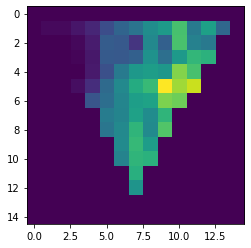

In [874]:
plt.imshow(activations[16, :, :])

In [690]:
%pdb

Automatic pdb calling has been turned OFF


In [681]:
reload(f3)

<module 'xrdc.feats_3d' from '/home/ollie/anaconda3/lib/python3.8/site-packages/xrdc-1.0-py3.8.egg/xrdc/feats_3d.py'>

In [699]:
from xrdc import misc

In [706]:
def unsort_weights(weights, isort):
    return weights[isort]

In [715]:
phase_weights = np.array(misc.deepmap(grid_xyz, lambda c: unsort_weights(*i_weights(c, compositions)), 1))\
    .reshape(ni, nj, -1) * mask[:, :, None] 

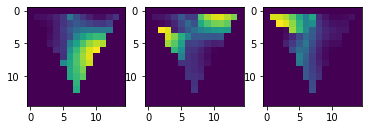

In [723]:
a, b = 1, 3

plt.subplot(a, b, 1)
plt.imshow(phase_weights[:, :, 0])

plt.subplot(a, b, 2)
plt.imshow(phase_weights[:, :, 1])

plt.subplot(a, b, 3)
plt.imshow(phase_weights[:, :, 2])

<IPython.core.display.Javascript object>


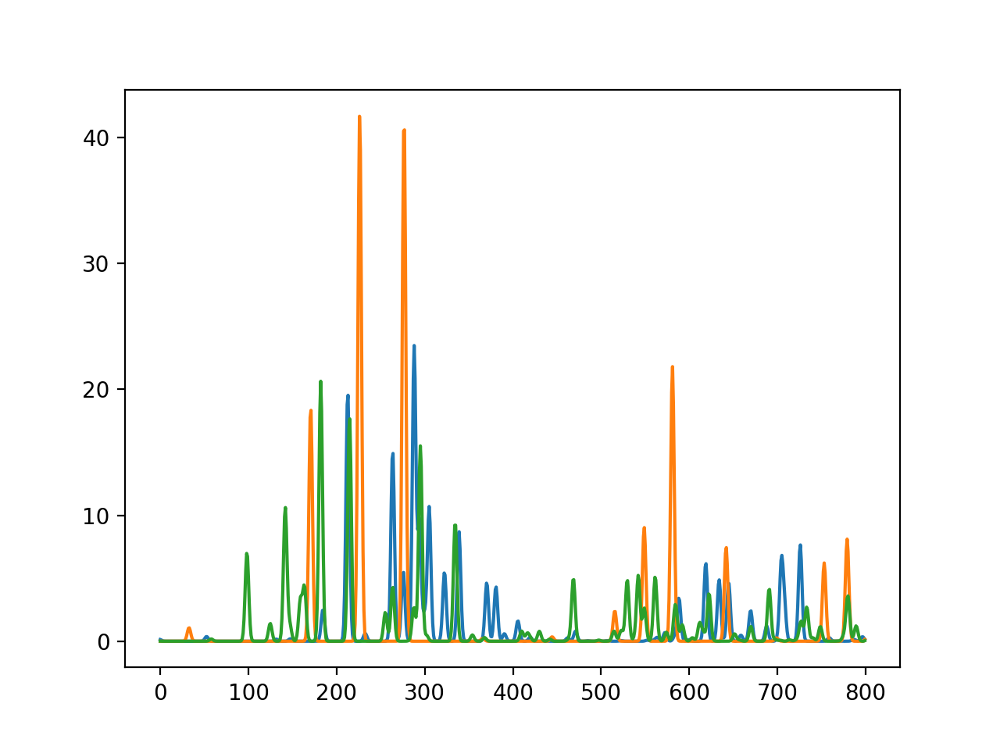

[[<matplotlib.lines.Line2D at 0x7fe7c00fef40>],

In [771]:
%matplotlib notebook
[plt.plot(p) for p in pats[:3]]

In [863]:
ridges = feat.get_ridges(feat.preprocess(m3d * mask[:, :, None], smooth_ax1= .8, threshold_percentile = 50)[0], axis = 2,
                        fitlists = fitlists, peakwidth = 1)

arr, labeled = feat.refine_and_label(ridges, sizetype = 'count', size_thresh=50,
                                    thicken_ax1=0)
feature_masks = np.array([labeled == i for i in range(1, labeled.max() + 1)])

# labeled, feature_masks, activations, _norm, activations_n1 = peakfit_featurize(m3d, fitlists,
#                                                                 thicken_ax0 = 2, size_thresh = 5)

# peakfit_featurize doesn't calculate activations correctly for 3d arrays,
# so do it manually here
# TODO
axis = 3
activations = ((feature_masks * m3d * mask[:, :, None]).sum(axis = axis))

using fitlists
3
3
3


In [880]:
reload(misc)

<module 'xrdc.misc' from '/home/ollie/anaconda3/lib/python3.8/site-packages/xrdc-1.0-py3.8.egg/xrdc/misc.py'>

In [881]:
with open('data/synthetic_simple.npy', 'wb') as f:
    np.save(f, misc.transpose_x_3d(activations))

In [853]:
m3d.shape

(15, 15, 800)